# **Applied Machine Learning: All Work: 12/18/23**
**Team HDR: Ryan Pittman, Daniel de las Heras, Hasibul Jishan**

All the work and code by team HDR.

## Sprint 1

In [1]:
# Import the necessary Python libraries for EDA
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import scipy
from scipy import stats
import seaborn as sns
from scipy import stats

In [2]:
# We use pandas to store the csv as data frames
currentCustomers = pd.read_csv(r"current_customers.csv")#Store the data of current customers in this data frame
prospectList = pd.read_csv(r"prospect_list.csv") #Store the data of prospect customers in this data frame
currentBilling = pd.read_csv(r"current_billing.csv")#Store the data of current customers in this data frame
dataDictionaryNetrality = pd.read_csv(r"Data_Dictionary_Netrality.csv") #Store the data of prospect customers in this data frame

In [3]:
# Identify the data types of each variable in their respective datasets
dataTypeCurrent = {'features_current':list(currentCustomers.columns), 'Type':list(currentCustomers.dtypes)}
dataTypeProspect = {'features_prospect':list(prospectList.columns), 'Type':list(prospectList.dtypes)}
dataTypeBilling = {'features_Billing':list(currentBilling.columns), 'Type':list(currentBilling.dtypes)}
featuresAndTypesCurrent = pd.DataFrame(dataTypeCurrent)
featuresAndTypesProspect = pd.DataFrame(dataTypeProspect)
featuresAndTypesBilling = pd.DataFrame(dataTypeBilling)

In [4]:
# Print the data types dataframe for Current Customers and label each variable/column as quantitative or categorical
featuresAndTypesCurrent['Categorical/Quantitative'] = featuresAndTypesCurrent['Type']
featuresAndTypesCurrent.loc[featuresAndTypesCurrent['Categorical/Quantitative'] == 'object', 'Categorical/Quantitative'] = 'Categorical'
featuresAndTypesCurrent.loc[featuresAndTypesCurrent['Categorical/Quantitative'] == 'int64', 'Categorical/Quantitative'] = 'Quantitative'
featuresAndTypesCurrent.loc[featuresAndTypesCurrent['Categorical/Quantitative'] == 'float64', 'Categorical/Quantitative'] = 'Quantitative'
featuresAndTypesCurrent.loc[[1,13,14,16,17],"Categorical/Quantitative"] = "Categorical" #Manually identify columns that SHOULD be categorical, but are integers or floats. We can convert these to strings at a later time if necessary.
featuresAndTypesCurrent

,features_current,Type,Categorical/Quantitative
0,Current_Customer,object,Categorical
1,CompanyID,int64,Categorical
2,Founded_Year,float64,Quantitative
3,Revenue_(in_000s_USD),int64,Quantitative
4,Revenue_Range_(in_USD),object,Categorical
5,Est_Marketing_Department_Budget_(in_000s_USD),float64,Quantitative
6,Est_Finance_Department_Budget_(in_000s_USD),float64,Quantitative
7,Est_IT_Department_Budget_(in_000s_USD),float64,Quantitative
8,Est_HR_Department_Budget_(in_000s_USD),int64,Quantitative
9,Employees,int64,Quantitative


In [5]:
# Print the data types dataframe for Prospect Customers and label each variable/column as quantitative or categorical
featuresAndTypesProspect['Categorical/Quantitative'] = featuresAndTypesProspect['Type']
featuresAndTypesProspect.loc[featuresAndTypesProspect['Categorical/Quantitative'] == 'object', 'Categorical/Quantitative'] = 'Categorical'
featuresAndTypesProspect.loc[featuresAndTypesProspect['Categorical/Quantitative'] == 'int64', 'Categorical/Quantitative'] = 'Quantitative'
featuresAndTypesProspect.loc[featuresAndTypesProspect['Categorical/Quantitative'] == 'float64', 'Categorical/Quantitative'] = 'Quantitative'
featuresAndTypesProspect.loc[[1,15,16,18,19],"Categorical/Quantitative"] = "Categorical" #Manually identify columns that SHOULD be categorical, but are integers or floats. We can convert these to strings at a later time if necessary.
featuresAndTypesProspect

,features_prospect,Type,Categorical/Quantitative
0,Current_Customer,object,Categorical
1,CompanyID,int64,Categorical
2,Founded_Year,float64,Quantitative
3,Company_HQ_Phone,object,Categorical
4,Fax,object,Categorical
5,Revenue_(in_000s_USD),float64,Quantitative
6,Revenue_Range_(in_USD),object,Categorical
7,Est_Marketing_Department_Budget_(in_000s_USD),float64,Quantitative
8,Est_Finance_Department_Budget_(in_000s_USD),float64,Quantitative
9,Est_IT_Department_Budget_(in_000s_USD),float64,Quantitative


In [6]:
# Print the data types dataframe for Current Billing and label each variable/column as quantitative or categorical
featuresAndTypesBilling['Categorical/Quantitative'] = featuresAndTypesBilling['Type']
featuresAndTypesBilling.loc[featuresAndTypesBilling['Categorical/Quantitative'] == 'object', 'Categorical/Quantitative'] = 'Categorical'
featuresAndTypesBilling.loc[featuresAndTypesBilling['Categorical/Quantitative'] == 'int64', 'Categorical/Quantitative'] = 'Quantitative'
featuresAndTypesBilling.loc[featuresAndTypesBilling['Categorical/Quantitative'] == 'float64', 'Categorical/Quantitative'] = 'Quantitative'
featuresAndTypesBilling.loc[0,"Categorical/Quantitative"] = "Categorical" #Manually identify columns that SHOULD be categorical, but are integers or floats. We can convert these to strings at a later time if necessary.
featuresAndTypesBilling

,features_Billing,Type,Categorical/Quantitative
0,CompanyID,int64,Categorical
1,Lifetime_Park Place,float64,Quantitative
2,Lifetime_Boardwalk,float64,Quantitative
3,Lifetime_StJamesPlace,float64,Quantitative
4,Lifetime_Marvin Gardens,float64,Quantitative
5,Lifetime_Ventnor,float64,Quantitative
6,Lifetime_Kentucky,float64,Quantitative
7,Lifetime_Tennessee,float64,Quantitative
8,Lifetime_Pennslyvania,float64,Quantitative
9,Last_Month_Park Place,float64,Quantitative


In [7]:
# Created a new dataframe called currentNew that acts as our preprocessed currentCustomers dataframe
# Started by removing columns/variables that seemed rather useless for analysis
currentNew = currentCustomers.drop(columns= ["Current_Customer", "SIC_Codes", "NAICS_Codes", "All_Industries", "All_Sub-Industries", "Industry_Hierarchical_Category", "Secondary_Industry_Hierarchical_Category", "Certification_Date", "Recent_Funding_Date", "Recent_Investors", "All_Investors", "Company_Zip_Code"])
# Convert categorical values for Certified Active Company to binary: 1 = Yes, 0 = No
currentNew.loc[currentNew['Certified_Active_Company'] == 'No', 'Certified_Active_Company'] = 0
currentNew.loc[currentNew['Certified_Active_Company'] == 'Yes', 'Certified_Active_Company'] = 1
# Convert categorical values for Company id Acquired to binary: 1 = Yes, 0 = Null/Missing
# Question: Does a missing value mean comapny not acquired or that we are unsure? What does this column really mean?
currentNew.loc[currentNew['Company_Is_Acquired'].isnull(), 'Company_Is_Acquired'] = 0
currentNew.loc[currentNew['Company_Is_Acquired'] == 'Yes', 'Company_Is_Acquired'] = 1
# Convert categorical values for Ownership Type to binary: 1 = Yes, 0 = Null/Missing
currentNew.loc[currentNew['Ownership_Type'] == 'Public', 'Ownership_Type'] = 0
currentNew.loc[currentNew['Ownership_Type'] == 'Private', 'Ownership_Type'] = 1
## NOTE: May change Business Model column to binary in the future, but not necessary right now
currentNew

,CompanyID,Founded_Year,Revenue_(in_000s_USD),Revenue_Range_(in_USD),Est_Marketing_Department_Budget_(in_000s_USD),Est_Finance_Department_Budget_(in_000s_USD),Est_IT_Department_Budget_(in_000s_USD),Est_HR_Department_Budget_(in_000s_USD),Employees,Employee_Range,...,Business_Model,Certified_Active_Company,Total_Funding_Amount_(in_000s_USD),Recent_Funding_Amount_(in_000s_USD),Recent_Funding_Round,Company_City,Company_State,Company_Country,Number_of_Locations,Company_Is_Acquired
0,1475361,1994.0,538046000,Over $5 bil.,69407934.0,5380460.0,15065288.0,4041427,1541000,Employees.10000plus,...,B2B,1,48000,48000,Stock Issuance/Offering,Seattle,Washington,United States,37.0,0
1,16400573,1998.0,256735000,Over $5 bil.,33118815.0,2567350.0,7188580.0,228090,160000,Employees.10000plus,...,B2B,1,1925100,1900000,Stock Issuance/Offering,Mountain View,California,United States,91.0,0
2,246280,1989.0,63144419,Over $5 bil.,4862120.0,631444.0,2967787.0,1663794,738000,Employees.10000plus,...,B2B,1,1700000,1700000,Stock Issuance/Offering,Dublin,Leinster,Ireland,49.0,0
3,43076614,1999.0,364115000,Over $5 bil.,18205750.0,3641150.0,10559335.0,139776,62000,Employees.10000plus,...,B2B,1,0,0,NaN,Spring,Texas,United States,28.0,0
4,126828694,1983.0,136835000,Over $5 bil.,11083635.0,2052525.0,5062895.0,253627,112500,Employees.10000plus,...,B2B,1,0,0,NaN,New York City,New York,United States,55.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
324,372175531,NaN,3951,$1 mil. - $5 mil.,513.0,39.0,209.0,30,13,Employees.10to19,...,B2C,0,0,0,NaN,Sherwood,Oregon,United States,1.0,0
325,347198798,2008.0,1654,$1 mil. - $5 mil.,133.0,24.0,61.0,18,8,Employees.5to9,...,B2B,1,0,0,NaN,Kansas City,Missouri,United States,1.0,0
326,32080939,2001.0,232,"Under $500,000",18.0,3.0,8.0,4,2,Employees.1to4,...,B2C,0,0,0,NaN,Atlanta,Georgia,United States,1.0,0
327,39371338,2002.0,1946,$1 mil. - $5 mil.,251.0,19.0,54.0,34,15,Employees.10to19,...,B2B,0,0,0,NaN,NaN,NaN,NaN,NaN,0


In [8]:
#Created a new dataframe called prospectListNew that acts as our preprocessed prospectList dataframe
# Started by removing columns/variables that seemed rather useless for analysis
prospectListNew = prospectList.drop(columns= ["Current_Customer", "Fax", "Company_HQ_Phone", "SIC_Codes", "NAICS_Codes", "All_Industries", "All_Sub-Industries", "Industry_Hierarchical_Category", "Secondary_Industry_Hierarchical_Category", "Certification_Date", "Recent_Funding_Date", "Recent_Investors", "All_Investors", "Company_Zip_Code"])
# Convert categorical values for Certified Active Company to binary: 1 = Yes, 0 = No
prospectListNew.loc[prospectListNew['Certified_Active_Company'] == 'No', 'Certified_Active_Company'] = 0
prospectListNew.loc[prospectListNew['Certified_Active_Company'] == 'Yes', 'Certified_Active_Company'] = 1
# Convert categorical values for Company id Acquired to binary: 1 = Yes, 0 = Null/Missing
# Question: Does a missing value mean comapny not acquired or that we are unsure? What does this column really mean?
prospectListNew.loc[prospectListNew['Company_Is_Acquired'].isnull(), 'Company_Is_Acquired'] = 0
prospectListNew.loc[prospectListNew['Company_Is_Acquired'] == 'Yes', 'Company_Is_Acquired'] = 1
# Convert categorical values for Ownership Type to binary: 1 = Yes, 0 = Null/Missing
prospectListNew.loc[prospectListNew['Ownership_Type'] == 'Public', 'Ownership_Type'] = 0
prospectListNew.loc[prospectListNew['Ownership_Type'] == 'Private', 'Ownership_Type'] = 1
## NOTE: May change Business Model column to binary in the future, but not necessary right now
prospectListNew

,CompanyID,Founded_Year,Revenue_(in_000s_USD),Revenue_Range_(in_USD),Est_Marketing_Department_Budget_(in_000s_USD),Est_Finance_Department_Budget_(in_000s_USD),Est_IT_Department_Budget_(in_000s_USD),Est_HR_Department_Budget_(in_000s_USD),Employees,Employee_Range,...,Business_Model,Certified_Active_Company,Total_Funding_Amount_(in_000s_USD),Recent_Funding_Amount_(in_000s_USD),Recent_Funding_Round,Company_City,Company_State,Company_Country,Number_of_Locations,Company_Is_Acquired
0,2441797,1976.0,387537000.0,Over $5 bil.,31390497.0,5813055.0,14338869.0,369732,164000,Employees.10000plus,...,B2B,1,2162250,1000000,Share Placement,Cupertino,California,United States,23.0,0
1,155353090,1962.0,630794000.0,Over $5 bil.,76956868.0,6307940.0,12615880.0,4734373,2100000,Employees.10000plus,...,B2B,1,6850,3000,Stock Issuance/Offering,Bentonville,Arkansas,United States,4202.0,0
2,24904409,1975.0,204094000.0,Over $5 bil.,26736314.0,2040940.0,7551478.0,475335,210842,Employees.10000plus,...,B2B,1,1000,1000,Other Financing Round,Redmond,Washington,United States,63.0,0
3,10256729,1963.0,339204000.0,Over $5 bil.,41382888.0,3392040.0,6784080.0,482455,214000,Employees.10000plus,...,B2C,1,0,0,NaN,Woonsocket,Rhode Island,United States,31.0,0
4,141738322,1938.0,214420431.0,Over $5 bil.,17368054.0,3216306.0,7933555.0,729557,323606,Employees.10000plus,...,B2B,1,0,0,NaN,Suwon-si,Gyeonggi-do,South Korea,30.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1924,398742609,2014.0,1643.0,$1 mil. - $5 mil.,215.0,16.0,57.0,11,5,Employees.5to9,...,B2B,1,0,0,NaN,Gaylord,Michigan,United States,NaN,0
1925,30344865,1932.0,1204.0,$1 mil. - $5 mil.,156.0,12.0,63.0,14,6,Employees.5to9,...,B2C,1,0,0,NaN,Manhattan,Illinois,United States,1.0,0
1926,478996006,2019.0,956.0,"$500,000 - $1 mil.",125.0,9.0,33.0,17,6,Employees.5to9,...,B2B,1,0,0,NaN,Vienna,Virginia,United States,1.0,0
1927,500997527,2002.0,1144.0,$1 mil. - $5 mil.,92.0,17.0,42.0,11,5,Employees.5to9,...,NaN,1,0,0,NaN,Kokomo,Indiana,United States,1.0,0


In [9]:
currentNew.describe(include = 'all')

,CompanyID,Founded_Year,Revenue_(in_000s_USD),Revenue_Range_(in_USD),Est_Marketing_Department_Budget_(in_000s_USD),Est_Finance_Department_Budget_(in_000s_USD),Est_IT_Department_Budget_(in_000s_USD),Est_HR_Department_Budget_(in_000s_USD),Employees,Employee_Range,...,Business_Model,Certified_Active_Company,Total_Funding_Amount_(in_000s_USD),Recent_Funding_Amount_(in_000s_USD),Recent_Funding_Round,Company_City,Company_State,Company_Country,Number_of_Locations,Company_Is_Acquired
count,3.290000e+02,311.000000,3.290000e+02,329,3.270000e+02,3.270000e+02,3.270000e+02,3.290000e+02,3.290000e+02,329,...,305,329.0,3.290000e+02,3.290000e+02,148,323,320,325,321.000000,329.0
unique,NaN,NaN,NaN,12,NaN,NaN,NaN,NaN,NaN,11,...,2,2.0,NaN,NaN,10,191,48,14,NaN,2.0
top,NaN,NaN,NaN,$1 mil. - $5 mil.,NaN,NaN,NaN,NaN,NaN,Employees.10to19,...,B2B,1.0,NaN,NaN,Debt,Houston,Texas,United States,NaN,0.0
freq,NaN,NaN,NaN,76,NaN,NaN,NaN,NaN,NaN,53,...,273,313.0,NaN,NaN,101,40,61,301,NaN,308.0
mean,2.000547e+08,1988.006431,8.876763e+06,NaN,7.787685e+05,9.971928e+04,2.922070e+05,3.015184e+04,1.323888e+04,NaN,...,NaN,NaN,4.980478e+05,1.698524e+05,NaN,NaN,NaN,NaN,15.517134,NaN
std,1.856962e+08,32.181140,5.287259e+07,NaN,4.873709e+06,5.512918e+05,1.582583e+06,2.451531e+05,9.659048e+04,NaN,...,NaN,NaN,3.031276e+06,1.115885e+06,NaN,NaN,NaN,NaN,27.680553,NaN
min,2.462800e+05,1818.000000,2.320000e+02,NaN,1.800000e+01,3.000000e+00,8.000000e+00,4.000000e+00,2.000000e+00,NaN,...,NaN,NaN,0.000000e+00,0.000000e+00,NaN,NaN,NaN,NaN,1.000000,NaN
25%,3.260576e+07,1983.500000,4.966000e+03,NaN,4.980000e+02,6.200000e+01,1.845000e+02,4.400000e+01,1.800000e+01,NaN,...,NaN,NaN,0.000000e+00,0.000000e+00,NaN,NaN,NaN,NaN,3.000000,NaN
50%,1.127551e+08,1999.000000,2.985300e+04,NaN,2.848000e+03,3.320000e+02,1.078000e+03,2.740000e+02,1.170000e+02,NaN,...,NaN,NaN,0.000000e+00,0.000000e+00,NaN,NaN,NaN,NaN,6.000000,NaN
75%,3.545619e+08,2006.000000,3.045750e+05,NaN,2.631800e+04,3.374000e+03,9.570000e+03,1.753000e+03,1.000000e+03,NaN,...,NaN,NaN,2.000000e+03,1.054000e+03,NaN,NaN,NaN,NaN,18.000000,NaN


In [10]:
currentBilling.describe(include = 'all')

,CompanyID,Lifetime_Park Place,Lifetime_Boardwalk,Lifetime_StJamesPlace,Lifetime_Marvin Gardens,Lifetime_Ventnor,Lifetime_Kentucky,Lifetime_Tennessee,Lifetime_Pennslyvania,Last_Month_Park Place,Last_Month_Boardwalk,Last_Month_StJamesPlace,Last_Month_Marvin Gardens,Last_Month_Ventnor,Last_Month_Kentucky,Last_Month_Tennessee,Last_Month_Pennslyvania
count,3.280000e+02,54.000000,64.000000,110.000000,78.000000,23.000000,31.000000,131.000000,0.0,53.000000,62.000000,110.000000,77.000000,23.000000,30.000000,130.000000,0.0
mean,1.991664e+08,0.320630,0.514523,0.546081,1.456566,0.074611,0.054524,0.202489,NaN,-0.007761,0.083027,0.077750,0.521633,0.013719,-0.096991,-0.045438,NaN
std,1.852784e+08,1.018454,1.102507,1.860335,6.921488,0.255199,0.161744,0.482370,NaN,0.366951,0.433666,0.600159,2.239835,0.234662,0.057665,0.209140,NaN
min,2.462800e+05,-0.075611,-0.078569,-0.075265,-0.075411,-0.076149,-0.075611,-0.075611,NaN,-0.224215,-0.881855,-0.287594,-0.171566,-0.242080,-0.151048,-0.792421,NaN
25%,3.255303e+07,-0.043429,-0.038964,-0.038745,-0.027464,-0.070687,-0.050572,-0.034422,NaN,-0.127916,-0.133585,-0.129784,-0.127868,-0.136824,-0.129050,-0.135542,NaN
50%,1.096502e+08,0.023077,0.045070,0.025708,0.062516,-0.029743,0.002945,0.004252,NaN,-0.109621,-0.079230,-0.094303,-0.079272,-0.070514,-0.110377,-0.117437,NaN
75%,3.544963e+08,0.241402,0.317350,0.314899,0.398554,0.074909,0.078250,0.182353,NaN,-0.031217,0.047509,0.073695,0.068023,0.099619,-0.090873,-0.032955,NaN
max,1.240159e+09,6.300050,5.501002,13.025724,58.999383,0.979010,0.645165,2.989057,NaN,2.245466,1.749583,4.937410,16.546648,0.844695,0.079619,1.063733,NaN


### Boxplots for Current Customers

In [11]:
# create a data frame with only the quatitative variables
revenues = pd.DataFrame(columns = ['Revenue_(in_000s_USD)'], data = list(currentNew["Revenue_(in_000s_USD)"]))
revenues['Est_Marketing_Department_Budget_(in_000s_USD)'] = currentNew['Est_Marketing_Department_Budget_(in_000s_USD)']
revenues['Est_Finance_Department_Budget_(in_000s_USD)'] = currentNew['Est_Finance_Department_Budget_(in_000s_USD)']
revenues['Est_IT_Department_Budget_(in_000s_USD)'] = currentNew['Est_IT_Department_Budget_(in_000s_USD)']
revenues['Est_HR_Department_Budget_(in_000s_USD)'] = currentNew['Est_HR_Department_Budget_(in_000s_USD)']
revenues['Employees'] = currentNew['Employees']

# standadize data and drop all the null values
revenues = (revenues-revenues.mean())/revenues.std()
revenues.dropna()

,Revenue_(in_000s_USD),Est_Marketing_Department_Budget_(in_000s_USD),Est_Finance_Department_Budget_(in_000s_USD),Est_IT_Department_Budget_(in_000s_USD),Est_HR_Department_Budget_(in_000s_USD),Employees
0,10.008386,14.081507,9.578848,9.334789,16.362325,15.816892
1,4.687840,6.635613,4.476088,4.357668,0.807406,1.519416
2,1.026385,0.837832,0.964507,1.690641,6.663762,7.503443
3,6.718760,3.575712,6.423877,6.487575,0.447166,0.504823
4,2.420124,2.114379,3.542236,3.014494,0.911574,1.027649
...,...,...,...,...,...,...
324,-0.167815,-0.159684,-0.180812,-0.184507,-0.122870,-0.136927
325,-0.167858,-0.159762,-0.180839,-0.184601,-0.122918,-0.136979
326,-0.167885,-0.159786,-0.180877,-0.184634,-0.122976,-0.137041
327,-0.167853,-0.159738,-0.180848,-0.184605,-0.122853,-0.136907


(array([1, 2, 3, 4, 5, 6]),
 [Text(1, 0, 'Revenue_(in_000s_USD)'),
  Text(2, 0, 'Est_Marketing_Department_Budget_(in_000s_USD)'),
  Text(3, 0, 'Est_Finance_Department_Budget_(in_000s_USD)'),
  Text(4, 0, 'Est_IT_Department_Budget_(in_000s_USD)'),
  Text(5, 0, 'Est_HR_Department_Budget_(in_000s_USD)'),
  Text(6, 0, 'Employees')])

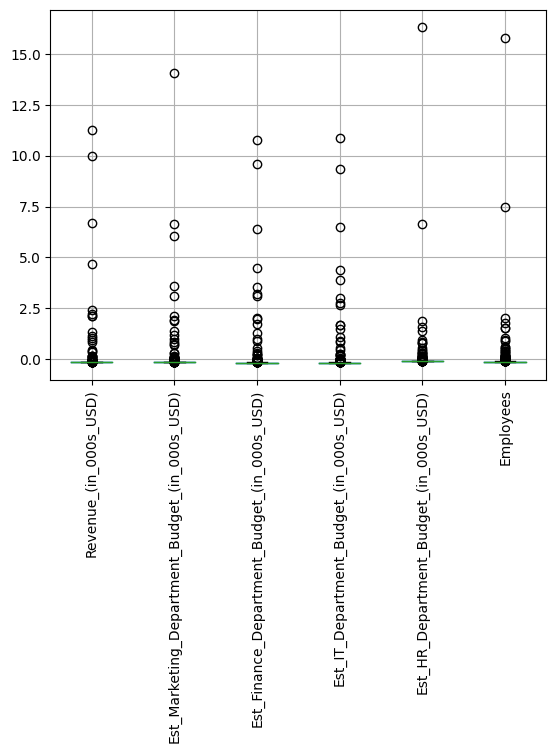

In [12]:
#Plot the boxplots on the quatitative data
revenues.boxplot(column=['Revenue_(in_000s_USD)','Est_Marketing_Department_Budget_(in_000s_USD)','Est_Finance_Department_Budget_(in_000s_USD)','Est_IT_Department_Budget_(in_000s_USD)','Est_HR_Department_Budget_(in_000s_USD)','Employees'])
plt.xticks(rotation = 90)

### Pairplot to test for correlation

(array([-5.,  0.,  5., 10., 15., 20.]),
 [Text(-5.0, 0, '−5'),
  Text(0.0, 0, '0'),
  Text(5.0, 0, '5'),
  Text(10.0, 0, '10'),
  Text(15.0, 0, '15'),
  Text(20.0, 0, '20')])

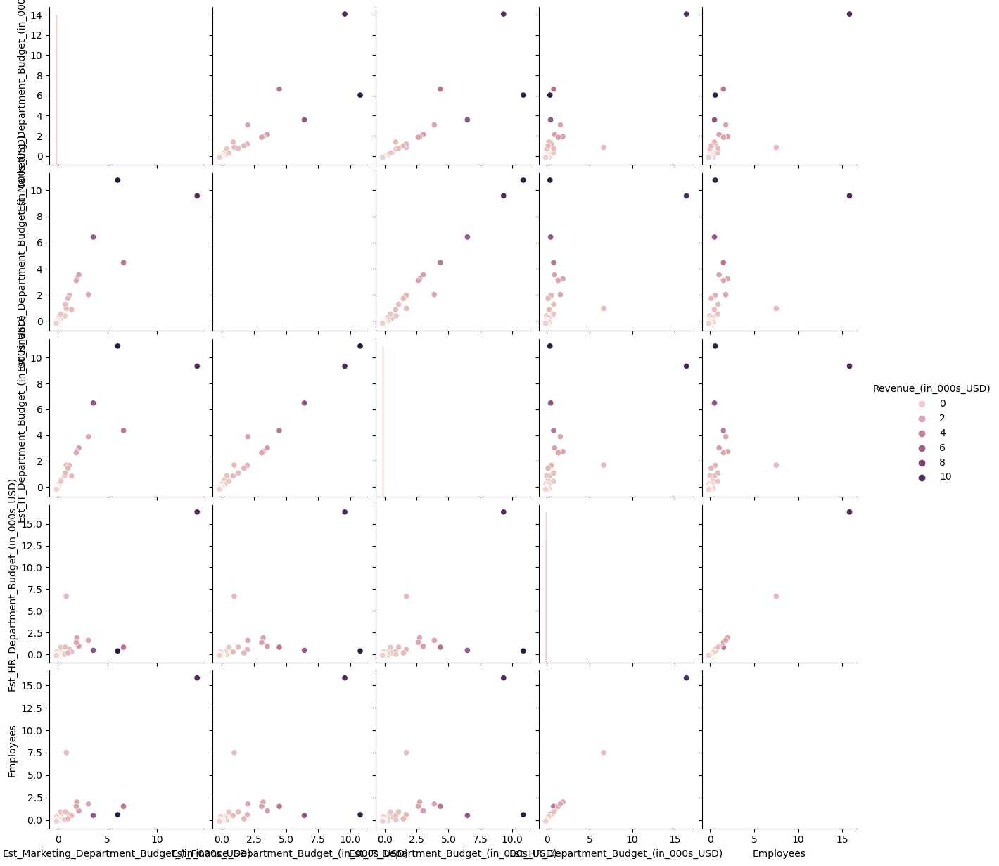

In [13]:
# Check for Variable correlation
sns.pairplot(revenues,hue = 'Revenue_(in_000s_USD)')
plt.xticks(rotation = 45)

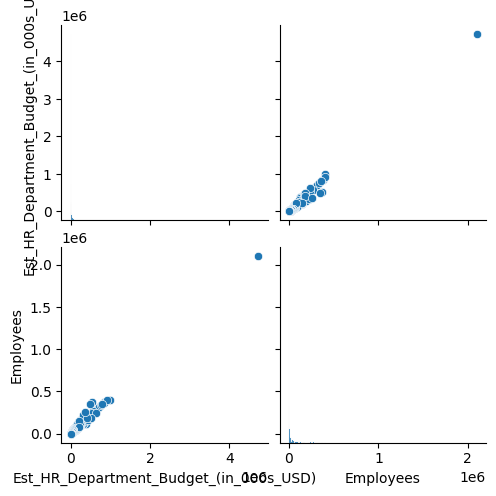

In [21]:
sns.pairplot(prospectListNew.iloc[:,[2,4,5,6,7,8]])

In [14]:
# Fill NAs in columns where missing values are present/Take care of all missing values
prospectListNew = prospectListNew.fillna('N/A')
currentNew = currentNew.fillna('N/A')
# We may need to revise this for quantatative columns where replacing N/A with the mean or median may be necessary

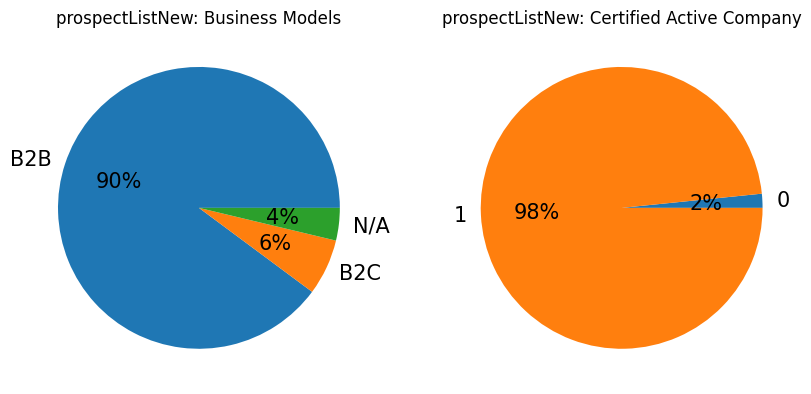

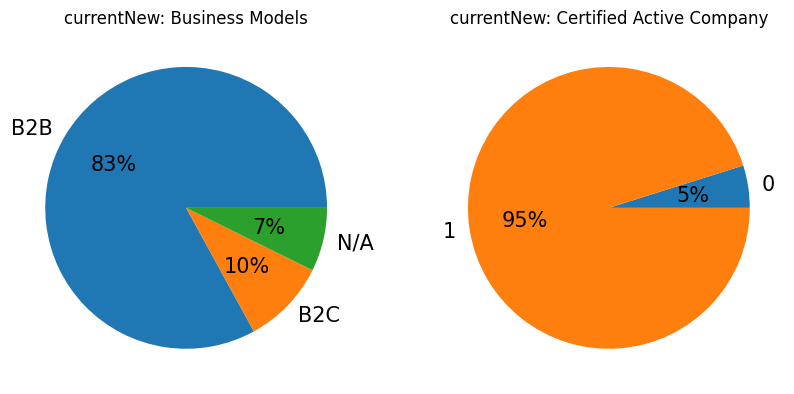

prospectListNew Business Model counts: {'B2B': 1733, 'B2C': 124, 'N/A': 72}
prospectListNew Certified Active Company counts: {1: 1898, 0: 31}
currentNew Business Model counts: {'B2B': 273, 'B2C': 32, 'N/A': 24}
currentNew Certified Active Company counts: {1: 313, 0: 16}


In [15]:
# Created a function that calculates percentages for the Business_Model column
def Percents(x):
    return f'{x:.0f}%'

fig, (a, b) = plt.subplots(ncols=2, figsize=(10, 10))
fig, (c, d) = plt.subplots(ncols=2, figsize=(10, 10))
a.title.set_text('prospectListNew: Business Models')
b.title.set_text('prospectListNew: Certified Active Company')
c.title.set_text('currentNew: Business Models')
d.title.set_text('currentNew: Certified Active Company')

prospectListNew.groupby('Business_Model').size().plot(kind='pie', autopct=Percents, textprops={'fontsize': 15}, ax=a)  # Constructed a pie chart visualization to display descriptive statistics for the Business_Model column
prospectListNew.groupby('Certified_Active_Company').size().plot(kind='pie', autopct=Percents, textprops={'fontsize': 15}, ax=b)  # Constructed a pie chart visualization to display descriptive statistics for the Certified_Active_Company column
currentNew.groupby('Business_Model').size().plot(kind='pie', autopct=Percents, textprops={'fontsize': 15}, ax=c)  # Constructed a pie chart visualization to display descriptive statistics for the Business_Model column
currentNew.groupby('Certified_Active_Company').size().plot(kind='pie', autopct=Percents, textprops={'fontsize': 15}, ax=d)  # Constructed a pie chart visualization to display descriptive statistics for the Certified_Active_Company column
plt.show()

countsBusModelPros = prospectListNew['Business_Model'].value_counts().to_dict()  # Created two dictionaries of frequencies to check if the percentages function calculated correctly
countsActivePros = prospectListNew['Certified_Active_Company'].value_counts().to_dict()
countsBusModelPros = str(countsBusModelPros) # Convert the dictionaries to strings for printing purposes
countsActivePros = str(countsActivePros)
print("prospectListNew Business Model counts: " + countsBusModelPros) # These dictionaries display the counts of each business model and the number of certified active companies which adds value to their respective pie charts as well
print("prospectListNew Certified Active Company counts: " + countsActivePros)

countsBusModelCur = currentNew['Business_Model'].value_counts().to_dict()  # Created two dictionaries of frequencies to check if the percentages function calculated correctly
countsActiveCur = currentNew['Certified_Active_Company'].value_counts().to_dict()
countsBusModelCur = str(countsBusModelCur) # Convert the dictionaries to strings for printing purposes
countsActiveCur = str(countsActiveCur)
print("currentNew Business Model counts: " + countsBusModelCur) # These dictionaries display the counts of each business model and the number of certified active companies which adds value to their respective pie charts as well
print("currentNew Certified Active Company counts: " + countsActiveCur)

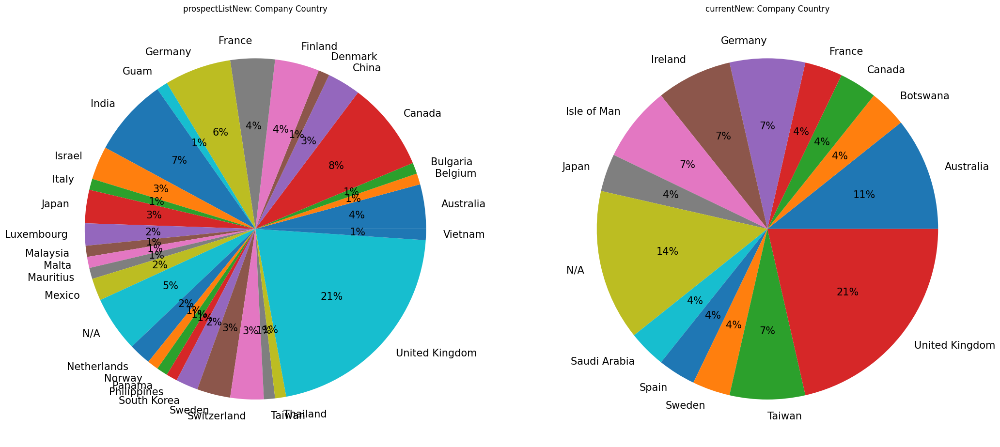

prospectListNew Country counts: {'United Kingdom': 20, 'Canada': 8, 'India': 7, 'Germany': 6, 'N/A': 5, 'Finland': 4, 'France': 4, 'Australia': 4, 'Japan': 3, 'Sweden': 3, 'Switzerland': 3, 'China': 3, 'Israel': 3, 'South Korea': 2, 'Luxembourg': 2, 'Mexico': 2, 'Netherlands': 2, 'Vietnam': 1, 'Denmark': 1, 'Taiwan': 1, 'Malta': 1, 'Philippines': 1, 'Mauritius': 1, 'Guam': 1, 'Norway': 1, 'Bulgaria': 1, 'Italy': 1, 'Panama': 1, 'Thailand': 1, 'Malaysia': 1, 'Belgium': 1}
currentNew Company Country counts: {'United Kingdom': 6, 'N/A': 4, 'Australia': 3, 'Ireland': 2, 'Germany': 2, 'Taiwan': 2, 'Isle of Man': 2, 'Saudi Arabia': 1, 'Sweden': 1, 'France': 1, 'Japan': 1, 'Spain': 1, 'Canada': 1, 'Botswana': 1}


In [16]:
# Created a function that calculates percentages for the Company_Country column
def Percents(x):
    return f'{x:.0f}%'

fig, (e, f) = plt.subplots(ncols=2, figsize=(25, 15))
e.title.set_text('prospectListNew: Company Country')
f.title.set_text('currentNew: Company Country')

# Made two new dataframes that exclude US companies for visualization purposes (The US companies make up roughly 90% in both the current and prospect datasets)
currentInternational = currentNew.loc[currentNew['Company_Country'] != 'United States']
prospectInternational = prospectListNew.loc[prospectListNew['Company_Country'] != 'United States']

prospectInternational.groupby('Company_Country').size().plot(kind='pie', autopct=Percents, textprops={'fontsize': 15}, ax=e)  # Constructed  pie chart visualizations to display descriptive statistics for the Company_Country column in both datasets
currentInternational.groupby('Company_Country').size().plot(kind='pie', autopct=Percents, textprops={'fontsize': 15}, ax=f)
plt.show()

countsCountryPros = prospectInternational['Company_Country'].value_counts().to_dict()  # Created a dictionary of frequencies to check if the percentages function calculated correctly
countsCountryPros = str(countsCountryPros) # Converted the dictionary to a string for printing purposes
countsCountryCur = currentInternational['Company_Country'].value_counts().to_dict()  # Created a dictionary of frequencies to check if the percentages function calculated correctly
countsCountryCur = str(countsCountryCur) # Converted the dictionary to a string for printing purposes
print("prospectListNew Country counts: " + countsCountryPros) # These dictionaries display the counts of each Company Country which adds value to their respective pie charts as well
print("currentNew Company Country counts: " + countsCountryCur)

[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

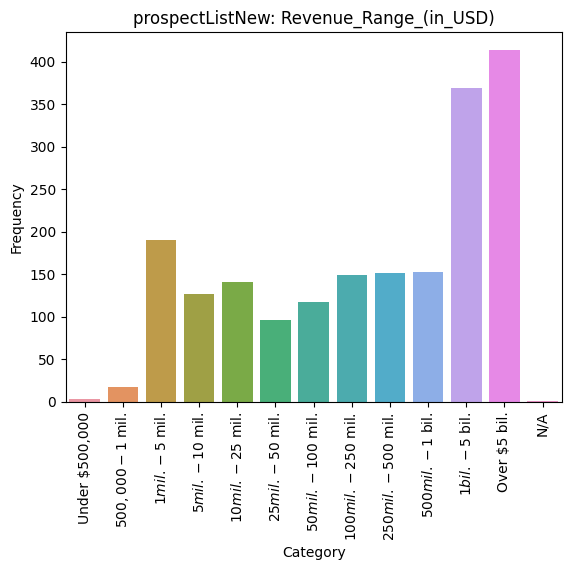

In [17]:
# Bar plot using seaborn of the employee range

# Frequency table of the different employee ranges of prospect companies
prospectDict= {'Category':list(prospectListNew['Revenue_Range_(in_USD)'].value_counts().index), 'Frequency':list(prospectListNew['Revenue_Range_(in_USD)'].value_counts().values)}
prospectPlotDf = pd.DataFrame(prospectDict)
# Frequency table of the different employee ranges of current companies
currentDict = {'Category':list(currentNew['Revenue_Range_(in_USD)'].value_counts().index), 'Frequency':list(currentNew['Revenue_Range_(in_USD)'].value_counts().values)}
currentPlotDf = pd.DataFrame(currentDict)

# Creating a column telling if the it's prospect or current
prospectPlotDf['Prospect/Current'] = 'Prospect'
currentPlotDf['Prospect/Current'] = 'Current'

# List with the catgeories in the desired order for the plot
categories = ['Under $500,000', '$500,000 - $1 mil.', '$1 mil. - $5 mil.', '$5 mil. - $10 mil.', '$10 mil. - $25 mil.', '$25 mil. - $50 mil.', '$50 mil. - $100 mil.', '$100 mil. - $250 mil.', '$250 mil. - $500 mil.', '$500 mil. - $1 bil.', '$1 bil. - $5 bil.', 'Over $5 bil.', 'N/A']
# Joining the prospect and current data frames on on top of the other


#Plotting a Group Bar plot
sns.barplot(x='Category', y='Frequency', data=prospectPlotDf, order = categories).set(title = "prospectListNew: Revenue_Range_(in_USD)")
locs, labels = plt.xticks()
plt.setp(labels, rotation=90)

[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

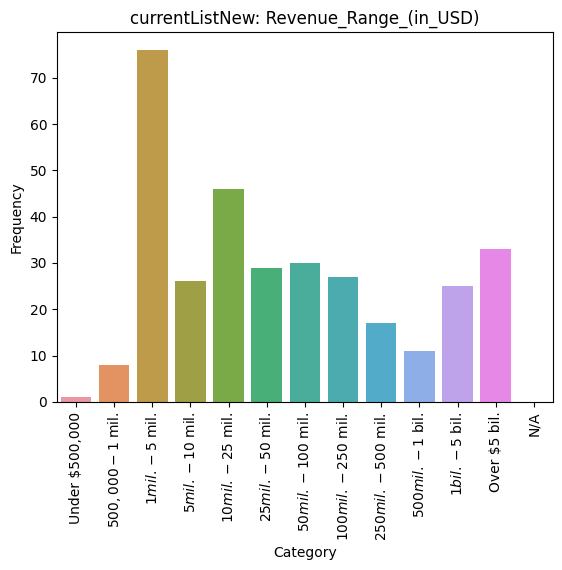

In [18]:
sns.barplot(x='Category', y='Frequency', data=currentPlotDf, order = categories).set(title = "currentListNew: Revenue_Range_(in_USD)")
locs, labels = plt.xticks()
plt.setp(labels, rotation=90)

In [19]:
from pandas.core.algorithms import value_counts
prospectListNew['Revenue_Range_(in_USD)'].value_counts().index

Index(['Over $5 bil.', '$1 bil. - $5 bil.', '$1 mil. - $5 mil.',
       '$500 mil. - $1 bil.', '$250 mil. - $500 mil.', '$100 mil. - $250 mil.',
       '$10 mil. - $25 mil.', '$5 mil. - $10 mil.', '$50 mil. - $100 mil.',
       '$25 mil. - $50 mil.', '$500,000 - $1 mil.', 'Under $500,000', 'N/A'],
      dtype='object')

[None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None,
 None]

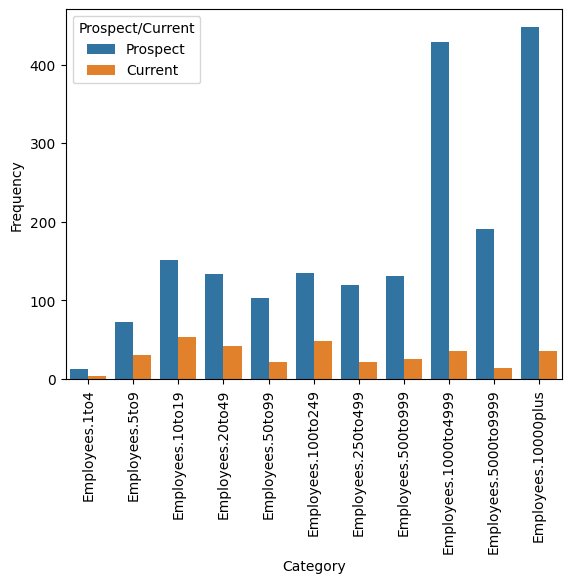

In [20]:
# Bar plot using seaborn of the employee range

# Frequency table of the different employee ranges of prospect companies
prospectDict= {'Category':list(prospectListNew['Employee_Range'].value_counts().index), 'Frequency':list(prospectListNew['Employee_Range'].value_counts().values)}
prospectPlotDf = pd.DataFrame(prospectDict)
# Frequency table of the different employee ranges of current companies
currentDict = {'Category':list(currentNew['Employee_Range'].value_counts().index), 'Frequency':list(currentNew['Employee_Range'].value_counts().values)}
currentPlotDf = pd.DataFrame(currentDict)

# Creating a column telling if the it's prospect or current
prospectPlotDf['Prospect/Current'] = 'Prospect'
currentPlotDf['Prospect/Current'] = 'Current'

# List with the catgeories in the desired order for the plot
categories = ['Employees.1to4','Employees.5to9','Employees.10to19','Employees.20to49','Employees.50to99','Employees.100to249','Employees.250to499',
                'Employees.500to999','Employees.1000to4999','Employees.5000to9999','Employees.10000plus']

# Joining the prospect and current data frames on on top of the other
employeesDf = pd.concat([prospectPlotDf,currentPlotDf])

#Plotting a Group Bar plot
sns.barplot(x='Category', y='Frequency', hue='Prospect/Current', data=employeesDf, order = categories)
locs, labels = plt.xticks()
plt.setp(labels, rotation=90)

## Sprint 2

In [22]:
# We use pandas to store the csv as data frames
currentRawData = pd.read_csv(r"/content/current_customers.csv")#Store the data of current customers in this data frame
prospectRawData = pd.read_csv(r"/content/prospect_list.csv") #Store the data of prospect customers in this data frame
billingRawData = pd.read_csv(r"/content/current_billing.csv")#Store the data of current customers in this data frame
dataDictionaryNetrality = pd.read_csv(r"/content/Data_Dictionary_Netrality.csv") #Store the data of prospect customers in this data frame

In [23]:
# Created a new dataframe called currentData that acts as our preprocessed currentCustomers dataframe
# Started by removing columns/variables that seemed rather useless for analysis
#print(currentRawData.isnull().sum())
currentData = currentRawData.drop(columns= ['Current_Customer', 'Past_1_Year_Employee_Growth_Rate','SIC_Codes','NAICS_Codes','Primary_Industry','Primary_Sub-Industry','All_Industries','All_Sub-Industries','Secondary_Industry_Hierarchical_Category','Company_Is_Acquired','Recent_Funding_Round','Recent_Funding_Round','Recent_Funding_Date','Certification_Date','Recent_Investors','All_Investors',])
currentData[['CompanyID','SIC_Code_1','SIC_Code_2','NAICS_Code_1','NAICS_Code_2']] = currentData[['CompanyID','SIC_Code_1','SIC_Code_2','NAICS_Code_1','NAICS_Code_2']].astype('object')


In [24]:
#Dropped unnecessary columns from the prospect dataset
prospectData = prospectRawData.drop(columns= ['Company_HQ_Phone','Fax','Current_Customer', 'Past_1_Year_Employee_Growth_Rate','SIC_Codes','NAICS_Codes','Primary_Industry','Primary_Sub-Industry','All_Industries','All_Sub-Industries','Secondary_Industry_Hierarchical_Category','Company_Is_Acquired','Recent_Funding_Round','Recent_Funding_Round','Recent_Funding_Date','Certification_Date','Recent_Investors','All_Investors',])
prospectData[['CompanyID','SIC_Code_1','SIC_Code_2','NAICS_Code_1','NAICS_Code_2']] = prospectData[['CompanyID','SIC_Code_1','SIC_Code_2','NAICS_Code_1','NAICS_Code_2']].astype('object')


### Checking for Skewness

In [25]:
#We noticed Alexa Rank appeared to be skewed so we wanted to take a closer look at its descriptive statistics
np.log(currentData['Alexa_Rank']).mean()
currentData['Alexa_Rank'].describe()

count    2.830000e+02
mean     5.190865e+06
std      6.039235e+06
min      1.000000e+00
25%      3.471955e+05
50%      2.418469e+06
75%      8.270069e+06
max      2.184158e+07
Name: Alexa_Rank, dtype: float64

Extremely Right Skewed

0.07091817044681559


4.384531831599426

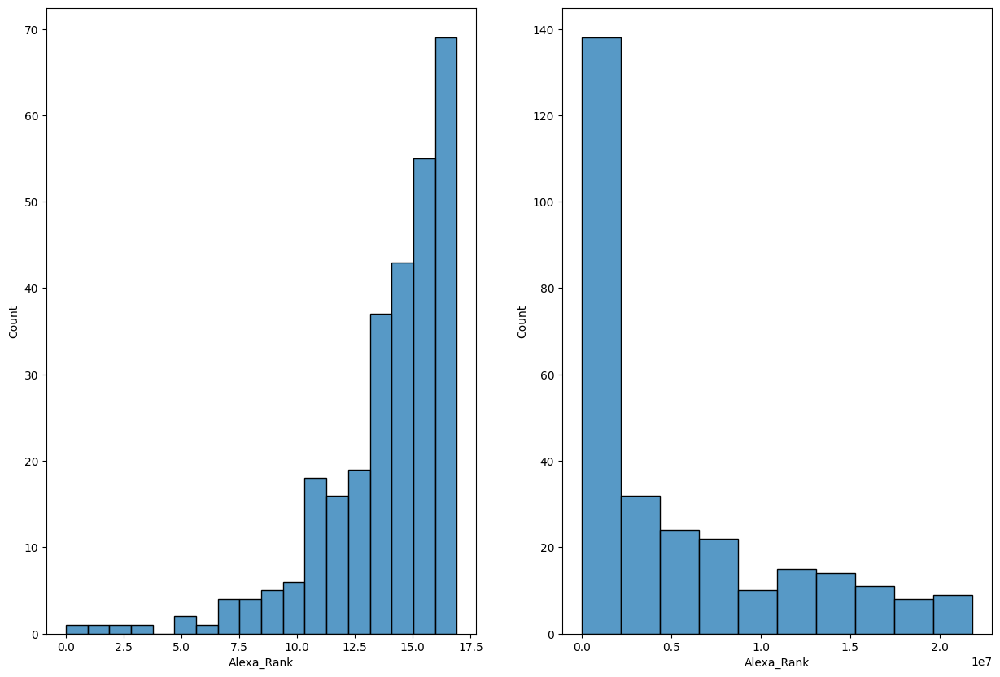

In [26]:
#We graphed the kurtosis of Alexa Rank to test for skewness
from os.path import commonpath
print(currentData['Alexa_Rank'].kurtosis())
logInv = (currentData['Alexa_Rank']-currentData['Alexa_Rank'].mean())/currentData['Alexa_Rank'].std()
fig, axs = plt.subplots(1, 2, figsize=(15, 10))
plt.subplot(1, 2, 1)
sns.histplot(np.log(currentData['Alexa_Rank']))
plt.subplot(1, 2, 2)
sns.histplot(currentData['Alexa_Rank'])
np.log(currentData['Alexa_Rank']).kurtosis()

Kurtosis

In [27]:
#Find the kurtosis of all variables of interest
currentKurtosis = currentData.select_dtypes(include=np.number)
currentKurtosis.kurtosis()

Founded_Year                                       8.081917
Revenue_(in_000s_USD)                             86.217632
Est_Marketing_Department_Budget_(in_000s_USD)    130.992717
Est_Finance_Department_Budget_(in_000s_USD)       73.310792
Est_IT_Department_Budget_(in_000s_USD)            72.644307
Est_HR_Department_Budget_(in_000s_USD)           225.733661
Employees                                        201.276473
Past_2_Year_Employee_Growth_Rate                  39.860218
Alexa_Rank                                         0.070918
Total_Funding_Amount_(in_000s_USD)                89.942488
Recent_Funding_Amount_(in_000s_USD)              147.241166
Number_of_Locations                               50.052211
dtype: float64

### Current Log Transformations

Log Transforming the quantitative variables with some exceptions:

* Founded Year: Can be considered Categorical
* Zip Code: Can be considered Categorical
* Number Loctions: Can be considered Categorical
* Growth Rate: Growth is already in a percentage basis and log transformation will curb their actual growth

In [28]:
#Perform log transformation instead of standardization on quantitative columns where kurtosis was very large as a way to account for skewness in the data.
currentLog = pd.DataFrame(currentData)
currentLog[currentLog.select_dtypes(include=np.number).columns] = np.log(currentLog[currentLog.select_dtypes(include=np.number).columns])
#Make the following exceptions:
currentLog['Founded_Year'] = currentData['Founded_Year']
currentLog['Company_Zip_Code'] = currentData['Company_Zip_Code']
currentLog['Number_of_Locations'] = currentData['Number_of_Locations']
currentLog['Past_2_Year_Employee_Growth_Rate'] = currentData['Past_2_Year_Employee_Growth_Rate']


/usr/local/lib/python3.10/dist-packages/pandas/core/internals/blocks.py:351: RuntimeWarning: divide by zero encountered in log
  result = func(self.values, **kwargs)
/usr/local/lib/python3.10/dist-packages/pandas/core/internals/blocks.py:351: RuntimeWarning: invalid value encountered in log
  result = func(self.values, **kwargs)


In [29]:
#Perform the same log transformations on the prospect dataset
prospectLog = pd.DataFrame(prospectData)
prospectLog[prospectLog.select_dtypes(include=np.number).columns] = np.log(prospectLog[prospectLog.select_dtypes(include=np.number).columns])
prospectLog['Founded_Year'] = prospectData['Founded_Year']
prospectLog['Company_Zip_Code'] = prospectData['Company_Zip_Code']
prospectLog['Number_of_Locations'] = prospectData['Number_of_Locations']
prospectLog['Past_2_Year_Employee_Growth_Rate'] = prospectData['Past_2_Year_Employee_Growth_Rate']

### Append Billing to current data set

Drop Last Month since it is highly correlated to Lifetime. Lifetime also shows a better depiction of billing history, for example a company that historically pays a lot but for their service might have not payed a lot last month making it an outlier.

Shifting values by the minimum billing coefficient to make all the values positive.

In [30]:
#Create a new billing dataset that drops last month billing columns
billing = pd.DataFrame(billingRawData)
billing = billing.drop(columns = ['Last_Month_Park Place', 'Last_Month_Boardwalk',
       'Last_Month_StJamesPlace', 'Last_Month_Marvin Gardens',
       'Last_Month_Ventnor', 'Last_Month_Kentucky', 'Last_Month_Tennessee',
       'Last_Month_Pennslyvania'])

colsLife = ['Lifetime_Park Place', 'Lifetime_Boardwalk', 'Lifetime_StJamesPlace', 'Lifetime_Marvin Gardens', 'Lifetime_Ventnor', 'Lifetime_Kentucky', 'Lifetime_Tennessee', 'Lifetime_Pennslyvania']

billing['CompanyID'] = billing['CompanyID'].astype(object)
print(billing.dtypes)

minBilling = billing[colsLife].min(axis=1).min()
shift = billing.drop(columns='CompanyID')
shift = shift + np.abs(minBilling)

sumShift = shift.sum(axis=1)
billing['Location_Number'] = shift.count(axis=1)
billing['Lifetime_Billing_Sum'] = sumShift
billing['Sum_Not_Shifted'] = billing[colsLife].sum(axis=1)
billing

CompanyID                   object
Lifetime_Park Place        float64
Lifetime_Boardwalk         float64
Lifetime_StJamesPlace      float64
Lifetime_Marvin Gardens    float64
Lifetime_Ventnor           float64
Lifetime_Kentucky          float64
Lifetime_Tennessee         float64
Lifetime_Pennslyvania      float64
dtype: object


,CompanyID,Lifetime_Park Place,Lifetime_Boardwalk,Lifetime_StJamesPlace,Lifetime_Marvin Gardens,Lifetime_Ventnor,Lifetime_Kentucky,Lifetime_Tennessee,Lifetime_Pennslyvania,Location_Number,Lifetime_Billing_Sum,Sum_Not_Shifted
0,1475361,-0.070063,0.136329,NaN,0.811350,NaN,NaN,1.753205,NaN,4,2.945098,2.630822
1,16400573,-0.033258,NaN,NaN,NaN,NaN,NaN,0.171361,NaN,2,0.295241,0.138103
2,246280,NaN,NaN,6.757425,NaN,NaN,NaN,NaN,NaN,1,6.835994,6.757425
3,43076614,NaN,NaN,13.025724,NaN,NaN,NaN,NaN,NaN,1,13.104293,13.025724
4,126828694,6.300050,1.515290,4.322832,11.780571,0.240241,0.263761,1.047302,NaN,7,26.020030,25.470047
...,...,...,...,...,...,...,...,...,...,...,...,...
323,372175531,0.005658,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,0.084227,0.005658
324,347198798,NaN,NaN,NaN,NaN,NaN,NaN,-0.027666,NaN,1,0.050903,-0.027666
325,32080939,NaN,NaN,-0.043088,NaN,NaN,NaN,NaN,NaN,1,0.035481,-0.043088
326,39371338,NaN,NaN,NaN,NaN,NaN,NaN,0.086272,NaN,1,0.164841,0.086272


In [31]:
#currentLog and billingRawData datasets are not equal (One row extra in curentLog)
x = np.array(currentLog['CompanyID'])
y = np.array(billingRawData['CompanyID'])
for i in x:
    if i not in y:
        print(i)

491442528


In [32]:
#Find this row and delete it
currentLog = currentLog.set_index('CompanyID')
currentLog = currentLog.drop(491442528)
currentLog

,Founded_Year,Revenue_(in_000s_USD),Revenue_Range_(in_USD),Est_Marketing_Department_Budget_(in_000s_USD),Est_Finance_Department_Budget_(in_000s_USD),Est_IT_Department_Budget_(in_000s_USD),Est_HR_Department_Budget_(in_000s_USD),Employees,Employee_Range,Past_2_Year_Employee_Growth_Rate,...,Ownership_Type,Business_Model,Certified_Active_Company,Total_Funding_Amount_(in_000s_USD),Recent_Funding_Amount_(in_000s_USD),Company_City,Company_State,Company_Zip_Code,Company_Country,Number_of_Locations
CompanyID,,,,,,,,,,,,,,,,,,,,,
1475361,1994.0,20.103455,Over $5 bil.,18.055512,15.498284,16.527904,15.212108,14.247942,Employees.10000plus,0.0,...,Public,B2B,Yes,10.778956,10.778956,Seattle,Washington,98109,United States,37.0
16400573,1998.0,19.363555,Over $5 bil.,17.315612,14.758385,15.788004,12.337496,11.982929,Employees.10000plus,0.0,...,Private,B2B,Yes,14.470488,14.457364,Mountain View,California,94043,United States,91.0
246280,1989.0,17.960935,Over $5 bil.,15.396985,13.355765,14.903327,14.324611,13.511699,Employees.10000plus,0.0,...,Public,B2B,Yes,14.346139,14.346139,Dublin,Leinster,D02 P820,Ireland,49.0
43076614,1999.0,19.712980,Over $5 bil.,16.717248,15.107810,16.172521,11.847796,11.034890,Employees.10000plus,7.4,...,Public,B2B,Yes,-inf,-inf,Spring,Texas,77389,United States,28.0
126828694,1983.0,18.734286,Over $5 bil.,16.220980,14.534581,15.437449,12.443620,11.630709,Employees.10000plus,0.0,...,Public,B2B,Yes,-inf,-inf,New York City,New York,10036,United States,55.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
372175531,NaN,8.281724,$1 mil. - $5 mil.,6.240276,3.663562,5.342334,3.401197,2.564949,Employees.10to19,0.0,...,Private,B2C,No,-inf,-inf,Sherwood,Oregon,97140,United States,1.0
347198798,2008.0,7.410952,$1 mil. - $5 mil.,4.890349,3.178054,4.110874,2.890372,2.079442,Employees.5to9,0.0,...,Private,B2B,Yes,-inf,-inf,Kansas City,Missouri,64106,United States,1.0
32080939,2001.0,5.446737,"Under $500,000",2.890372,1.098612,2.079442,1.386294,0.693147,Employees.1to4,0.0,...,Private,B2C,No,-inf,-inf,Atlanta,Georgia,30342,United States,1.0


In [33]:
#Merge the two datasets now that they are the same size
currentBilling = pd.merge(currentLog, billing, on = "CompanyID")

#sum of last month vs lifetime correlation plot??

colsLife = ['Lifetime_Park Place', 'Lifetime_Boardwalk', 'Lifetime_StJamesPlace', 'Lifetime_Marvin Gardens', 'Lifetime_Ventnor', 'Lifetime_Kentucky', 'Lifetime_Tennessee', 'Lifetime_Pennslyvania']

currentBilling[['CompanyID','SIC_Code_1','SIC_Code_2','NAICS_Code_1','NAICS_Code_2']] = currentBilling[['CompanyID','SIC_Code_1','SIC_Code_2','NAICS_Code_1','NAICS_Code_2']].astype('object')

#After performing log transformations on negative values, they defaulted to -inf so we want to replace those with the mean
totalFundMedian = []
for i in currentBilling['Total_Funding_Amount_(in_000s_USD)']:
  if i != -np.inf:
    totalFundMedian.append(i)

currentBilling['Total_Funding_Amount_(in_000s_USD)'] = currentBilling['Total_Funding_Amount_(in_000s_USD)'].replace(-np.inf,np.mean(totalFundMedian))

recentFundMedian = []
for j in currentBilling['Recent_Funding_Amount_(in_000s_USD)']:
  if j != -np.inf:
    recentFundMedian.append(j)
print('Recent:', np.median(recentFundMedian))
print('Total:', np.median(totalFundMedian))

currentBilling['Recent_Funding_Amount_(in_000s_USD)'] = currentBilling['Recent_Funding_Amount_(in_000s_USD)'].replace(-np.inf,np.mean(recentFundMedian))
currentBilling

Recent: 7.600902459542082
Total: 7.600902459542082


,CompanyID,Founded_Year,Revenue_(in_000s_USD),Revenue_Range_(in_USD),Est_Marketing_Department_Budget_(in_000s_USD),Est_Finance_Department_Budget_(in_000s_USD),Est_IT_Department_Budget_(in_000s_USD),Est_HR_Department_Budget_(in_000s_USD),Employees,Employee_Range,...,Lifetime_Boardwalk,Lifetime_StJamesPlace,Lifetime_Marvin Gardens,Lifetime_Ventnor,Lifetime_Kentucky,Lifetime_Tennessee,Lifetime_Pennslyvania,Location_Number,Lifetime_Billing_Sum,Sum_Not_Shifted
0,1475361,1994.0,20.103455,Over $5 bil.,18.055512,15.498284,16.527904,15.212108,14.247942,Employees.10000plus,...,0.136329,NaN,0.811350,NaN,NaN,1.753205,NaN,4,2.945098,2.630822
1,16400573,1998.0,19.363555,Over $5 bil.,17.315612,14.758385,15.788004,12.337496,11.982929,Employees.10000plus,...,NaN,NaN,NaN,NaN,NaN,0.171361,NaN,2,0.295241,0.138103
2,246280,1989.0,17.960935,Over $5 bil.,15.396985,13.355765,14.903327,14.324611,13.511699,Employees.10000plus,...,NaN,6.757425,NaN,NaN,NaN,NaN,NaN,1,6.835994,6.757425
3,43076614,1999.0,19.712980,Over $5 bil.,16.717248,15.107810,16.172521,11.847796,11.034890,Employees.10000plus,...,NaN,13.025724,NaN,NaN,NaN,NaN,NaN,1,13.104293,13.025724
4,126828694,1983.0,18.734286,Over $5 bil.,16.220980,14.534581,15.437449,12.443620,11.630709,Employees.10000plus,...,1.515290,4.322832,11.780571,0.240241,0.263761,1.047302,NaN,7,26.020030,25.470047
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
323,372175531,NaN,8.281724,$1 mil. - $5 mil.,6.240276,3.663562,5.342334,3.401197,2.564949,Employees.10to19,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,1,0.084227,0.005658
324,347198798,2008.0,7.410952,$1 mil. - $5 mil.,4.890349,3.178054,4.110874,2.890372,2.079442,Employees.5to9,...,NaN,NaN,NaN,NaN,NaN,-0.027666,NaN,1,0.050903,-0.027666
325,32080939,2001.0,5.446737,"Under $500,000",2.890372,1.098612,2.079442,1.386294,0.693147,Employees.1to4,...,NaN,-0.043088,NaN,NaN,NaN,NaN,NaN,1,0.035481,-0.043088
326,39371338,2002.0,7.573531,$1 mil. - $5 mil.,5.525453,2.944439,3.988984,3.526361,2.708050,Employees.10to19,...,NaN,NaN,NaN,NaN,NaN,0.086272,NaN,1,0.164841,0.086272


### Try Linear Regression

In [34]:
#Import data libraries
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split #Split data in testing and training
from sklearn import metrics

In [35]:
# Linear Regression With Quatitative Variables
regQuantData = currentBilling.select_dtypes(include = ['float64','int64'])
#Drop the following columns (dropped individual lifetime columns since they are incorporated by the new lifetime_Billing_Sums column)
regQuantData = regQuantData.drop(columns = ['Sum_Not_Shifted','Founded_Year','Lifetime_Park Place','Lifetime_Boardwalk','Lifetime_StJamesPlace','Lifetime_Marvin Gardens','Lifetime_Ventnor','Lifetime_Kentucky', 'Lifetime_Tennessee', 'Lifetime_Pennslyvania'])
regQuantData = regQuantData.dropna()

In [36]:
#Declare response and predictor variables
X = regQuantData.drop(['Lifetime_Billing_Sum'],axis=1)
y = regQuantData['Lifetime_Billing_Sum']

In [37]:
# 80/20 Train/Test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=5)

In [38]:
#Fit the model and interpret the coefficients
Reg = LinearRegression()
Reg.fit(X_train, y_train)

y_pred_Train = Reg.predict(X_train) #Predictions on training model
y_pred_Test  = Reg.predict(X_test)  #Predictions on testing model

print('Intercept:',Reg.intercept_)
print('Coefficients:', Reg.coef_)

Intercept: -4.185326221984562
Coefficients: [-2.88216115e-01  1.70040247e+00 -3.40749859e-01 -6.30613384e-01
 -1.73529262e+00  1.61619317e+00  1.53988551e-03  1.56672238e-01
 -5.87980981e-02 -2.96793492e-02  1.37196781e-02  7.28676266e-01]


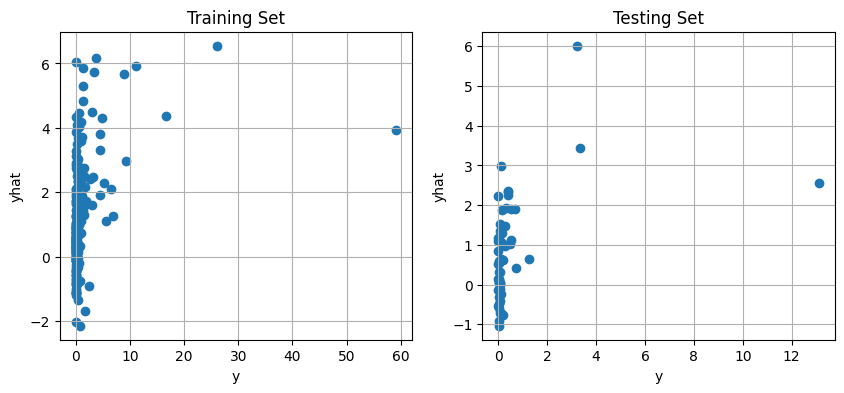

In [39]:
#Two plots togheter... one for training data, one for testing data

fig, ax = plt.subplots(ncols=2, figsize=(10,4))

ax[0].scatter(y_train, y_pred_Train)
#ax[0].set_ylim(0,25)
#ax[0].set_xlim(0,25)
ax[0].grid()
ax[0].set_xlabel('y')
ax[0].set_ylabel('yhat')
ax[0].set_title('Training Set')


ax[1].scatter(y_test, y_pred_Test)
#ax[1].set_ylim(0,25)
#ax[1].set_xlim(0,25)
ax[1].grid()
ax[1].set_xlabel('y')
ax[1].set_ylabel('yhat')
ax[1].set_title('Testing Set')
plt.show()

In [40]:
#Print all the necessary regression metrics
print('Training Metrics:')
print('R squared:', metrics.r2_score(y_train, y_pred_Train))


print('Testing Metrics:')
print('R squared:', metrics.r2_score(y_test, y_pred_Test))

Training Metrics:
R squared: 0.12483585504569927
Testing Metrics:
R squared: 0.050545087871538774


In [41]:
# Import a library that prints the OLS statistics. VERY USEFUl
import statsmodels.api as sm
sm.add_constant(X)
est = sm.OLS(y, X).fit()
est.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                  OLS Regression Results                                 
=========================================================================================
Dep. Variable:     Lifetime_Billing_Sum   R-squared (uncentered):                   0.173
Model:                              OLS   Adj. R-squared (uncentered):              0.136
Method:                   Least Squares   F-statistic:                              4.623
Date:                  Mon, 18 Dec 2023   Prob (F-statistic):                    8.26e-07
Time:                          20:38:06   Log-Likelihood:                         -775.08
No. Observations:                   277   AIC:                                      1574.
Df Residuals:                       265   BIC:                                      1618.
Df Model:                            12                                                  
Covariance Type:              nonrobust                                                  
=================================================================================================================
                                                    coef    std err          t      P>|t|      [0.025      0.975]
-----------------------------------------------------------------------------------------------------------------
Revenue_(in_000s_USD)                            -1.1191      0.786     -1.423      0.156      -2.668       0.429
Est_Marketing_Department_Budget_(in_000s_USD)     1.4788      0.740      1.998      0.047       0.021       2.936
Est_Finance_Department_Budget_(in_000s_USD)       0.2404      0.733      0.328      0.743      -1.203       1.684
Est_IT_Department_Budget_(in_000s_USD)           -0.1369      0.870     -0.157      0.875      -1.850       1.576
Est_HR_Department_Budget_(in_000s_USD)           -1.5726      1.367     -1.150      0.251      -4.264       1.119
Employees                                         1.4384      1.303      1.104      0.271      -1.127       4.004
Past_2_Year_Employee_Growth_Rate                  0.0019      0.008      0.230      0.818      -0.014       0.018
Alexa_Rank                                        0.1166      0.123      0.949      0.344      -0.125       0.359
Total_Funding_Amount_(in_000s_USD)               -0.1477      0.359     -0.411      0.681      -0.855       0.559
Recent_Funding_Amount_(in_000s_USD)               0.0528      0.399      0.132      0.895      -0.733       0.838
Number_of_Locations                               0.0111      0.010      1.143      0.254      -0.008       0.030
Location_Number                                   0.6479      0.204      3.171      0.002       0.246       1.050
==============================================================================
Omnibus:                      507.909   Durbin-Watson:                   1.849
Prob(Omnibus):                  0.000   Jarque-Bera (JB):           225832.905
Skew:                          10.509   Prob(JB):                         0.00
Kurtosis:                     141.293   Cond. No.                         313.
==============================================================================

Notes:
[1] R² is computed without centering (uncentered) since the model does not contain a constant.
[2] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

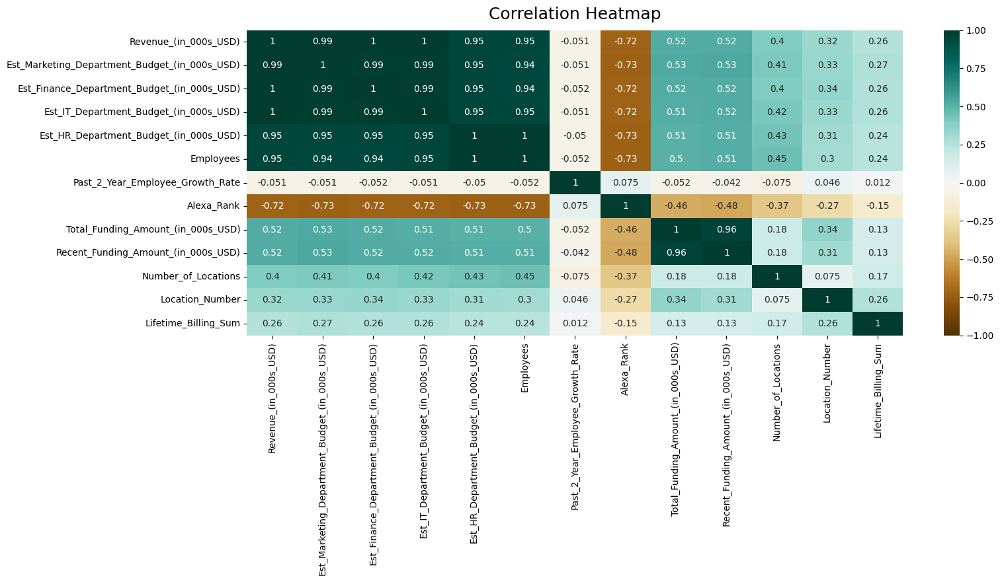

In [42]:
#Check for multicollinearity with correlation heat map
plt.figure(figsize=(16, 6))
heatmap = sns.heatmap(regQuantData.corr(), vmin=-1, vmax=1, annot=True, cmap='BrBG')
heatmap.set_title('Correlation Heatmap', fontdict={'fontsize':18}, pad=12);
# save heatmap as .png file
# dpi - sets the resolution of the saved image in dots/inches
# bbox_inches - when set to 'tight' - does not allow the labels to be cropped
plt.savefig('heatmap.png', dpi=300, bbox_inches='tight')

In [43]:
# 80/20 Train/Test split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=5)

In [44]:
#Run the model again with a different set of features... compare results (These OLS models are work in progress)
import statsmodels.api as sm
regQuantData2 = pd.DataFrame(regQuantData)
regQuantData2 = regQuantData2.drop(columns = ['Est_Marketing_Department_Budget_(in_000s_USD)','Est_Finance_Department_Budget_(in_000s_USD)','Revenue_(in_000s_USD)','Est_HR_Department_Budget_(in_000s_USD)','Employees'])

X = regQuantData2.drop(['Lifetime_Billing_Sum'],axis=1)
y = regQuantData2['Lifetime_Billing_Sum']

sm.add_constant(X)
est = sm.OLS(y, X).fit()
est.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                                  OLS Regression Results                                 
=========================================================================================
Dep. Variable:     Lifetime_Billing_Sum   R-squared (uncentered):                   0.153
Model:                              OLS   Adj. R-squared (uncentered):              0.131
Method:                   Least Squares   F-statistic:                              6.952
Date:                  Mon, 18 Dec 2023   Prob (F-statistic):                    1.28e-07
Time:                          20:38:12   Log-Likelihood:                         -778.45
No. Observations:                   277   AIC:                                      1571.
Df Residuals:                       270   BIC:                                      1596.
Df Model:                             7                                                  
Covariance Type:              nonrobust                                                  
==========================================================================================================
                                             coef    std err          t      P>|t|      [0.025      0.975]
----------------------------------------------------------------------------------------------------------
Est_IT_Department_Budget_(in_000s_USD)     0.2159      0.108      1.991      0.047       0.002       0.429
Past_2_Year_Employee_Growth_Rate           0.0017      0.008      0.205      0.837      -0.015       0.018
Alexa_Rank                                -0.0514      0.049     -1.060      0.290      -0.147       0.044
Total_Funding_Amount_(in_000s_USD)        -0.1149      0.359     -0.320      0.749      -0.821       0.591
Recent_Funding_Amount_(in_000s_USD)       -0.0211      0.391     -0.054      0.957      -0.790       0.748
Number_of_Locations                        0.0126      0.009      1.357      0.176      -0.006       0.031
Location_Number                            0.6719      0.200      3.353      0.001       0.277       1.066
==============================================================================
Omnibus:                      519.832   Durbin-Watson:                   1.894
Prob(Omnibus):                  0.000   Jarque-Bera (JB):           257718.019
Skew:                          10.993   Prob(JB):                         0.00
Kurtosis:                     150.804   Cond. No.                         79.5
==============================================================================

Notes:
[1] R² is computed without centering (uncentered) since the model does not contain a constant.
[2] Standard Errors assume that the covariance matrix of the errors is correctly specified.
"""

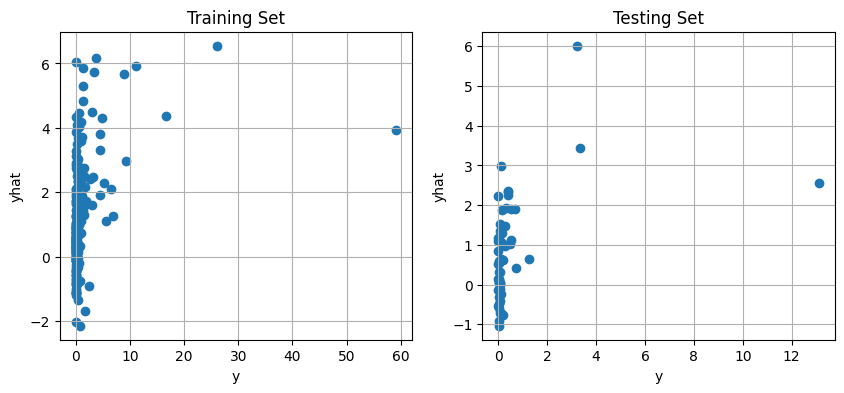

In [45]:
#Two plots togheter... one for training data, one for testing data

fig, ax = plt.subplots(ncols=2, figsize=(10,4))

ax[0].scatter(y_train, y_pred_Train)
#ax[0].set_ylim(0,25)
#ax[0].set_xlim(0,25)
ax[0].grid()
ax[0].set_xlabel('y')
ax[0].set_ylabel('yhat')
ax[0].set_title('Training Set')


ax[1].scatter(y_test, y_pred_Test)
#ax[1].set_ylim(0,25)
#ax[1].set_xlim(0,25)
ax[1].grid()
ax[1].set_xlabel('y')
ax[1].set_ylabel('yhat')
ax[1].set_title('Testing Set')
plt.show()

### Try Clustering

In [46]:
!pip install kmodes

In [47]:
#Import libraries for clustering
from kmodes.kprototypes import KPrototypes
from sklearn import preprocessing
from sklearn.preprocessing import StandardScaler

In [48]:
# Process data to convert numeric data to floats or ints
clustersData = pd.DataFrame(currentBilling)
clustersData = clustersData.select_dtypes(include = ['float64','int64']).drop(columns = ['Lifetime_Billing_Sum','Lifetime_Park Place',	'Lifetime_Boardwalk',	'Lifetime_StJamesPlace',	'Lifetime_Marvin Gardens',	'Lifetime_Ventnor',	'Lifetime_Kentucky',	'Lifetime_Tennessee',	'Lifetime_Pennslyvania'])

In [49]:
#clustersData['Unshifted_Lifetime_Billing_Sum'] = clustersData['Lifetime_Billing_Sum'] - billingMin
#clustersData['Label'] = clustersData['Unshifted_Lifetime_Billing_Sum']

#Create a binary classification label column that could be used in logistic regression as well
# This column checks reflects a 1 if Lifetime_Billing_Sum is greater than the billing minimum indicating that the company at hand gets billed higher than average and 0 if the company gets billed lower than average
clustersData['Label'] = clustersData['Sum_Not_Shifted']

for i in range(len(clustersData['Label'])):
  if clustersData.iloc[i,-1] > 0:
    clustersData.iloc[i,-1] = 1
  else:
    clustersData.iloc[i,-1] = 0

#### K-Means

In [50]:
#Create a new dataset that fills N/As for Alexa Rank
kmeansData = clustersData

kmeansData['Alexa_Rank'] = kmeansData['Alexa_Rank'].fillna(kmeansData['Alexa_Rank'].median())
print(kmeansData.isnull().sum())

Founded_Year                                     18
Revenue_(in_000s_USD)                             0
Est_Marketing_Department_Budget_(in_000s_USD)     2
Est_Finance_Department_Budget_(in_000s_USD)       2
Est_IT_Department_Budget_(in_000s_USD)            2
Est_HR_Department_Budget_(in_000s_USD)            0
Employees                                         0
Past_2_Year_Employee_Growth_Rate                  0
Alexa_Rank                                        0
Total_Funding_Amount_(in_000s_USD)                0
Recent_Funding_Amount_(in_000s_USD)               0
Number_of_Locations                               8
Location_Number                                   0
Sum_Not_Shifted                                   0
Label                                             0
dtype: int64


Founded_Year                                     18
Revenue_(in_000s_USD)                             0
Est_Marketing_Department_Budget_(in_000s_USD)     2
Est_Finance_Department_Budget_(in_000s_USD)       2
Est_IT_Department_Budget_(in_000s_USD)            2
Est_HR_Department_Budget_(in_000s_USD)            0
Employees                                         0
Past_2_Year_Employee_Growth_Rate                  0
Alexa_Rank                                        0
Total_Funding_Amount_(in_000s_USD)                0
Recent_Funding_Amount_(in_000s_USD)               0
Number_of_Locations                               8
Location_Number                                   0
Sum_Not_Shifted                                   0
Label                                             0
dtype: int64
(328, 15)
(304, 15)
[0.57367743 0.12013264 0.08245201]


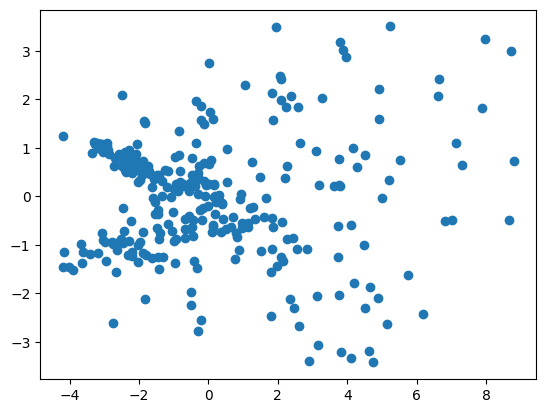

In [51]:
# import the sklearn module to do PCA Analysis
from sklearn.decomposition import PCA

# Normalize data as a requirement for PCA (x-mean)/std
norm = (kmeansData-kmeansData.mean())/kmeansData.std()
print(norm.isnull().sum())
print(norm.shape)
norm = norm.dropna()
print(norm.shape)
#norm = norm<2
# Use only the two PC for plotting purposes
principal = PCA(n_components=3)

principal.fit(norm.iloc[:,:-2]) # Projecting the data to the PC

print(principal.explained_variance_ratio_)
# Transforming the data
trans = principal.transform(norm.iloc[:,:-2])


plt.scatter(trans[:,0],trans[:,1])

In [52]:
from sklearn.cluster import KMeans # Import k means module
k = KMeans(n_clusters=2) #Inizialize an k means object with 3 clusters
k.fit(norm.iloc[:,:-2]) #Use the method to find the kmean clusters from our data
kmClusters = k.fit_predict(norm.iloc[:,:-2]) #Saving the centroids or clusters


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


In [53]:
# Create a data frame to include all the clusters from the different methods
kmeans = {'km':list(kmClusters)}
clusters = pd.DataFrame(kmeans) # Include the predetermined cluster

clusters

,km
0,0
1,0
2,0
3,0
4,0
...,...
299,1
300,1
301,1
302,1


#### Agglomerative Hierarchical Clustering

In [54]:
from sklearn.cluster import AgglomerativeClustering #import module to do AHC

# initialize ahcModel as an Agglomerative Hierarchical Clustering object
ahcModel = AgglomerativeClustering(n_clusters=2, affinity = 'euclidean', linkage = 'ward')
# Fitting the model using method in the object with specified 3 clusters and using the euclidean distances
ahcClusters = ahcModel.fit_predict(norm.iloc[:,:-2])

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_agglomerative.py:983: FutureWarning: Attribute `affinity` was deprecated in version 1.2 and will be removed in 1.4. Use `metric` instead
  warnings.warn(


In [55]:
# Include the AHC Clusters to the Clusters Data Frame
clusters['AHC'] = ahcClusters # Include KMeans
clusters

,km,AHC
0,0,1
1,0,1
2,0,1
3,0,1
4,0,1
...,...,...
299,1,0
300,1,0
301,1,0
302,1,0


#### Affinity Propagation

In [56]:
from sklearn.cluster import AffinityPropagation #import module to do AP

# Fit the Affinity model using our data
apModel = AffinityPropagation().fit(norm.iloc[:,:-2])

# Retrieve the clusters list
apClusters = apModel.cluster_centers_indices_

# Checking for the number of clusters the model found necessary
numberClusters = len(apClusters)
print('Number of clusters from AP model:', numberClusters)

Number of clusters from AP model: 23


In [57]:
# Add the AP to the cluster data frame
clusters['AP'] = apModel.labels_ # Include Affinity Propagation
clusters

,km,AHC,AP
0,0,1,1
1,0,1,0
2,0,1,0
3,0,1,2
4,0,1,1
...,...,...,...
299,1,0,22
300,1,0,22
301,1,0,22
302,1,0,22


#### Spectral Clustering

In [58]:
from sklearn.cluster import SpectralClustering #import module to do AP

# Initialize a Spectral Clustering object and using a method to fit the data from wine to the model
scModel = SpectralClustering(n_clusters=2).fit(norm.iloc[:,:-2]) # Fit the model

# Retrieve the clusters list
scClusters = scModel.labels_

In [59]:
# Add the SC to the cluster data frame
clusters['SC'] = scClusters # Include Spectral Clustering Model clusters
clusters

,km,AHC,AP,SC
0,0,1,1,0
1,0,1,0,0
2,0,1,0,0
3,0,1,2,0
4,0,1,1,0
...,...,...,...,...
299,1,0,22,0
300,1,0,22,0
301,1,0,22,0
302,1,0,22,0


#### DBSCAN

In [60]:
from sklearn.cluster import DBSCAN #Import the module DBSCAN from sklearn

# Fit the wine data to find clusters
dbModel = DBSCAN(eps=2.8, min_samples=26).fit(norm.iloc[:,:-2]) #Tune min_samples and epsilon

# Noisy data gets -ive values so we want to shift the data to positive axis
dbClusters = dbModel.labels_ +1

In [61]:
# Add the DBScan to the cluster data frame
clusters['DBS'] = dbClusters # Include DBSCAN
clusters

,km,AHC,AP,SC,DBS
0,0,1,1,0,0
1,0,1,0,0,0
2,0,1,0,0,0
3,0,1,2,0,0
4,0,1,1,0,0
...,...,...,...,...,...
299,1,0,22,0,1
300,1,0,22,0,1
301,1,0,22,0,1
302,1,0,22,0,1


#### Cluster Plots

<ipython-input-62-abfd49cd4cef>:6: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(2, 3, 1)
<ipython-input-62-abfd49cd4cef>:12: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(2, 3, 2)
<ipython-input-62-abfd49cd4cef>:26: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(2, 3, 4)
<ipython-input-62-abfd49cd4cef>:31: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  plt.subplot(2, 3, 5)


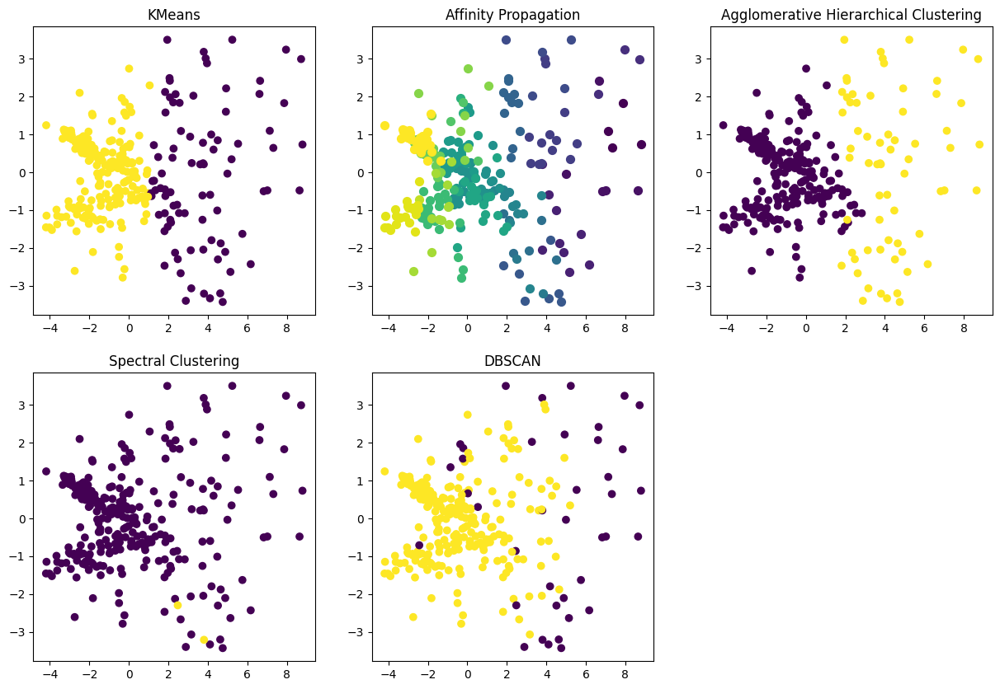

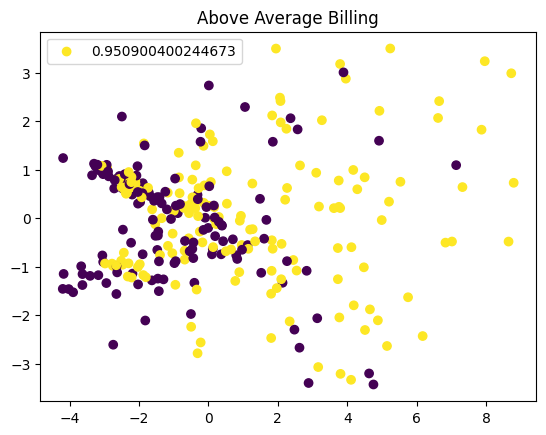

In [62]:
# Creating a matrix of subplots
fig, axs = plt.subplots(2, 2, figsize=(15, 10))


# Plotting the points colored by the K means cluster model
plt.subplot(2, 3, 1)
plt.scatter(trans[:,0],trans[:,1], c = kmClusters)
plt.title('KMeans')


# Plotting the points colored by the Affinity Propagation model
plt.subplot(2, 3, 2)
colorPalette= plt.get_cmap('viridis')
colors = iter(colorPalette(np.linspace(0,1,numberClusters))) #Creating and iterative

for i in range(numberClusters):
    plt.scatter(trans[apModel.labels_ ==i,0], trans[apModel.labels_ == i,1], s=50, color=next(colors))
    plt.title("Affinity Propagation")

# Plotting the points colored by the Agglomerative Hierarchical Clustering model
plt.subplot(2, 3, 3)
plt.scatter(trans[:,0],trans[:,1], c = ahcClusters)
plt.title('Agglomerative Hierarchical Clustering')

# Plotting the points colored by the Spectral clusters
plt.subplot(2, 3, 4)
plt.scatter(trans[:,0],trans[:,1], c = scModel.labels_)
plt.title('Spectral Clustering')

# Plotting the points colored by the DBSCAN clusters
plt.subplot(2, 3, 5)
plt.scatter(trans[...,0],trans[...,1], c = dbModel.labels_)
plt.title('DBSCAN')
plt.show()

plt.scatter(trans[...,0],trans[...,1], c = norm.iloc[:,-1])
plt.legend(labels=norm.iloc[:,-1])
plt.title('Above Average Billing')
plt.show()

## Sprint 3

In [63]:
# Import the necessary Python libraries for EDA
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import scipy
from scipy import stats
import seaborn as sns
from scipy import stats

In [64]:
# We use pandas to store the csv as data frames
currentRawData = pd.read_csv(r"current_customers.csv")#Store the data of current customers in this data frame
prospectRawData = pd.read_csv(r"prospect_list.csv") #Store the data of prospect customers in this data frame
billingRawData = pd.read_csv(r"current_billing.csv")#Store the data of current customers in this data frame
dataDictionaryNetrality = pd.read_csv(r"Data_Dictionary_Netrality.csv") #Store the data of prospect customers in this data frame

### Process Current Dataset

In [65]:
# Create a new feature IT_Budget_Ratio
x = ['Est_Marketing_Department_Budget_(in_000s_USD)',
       'Est_Finance_Department_Budget_(in_000s_USD)',
       'Est_IT_Department_Budget_(in_000s_USD)',
       'Est_HR_Department_Budget_(in_000s_USD)']

# Create a new feature IT_Budget_Ratio that is the ratio of budget allocated to IT
currentRawData['IT_Budget_Ratio'] = (currentRawData['Est_IT_Department_Budget_(in_000s_USD)'])/(currentRawData[x].sum(axis=1))

# Drop features that are not needed
currentData = currentRawData.drop(columns =
        ['Est_Marketing_Department_Budget_(in_000s_USD)',
       'Est_Finance_Department_Budget_(in_000s_USD)',
       'Est_IT_Department_Budget_(in_000s_USD)',
       'Est_HR_Department_Budget_(in_000s_USD)',
        'Revenue_Range_(in_USD)','Employee_Range',
        'Recent_Funding_Amount_(in_000s_USD)',
        'Employees',
       'Alexa_Rank','Current_Customer',
        'Past_1_Year_Employee_Growth_Rate',
        'SIC_Codes',
      'NAICS_Codes',
        'Primary_Industry',
        'Primary_Sub-Industry',
        'All_Industries','All_Sub-Industries',
        'Secondary_Industry_Hierarchical_Category',
        'Company_Is_Acquired',
        'Recent_Funding_Round',
        'Recent_Funding_Date',
        'Certification_Date',
        'Recent_Investors',
        'All_Investors','Company_City','Company_Zip_Code'])

# There is an extra company in the current dataset compared to Billing
currentData = currentData[currentData.CompanyID != 491442528]

# Make this features categorical variables by making them object types
currentData[['CompanyID','SIC_Code_1','SIC_Code_2','NAICS_Code_1','NAICS_Code_2']] = currentData[['CompanyID','SIC_Code_1','SIC_Code_2','NAICS_Code_1','NAICS_Code_2']].astype('object')

#Perform cubic root transformation on the data
currentLog = pd.DataFrame(currentData)
currentLog[currentLog.select_dtypes(include=np.number).columns] = np.power(currentLog[currentLog.select_dtypes(include=np.number).columns],1/3)
# Change founded year to age of company (2023-founded year)
currentLog['Founded_Year'] = 2023-currentData['Founded_Year']
currentLog['Number_of_Locations'] = currentData['Number_of_Locations']
currentLog['Past_2_Year_Employee_Growth_Rate'] = currentData['Past_2_Year_Employee_Growth_Rate']
currentLog['IT_Budget_Ratio'] = currentData['IT_Budget_Ratio']

# Fill NAs to the mean
meanYear = int(currentLog['Founded_Year'].mean())
currentLog['Founded_Year'] = currentLog['Founded_Year'].fillna(meanYear)

### Append Billing to current data set

Drop Last Month since it is highly correlated to Lifetime. Lifetime also shows a better depiction of billing history, for example a company that historically pays a lot but for their service might have not payed a lot last month making it an outlier.

Shifting values by the minimum billing coefficient to make all the values positive.

In [66]:
#Create a new billing dataset that drops last month billing columns
billing = pd.DataFrame(billingRawData)
billing = billing.drop(columns = ['Last_Month_Park Place', 'Last_Month_Boardwalk',
       'Last_Month_StJamesPlace', 'Last_Month_Marvin Gardens',
       'Last_Month_Ventnor', 'Last_Month_Kentucky', 'Last_Month_Tennessee',
       'Last_Month_Pennslyvania'])

colsLife = ['Lifetime_Park Place', 'Lifetime_Boardwalk', 'Lifetime_StJamesPlace', 'Lifetime_Marvin Gardens', 'Lifetime_Ventnor', 'Lifetime_Kentucky', 'Lifetime_Tennessee', 'Lifetime_Pennslyvania']

# Make CompanyID an object
billing['CompanyID'] = billing['CompanyID'].astype(object)

# Create a new feature in billing sum of shifted billings columns (added smallest billing
# to all the variables to make the positive)
minBilling = billing[colsLife].min(axis=1).min()
shift = billing.drop(columns='CompanyID')
shift = shift + np.abs(minBilling)

sumShift = shift.sum(axis=1)
billing['Lifetime_Billing_Sum'] = sumShift

# Create a sum of columns (no shifting)
billing['Sum_Not_Shifted'] = billing[colsLife].sum(axis=1)

In [67]:
#Merge the two datasets now that they are the same size
currentBilling = pd.merge(currentLog, billing, on = "CompanyID")

#sum of last month vs lifetime correlation plot??

colsLife = ['Lifetime_Park Place', 'Lifetime_Boardwalk', 'Lifetime_StJamesPlace', 'Lifetime_Marvin Gardens', 'Lifetime_Ventnor', 'Lifetime_Kentucky', 'Lifetime_Tennessee', 'Lifetime_Pennslyvania']

currentBilling[['CompanyID','SIC_Code_1','SIC_Code_2','NAICS_Code_1','NAICS_Code_2']] = currentBilling[['CompanyID','SIC_Code_1','SIC_Code_2','NAICS_Code_1','NAICS_Code_2']].astype('object')

#After performing log transformations on negative values, they defaulted to -inf so we want to replace those with the mean
totalFundMedian = []
for i in currentBilling['Total_Funding_Amount_(in_000s_USD)']:
  if i != -np.inf:
    totalFundMedian.append(i)

currentBilling['Total_Funding_Amount_(in_000s_USD)'] = currentBilling['Total_Funding_Amount_(in_000s_USD)'].replace(-np.inf,0)
currentBilling = currentBilling.drop(columns = colsLife)

In [68]:
currentBilling['Label'] = pd.Series(currentBilling['Sum_Not_Shifted'])

for i in range(len(currentBilling)):
    if currentBilling['Sum_Not_Shifted'].iloc[i]>0:
        currentBilling['Label'].iloc[i] = 1
    else:
        currentBilling['Label'].iloc[i] = 0

<ipython-input-68-837e4dd03fad>:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  currentBilling['Label'].iloc[i] = 1
<ipython-input-68-837e4dd03fad>:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  currentBilling['Label'].iloc[i] = 0


In [69]:
finalCurrent = pd.DataFrame(currentBilling)

### Process Prospect DataSet

In [70]:
# Create a new feature IT_Budget_Ratio
x = ['Est_Marketing_Department_Budget_(in_000s_USD)',
       'Est_Finance_Department_Budget_(in_000s_USD)',
       'Est_IT_Department_Budget_(in_000s_USD)',
       'Est_HR_Department_Budget_(in_000s_USD)']

# Create a new feature IT_Budget_Ratio that is the ratio of budget allocated to IT
prospectRawData['IT_Budget_Ratio'] = (prospectRawData['Est_IT_Department_Budget_(in_000s_USD)'])/(prospectRawData[x].sum(axis=1))

# Drop features that will not be needed in the dataset
prospectData = prospectRawData.drop(columns =
        ['Company_HQ_Phone',
         'Fax',
         'Est_Marketing_Department_Budget_(in_000s_USD)',
       'Est_Finance_Department_Budget_(in_000s_USD)',
       'Est_IT_Department_Budget_(in_000s_USD)',
       'Est_HR_Department_Budget_(in_000s_USD)',
        'Revenue_Range_(in_USD)','Employee_Range',
        'Recent_Funding_Amount_(in_000s_USD)',
        'Employees',
       'Alexa_Rank','Current_Customer',
        'Past_1_Year_Employee_Growth_Rate',
        'SIC_Codes',
      'NAICS_Codes',
        'Primary_Industry',
        'Primary_Sub-Industry',
        'All_Industries','All_Sub-Industries',
        'Secondary_Industry_Hierarchical_Category',
        'Company_Is_Acquired',
        'Recent_Funding_Round',
        'Recent_Funding_Date',
        'Certification_Date',
        'Recent_Investors',
        'All_Investors','Company_City','Company_Zip_Code'])

#Find this row and delete it
prospectData = prospectData[prospectData.CompanyID != 491442528]
prospectData = prospectData[prospectData.Industry_Hierarchical_Category != 'mm']

# Make this features categorical variables by making them object types
prospectData[['CompanyID','SIC_Code_1','SIC_Code_2','NAICS_Code_1','NAICS_Code_2']] = prospectData[['CompanyID','SIC_Code_1','SIC_Code_2','NAICS_Code_1','NAICS_Code_2']].astype('object')
prospectMeanYear = int(currentLog['Founded_Year'].mean())
prospectData['Founded_Year'] = 2023 - prospectData['Founded_Year'].fillna(prospectMeanYear)

In [71]:
#Perform log transformation instead of standardization on quantitative columns where kurtosis was very large as a way to account for skewness in the data.
prospectLog = pd.DataFrame(prospectData)
prospectLog[prospectLog.select_dtypes(include=np.number).columns] = np.power(prospectLog[prospectLog.select_dtypes(include=np.number).columns],1/3)

# Set founded year, number of locations, growth rate and IT ratio to original value
prospectLog['Founded_Year'] = prospectData['Founded_Year']
prospectLog['Number_of_Locations'] = prospectData['Number_of_Locations']
prospectLog['Past_2_Year_Employee_Growth_Rate'] = prospectData['Past_2_Year_Employee_Growth_Rate']
prospectLog['IT_Budget_Ratio'] = prospectData['IT_Budget_Ratio']

# Set null founded year entries equal to the mean
meanYear = prospectLog['Founded_Year'].mean()
prospectLog[prospectLog['Founded_Year'].isnull()] = meanYear

In [72]:
finalProspect = pd.DataFrame(prospectLog)

### Implement Logistic Regression

In [73]:
# Function that one hot encodes dataset
def to_dummies(data):

    #data = data.drop(columns = exclude)
    catColumns = list(data.select_dtypes(include =  object).columns)
    for i in catColumns:
        dummy = pd.get_dummies(data[i],drop_first = True)
        data = data.drop(columns = i)
        data = pd.concat([data,dummy],axis = 1)

    return data

In [74]:
# Import Libraries for Logistic Regression
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import classification_report, confusion_matrix
from sklearn.model_selection import train_test_split
from sklearn import metrics
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

***Our Dataset for Logistic Regression***

In [75]:
# Set company Id as the index so it is easier to reference in the future
# And is not taken into account in the model
LogisticCurrent = finalCurrent.set_index('CompanyID',drop = True)

# After running the code multiple times the model
# improved afetr the exclusion of this columns
LogisticCurrent = LogisticCurrent.drop(columns = ['Company_State','Company_Country','SIC_Code_1','SIC_Code_2','NAICS_Code_1','NAICS_Code_2'])

# One hot encode the categorical variables
LogisticCurrent = to_dummies(LogisticCurrent)

# This labels are not needed for this model
LogisticCurrent = LogisticCurrent.drop(columns = ['Sum_Not_Shifted','Lifetime_Billing_Sum'])

# Remove any NAs that were still in the dataset
LogisticCurrent = LogisticCurrent.dropna()

In [76]:
# Save the features and the label in two different matrices
X = LogisticCurrent.drop(columns = ['Label'])# Features
y = LogisticCurrent['Label'] # Target variable
X.columns = X.columns.astype(str)

In [77]:
# Split Data
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.25, random_state=0)

#Notice that 25% will go for testing

In [78]:
# We train the model
logistic = LogisticRegression().fit(X_train,y_train) #Previous ones in one step

# We predict the test data
y_pred=logistic.predict(X_test)

# Print the confusion matrix
Confusion_matrix = metrics.confusion_matrix(y_test, y_pred)
Confusion_matrix

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


array([[22, 12],
       [19, 27]])

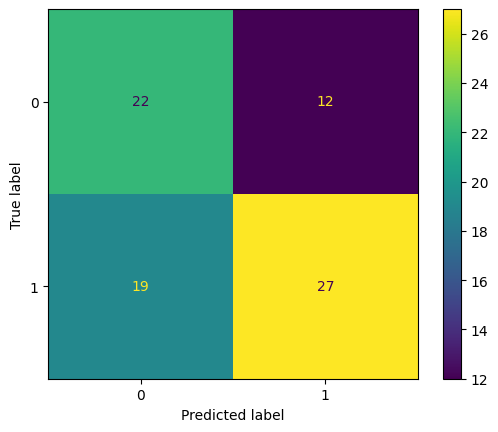

In [79]:
ConfusionMatrixDisplay(Confusion_matrix ).plot()
plt.show()

In [80]:
print("Accuracy:")
print(metrics.accuracy_score(y_test, y_pred))
print("Precision:")
print(metrics.precision_score(y_test, y_pred))
print("Recall:")
print(metrics.recall_score(y_test, y_pred))
#print(logistic.coef_ , logistic.intercept_)

Accuracy:
0.6125
Precision:
0.6923076923076923
Recall:
0.5869565217391305


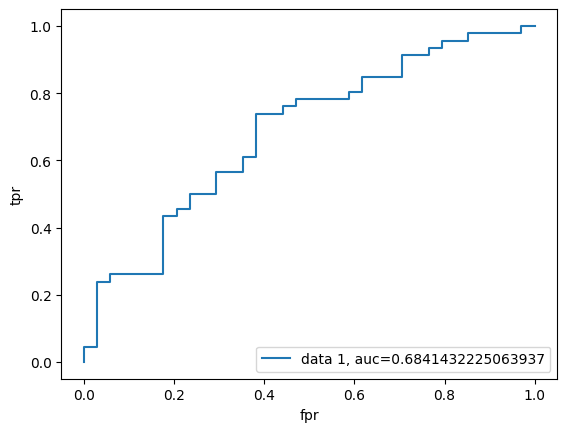

In [81]:
y_pred_proba = logistic.predict_proba(X_test)[::,1] #Get probailities

fpr, tpr, _ = metrics.roc_curve(y_test,  y_pred_proba)
auc = metrics.roc_auc_score(y_test, y_pred_proba)

plt.plot(fpr,tpr,label="data 1, auc="+str(auc))
plt.ylabel('tpr')
plt.xlabel('fpr')
plt.legend(loc=4)
plt.show()

Streaming output truncated to the last 5000 lines.
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/li

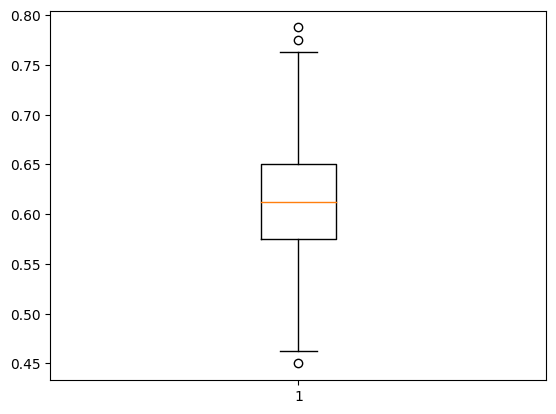

In [82]:
# Run the model 1000 times
acc = [] #Empty list

for i in range(1000): #10 repetitions
    X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.25) #no random seed
    logistic = LogisticRegression(max_iter=200) #Reseting the function
    logistic.fit(X_train,y_train) #Training the model
    y_pred=logistic.predict(X_test) #Predicting test results
    acc.append(metrics.accuracy_score(y_test, y_pred))

plt.boxplot(acc)
plt.show()

#### **Get the Coefficients.**

In [83]:
# Fit the whole data
logistic = LogisticRegression().fit(X,y)
coef = pd.DataFrame()
coef['Columns'] = LogisticCurrent.drop(columns = ['Label']).columns
coef['Coefficients']= logistic.coef_[0]
coef = pd.DataFrame(coef.sort_values(by = 'Coefficients'))

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


In [84]:
logistic.intercept_

array([-0.83804465])

In [85]:
coef

,Columns,Coefficients
16,hospitals,-0.986386
22,realestate,-0.874148
26,transportation,-0.848734
5,IT_Budget_Ratio,-0.423816
20,mfg,-0.404938
19,media,-0.300070
10,education,-0.280018
23,retail,-0.233161
8,construction,-0.071174
24,software,-0.022722


### Predict Prospect

In [86]:
# Get prospect dataset to predict if company will bill above average
LogisticProspect = finalProspect.set_index('CompanyID',drop = True)
LogisticProspect = LogisticProspect.drop(columns = ['Company_State','Company_Country','SIC_Code_1','SIC_Code_2','NAICS_Code_1','NAICS_Code_2'])
LogisticProspect = to_dummies(LogisticProspect)
LogisticProspect = LogisticProspect.dropna()

predictedProspect = pd.DataFrame(LogisticProspect)
# Predict
prospectKeep=logistic.predict(LogisticProspect)
predictedProspect['Recomended'] = prospectKeep
predictedProspect

,Founded_Year,Revenue_(in_000s_USD),Past_2_Year_Employee_Growth_Rate,Total_Funding_Amount_(in_000s_USD),Number_of_Locations,IT_Budget_Ratio,bizservice,conglomerate,construction,consumerservices,...,orgs,realestate,retail,software,telecom,transportation,Public,B2C,Yes,Recomended
CompanyID,,,,,,,,,,,,,,,,,,,,,
2441797,47.0,729.073071,0.0,129.310950,23.0,0.276214,0,0,0,0,...,0,0,0,0,0,0,1,0,1,1.0
155353090,61.0,857.621878,28.9,18.991686,4202.0,0.125388,0,0,0,0,...,0,0,1,0,0,0,1,0,1,1.0
24904409,48.0,588.766935,-4.4,10.000000,63.0,0.205181,0,0,0,0,...,0,0,0,1,0,0,1,0,1,1.0
10256729,60.0,697.408102,0.0,0.000000,31.0,0.130359,0,0,0,0,...,0,0,1,0,0,0,1,1,1,1.0
141738322,85.0,598.533856,0.0,0.000000,30.0,0.271256,0,0,0,0,...,0,0,0,0,0,0,1,0,1,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
373448899,7.0,11.683875,0.0,0.000000,1.0,0.262222,0,0,0,0,...,0,0,0,0,1,0,0,1,1,0.0
30344865,91.0,10.638380,0.0,0.000000,1.0,0.257143,0,0,0,0,...,0,0,0,0,0,0,0,1,1,0.0
478996006,4.0,9.851128,0.0,0.000000,1.0,0.179348,1,0,0,0,...,0,0,0,0,0,0,0,0,1,0.0


### Multiple Linear Regression

In [87]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import train_test_split #Split data in testing and training

from sklearn.linear_model import LinearRegression
from sklearn.linear_model import Ridge
from sklearn.linear_model import Lasso
from sklearn.linear_model import ElasticNet

from sklearn import metrics

In [88]:
# Function that plots test set and train set
def Prediction_Plots(y_train, y_pred_Train, y_test, y_pred_Test):
    fig, axis = plt.subplots(ncols=2, figsize=(10,4))

    axis[0].scatter(y_train, y_pred_Train)
    #axis[0].set_ylim(0,5)
    #axis[0].set_xlim(0,5)
    axis[0].grid()
    axis[0].set_xlabel('y')
    axis[0].set_ylabel('y-hat')
    axis[0].set_title('Training')


    axis[1].scatter(y_test, y_pred_Test)
    #axis[1].set_ylim(0,5)
    #axis[1].set_xlim(0,5)
    axis[1].grid()
    axis[1].set_xlabel('y')
    axis[1].set_ylabel('y-hat')
    axis[1].set_title('Test')
    plt.show()
    return()

In [89]:
# Prints metrics of the regression models
def Metrics_Printer(y_train, y_pred_Train, y_test, y_pred_Test):



    # Print all the metrics for the Test Dataset
    print('Testing Metrics:')
    print('R squared:')
    print(metrics.r2_score(y_test, y_pred_Test))
    print('Mean Absolute Error:')
    print(metrics.mean_absolute_error(y_test, y_pred_Test))
    print('Mean Squared Error:')
    print(metrics.mean_squared_error(y_test, y_pred_Test))
    print('Root Mean Squared Error:')
    print(np.sqrt(metrics.mean_squared_error(y_test, y_pred_Test)))

    # Print all the metrics for Train dataset
    print('Training Metrics:')
    print('Mean Absolute Error:', metrics.mean_absolute_error(y_train, y_pred_Train))
    print('R squared:')
    print(metrics.r2_score(y_train, y_pred_Train))
    print('Root Mean Squared Error:')
    print(np.sqrt(metrics.mean_squared_error(y_train, y_pred_Train)))
    print('Mean Squared Error:')
    print(metrics.mean_squared_error(y_train, y_pred_Train))

    return()

In [90]:
# Runs the models multiple times

def Multiple_Runner(model, X, y):


    Train_MSE = [] #Empty list to Store MSEs for training data set
    Test_MSE = []  #Empty list to Store MSEs for testing data set
    Train_R2 = [] #Empty list to Store R2s for training data set
    Test_R2 = []  #Empty list to Store R2s for testing data set

    for i in range(1000):

        #Split Dataset with no random seed
        X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)

        #Train the model
        model.fit(X_train, y_train)

        #Predictions on training model
        y_pred_Train  = model.predict(X_train)
        #Predictions on testing model
        y_pred_Test   = model.predict(X_test)

        #Obtaining the metrics
        train_R2 = metrics.r2_score(y_train, y_pred_Train)
        test_R2  = metrics.r2_score(y_test, y_pred_Test)

        train_MSE = metrics.mean_squared_error(y_train, y_pred_Train)
        test_MSE  = metrics.mean_squared_error(y_test, y_pred_Test)

        #Storing the metrics in the lists
        Train_MSE.append(train_MSE)
        Test_MSE.append(test_MSE)

        #Storing the metrics in the lists
        Train_R2.append(train_R2)
        Test_R2.append(test_R2)

    print('Train MSE median:', np.median(Train_MSE))
    print('Test MSE median:', np.median(Test_MSE))

    print('\nTrain_R2 median:', np.median(Train_R2))
    print('Test_R2 median:', np.median(Test_R2))

    # Plot predicted and the actual labels
    fig, ax = plt.subplots(ncols=2, figsize=(10,4))

    ax[0].boxplot([Train_MSE, Test_MSE])
    ax[0].set_xticks([1,2],minor = False)
    ax[0].set_xticklabels(['Train','Test'], minor = False)
    ax[0].grid()
    ax[0].set_title('Mean Squared Error')

    ax[1].boxplot([Train_R2, Test_R2])
    ax[1].set_xticks([1,2],minor = False)
    ax[1].set_xticklabels(['Train','Test'], minor = False)
    ax[1].grid()
    ax[1].set_title('R squared')

    plt.show()

    print('Train MSE standard deviation:', np.std(Train_MSE))
    print('Test MSE standard deviation:', np.std(Test_MSE))

    print('\nTrain_R2 standard deviation:', np.std(Train_R2))
    print('Test_R2 standard deviation:', np.std(Test_R2))

In [91]:
# Prepare the dataset
# Set CompanyID as index for easier manipulation
RegressionCurrent = finalCurrent.set_index('CompanyID',drop = True)

# Drop columns that worsen the model
RegressionCurrent = RegressionCurrent.drop(columns = ['Company_State','Company_Country','SIC_Code_1','SIC_Code_2','NAICS_Code_1','NAICS_Code_2'])

# One hot encoding
RegressionCurrent = to_dummies(RegressionCurrent)

# Drop the uneccesary labels
RegressionCurrent = RegressionCurrent.drop(columns = ['Sum_Not_Shifted','Label'])

# Drop NAs
RegressionCurrent = RegressionCurrent.dropna()

In [92]:
# Split the features and label into different variables
X = RegressionCurrent.drop(columns = ['Lifetime_Billing_Sum'])# Features

y = np.log(RegressionCurrent['Lifetime_Billing_Sum']) # Target variable
X.columns = X.columns.astype(str)

In [93]:
# Dataset split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=5)

In [94]:
#Training the model
reg = LinearRegression() #Creates the function
reg.fit(X_train, y_train) #Train the model

y_pred_Train = reg.predict(X_train) #Predictions on training model
y_pred_Test  = reg.predict(X_test)  #Predictions on testing model

In [95]:
# Coefficients
print('Intercept:',reg.intercept_)
print('Coefficients:', reg.coef_)

Intercept: -2.499470332109676
Coefficients: [-4.85918206e-03  5.03136936e-03  1.27166958e-03  3.56386193e-03
  1.77754281e-03 -2.33035651e+00  4.44695877e-01 -1.01426075e-01
  5.85970106e-01  2.45567729e-01  1.29041344e-01  3.89097601e-01
  7.41742269e-01  1.21208836e+00  2.16991295e-01  7.07091726e-01
 -1.93491647e+00 -3.83558822e-01  1.62622563e+00 -2.12496880e-01
 -8.63006174e-01  2.04701618e+00 -1.58873166e+00 -1.09878036e+00
 -1.01868891e-01  3.29188409e-01 -2.38993119e+00  6.51160386e-01
  1.66559928e-01  5.23776135e-01]


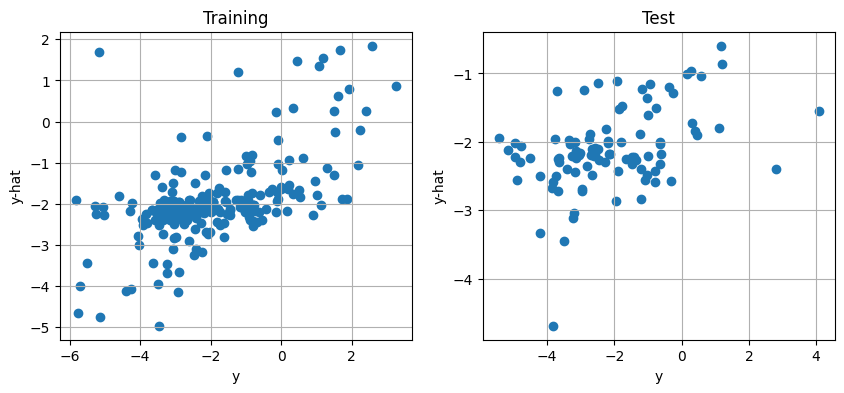

Testing Metrics:
R squared:
0.17685686100347064
Mean Absolute Error:
1.2194794941389306
Mean Squared Error:
2.4888999742620626
Root Mean Squared Error:
1.5776247888081825
Training Metrics:
Mean Absolute Error: 1.0865537806204375
R squared:
0.3511254443655957
Root Mean Squared Error:
1.4132921522822832
Mean Squared Error:
1.9973947077026881


()

In [96]:
# Plots
Prediction_Plots(y_train, y_pred_Train, y_test, y_pred_Test)
Metrics_Printer(y_train, y_pred_Train, y_test, y_pred_Test)

### Ridge

In [97]:
# Do Ridge
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=5)
rr = Ridge()  #Default value for alpha = 1
rr.fit(X_train, y_train)

y_pred_Train = rr.predict(X_train) #Predictions on training model
y_pred_Test  = rr.predict(X_test)  #Predictions on testing model

print('Intercept:',rr.intercept_)
print('Coefficients:', rr.coef_)

Intercept: -2.9593999156041564
Coefficients: [-1.92788623e-03  4.84732634e-03  1.22556648e-03  3.97044046e-03
  1.94466847e-03 -5.36228168e-01  5.66485288e-01  1.21485906e-03
  5.28266347e-01  1.87077199e-01  1.48764316e-01  3.82349409e-01
  5.43316846e-01  7.21607199e-01  3.30317492e-01  4.86738348e-02
 -1.20772119e+00 -3.08687786e-01  9.32565262e-01 -8.95883958e-02
 -7.05570364e-01  9.29920840e-01 -1.12847492e+00 -7.01906324e-01
  1.13103083e-01  4.16446867e-01 -1.70815986e+00  5.72339168e-01
  9.73888822e-02  3.70817898e-01]


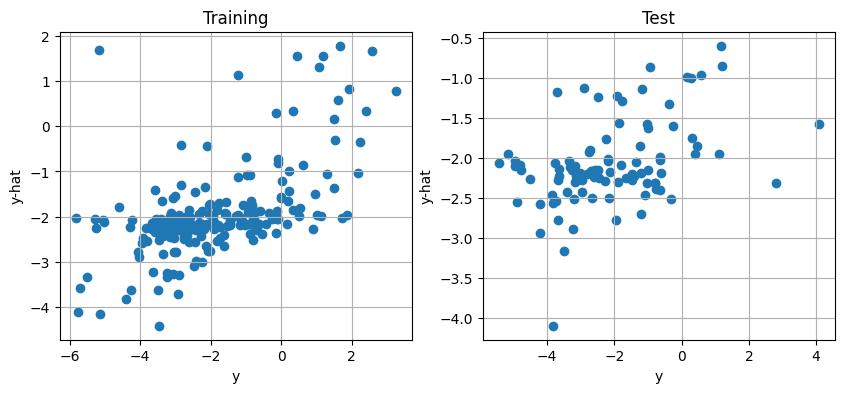

Testing Metrics:
R squared:
0.1650455816551203
Mean Absolute Error:
1.2439469362000484
Mean Squared Error:
2.5246131952966793
Root Mean Squared Error:
1.5889031422011473
Training Metrics:
Mean Absolute Error: 1.0978947750080306
R squared:
0.3421845042849786
Root Mean Squared Error:
1.4229958221128847
Mean Squared Error:
2.024917109750725


()

In [98]:
Prediction_Plots(y_train, y_pred_Train, y_test, y_pred_Test)
Metrics_Printer(y_train, y_pred_Train, y_test, y_pred_Test)

### Lasso

In [99]:
# Try Regression With Lasso

# Data Split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=5)

# Lasso Object
lr = Lasso(alpha = 0.1)  #Default value for alpha = 1
lr.fit(X_train, y_train)

# Predict Train and Test data
y_pred_Train = lr.predict(X_train) #Predictions on training model
y_pred_Test  = lr.predict(X_test)  #Predictions on testing model

# Print intercept and coefficients
print('Intercept:',lr.intercept_)
print('Coefficients:', lr.coef_)

Intercept: -2.5014400805432966
Coefficients: [ 0.00017601  0.00493106  0.00130526  0.00577141  0.00163952  0.
  0.          0.          0.         -0.         -0.          0.
  0.          0.          0.         -0.         -0.         -0.
  0.         -0.         -0.          0.         -0.         -0.
 -0.          0.         -0.          0.         -0.          0.        ]


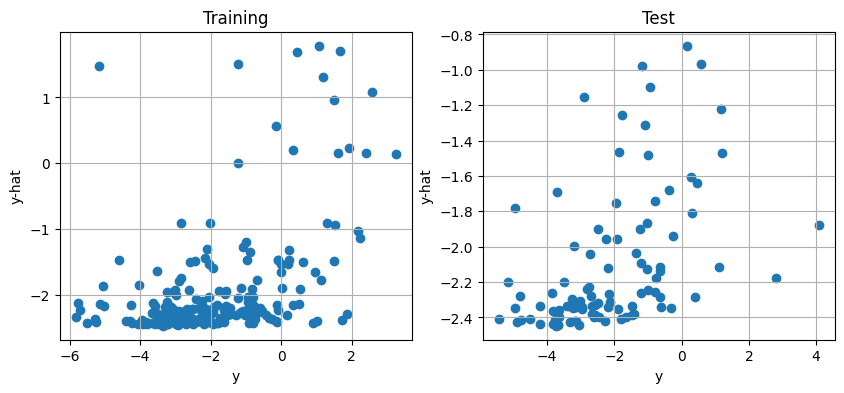

Testing Metrics:
R squared:
0.162161043236152
Mean Absolute Error:
1.2302988025658628
Mean Squared Error:
2.5333350411781623
Root Mean Squared Error:
1.5916453880114636
Training Metrics:
Mean Absolute Error: 1.1891978706455608
R squared:
0.23461068481973213
Root Mean Squared Error:
1.5349448384162416
Mean Squared Error:
2.3560556569806623


()

In [100]:
Prediction_Plots(y_train, y_pred_Train, y_test, y_pred_Test)
Metrics_Printer(y_train, y_pred_Train, y_test, y_pred_Test)

### Predict Billing

In [101]:
# Fit a model including all data points
finalModel =  LinearRegression() #Creates the function
finalModel.fit(X, y) #Train the model
y_pred = finalModel.predict(X)
print('R-Squared: ', metrics.r2_score(y, y_pred))

R-Squared:  0.31987623498308027


In [102]:
RegressionProspect = finalProspect.set_index('CompanyID',drop = True)
RegressionProspect = RegressionProspect.drop(columns = ['Company_State','Company_Country','SIC_Code_1','SIC_Code_2','NAICS_Code_1','NAICS_Code_2'])
RegressionProspect = to_dummies(RegressionProspect)
RegressionProspect = RegressionProspect.dropna()

RegressionProspect[RegressionProspect.select_dtypes(exclude = ['uint8']).columns] = (RegressionProspect.select_dtypes(exclude = ['uint8'])-RegressionProspect.select_dtypes(exclude = ['uint8']).mean())/RegressionProspect.select_dtypes(exclude = ['uint8']).std()
#print(LogisticProspect.dtypes)
predBilling  = finalModel.predict(RegressionProspect)

In [103]:
predictedProspect['Predicted Billing'] = predBilling
predictedProspect['Recommended'] = prospectKeep
#RegressionProspect.nsmallest(100, 'Predicted Billing')
predictedProspect['Recommended'].sum()

1144.0

In [104]:
predictedProspect = predictedProspect.sort_values('Predicted Billing', ascending = False)
predictedProspect

,Founded_Year,Revenue_(in_000s_USD),Past_2_Year_Employee_Growth_Rate,Total_Funding_Amount_(in_000s_USD),Number_of_Locations,IT_Budget_Ratio,bizservice,conglomerate,construction,consumerservices,...,retail,software,telecom,transportation,Public,B2C,Yes,Recomended,Predicted Billing,Recommended
CompanyID,,,,,,,,,,,,,,,,,,,,,
397909049,9.0,7.386437,45.0,0.000000,4.0,0.037634,0,0,0,0,...,0,0,1,0,0,0,1,1.0,8.689908,1.0
12092815,30.0,33.231914,26.7,0.000000,36.0,0.029870,0,0,0,0,...,1,0,0,0,0,0,1,0.0,7.455713,0.0
52663035,105.0,21.231749,0.0,0.000000,12.0,0.110465,0,0,0,0,...,0,0,0,0,0,0,1,0.0,6.697355,0.0
52398162,124.0,42.799499,16.4,0.000000,322.0,0.063107,0,0,0,0,...,0,0,0,0,0,0,1,0.0,5.490463,0.0
8590337,96.0,274.894726,0.0,79.370053,127.0,0.135476,0,0,0,0,...,0,0,0,0,1,0,1,1.0,5.473613,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
129777827,70.0,75.101492,0.0,24.662121,15.0,0.588981,0,0,0,0,...,0,0,0,0,0,0,1,1.0,-17.052332,1.0
36739880,63.0,165.549536,0.0,69.870987,17.0,0.605377,0,0,0,0,...,0,0,0,0,1,1,1,1.0,-17.155372,1.0
24133877,62.0,64.011554,7.8,17.099759,9.0,0.598226,0,0,0,0,...,0,0,0,0,0,1,1,1.0,-17.501582,1.0


## Sprint 4

### Imports and Preprocessing

In [106]:
# Import the necessary Python libraries for EDA
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import scipy
from scipy import stats
import seaborn as sns
from scipy import stats
from sklearn.preprocessing import StandardScaler
from datetime import datetime
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
from sklearn import metrics
from sklearn.metrics import ConfusionMatrixDisplay


scale= StandardScaler()

In [107]:
# We use pandas to store the csv as data frames
currentRawData = pd.read_csv(r"current_customers.csv")#Store the data of current customers in this data frame
prospectRawData = pd.read_csv(r"prospect_list.csv") #Store the data of prospect customers in this data frame
billingRawData = pd.read_csv(r"current_billing.csv")#Store the data of current customers in this data frame
dataDictionaryNetrality = pd.read_csv(r"Data_Dictionary_Netrality.csv") #Store the data of prospect customers in this data frame

#### Current Dataframe

In [108]:
currentData = currentRawData.copy()

x = ['Est_Marketing_Department_Budget_(in_000s_USD)',
       'Est_Finance_Department_Budget_(in_000s_USD)',
       'Est_IT_Department_Budget_(in_000s_USD)',
       'Est_HR_Department_Budget_(in_000s_USD)']

currentData['IT_Budget_Ratio'] = (currentData['Est_IT_Department_Budget_(in_000s_USD)'])/(currentData[x].sum(axis=1))

# Creates new feature that splits data in small medium and big companies
'''arr = []
for i in range(len(currentRawData)):
  if currentRawData['Revenue_Range_(in_USD)'].iloc[i] in ['Over $5 bil.','$1 bil. - $5 bil.']:
    arr.append(3)
  elif currentRawData['Revenue_Range_(in_USD)'].iloc[i] in ['$500 mil. - $1 bil.','$250 mil. - $500 mil.','$100 mil. - $250 mil.','$100 mil. - $250 mil.','$50 mil. - $100 mil.']:
      arr.append(2)
  else:
    arr.append(1)

currentRawData['Company_Size'] = arr

'''
# There is an extra company in the current dataset compared to Billing
currentData = currentData[currentData.CompanyID != 491442528]

# Set the company id as the index
currentData = currentData.set_index('CompanyID',drop = True)

# Make this features categorical variables by making them object types
currentData[['SIC_Code_1','SIC_Code_2','NAICS_Code_1','NAICS_Code_2']] = currentData[['SIC_Code_1','SIC_Code_2','NAICS_Code_1','NAICS_Code_2']].astype('object')

# Change founded year to age of company (2023-founded year)
currentData['Founded_Year'] = 2023-currentData['Founded_Year']

# Fill NAs to the mean
meanYear = int(currentData['Founded_Year'].mean())
currentData['Founded_Year'] = currentData['Founded_Year'].fillna(meanYear)

# Change Column Names
currentData.columns = ['cc','year','revenue','revenue_range','marketing','finance','it','hr','employees','employee_range','employee_growth1', 'employee_growth2','sic1','sic2','sic_codes','naics1','naics2','naics_codes','primary_industry','primary_sub','all_industries','all_sub','ihc','secondary_ihc', 'alexa_rank', 'ownership', 'business_model', 'certified_active_company', 'certification_date','total_funding','recent_funding', 'recent_funding_round', 'recent_funding_date', 'recent_investors', 'all_investors', 'city', 'state', 'zip', 'country', 'number_locations', 'company_acquired', 'it_budget']
df = (datetime.utcnow()-pd.to_datetime(currentData['recent_funding_date'], format='%d-%b-%y'))
for i in range(len(df)):
    df.iloc[i] = df.iloc[i].days
currentData['recent_funding_date'] = df.astype(float)

# Change recent_funding_date to the days its been founded
currentData['recent_funding_date'] = currentData['recent_funding_date'].fillna(currentData['year']*365)

# Company acquire, certified active company, business model and ownership as bool
for i in range(len(currentData)):
    if currentData['company_acquired'].iloc[i]=='Yes':
        currentData['company_acquired'].iloc[i]=1
    else:
        currentData['company_acquired'].iloc[i]=0
currentData['company_acquired'] = currentData['company_acquired'].astype(int)

for i in range(len(currentData)):
    if currentData['certified_active_company'].iloc[i]=='Yes':
        currentData['certified_active_company'].iloc[i]=1
    else:
        currentData['certified_active_company'].iloc[i]=0
currentData['certified_active_company'] = currentData['certified_active_company'].astype(int)

for i in range(len(currentData)):
    if currentData['ownership'].iloc[i]=='Private':
        currentData['ownership'].iloc[i]=1
    else:
        currentData['ownership'].iloc[i]=0
currentData['ownership'] = currentData['ownership'].astype(int)

for i in range(len(currentData)):
    if currentData['business_model'].iloc[i]=='B2C':
        currentData['business_model'].iloc[i]=1
    else:
        currentData['business_model'].iloc[i]=0
currentData['business_model'] = currentData['business_model'].astype(int)

# Fill nas with the mean
currentData[['alexa_rank','number_locations','it_budget']] = currentData[['alexa_rank','number_locations','it_budget']].fillna(currentData[['alexa_rank','number_locations','it_budget']].mean())

#Create a new billing dataset that drops last month billing columns
billing = pd.DataFrame(billingRawData)
billing = billing.drop(columns = ['Last_Month_Park Place', 'Last_Month_Boardwalk',
       'Last_Month_StJamesPlace', 'Last_Month_Marvin Gardens',
       'Last_Month_Ventnor', 'Last_Month_Kentucky', 'Last_Month_Tennessee',
       'Last_Month_Pennslyvania'])

colsLife = ['Lifetime_Park Place', 'Lifetime_Boardwalk', 'Lifetime_StJamesPlace', 'Lifetime_Marvin Gardens', 'Lifetime_Ventnor', 'Lifetime_Kentucky', 'Lifetime_Tennessee', 'Lifetime_Pennslyvania']

# Make CompanyID an object
billing = billing.set_index('CompanyID',drop = True)

# Create a new feature in billing sum of shifted billings columns (added smallest billing
# to all the variables to make the positive)
minBilling = billing[colsLife].min(axis=1).min()
shift = billing + np.abs(minBilling)

billing['Lifetime_Billing_Sum'] = shift.sum(axis=1)

# Create a sum of columns (no shifting)
billing['Sum_Not_Shifted'] = billing[colsLife].sum(axis=1)
billing['Label'] = pd.Series(billing['Sum_Not_Shifted'])

for i in range(len(billing)):
    if billing['Sum_Not_Shifted'].iloc[i]>0:
        billing['Label'].iloc[i] = 1
    else:
        billing['Label'].iloc[i] = 0

#Merge the two datasets now that they are the same size
currentData = pd.merge(currentData, billing, left_index=True, right_index=True)

colsLife = ['Lifetime_Park Place', 'Lifetime_Boardwalk', 'Lifetime_StJamesPlace', 'Lifetime_Marvin Gardens', 'Lifetime_Ventnor', 'Lifetime_Kentucky', 'Lifetime_Tennessee', 'Lifetime_Pennslyvania']

currentData = currentData.drop(columns = colsLife)

dropColumns = ['cc','employee_range',  'revenue_range', 'marketing', 'finance', 'it',
       'hr', 'employees', 'sic1', 'sic2', 'sic_codes', 'naics1', 'naics2',
       'naics_codes', 'primary_industry', 'primary_sub', 'all_industries',
       'all_sub', 'secondary_ihc', 'certification_date',
       'recent_funding_round',
       'recent_investors', 'all_investors', 'city',
       'state', 'zip', 'country']

currentData = currentData.drop(columns = dropColumns)

#logisticData['company_acquired'] = logisticData['company_acquired'].fillna(0)

#sns.heatmap(logisticData.corr(), annot = True)
data1 = currentData.copy()
data1[['year', 'revenue',  'employee_growth1',
       'employee_growth2', 'alexa_rank','total_funding', 'recent_funding',
       'recent_funding_date', 'number_locations',
       'it_budget']] = np.power(data1[['year', 'revenue',  'employee_growth1',
       'employee_growth2', 'alexa_rank','total_funding', 'recent_funding',
       'recent_funding_date', 'number_locations',
       'it_budget']],1/3)
data1['employee_growth2'] = data1['employee_growth2'].fillna(-np.power(np.abs(currentData['employee_growth2']),1/3))
data1['employee_growth1'] = data1['employee_growth1'].fillna(-np.power(np.abs(currentData['employee_growth2']),1/3))
currentData = data1.copy()

# Giving the classes in IHC a number
x = currentData['ihc'].value_counts().reset_index()

for i in range(len(x['index'])):
  for j in range(len(currentData)):
    if currentData['ihc'].iloc[j]== x['index'].iloc[i]:
      currentData['ihc'].iloc[j] = i
currentData['ihc']=currentData['ihc'].astype(int)
currentData['ownership'] = currentData['ownership'].astype(int)
currentData['business_model'] = currentData['business_model'].astype(int)

# Drop Outliers
outliers = currentData[currentData['revenue']> 2 * currentData['revenue'].std()+currentData['revenue'].mean()]
currentData = currentData.drop(outliers.index, axis = 'index')

<ipython-input-108-76a3e73f36f0>:54: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  currentData['company_acquired'].iloc[i]=0
<ipython-input-108-76a3e73f36f0>:52: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  currentData['company_acquired'].iloc[i]=1
<ipython-input-108-76a3e73f36f0>:59: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  currentData['certified_active_company'].iloc[i]=1
<ipython-input-108-76a3e73f36f0>:61: SettingWithCopyWarn

#### Prospect Daraframe

In [109]:
# Deleting features that ar not in cluded in current companies
prospectData = prospectRawData.drop(columns = ['Company_HQ_Phone',	'Fax'])

# List with budegets
x = ['Est_Marketing_Department_Budget_(in_000s_USD)',
       'Est_Finance_Department_Budget_(in_000s_USD)',
       'Est_IT_Department_Budget_(in_000s_USD)',
       'Est_HR_Department_Budget_(in_000s_USD)']

# Create it_budget
prospectData['IT_Budget_Ratio'] = (prospectData['Est_IT_Department_Budget_(in_000s_USD)'])/(prospectData[x].sum(axis=1))

# Creates new feature that splits data in small medium and big companies
'''arr = []
for i in range(lens(propectRawData)):
  ifs propectRawData['Revenue_Range_(in_USD)'].iloc[i] in ['Over $5 bil.','$1 bil. - $5 bil.']:
    arr.append(3)
  elifs propectRawData['Revenue_Range_(in_USD)'].iloc[i] in ['$500 mil. - $1 bil.','$250 mil. - $500 mil.','$100 mil. - $250 mil.','$100 mil. - $250 mil.','$50 mil. - $100 mil.']:
      arr.append(2)
  else:
    arr.append(1)
s
propectRawData['Company_Size'] = arr

'''
# There is an extra company in the current dataset compared to Billing
prospectData = prospectData[prospectData.CompanyID != 491442528]

prospectData = prospectData.set_index('CompanyID',drop = True)
# Make this features categorical variables by making them object types
prospectData[['SIC_Code_1','SIC_Code_2','NAICS_Code_1','NAICS_Code_2']] = prospectData[['SIC_Code_1','SIC_Code_2','NAICS_Code_1','NAICS_Code_2']].astype('object')

# Change founded year to age of company (2023-founded year)'''
prospectData['Founded_Year'] = 2023-prospectData['Founded_Year']

# Fill NAs to the mean
meanYear = int(prospectData['Founded_Year'].mean())
prospectData['Founded_Year'] = prospectData['Founded_Year'].fillna(meanYear)

# List with the new column names
prospectData.columns = ['cc','year','revenue','revenue_range','marketing','finance','it','hr','employees','employee_range','employee_growth1', 'employee_growth2','sic1','sic2','sic_codes','naics1','naics2','naics_codes','primary_industry','primary_sub','all_industries','all_sub','ihc','secondary_ihc', 'alexa_rank', 'ownership', 'business_model', 'certified_active_company', 'certification_date','total_funding','recent_funding', 'recent_funding_round', 'recent_funding_date', 'recent_investors', 'all_investors', 'city', 'state', 'zip', 'country', 'number_locations', 'company_acquired', 'it_budget']

# Change recent_funding_date to the days its been founded
df = (datetime.utcnow()-pd.to_datetime(prospectData['recent_funding_date'], format='%d-%b-%y'))
for i in range(len(df)):
    df.iloc[i] = df.iloc[i].days
prospectData['recent_funding_date'] = df
prospectData['recent_funding_date'] = prospectData['recent_funding_date'].fillna(prospectData['year']*365)

# Company acquire, certified active, busniess model and ownership company as bool
for i in range(len(prospectData)):
    if prospectData['company_acquired'].iloc[i]=='Yes':
        prospectData['company_acquired'].iloc[i]=1
    else:
        prospectData['company_acquired'].iloc[i]=0
prospectData['company_acquired'] = prospectData['company_acquired'].astype(int)

for i in range(len(prospectData)):
    if prospectData['certified_active_company'].iloc[i]=='Yes':
        prospectData['certified_active_company'].iloc[i]=1
    else:
        prospectData['certified_active_company'].iloc[i]=0
prospectData['certified_active_company'] = prospectData['certified_active_company'].astype(int)

for i in range(len(prospectData)):
    if prospectData['ownership'].iloc[i]=='Private':
        prospectData['ownership'].iloc[i]=1
    else:
        prospectData['ownership'].iloc[i]=0
prospectData['ownership'] = prospectData['ownership'].astype(int)

for i in range(len(prospectData)):
    if prospectData['business_model'].iloc[i]=='B2C':
        prospectData['business_model'].iloc[i]=1
    else:
        prospectData['business_model'].iloc[i]=0
prospectData['business_model'] = prospectData['business_model'].astype(int)

# Fill nas with mean
prospectData[['alexa_rank','number_locations','it_budget']] = prospectData[['alexa_rank','number_locations','it_budget']].fillna(prospectData[['alexa_rank','number_locations','it_budget']].mean())

# Drop Outliers
#outliers = prospectData[prospectData['revenue']> 2 * prospectData['revenue'].std()+prospectData['revenue'].mean()]
#prospectData = prospectData.drop(outliers.index, axis = 'index')

dropColumns = ['cc','employee_range',  'revenue_range', 'marketing', 'finance', 'it',
       'hr', 'employees', 'sic1', 'sic2', 'sic_codes', 'naics1', 'naics2',
       'naics_codes', 'primary_industry', 'primary_sub', 'all_industries',
       'all_sub', 'secondary_ihc', 'certification_date',
       'recent_funding_round',
       'recent_investors', 'all_investors', 'city',
       'state', 'zip', 'country']
prospectData = prospectData.drop(columns = dropColumns)
#prospectData['company_acquired'] = prospectData['company_acquired'].fillna(0)

#sns.heatmap(prospectData.corr(), annot = True)
data1 = pd.DataFrame(prospectData)
data1[['year', 'revenue',  'employee_growth1',
       'employee_growth2', 'alexa_rank','total_funding', 'recent_funding',
       'recent_funding_date', 'number_locations',
       'it_budget']] = np.power(data1[['year', 'revenue',  'employee_growth1',
       'employee_growth2', 'alexa_rank','total_funding', 'recent_funding',
       'recent_funding_date', 'number_locations',
       'it_budget']],1/3)
data1['employee_growth2'] = data1['employee_growth2'].fillna(-np.power(np.abs(prospectData['employee_growth2']),1/3))
data1['employee_growth1'] = data1['employee_growth1'].fillna(-np.power(np.abs(prospectData['employee_growth2']),1/3))
prospectData = pd.DataFrame(data1)
prospectData['company_acquired'] = prospectData['company_acquired'].astype(str)

# Giving the classes in IHC a number
x = prospectData['ihc'].value_counts().reset_index()

# Give industry hierarchical category a number
for i in range(len(x['index'])):
  for j in range(len(prospectData)):
    if prospectData['ihc'].iloc[j]== x['index'].iloc[i]:
      prospectData['ihc'].iloc[j] = i


<ipython-input-109-d91437d0a10f>:55: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  prospectData['company_acquired'].iloc[i]=0
<ipython-input-109-d91437d0a10f>:53: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  prospectData['company_acquired'].iloc[i]=1
<ipython-input-109-d91437d0a10f>:60: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  prospectData['certified_active_company'].iloc[i]=1
<ipython-input-109-d91437d0a10f>:62: SettingWithCopyW

### Logistic Regresssion

In [110]:
# dataframe to perform logistic regression
logisticData = currentData.drop(columns= ['Lifetime_Billing_Sum',	'Sum_Not_Shifted']).copy()

In [111]:
from sklearn.feature_selection import RFE
from sklearn.linear_model import LogisticRegression

# Divide Data
X = logisticData.drop(columns = 'Label').copy()
y = logisticData['Label'].copy()
X.columns = X.columns.astype(str)

# Standardize data
colsToScale = ['year', 'revenue', 'employee_growth1', 'employee_growth2', 'alexa_rank','total_funding', 'recent_funding','recent_funding_date', 'number_locations','it_budget']
X[colsToScale] = scale.fit_transform(X[colsToScale])

# Create a logistic regression model
model = LogisticRegression()

# Use RFE to select the top 8 features
rfe = RFE(model, n_features_to_select=8)
rfe.fit(X, y)

# Print the selected features
print(rfe.support_)
print(len(rfe.support_))
print(X.shape)
print(X.loc[:,rfe.support_].columns.values)

[False  True False  True False False False False  True  True  True  True
 False  True  True]
15
(312, 15)
['revenue' 'employee_growth2' 'certified_active_company' 'total_funding'
 'recent_funding' 'recent_funding_date' 'company_acquired' 'it_budget']


In [112]:
# Code to check what is the ideal number of features
from sklearn import metrics

# Data frame that stores the accuracy at each number of features
boxs = pd.DataFrame()

# Numerical Columns to standardize
colsToScale = ['year', 'revenue', 'employee_growth1', 'employee_growth2', 'alexa_rank','total_funding', 'recent_funding','recent_funding_date', 'number_locations','it_budget']

# Loop over all the features
for i in range(15):

  # Split data betweeen features and label
  X1 = pd.DataFrame(X)
  y = logisticData['Label']
  X1.columns = X1.columns.astype(str)
  X1[colsToScale] = scale.fit_transform(X1[colsToScale])

  # Create a logistic regression model
  model = LogisticRegression()

  # Use RFE to select the top 10 features
  rfe = RFE(model, n_features_to_select=i+1)
  rfe.fit(X1, y)

  trueCols = []

# Data frame that takes the best columns selected by rfe
  X2 = X1.loc[:,rfe.support_]
  newColsScale = []
  for j in range(len(colsToScale)):
    if colsToScale[j] in X2.columns.values.tolist():
      newColsScale.append(colsToScale[j])

  # Does 500 random models to take the median of the accuracy
  arr = []
  for k in range(500):
    X_train, X_test, y_train, y_test = train_test_split(X2, y, test_size= 0.25)
    X_train[newColsScale] = scale.fit_transform(X_train[newColsScale])
    X_test[newColsScale] = scale.fit_transform(X_test[newColsScale])
    lr = LogisticRegression().fit(X_train,y_train)
    y_pred = lr.predict(X_test)
    arr.append(metrics.accuracy_score(y_test, y_pred))
  boxs[str(i)]=arr

#### Predict

In [113]:
# Define dataset to use for this model
treeData = currentData.drop(columns= ['Lifetime_Billing_Sum',	'Sum_Not_Shifted'])

# Drops NAs from prospectData
prospectData = prospectData.dropna()

# Creates the dataset that will include the recomended companies
prospectFinal = prospectData.copy()

# Split data features from the label
X = treeData.drop(columns = 'Label').copy()
y = treeData['Label'].copy()
X.columns = X.columns.astype(str)

# Standardize data
X[colsToScale] = scale.fit_transform(X[colsToScale])

# Fits the model
prospectData[colsToScale] = scale.fit_transform(prospectData[colsToScale])
logistic = LogisticRegression()
logistic.fit(X,y)

# Prediction on trained data
y_pred_Train = logistic.predict(prospectData)

# Include this prediction in the dataser
prospectFinal['recomend_logistic'] = y_pred_Train

# Print the logistic regression coefficients
coefficients = pd.DataFrame()
coefficients['Columns']= X.columns.values.tolist()

coefficients['Coefficient'] = list(logistic.coef_[0])

coefficients.sort_values(by = ['Coefficient'], key = abs)

,Columns,Coefficient
4,ihc,-0.017244
5,alexa_rank,-0.022604
6,ownership,0.025065
2,employee_growth1,-0.028791
0,year,-0.071331
7,business_model,0.079181
11,recent_funding_date,-0.106475
3,employee_growth2,0.178993
14,it_budget,-0.179017
12,number_locations,0.180331


### Decision Trees

In [114]:
# import modules tfor decision trees
import os

from sklearn.tree import DecisionTreeClassifier # Import Decision Tree Classifier
from sklearn.model_selection import train_test_split # Import train_test_split function
from sklearn import metrics #Import scikit-learn metrics module for accuracy calculation

from sklearn.tree import plot_tree

from sklearn.tree import export_graphviz
from six import StringIO
from IPython.display import Image
import pydotplus

In [115]:
#Loading the data

# Features that have to be scaled
colsToScale = ['year', 'revenue', 'employee_growth1', 'employee_growth2', 'alexa_rank','total_funding', 'recent_funding','recent_funding_date', 'number_locations','it_budget']

# Dataset to be used to train and test
pima = logisticData.copy()

# Split data fatures and label
X = logisticData.drop(columns = 'Label')
y = logisticData['Label']
X.columns = X.columns.astype(str)

# split X and y into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.3, random_state=0)


In [116]:
featureNames = X.columns.values.tolist()

In [117]:
!pip install pydotplus

In [118]:
!pip install graphviz

In [119]:
import pydotplus
import graphviz

Tree Train Accuracy : 1.0
Tree Test Accuracy:  0.5638297872340425


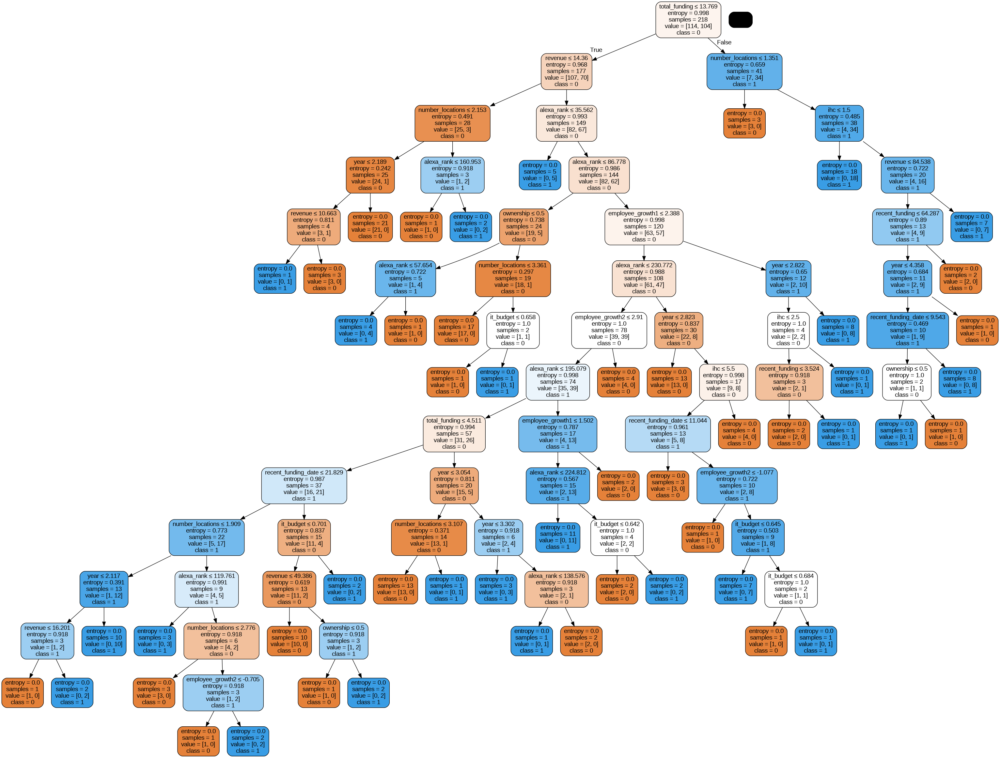

In [120]:
# Define a decision tree object and fit the model
treeModel = DecisionTreeClassifier(criterion='entropy')
treeModel.fit(X_train,y_train)

y_pred_Train = treeModel.predict(X_train) #Predictions
y_pred_Test = treeModel.predict(X_test) #Predictions

print ('Tree Train Accuracy :', metrics.accuracy_score(y_train,y_pred_Train))
print ('Tree Test Accuracy: ', metrics.accuracy_score(y_test, y_pred_Test))

dot_data = StringIO()

#os.environ['PATH'] = os.environ['PATH']+';'+os.environ['CONDA_PREFIX']+r"\Library\bin\graphviz"

export_graphviz(treeModel, out_file=dot_data,
                filled=True, rounded=True,
                special_characters=True, feature_names = featureNames, class_names=['0','1'])

graph = pydotplus.graph_from_dot_data(dot_data.getvalue())

graph.write_png('current_Prunned.png')

Image(graph.create_png())

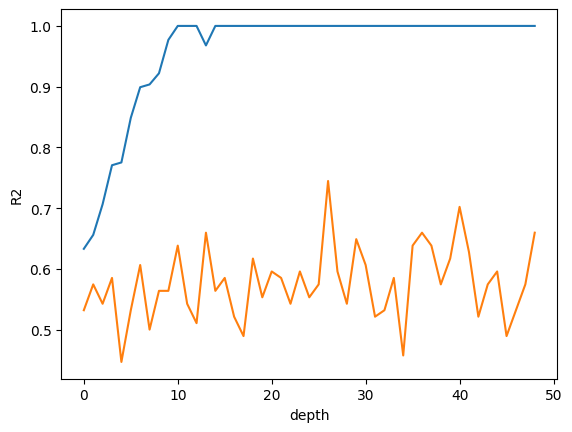

In [121]:
#Code to plot learning curve plot from test accuracy to train accuracy
trainA =[]
testA=[]

# Loops over different depths
for depth in range(1,50):
    X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.3)
    dtree = DecisionTreeClassifier(max_depth=depth)
    dtree.fit(X_train,y_train)
    y_pred_Train = dtree.predict(X_train) #Predictions
    y_pred_Test = dtree.predict(X_test) #Predictions
    trainA.append(metrics.accuracy_score(y_train,y_pred_Train))
    testA.append(metrics.accuracy_score(y_test, y_pred_Test))

plt.plot(trainA)
plt.plot(testA)
plt.ylabel('R2')
plt.xlabel('depth')
plt.show()

<Axes: >

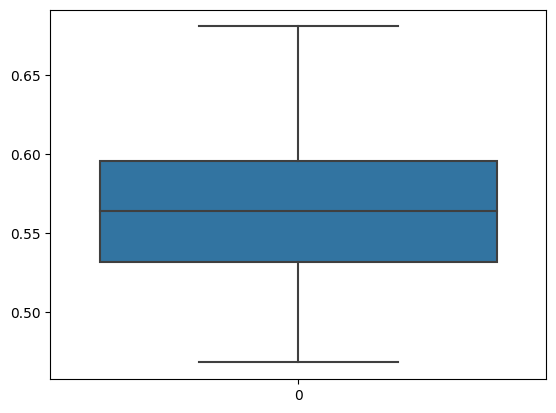

In [122]:

arr = []
X = logisticData.drop(columns = 'Label')
y = logisticData['Label']
X.columns = X.columns.astype(str)
for i in range(100):
# split X and y into training and testing sets
  X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.3)
  dtree = DecisionTreeClassifier(criterion='entropy', max_depth=4)
  dtree.fit(X_train,y_train)

  y_pred_Train = dtree.predict(X_train) #Predictions
  y_pred_Test = dtree.predict(X_test) #Predictions
  arr.append(metrics.accuracy_score(y_test, y_pred_Test))

sns.boxplot(arr)

#### Predict

In [123]:
# Predict the values of prospect companies using decison tree model
treeData = currentData.drop(columns= ['Lifetime_Billing_Sum',	'Sum_Not_Shifted'])

X = treeData.drop(columns = 'Label')
y = treeData['Label']
X.columns = X.columns.astype(str)

dtree = DecisionTreeClassifier(criterion='entropy', max_depth = depth)
dtree.fit(X,y)

y_pred_Train = dtree.predict(prospectData)
prospectFinal['Recomend'] = y_pred_Train

### OLS

In [124]:
from sklearn.linear_model import LinearRegression

from sklearn.model_selection import train_test_split #Split data in testing and training

from sklearn import metrics

from sklearn.linear_model import Ridge
from sklearn.linear_model import Lasso
from sklearn.linear_model import ElasticNet

In [125]:
olsData = currentData.drop(columns= ['Label',	'Sum_Not_Shifted'])

In [126]:
# Does ols 1000 times and plots a boxplot of the accuracy at eeach iteration
R2 = []  #Empty list to Store R2s for testing data set

# Split Data
X = olsData.drop(columns = 'Lifetime_Billing_Sum')
y = olsData['Lifetime_Billing_Sum']
X.columns = X.columns.astype(str)

# Iterates 1000 times
for i in range(1000):
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2)
    X_train[colsToScale] = scale.fit_transform(X_train[colsToScale])
    X_test[colsToScale] = scale.fit_transform(X_test[colsToScale])

    olsModel = LinearRegression().fit(X_train, y_train) #Creates the function

    y_pred_Train  = olsModel.predict(X_train)  #Predictions on training model
    y_pred_Test   = olsModel.predict(X_test)   #Predictions on testing model

    test_rsquared  = metrics.r2_score(y_test, y_pred_Test)
    R2.append(test_rsquared)

<Axes: >

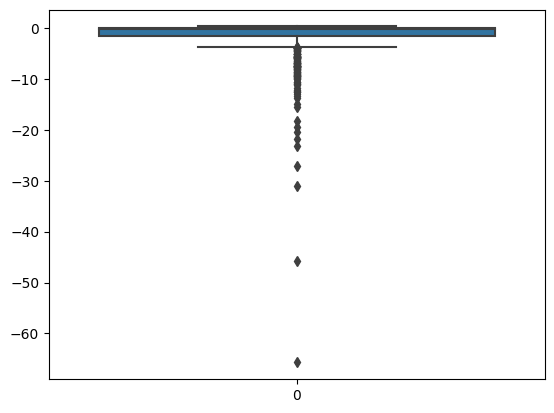

In [127]:
sns.boxplot(R2)

#### Predict

In [128]:
regressionData = currentData.drop(columns= ['Label','Sum_Not_Shifted'])

In [129]:
# Predict the values of prospect companies using decison ols model

olsData = currentData.drop(columns= ['Label',	'Sum_Not_Shifted'])

X = olsData.drop(columns = 'Lifetime_Billing_Sum')
y = olsData['Lifetime_Billing_Sum']
X.columns = X.columns.astype(str)
X[colsToScale] = scale.fit_transform(X[colsToScale])
olsPredict = LinearRegression().fit(X,y)


y_pred_Train = olsPredict.predict(prospectData)
prospectFinal['ols_revenue'] = y_pred_Train

In [130]:
coefficients = pd.DataFrame()
coefficients['Columns']= X.columns.values.tolist()

coefficients['Coefficient'] = list(logistic.coef_[0])

coefficients.sort_values(by = ['Coefficient'], key = abs)
coefficients

,Columns,Coefficient
0,year,-0.071331
1,revenue,0.590798
2,employee_growth1,-0.028791
3,employee_growth2,0.178993
4,ihc,-0.017244
5,alexa_rank,-0.022604
6,ownership,0.025065
7,business_model,0.079181
8,certified_active_company,0.461595
9,total_funding,0.699048


### Ridge

In [131]:
# Test ridge regression
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=5)
RidgeReg = Ridge(alpha = 0)  #Default value for alpha = 1
RidgeReg.fit(X_train, y_train)

y_pred_Train = RidgeReg.predict(X_train) #Predictions on training model
y_pred_Test  = RidgeReg.predict(X_test)  #Predictions on testing model

print('Intercept:',RidgeReg.intercept_)
print('Coefficients:', RidgeReg.coef_)

Intercept: 0.26715656693667156
Coefficients: [-0.36334362  0.4072069   0.04258587  0.06995154 -0.03137132 -0.05109836
  0.30132693 -0.22075979  0.12116001  0.97294204 -0.63577444  0.1422837
  0.0489503  -0.32479801 -0.13646397]


Text(0, 0.5, 'error')

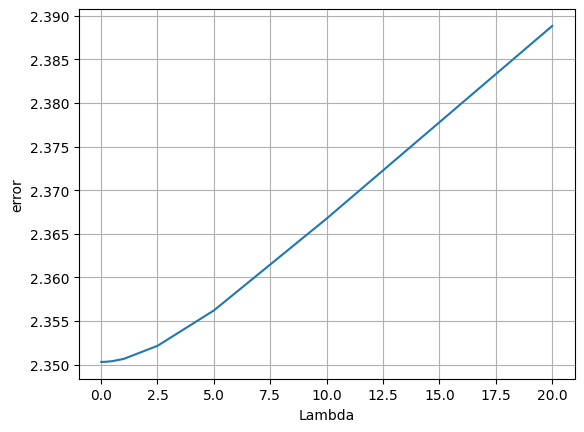

In [132]:
# Code to asses which alpha should be used
alphas = [0.01, 0.1, 0.25, 0.5, 1, 2.5, 5, 10, 20]

#alphas = 10**np.linspace(10,-2,100)*and0.5 #create alpha coefficients #More values

RidgeReg = Ridge() #Define ridge model
error = [] #Store error values

for a in alphas:
    RidgeReg.set_params(alpha = a)
    RidgeReg.fit(X_train, y_train)
    y_pred_Train = RidgeReg.predict(X_train) #Predictions on training model
    error.append(metrics.mean_squared_error(y_train, y_pred_Train))

plt.plot(alphas,error)
plt.grid()
plt.xlabel('Lambda')
plt.ylabel('error')

In [133]:
# 1000 iterations of ridge to plot a boxplot of acucracy
Test_R2 = []  #Empty list to Store R2s for testing data set

X = olsData.drop(columns = 'Lifetime_Billing_Sum')
y = olsData['Lifetime_Billing_Sum']
X.columns = X.columns.astype(str)

for i in range(1000):
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3)
    X_train[colsToScale] = scale.fit_transform(X_train[colsToScale])
    X_test[colsToScale] = scale.fit_transform(X_test[colsToScale])

    ridge = Ridge(alpha=0.1) #Creates the function
    ridge.fit(X_train, y_train) #Train the model

    y_pred_Train  = ridge.predict(X_train)  #Predictions on training model
    y_pred_Test   = ridge.predict(X_test)   #Predictions on testing model
    test_R2  = metrics.r2_score(y_test, y_pred_Test)
    Test_R2.append(test_R2)

<Axes: >

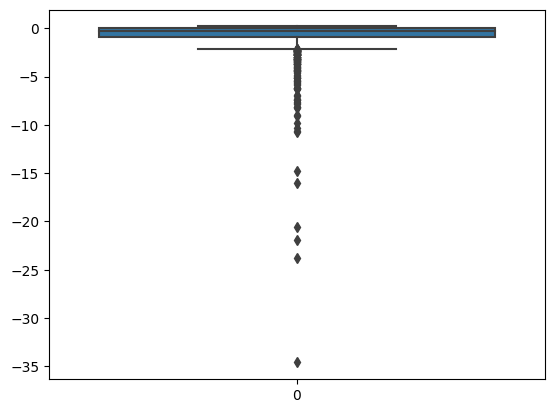

In [134]:
sns.boxplot(Test_R2)

#### Predict

In [135]:
# Predict the values of prospect companies using decison ridge model

treeData = currentData.drop(columns= ['Label',	'Sum_Not_Shifted'])

X = treeData.drop(columns = 'Lifetime_Billing_Sum')
y = treeData['Lifetime_Billing_Sum']
X.columns = X.columns.astype(str)
X[colsToScale] = scale.fit_transform(X[colsToScale])


ridgePredict = Ridge(alpha = 0.1).fit(X,y)

y_pred_Train = ridgePredict.predict(prospectData)
prospectFinal['ridge_revenue'] = y_pred_Train

### Lasso

(0.0, 1.0)

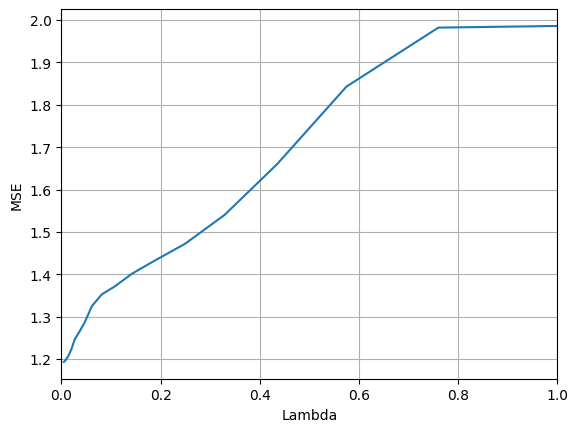

In [136]:
# Code to select alpha

alphas = [0.01, 0.1, 0.25, 0.5, 1, 2.5, 5, 10, 20]

alphas = 10**np.linspace(10,-2,100)*0.5 #create alpha coefficients #More values

LassoReg = Lasso() #Define ridge model
MSE = [] #Store MSE values

for a in alphas:
    LassoReg.set_params(alpha = a)
    LassoReg.fit(X_train, y_train)
    y_pred_Train = LassoReg.predict(X_train) #Predictions on training model
    MSE.append(metrics.mean_squared_error(y_train, y_pred_Train))

plt.plot(alphas,MSE)
plt.grid()
plt.xlabel('Lambda')
plt.ylabel('MSE')
plt.xlim(0,1)

In [137]:
# 1000 iterations of Lasso to plot a boxplot of acucracy

Test_R2 = []  #Empty list to Store R2s for testing data set

X = olsData.drop(columns = 'Lifetime_Billing_Sum')
y = olsData['Lifetime_Billing_Sum']
X.columns = X.columns.astype(str)

for i in range(1000):
    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3)
    X_train[colsToScale] = scale.fit_transform(X_train[colsToScale])
    X_test[colsToScale] = scale.fit_transform(X_test[colsToScale])

    lasso = Lasso() #Creates the function
    lasso.set_params(alpha = 0.1)
    lasso.fit(X_train, y_train) #Train the model

    y_pred_Train  = lasso.predict(X_train)  #Predictions on training model
    y_pred_Test   = lasso.predict(X_test)   #Predictions on testing model
    test_R2  = metrics.r2_score(y_test, y_pred_Test)
    Test_R2.append(test_R2)

<Axes: >

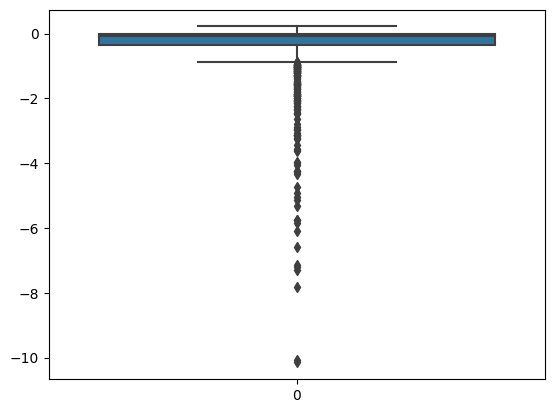

In [138]:
sns.boxplot(Test_R2)

#### Predict

In [139]:
# Predict the values of prospect companies using decison Lasso model

lassoData = currentData.drop(columns= ['Label',	'Sum_Not_Shifted'])

X = lassoData.drop(columns = 'Lifetime_Billing_Sum')
y = lassoData['Lifetime_Billing_Sum']
X.columns = X.columns.astype(str)
X[colsToScale] = scale.fit_transform(X[colsToScale])


ridgePredict = Lasso(alpha = 0.1).set_params(alpha = 0.1).fit(X,y)

y_pred_Train = ridgePredict.predict(prospectData)
prospectFinal['lasso_revenue'] = y_pred_Train

### Predicted Data

In [140]:
# Get the companies that where recomended by Logistic Regression and
# Decision Trees and had the highest predicted billing
recommendedCompanies = prospectFinal[(prospectFinal['recomend_logistic']==1)& (prospectFinal['Recomend']==1)& (prospectFinal['ols_revenue']>1)& (prospectFinal['ridge_revenue']>1)&(prospectFinal['ridge_revenue']>1)].copy()

In [141]:
# Mean billing
recommendedCompanies['ols_revenue'].mean()

1.9437978536863076

In [142]:
recommendedCompanies

,year,revenue,employee_growth1,employee_growth2,ihc,alexa_rank,ownership,business_model,certified_active_company,total_funding,recent_funding,recent_funding_date,number_locations,company_acquired,it_budget,recomend_logistic,Recomend,ols_revenue,ridge_revenue,lasso_revenue
CompanyID,,,,,,,,,,,,,,,,,,,,
2441797,3.608826,729.073071,0.000000,0.000000,3,4.464745,0,0,1,129.310950,100.000000,14.047458,2.843867,0,0.651251,1.0,1.0,3.467967,3.465882,2.763309
155353090,3.936497,857.621878,2.237378,3.068781,7,4.326749,0,0,1,18.991686,14.422496,26.646043,16.136847,0,0.500516,1.0,1.0,13.168394,13.161868,9.498992
24904409,3.634241,588.766935,-1.638643,-1.638643,2,3.530348,0,0,1,10.000000,10.000000,24.905241,3.979057,0,0.589810,1.0,1.0,3.731205,3.730598,3.007234
10256729,3.914868,697.408102,0.000000,0.000000,7,7.685733,0,1,1,0.000000,0.000000,27.977874,3.141381,0,0.507046,1.0,1.0,3.733108,3.731182,2.803526
141738322,4.396830,598.533856,0.000000,0.000000,3,3.271066,0,0,1,0.000000,0.000000,31.422249,3.107233,0,0.647331,1.0,1.0,2.661797,2.661919,2.316344
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
345037191,2.802039,54.301130,0.000000,2.477125,0,239.333056,1,0,1,12.599210,12.599210,11.043902,2.714418,0,0.582040,1.0,1.0,1.646115,1.644806,1.078259
541788120,1.912931,43.578798,0.000000,0.000000,2,40.626390,1,0,1,74.554395,60.550489,8.715373,2.997208,0,0.582279,1.0,1.0,1.257896,1.256957,1.069217
397909049,2.080084,7.386437,2.016530,3.556893,1,187.573435,1,0,1,0.000000,0.000000,14.865464,1.587401,0,0.335116,1.0,1.0,2.080077,2.077809,1.161271


## Sprint 5

In [145]:
# Import the necessary Python libraries for EDA
import  pandas  as pd
import  numpy   as np
import  matplotlib.pyplot as plt
import  scipy
from    scipy import stats
import  seaborn as sns
from    scipy import stats
from    sklearn.preprocessing import StandardScaler
from    datetime import datetime
from    sklearn.linear_model import LogisticRegression
from    sklearn.model_selection import train_test_split
from    sklearn.metrics import ConfusionMatrixDisplay
from    sklearn.cluster import KMeans
from    sklearn.decomposition import PCA

from sklearn.tree import DecisionTreeClassifier # Import Decision Tree Classifier
from sklearn.model_selection import train_test_split # Import train_test_split function
from sklearn import metrics #Import scikit-learn metrics module for accuracy calculation
from sklearn.neighbors import KNeighborsRegressor
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import ExtraTreesRegressor
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.linear_model import LogisticRegression
from sklearn import naive_bayes

from sklearn import preprocessing

from sklearn.model_selection import train_test_split # Import train_test_split function
from sklearn.metrics import ConfusionMatrixDisplay

from xgboost import XGBRegressor

#from catboost import CatBoostRegressor

from lightgbm import LGBMRegressor

from tqdm import tqdm

In [146]:
current   =   pd.read_csv(r"/content/currentData.csv")
prospect  =   pd.read_csv(r"/content/prospectData.csv")

current   =   current.set_index('CompanyID',drop = True)
prospect  =   prospect.set_index('CompanyID',drop = True)

data      =   pd.concat([current,prospect])

In [147]:
data['cc'] = data['cc'].replace(['Y','N'],[1,0])
data.iloc[:,:-5]

,cc,year,revenue,employee_growth1,employee_growth2,ihc,alexa_rank,ownership,business_model,certified_active_company,total_funding,recent_funding,recent_funding_date,number_locations,company_acquired,it_budget
CompanyID,,,,,,,,,,,,,,,,
1475361,1,3.401197,20.103455,0.000000,0.00000,retail,2.484907,0,0,1,10.778977,10.778977,9.179778,3.637586,0,0.148806
16400573,1,3.258097,19.363555,0.000000,0.00000,software,0.693147,1,0,1,14.470489,14.457365,8.860073,4.521789,0,0.154246
246280,1,3.555348,17.960935,0.000000,0.00000,bizservice,8.207674,0,0,1,14.346139,14.346139,9.008591,3.912023,0,0.257051
43076614,1,3.218876,19.712980,0.053541,0.07139,energy,11.179590,0,0,1,0.000000,0.000000,9.078065,3.367296,0,0.280992
126828694,1,3.713572,18.734286,0.000000,0.00000,telecom,6.298949,0,0,1,0.000000,0.000000,9.588845,4.025352,0,0.242453
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
398742609,0,2.302585,7.404888,0.000000,0.00000,bizservice,16.207919,1,0,1,0.000000,0.000000,8.097426,3.329511,0,0.174487
30344865,0,4.521789,7.094235,0.000000,0.00000,media,14.828298,1,1,1,0.000000,0.000000,10.410787,0.693147,0,0.228842
478996006,0,1.609438,6.863803,0.000000,0.00000,bizservice,14.828298,1,0,1,0.000000,0.000000,7.286876,0.693147,0,0.164962


### Some EDA on PCA and Clusters

In [148]:
x        =   data.select_dtypes(include = np.number).iloc[:,:-5]
x        =   x.dropna()


In [149]:
mean      =   x[['year', 'revenue', 'employee_growth1', 'employee_growth2', 'alexa_rank',
              'total_funding', 'recent_funding', 'recent_funding_date',
              'number_locations','it_budget']].mean()

std       =   x[['year', 'revenue', 'employee_growth1', 'employee_growth2', 'alexa_rank',
       'total_funding', 'recent_funding', 'recent_funding_date',
       'number_locations','it_budget']].std()

In [150]:
x[['year', 'revenue', 'employee_growth1', 'employee_growth2', 'alexa_rank',
       'total_funding', 'recent_funding', 'recent_funding_date',
       'number_locations','it_budget']] = (x[['year', 'revenue', 'employee_growth1', 'employee_growth2', 'alexa_rank',
       'total_funding', 'recent_funding', 'recent_funding_date',
       'number_locations','it_budget']]-mean)

In [151]:
pca       =   PCA()
a = pca.fit_transform(x)
np.cumsum(pca.explained_variance_ratio_)

array([0.75111178, 0.91601606, 0.95435451, 0.97299349, 0.98389704,
       0.99087359, 0.9947896 , 0.99625024, 0.9976577 , 0.9984177 ,
       0.9991036 , 0.99964617, 0.99987538, 0.9999592 , 1.        ])

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

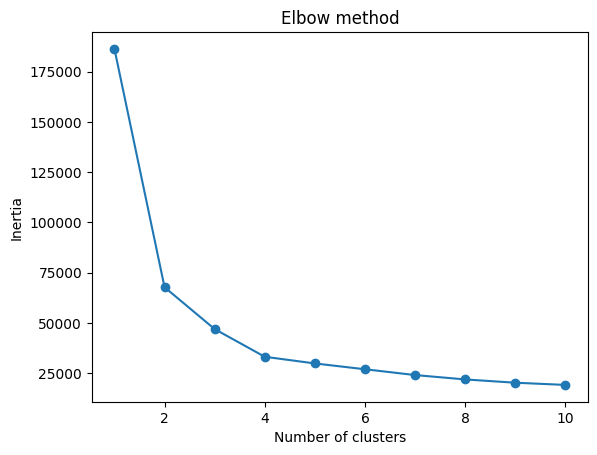

In [152]:
inertias = []

for i in range(1,11):
    kmeans = KMeans(n_clusters=i)
    kmeans.fit(x)
    inertias.append(kmeans.inertia_)

plt.plot(range(1,11), inertias, marker='o')
plt.title('Elbow method')
plt.xlabel('Number of clusters')
plt.ylabel('Inertia')
plt.show()

In [153]:
kmeans = KMeans(n_clusters=4) #Creat a kmeans object for 4 groups

kmeans.fit(x)
ykm = kmeans.fit_predict(x)

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


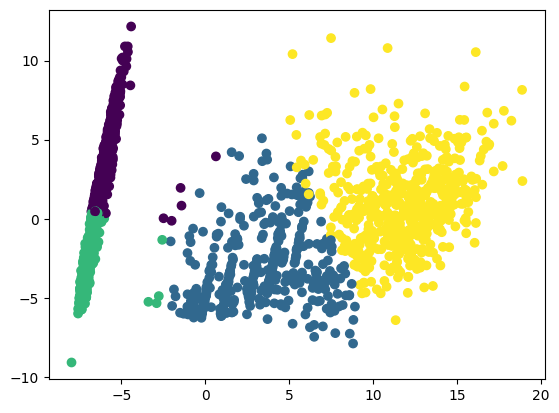

In [154]:
NCT = pca.transform(x)

plt.scatter(NCT[...,0],NCT[...,1], c = ykm)

In [155]:
# Convert to a data frame
X_reduceddf = pd.DataFrame(NCT[...,0:2], index=x.index, columns=['PC1','PC2'])
X_reduceddf['cluster'] = ykm
X_reduceddf.head()

,PC1,PC2,cluster
CompanyID,,,
1475361,10.859078,10.795028,3
16400573,16.109275,10.537995,3
246280,14.846454,5.060007,3
43076614,-5.102523,7.672881,0
126828694,-4.689673,10.112451,0


In [156]:
centres_reduced = pca.transform(kmeans.cluster_centers_)

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:439: UserWarning: X does not have valid feature names, but PCA was fitted with feature names
  warnings.warn(


Following code provided by:
https://github.com/OpenClassrooms-Student-Center/Multivariate-Exploratory-Analysis/blob/master/functions.py

In [157]:
from matplotlib.collections import LineCollection
from scipy.cluster.hierarchy import dendrogram
from pandas.plotting import parallel_coordinates
import seaborn as sns
palette = sns.color_palette("bright", 10)

def addAlpha(colour, alpha):
    '''Add an alpha to the RGB colour'''

    return (colour[0],colour[1],colour[2],alpha)

def display_parallel_coordinates(df, num_clusters):
    '''Display a parallel coordinates plot for the clusters in df'''

    # Select data points for individual clusters
    cluster_points = []
    for i in range(num_clusters):
        cluster_points.append(df[df.cluster==i])

    # Create the plot
    fig = plt.figure(figsize=(12, 15))
    title = fig.suptitle("Parallel Coordinates Plot for the Clusters", fontsize=18)
    fig.subplots_adjust(top=0.95, wspace=0)

    # Display one plot for each cluster, with the lines for the main cluster appearing over the lines for the other clusters
    for i in range(num_clusters):
        plt.subplot(num_clusters, 1, i+1)
        for j,c in enumerate(cluster_points):
            if i!= j:
                pc = parallel_coordinates(c, 'cluster', color=[addAlpha(palette[j],0.2)])
        pc = parallel_coordinates(cluster_points[i], 'cluster', color=[addAlpha(palette[i],0.5)])

        # Stagger the axes
        ax=plt.gca()
        for tick in ax.xaxis.get_major_ticks()[1::2]:
            tick.set_pad(20)


def display_parallel_coordinates_centroids(df, num_clusters):
    '''Display a parallel coordinates plot for the centroids in df'''

    # Create the plot
    fig = plt.figure(figsize=(12, 5))
    title = fig.suptitle("Parallel Coordinates plot for the Centroids", fontsize=18)
    fig.subplots_adjust(top=0.9, wspace=0)

    # Draw the chart
    parallel_coordinates(df, 'cluster', color=palette)

    # Stagger the axes
    ax=plt.gca()
    for tick in ax.xaxis.get_major_ticks()[1::2]:
        tick.set_pad(20)

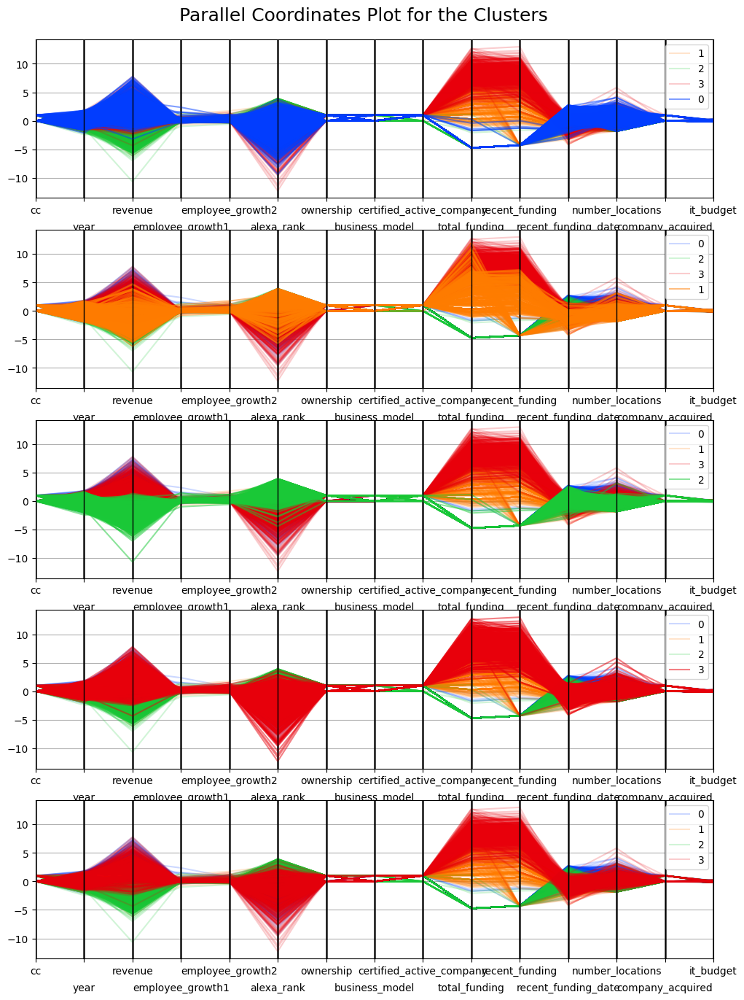

In [158]:
# Add the cluster number to the original scaled data
X_clustered = pd.DataFrame(x, index=x.index, columns=x.columns)
X_clustered["cluster"] = ykm

# Display parallel coordinates plots, one for each cluster
display_parallel_coordinates(X_clustered, 5)

### Predict

#### Prediction on previous label (Total Billing Sum)

In [159]:
# Read Data
prospect = pd.read_csv(r"/content/prospectData.csv").set_index('CompanyID',drop = True)

prospect = prospect.drop(columns= ['cc','ihc'])
prospect = prospect.dropna()
df = pd.DataFrame(current).drop(columns = ['cc','ihc'])
prospect_st = pd.DataFrame(prospect)

In [160]:
# Data Split features and label
X = df.iloc[:,0:-5] # Features
y = df.iloc[:,-2] # Target variable
X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.25)

*Standardizing*

In [161]:
cols = ['year', 'revenue',  'employee_growth1',
       'employee_growth2', 'alexa_rank','total_funding', 'recent_funding',
       'recent_funding_date', 'number_locations',
       'it_budget']

In [162]:
#run without this for KNN first
X_train_st = pd.DataFrame(X_train)
X_test_st = pd.DataFrame(X_test)
X_train_st[cols] = (X_train_st[cols] - X_train_st[cols].mean())/X_train_st[cols].std()
prospect_st[cols] = (prospect[cols] - prospect[cols].mean())/prospect[cols].std()
X_test_st[cols] = (X_test_st[cols] - X_test_st[cols].mean())/X_test_st[cols].std()

In [163]:
'''# Use GridSearchCV to find ideal n_neighbors and leaf_size
from sklearn.neighbors import KNeighborsClassifier
from sklearn.metrics import classification_report
from sklearn.metrics import roc_auc_score
from sklearn.model_selection import GridSearchCV
#List Hyperparameters that we want to tune.
leaf_size = list(range(1,50))
n_neighbors = list(range(1,30))
p=[1,2]
#Convert to dictionary
hyperparameters = dict(leaf_size=leaf_size, n_neighbors=n_neighbors, p=p)
#Create new KNN object
knn_2 = KNeighborsClassifier()
#Use GridSearch
clf = GridSearchCV(knn_2, hyperparameters, cv=10)
#Fit the model
best_model = clf.fit(X_train_st,y_train)
#Print The value of best Hyperparameters
print('Best leaf_size:', best_model.best_estimator_.get_params()['leaf_size'])
print('Best p:', best_model.best_estimator_.get_params()['p'])
print('Best n_neighbors:', best_model.best_estimator_.get_params()['n_neighbors'])'''

"# Use GridSearchCV to find ideal n_neighbors and leaf_size\nfrom sklearn.neighbors import KNeighborsClassifier\nfrom sklearn.metrics import classification_report\nfrom sklearn.metrics import roc_auc_score\nfrom sklearn.model_selection import GridSearchCV\n#List Hyperparameters that we want to tune.\nleaf_size = list(range(1,50))\nn_neighbors = list(range(1,30))\np=[1,2]\n#Convert to dictionary\nhyperparameters = dict(leaf_size=leaf_size, n_neighbors=n_neighbors, p=p)\n#Create new KNN object\nknn_2 = KNeighborsClassifier()\n#Use GridSearch\nclf = GridSearchCV(knn_2, hyperparameters, cv=10)\n#Fit the model\nbest_model = clf.fit(X_train_st,y_train)\n#Print The value of best Hyperparameters\nprint('Best leaf_size:', best_model.best_estimator_.get_params()['leaf_size'])\nprint('Best p:', best_model.best_estimator_.get_params()['p'])\nprint('Best n_neighbors:', best_model.best_estimator_.get_params()['n_neighbors'])"

In [164]:
# Run the model
from sklearn.metrics import confusion_matrix,accuracy_score

classifier  = KNeighborsClassifier(n_neighbors = 4)
classifier.fit(X_train_st, y_train)
y_pred      = classifier.predict(X_test_st)
prospect_pred = classifier.predict(prospect_st)

# Store predictions
recommended_2 = pd.DataFrame(prospect_pred, columns = ['recommend_knn'])

**Logistic Regression**

In [165]:
# Run Model
logi                = LogisticRegression().fit(X_train_st,y_train)
recommend_logistic  = logi.predict(prospect_st)

# Store predictions
recommended_2['recommend_logistic'] = recommend_logistic

**Trees**

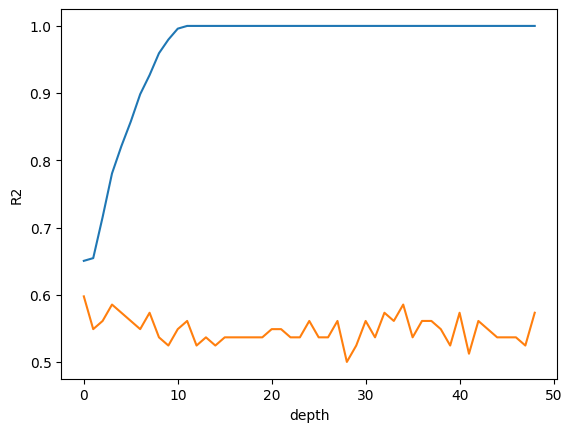

In [166]:
#Code to plot learning curve plot from test accuracy to train accuracy
train =[]
test=[]
# Loops over different depths
for depth in range(1,50):
    dtree = DecisionTreeClassifier(max_depth=depth)
    dtree.fit(X_train_st,y_train)
    y_pred_Train = dtree.predict(X_train_st) #Predictions
    y_pred_Test = dtree.predict(X_test_st) #Predictions
    train.append(metrics.accuracy_score(y_train,y_pred_Train))
    test.append(metrics.accuracy_score(y_test, y_pred_Test))

plt.plot(train)
plt.plot(test)
plt.ylabel('R2')
plt.xlabel('depth')
plt.show()

In [167]:
# Run Model
dtree = DecisionTreeClassifier(criterion='entropy', max_depth = 3)
dtree.fit(X_train_st,y_train)

pred_tree = dtree.predict(prospect_st)

# Store Predictions
recommended_2['recommend_tree'] = pred_tree

**Naive Bayes**

In [168]:
# Run Model
ber            = naive_bayes.GaussianNB().fit(X_train_st,y_train)

recommend_ber  = ber.predict(prospect_st)

# Store Predictions
recommended_2['recommend_ber'] = recommend_ber

**Test Accuracy**

In [169]:
# Run the models 1000 and get the median accuracy
acc_knn = []
acc_dtree = []
acc_logi = []
acc_ber = []
for i in tqdm(range(1000)):

  # Data split and standarization
  X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.25)
  mean = X_train[['year', 'revenue',  'employee_growth1',
       'employee_growth2', 'alexa_rank','total_funding', 'recent_funding',
       'recent_funding_date', 'number_locations',
       'it_budget']].mean()
  stdev = X_train[['year', 'revenue',  'employee_growth1',
       'employee_growth2', 'alexa_rank','total_funding', 'recent_funding',
       'recent_funding_date', 'number_locations',
       'it_budget']].std()
  #run without this for KNN first
  X_train_st = (X_train - mean)/stdev
  X_train_st[['ownership', 'business_model', 'certified_active_company', 'company_acquired']]=X_train[['ownership', 'business_model', 'certified_active_company', 'company_acquired']]
  #X_train_st.boxplot()
  X_test_st = (X_test - mean)/stdev
  X_test_st[['ownership', 'business_model', 'certified_active_company', 'company_acquired']]=X_test[['ownership', 'business_model', 'certified_active_company', 'company_acquired']]

  # Run Models
  knn = KNeighborsClassifier(n_neighbors = 16).fit(X_train_st, y_train)
  dtree = DecisionTreeClassifier(criterion='entropy', max_depth = 3).fit(X_train_st,y_train)
  logi                = LogisticRegression().fit(X_train_st,y_train)
  ber = naive_bayes.GaussianNB().fit(X_train_st,y_train)

  # Get Predictions
  y_pred_ber = ber.predict(X_test_st)
  y_pred_knn = knn.predict(X_test_st)
  y_pred_dtree = dtree.predict(X_test_st)
  y_pred_logi = logi.predict(X_test_st)

  # Store Accuracy
  acc_ber.append(metrics.accuracy_score(y_test,y_pred_ber))
  acc_knn.append(accuracy_score(y_test,y_pred_knn))
  acc_dtree.append(accuracy_score(y_test,y_pred_dtree))
  acc_logi.append(accuracy_score(y_test,y_pred_logi))

acc_dict = {'ber':acc_ber,'logi':acc_logi, 'knn':acc_knn, 'dtree':acc_dtree}
accuracy = pd.DataFrame(acc_dict)


100%|██████████| 1000/1000 [00:52<00:00, 18.99it/s]


<Axes: >

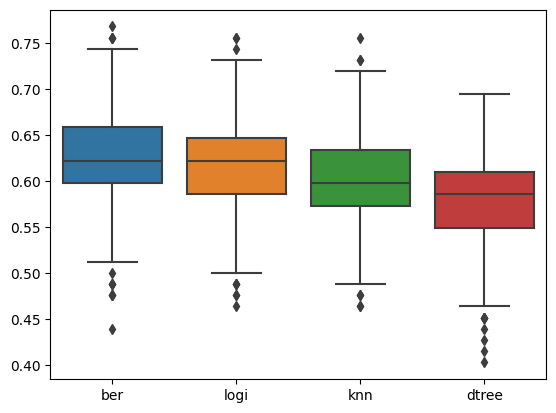

In [170]:
sns.boxplot(accuracy)

In [171]:
# Probability of being wrong in the three models
medians = 1-accuracy.median()
print('Probability of having a false positive in all of the models:', medians.product())

Probability of having a false positive in all of the models: 0.023848487186283632


In [172]:
recommended_2.sum()

recommend_knn          679.0
recommend_logistic     971.0
recommend_tree        1297.0
recommend_ber          929.0
dtype: float64

In [173]:
recommended_2[(recommended_2['recommend_knn']==1)& (recommended_2['recommend_logistic']==1)& (recommended_2['recommend_tree']==1) & (recommended_2['recommend_ber']==1) ]

,recommend_knn,recommend_logistic,recommend_tree,recommend_ber
0,1.0,1.0,1.0,1.0
1,1.0,1.0,1.0,1.0
2,1.0,1.0,1.0,1.0
3,1.0,1.0,1.0,1.0
4,1.0,1.0,1.0,1.0
...,...,...,...,...
1422,1.0,1.0,1.0,1.0
1423,1.0,1.0,1.0,1.0
1431,1.0,1.0,1.0,1.0
1460,1.0,1.0,1.0,1.0


## Final Sprint

### Imports and Functions

In [174]:
# Import the necessary Python libraries for EDA
import  pandas  as pd
import  numpy   as np
import  matplotlib.pyplot as plt
import  scipy
from    scipy import stats
import  seaborn as sns
from    scipy import stats
from    sklearn.preprocessing import StandardScaler
from    datetime import datetime
from    sklearn.linear_model import LogisticRegression
from    sklearn.model_selection import train_test_split
from    sklearn.metrics import ConfusionMatrixDisplay
from    sklearn.cluster import KMeans
from    sklearn.decomposition import PCA
from scipy.stats import randint
from sklearn.tree import DecisionTreeClassifier # Import Decision Tree Classifier
from sklearn.model_selection import train_test_split # Import train_test_split function
from sklearn import metrics #Import scikit-learn metrics module for accuracy calculation
from sklearn.neighbors import KNeighborsRegressor
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import ExtraTreesClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.linear_model import LogisticRegression
from sklearn import naive_bayes
#from catboost import CatBoostClassifier
from lightgbm import LGBMClassifier

from sklearn import preprocessing
from sklearn.model_selection import RandomizedSearchCV, train_test_split, GridSearchCV

from sklearn.metrics import ConfusionMatrixDisplay

from xgboost import XGBRegressor
from xgboost import XGBClassifier

#from catboost import CatBoostRegressor

from lightgbm import LGBMRegressor

from tqdm import tqdm

from sklearn.metrics import roc_auc_score

In [175]:
# Function that takes a list of models and fits them 1000 times
# Recording Accuracy, Precision, Recall and ROC Score
def MultipleRuns(modelList,X,y, ListColumnsToStandardize):
  # Run the models 1000 and get the median accuracy
  modelColumns = np.arange(len(modelList))
  nModels = len(modelList)
  acc = pd.DataFrame(columns = modelColumns)
  pre = pd.DataFrame(columns = modelColumns)
  rec = pd.DataFrame(columns = modelColumns)
  roc = pd.DataFrame(columns = modelColumns)

  for i in tqdm(range(1000)):

  # Data split and standarization
    X_train, X_test, y_train, y_test = dataSplitStandard(X,y,ListColumnsToStandardize)


  # Run Models
    x = []
    a = []
    b = []
    c = []
    for i in range(nModels):
      modelList[i].fit(X_train, y_train)
      y_pred = modelList[i].predict(X_test)
      x.append(metrics.accuracy_score(y_test,y_pred))
      a.append(metrics.precision_score(y_test,y_pred))
      b.append(metrics.recall_score(y_test,y_pred))
      c.append(roc_auc_score(y_test,y_pred))

    acc.loc[len(acc)] = x
    pre.loc[len(pre)] = a
    rec.loc[len(rec)] = b
    roc.loc[len(roc)] = c

  return acc, pre, rec, roc

In [176]:
# Function that get the metrics for a classification model
def Metrics(y_test, y_pred):
  acc = metrics.accuracy_score(y_test, y_pred)
  pre = metrics.precision_score(y_test, y_pred)
  rec = metrics.recall_score(y_test, y_pred)
  roc = roc_auc_score(y_test, y_pred)
  print('Test Metrics:')
  print("Accuracy:",acc)
  print("Precision:",pre)
  print("Recall:",rec)
  print("ROC Score:", roc)
  return acc, pre, rec, roc

In [177]:
# Runs the model metrics and confusion matrics
def RunModelMetrics(model,X,y,ListColumnsToStandardize=[], standardize=True):

  # Data split and standarization
    X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.25)
    X_train_st = X_train.copy()
    X_test_st = X_test.copy()
    if standardize == True:
        mean = X_train[ListColumnsToStandardize].mean()
        stdev = X_train[ListColumnsToStandardize].std()
    #run without this for KNN first

        X_train_st[ListColumnsToStandardize] = (X_train[ListColumnsToStandardize] - mean)/stdev
    #X_train_st.boxplot()
        X_test_st[ListColumnsToStandardize] = (X_test[ListColumnsToStandardize] - mean)/stdev
    model.fit(X_test,y_test)
    y_pred = model.predict(X_test_st)
    Confusion_matrix = metrics.confusion_matrix(y_test, y_pred)

    fig, axes = plt.subplots(1, 2, figsize=(10, 5))

  #axes[0,0].set_title("Model 1", size=16)
    ConfusionMatrixDisplay(Confusion_matrix ).plot(ax=axes[0])



    y_pred_proba = model.predict_proba(X_test_st)[::,1] #Get probailities

    fpr, tpr, _ = metrics.roc_curve(y_test,  y_pred_proba)
    auc = metrics.roc_auc_score(y_test, y_pred_proba)

    axes[1].plot(fpr,tpr,label="data 1, auc="+str(auc))
    plt.ylabel('tpr')
    plt.xlabel('fpr')
    plt.legend(loc=4)
    plt.show()

    Metrics(y_test, y_pred)


    return

In [178]:
# Does a 25%-75% data split and standardized the splitted data
def dataSplitStandard(X,y,ListColumnsToStandardize):
  # Data split and standarization
  X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.25)
  mean = X_train[ListColumnsToStandardize].mean()
  stdev = X_train[ListColumnsToStandardize].std()
  #run without this for KNN first
  X_train_st = X_train.copy()
  X_train_st[ListColumnsToStandardize] = (X_train[ListColumnsToStandardize] - mean)/stdev
  #X_train_st.boxplot()
  X_test_st = X_test.copy()
  X_test_st[ListColumnsToStandardize] = (X_test[ListColumnsToStandardize] - mean)/stdev
  return X_train_st, X_test_st, y_train, y_test

In [179]:
# Calculates the feature importance of classification models
def FeatureImportance(model, X,y,ListColumnsToStandardize):
  X_train_st, X_test_st, y_train, y_test = dataSplitStandard(X,y,ListColumnsToStandardize)
  #X[ListColumnsToStandardize] = (X[ListColumnsToStandardize]-X[ListColumnsToStandardize].mean())/X[ListColumnsToStandardize].std()
  model.fit(X_train_st,y_train)

  Features = X.columns

  Feature_importances = pd.Series(model.feature_importances_, index=Features)
  Feature_importances.plot.bar()

In [180]:
# Function that one hot encodes dataset
def to_dummies(data):

    #data = data.drop(columns = exclude)
    catColumns = list(data.select_dtypes(include =  object).columns)
    for i in catColumns:
        dummy = pd.get_dummies(data[i],drop_first = True)
        data = data.drop(columns = i)
        data = pd.concat([data,dummy],axis = 1)

    return data

In [181]:
# Tune Decision Trees
def tune_dec_trees(X,y,lst):

  fig, axes = plt.subplots(1, 2, figsize=(10, 5))
  fig.suptitle('Tune Decision Trees', fontsize=16)

  train_acc =[]
  test_acc=[]

  for depth in tqdm(range(1,20)):
      X_train, X_test, y_train, y_test = dataSplitStandard(X,y,lst)
      dtree = DecisionTreeClassifier(max_depth=depth)
      dtree.fit(X_train,y_train)
      y_pred_Train = dtree.predict(X_train) #Predictions
      y_pred_Test = dtree.predict(X_test) #Predictions
      train_acc.append(metrics.accuracy_score(y_train,y_pred_Train))
      test_acc.append(metrics.accuracy_score(y_test, y_pred_Test))

  axes[0].plot(train_acc)
  axes[0].plot(test_acc)
  axes[0].set_title('Without Entropy, max_depth')
  plt.ylabel('R2')
  plt.xlabel('depth')

  train_acc =[]
  test_acc=[]

  for depth in tqdm(range(1,20)):
      X_train, X_test, y_train, y_test = dataSplitStandard(X,y,lst)
      dtree = DecisionTreeClassifier(criterion='entropy', max_depth=depth)
      dtree.fit(X_train,y_train)
      y_pred_Train = dtree.predict(X_train) #Predictions
      y_pred_Test = dtree.predict(X_test) #Predictions
      train_acc.append(metrics.accuracy_score(y_train,y_pred_Train))
      test_acc.append(metrics.accuracy_score(y_test, y_pred_Test))

  axes[1].plot(train_acc)
  axes[1].plot(test_acc)
  axes[1].set_title('With Entropy, max_depth')
  plt.ylabel('R2')
  plt.xlabel('depth')
  plt.show()

In [182]:
# Tune Random Forest
def tune_rf(X,y,lst):
  fig, axes = plt.subplots(1, 2, figsize=(10, 5))
  fig.suptitle('Tune Random Forest', fontsize=16)

  train_acc =[]
  test_acc=[]

  for estimators in tqdm(range(1,20)):
      X_train, X_test, y_train, y_test = dataSplitStandard(X,y,lst)
      rf = RandomForestClassifier(n_estimators=estimators)
      rf.fit(X_train,y_train)
      y_pred_Train = rf.predict(X_train) #Predictions
      y_pred_Test = rf.predict(X_test) #Predictions
      train_acc.append(metrics.accuracy_score(y_train,y_pred_Train))
      test_acc.append(metrics.accuracy_score(y_test, y_pred_Test))

  axes[0].plot(train_acc)
  axes[0].plot(test_acc)
  axes[0].set_title('n_estimators')
  plt.ylabel('R2')
  plt.xlabel('depth')

  train_acc =[]
  test_acc=[]

  for depth in tqdm(range(1,20)):
      X_train, X_test, y_train, y_test = dataSplitStandard(X,y,lst)
      rf = RandomForestClassifier(max_depth=depth)
      rf.fit(X_train,y_train)
      y_pred_Train = rf.predict(X_train) #Predictions
      y_pred_Test = rf.predict(X_test) #Predictions
      train_acc.append(metrics.accuracy_score(y_train,y_pred_Train))
      test_acc.append(metrics.accuracy_score(y_test, y_pred_Test))

  axes[1].plot(train_acc)
  axes[1].plot(test_acc)
  axes[1].set_title('max_depth')
  plt.ylabel('R2')
  plt.xlabel('depth')
  plt.show()

In [183]:
# Tune Extra Trees
def tune_et(X,y,lst):

  plt.suptitle('Tune Extra Trees', fontsize=16)
  X_train, X_test, y_train, y_test = dataSplitStandard(X,y,lst)

  train_acc = []
  pred_acc = []
  K = list(range(1,25))

  for k in tqdm(K):

      ExtraTree = ExtraTreesClassifier(n_estimators=k) #Number of trees in the forest
      ExtraTree.fit(X_train, y_train.ravel())

      y_pred_Train = ExtraTree.predict(X_train) #Predictions
      y_pred_Test = ExtraTree.predict(X_test) #Predictions

      train_acc.append(metrics.accuracy_score(y_train, y_pred_Train))
      pred_acc.append(metrics.accuracy_score(y_test, y_pred_Test))

  plt.plot(K,train_acc,'b')
  plt.plot(K,pred_acc,'r')
  plt.xlabel('K')
  plt.ylabel('acc')
  plt.xticks(K)
  plt.show()

In [184]:
# Tune k-NN
def tune_knn(X,y,lst):
  X_train, X_test, y_train, y_test = dataSplitStandard(X,y,lst)

  train_acc = []
  test_acc = []
  K = list(range(1,20))

  for k in tqdm(K):

      KNN = KNeighborsClassifier(n_neighbors=k)
      KNN.fit(X_train,y_train)

      y_pred_Train = KNN.predict(X_train) #Predictions
      y_pred_Test = KNN.predict(X_test) #Predictions

      train_acc.append(metrics.accuracy_score(y_train, y_pred_Train))
      test_acc.append(metrics.accuracy_score(y_test, y_pred_Test))

  plt.plot(K,train_acc,'b')
  plt.plot(K,test_acc,'r')
  plt.xlabel('K')
  plt.ylabel('Accuracy')
  plt.xticks(K)
  plt.show()

In [185]:
# Tunes Gradient Boost
def tune_gb(X,y,lst):
  X_train, X_test, y_train, y_test = dataSplitStandard(X,y,lst)

  train_acc = []
  pred_acc = []
  K = list(range(1,20))

  for k in tqdm(K):

      ExtraTree = GradientBoostingClassifier(n_estimators=k) #Number of trees in the forest
      ExtraTree.fit(X_train, y_train.ravel())

      y_pred_Train = ExtraTree.predict(X_train) #Predictions
      y_pred_Test = ExtraTree.predict(X_test) #Predictions

      train_acc.append(metrics.accuracy_score(y_train, y_pred_Train))
      pred_acc.append(metrics.accuracy_score(y_test, y_pred_Test))

  plt.plot(K,train_acc,'b')
  plt.plot(K,pred_acc,'r')
  plt.xlabel('K')
  plt.ylabel('acc')
  plt.xticks(K)
  plt.show()

In [186]:
# Read Data

# Numerical Columns to Standardize
cols = ['year', 'revenue',  'employee_growth1',
       'employee_growth2', 'alexa_rank','total_funding', 'recent_funding',
       'recent_funding_date', 'number_locations',
       'it_budget']

# Top 6 Most Important Features
impFeatures = ['year', 'revenue','alexa_rank','recent_funding_date','number_locations',
       'it_budget']

# Reads Current and Prospect Datasets
prospect = pd.read_csv(r"prospectData.csv").set_index('CompanyID',drop = True)
prospect = prospect.drop(index = prospect[prospect['ihc']=='mm'].index.tolist())
prospectihc = pd.DataFrame(prospect['ihc'])
prospect = prospect.drop(columns= ['cc','ihc'])
prospect = prospect.dropna()
current = pd.read_csv(r"currentData.csv").set_index('CompanyID',drop = True)
currentihc = pd.DataFrame(current['ihc'])

current = current.drop(columns = ['cc','ihc'])


### Label 1

In [187]:
# Split Features and Labels
X = current.loc[:,:'it_budget']
y = current['label']

#### Tunning and Feature Importance

##### Tune Decision Trees

100%|██████████| 19/19 [00:00<00:00, 27.79it/s]


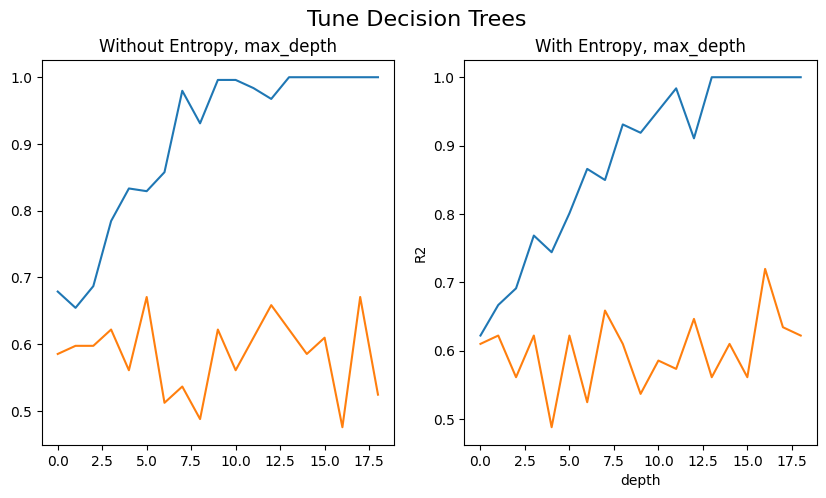

In [188]:
tune_dec_trees(X,y,cols)

##### Tune Random Forest and Feature Importance

100%|██████████| 19/19 [00:08<00:00,  2.26it/s]


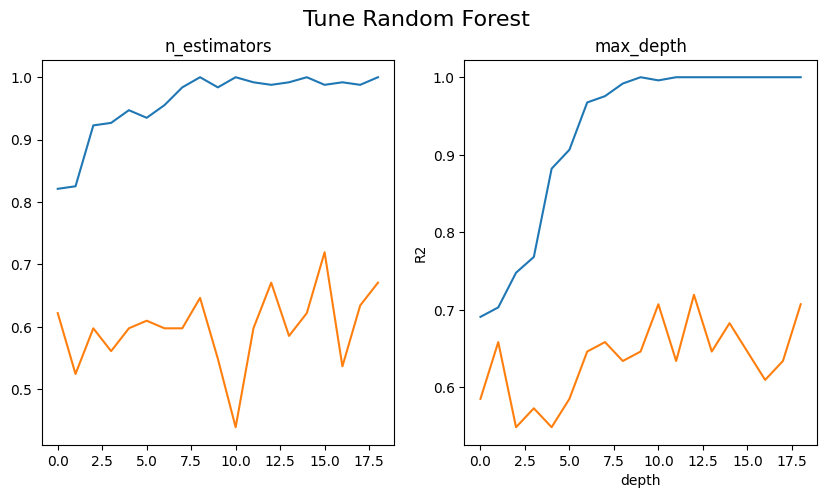

In [189]:
tune_rf(X,y,cols)

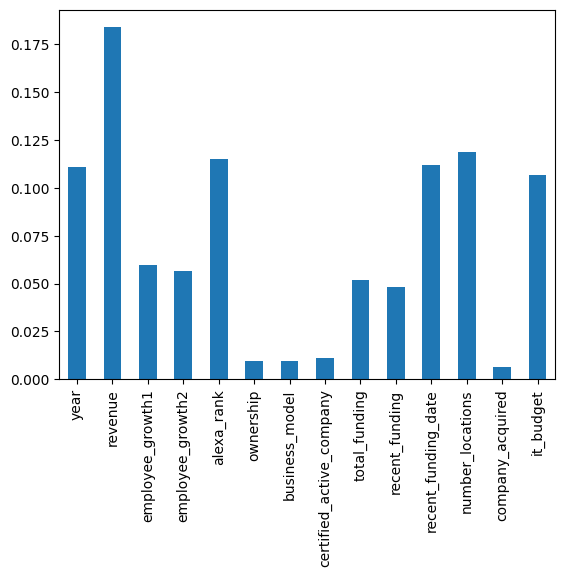

In [190]:
# Random Forest Feature Importance
rf = RandomForestClassifier(n_estimators=200, max_depth=30)
FeatureImportance(rf,X,y,cols)

##### Extra Trees: Tuning and Feature Impotance

100%|██████████| 24/24 [00:00<00:00, 36.67it/s]


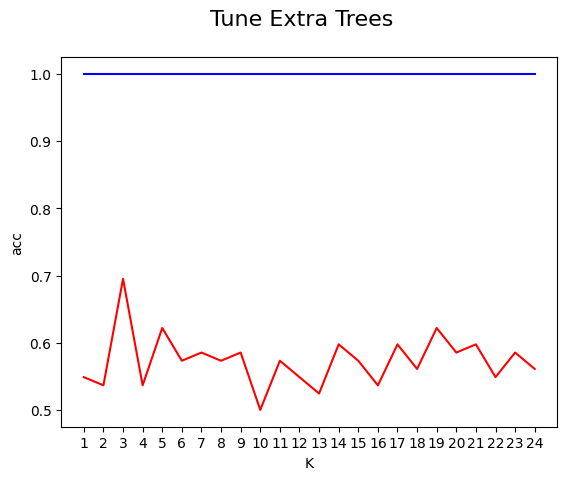

In [191]:
tune_et(X,y,cols)

##### KNN: Tuning and Feature Importance

100%|██████████| 19/19 [00:00<00:00, 31.28it/s]


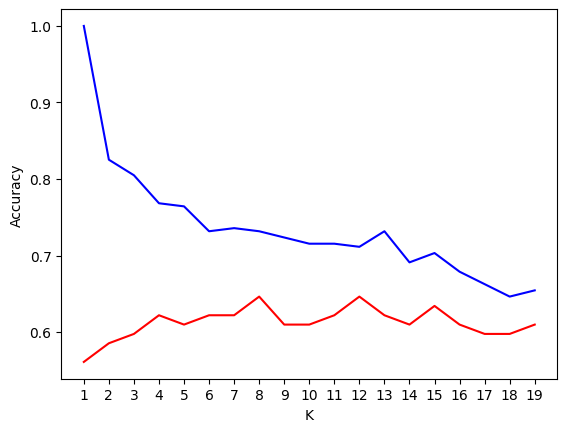

In [192]:
tune_knn(X,y,cols)

##### Gradient Boost: Feature Importance and Tuning

100%|██████████| 19/19 [00:00<00:00, 44.17it/s]


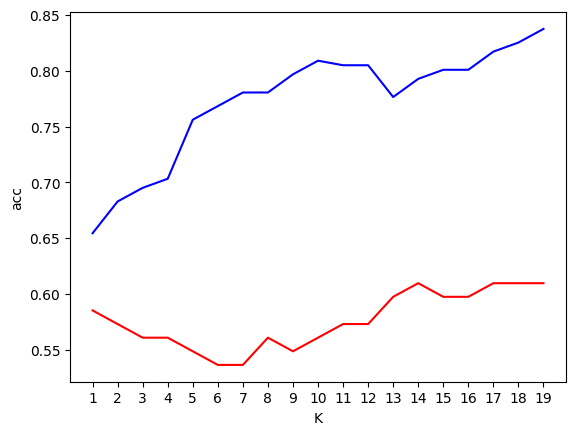

In [193]:
tune_gb(X,y,cols)

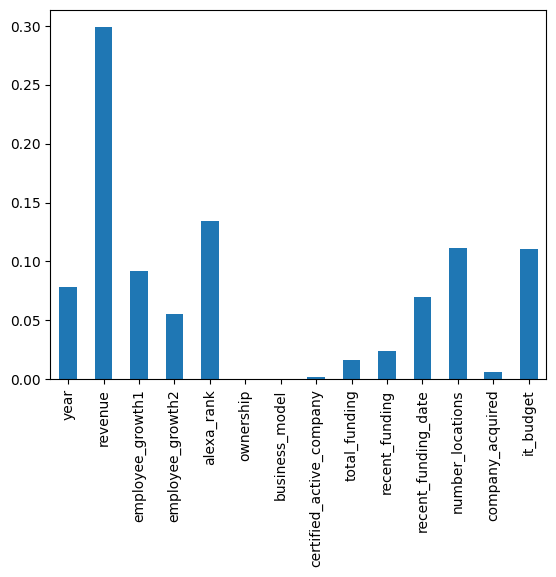

In [194]:
gb = GradientBoostingClassifier()
FeatureImportance(gb,X,y,cols)

##### LGBM Feature Importance

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000299 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

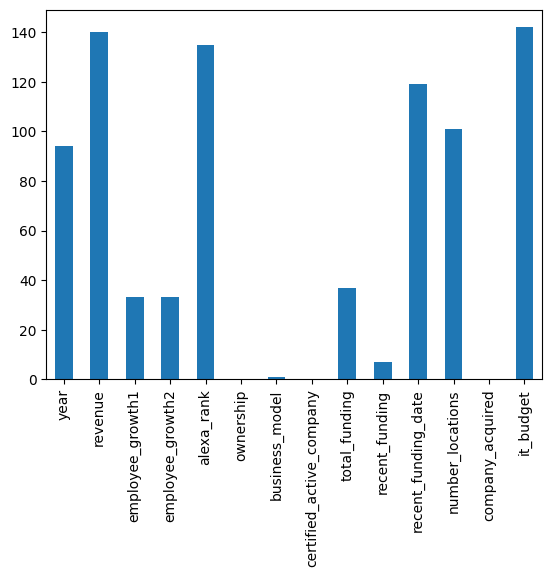

In [195]:
lgbm = LGBMClassifier()
FeatureImportance(lgbm,X,y,cols)

#### Accuracy

In [196]:
# Declares the models to be used for set difference classification
log = LogisticRegression()
dtrees = DecisionTreeClassifier(criterion='entropy', max_depth=3)
rf = RandomForestClassifier(max_depth = 3, n_estimators=3)
et = ExtraTreesClassifier(n_estimators=3)
knn = KNeighborsClassifier(n_neighbors=2)
gb = GradientBoostingClassifier(n_estimators=3)
xgb = XGBClassifier(objective="binary:logistic")
#cb = CatBoostClassifier()
lgbm = LGBMClassifier()

# Puts the models into a list
modelList = [log,dtrees,rf,et,knn,gb,xgb,lgbm]
modelNames = ['log','dtrees','rf','et','knn','gb','xgb','lgbm']

In [197]:
# Runs metrics of the models above from 1000 times
acc, pre, rec, roc = MultipleRuns(modelList,X,y, cols)

  0%|          | 1/1000 [00:00<05:23,  3.09it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  0%|          | 2/1000 [00:00<05:16,  3.15it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 13
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  0%|          | 3/1000 [00:00<04:59,  3.33it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  0%|          | 4/1000 [00:01<04:52,  3.41it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  0%|          | 5/1000 [00:01<04:58,  3.34it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

  1%|          | 6/1000 [00:01<04:54,  3.37it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  1%|          | 7/1000 [00:02<04:46,  3.47it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  1%|          | 8/1000 [00:02<04:48,  3.44it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  1%|          | 9/1000 [00:02<04:45,  3.47it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 522
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  1%|          | 10/1000 [00:02<04:38,  3.55it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000058 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  1%|          | 11/1000 [00:03<05:20,  3.09it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000079 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 499
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

  1%|          | 12/1000 [00:04<07:27,  2.21it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  1%|▏         | 13/1000 [00:04<08:12,  2.00it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000084 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  1%|▏         | 14/1000 [00:05<08:24,  1.95it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 516
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  2%|▏         | 15/1000 [00:05<08:26,  1.95it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  2%|▏         | 16/1000 [00:06<08:03,  2.04it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000084 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 495
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with

  2%|▏         | 17/1000 [00:06<07:17,  2.25it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000078 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

  2%|▏         | 18/1000 [00:06<06:33,  2.50it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  2%|▏         | 19/1000 [00:07<05:56,  2.75it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  2%|▏         | 20/1000 [00:07<05:31,  2.95it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000081 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

  2%|▏         | 21/1000 [00:07<05:15,  3.10it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  2%|▏         | 22/1000 [00:07<05:02,  3.23it/s]

[LightGBM] [Info] Number of positive: 134, number of negative: 112
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.544715 -> initscore=0.179341
[LightGBM] [Info] Start training from score 0.179341
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  2%|▏         | 23/1000 [00:08<04:58,  3.28it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 514
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  2%|▏         | 24/1000 [00:08<04:50,  3.36it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 499
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  2%|▎         | 25/1000 [00:08<04:48,  3.38it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

  3%|▎         | 26/1000 [00:09<04:43,  3.44it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000057 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 497
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

  3%|▎         | 27/1000 [00:09<04:44,  3.41it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  3%|▎         | 28/1000 [00:09<04:43,  3.43it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  3%|▎         | 29/1000 [00:10<05:34,  2.90it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 495
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  3%|▎         | 30/1000 [00:10<07:24,  2.18it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  3%|▎         | 31/1000 [00:11<09:59,  1.62it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000079 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 499
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  3%|▎         | 32/1000 [00:12<09:22,  1.72it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  3%|▎         | 33/1000 [00:13<10:59,  1.47it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000088 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

  3%|▎         | 34/1000 [00:13<09:55,  1.62it/s]

[LightGBM] [Info] Number of positive: 139, number of negative: 107
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000079 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.565041 -> initscore=0.261645
[LightGBM] [Info] Start training from score 0.261645
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  4%|▎         | 35/1000 [00:14<09:19,  1.73it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000085 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 514
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

  4%|▎         | 36/1000 [00:14<07:57,  2.02it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  4%|▎         | 37/1000 [00:14<06:58,  2.30it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

  4%|▍         | 38/1000 [00:15<06:19,  2.53it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  4%|▍         | 39/1000 [00:15<05:51,  2.73it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 514
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  4%|▍         | 40/1000 [00:15<05:27,  2.93it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000106 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  4%|▍         | 41/1000 [00:15<05:10,  3.09it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000081 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

  4%|▍         | 42/1000 [00:16<04:54,  3.25it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000059 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  4%|▍         | 43/1000 [00:16<05:23,  2.96it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

  4%|▍         | 44/1000 [00:17<06:26,  2.47it/s]

[LightGBM] [Info] Number of positive: 138, number of negative: 108
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000077 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.560976 -> initscore=0.245122
[LightGBM] [Info] Start training from score 0.245122
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  4%|▍         | 45/1000 [00:18<08:57,  1.78it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000083 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 498
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

  5%|▍         | 46/1000 [00:18<08:21,  1.90it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  5%|▍         | 47/1000 [00:19<09:04,  1.75it/s]

[LightGBM] [Info] Number of positive: 136, number of negative: 110
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000116 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 516
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.552846 -> initscore=0.212175
[LightGBM] [Info] Start training from score 0.212175
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

  5%|▍         | 48/1000 [00:19<08:38,  1.84it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 499
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  5%|▍         | 49/1000 [00:20<07:38,  2.07it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  5%|▌         | 50/1000 [00:20<06:50,  2.31it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000078 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

  5%|▌         | 51/1000 [00:20<06:11,  2.55it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000110 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 498
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

  5%|▌         | 52/1000 [00:20<05:39,  2.79it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

  5%|▌         | 53/1000 [00:21<05:32,  2.85it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 13
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  5%|▌         | 54/1000 [00:21<05:14,  3.00it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000090 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  6%|▌         | 55/1000 [00:21<05:03,  3.12it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  6%|▌         | 56/1000 [00:22<04:57,  3.17it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  6%|▌         | 57/1000 [00:22<04:50,  3.25it/s]

[LightGBM] [Info] Number of positive: 136, number of negative: 110
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000060 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.552846 -> initscore=0.212175
[LightGBM] [Info] Start training from score 0.212175
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  6%|▌         | 58/1000 [00:22<04:44,  3.31it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  6%|▌         | 59/1000 [00:23<04:38,  3.38it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  6%|▌         | 60/1000 [00:23<04:47,  3.27it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  6%|▌         | 61/1000 [00:23<04:42,  3.32it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  6%|▌         | 62/1000 [00:23<04:41,  3.33it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

  6%|▋         | 63/1000 [00:24<04:41,  3.33it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  6%|▋         | 64/1000 [00:24<04:38,  3.36it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  6%|▋         | 65/1000 [00:24<04:36,  3.38it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000082 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  7%|▋         | 66/1000 [00:25<04:32,  3.43it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  7%|▋         | 67/1000 [00:25<04:40,  3.32it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  7%|▋         | 68/1000 [00:25<04:38,  3.35it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000058 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 499
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

  7%|▋         | 69/1000 [00:26<04:39,  3.33it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  7%|▋         | 70/1000 [00:26<04:36,  3.36it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 496
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  7%|▋         | 71/1000 [00:26<04:36,  3.36it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 514
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  7%|▋         | 72/1000 [00:26<04:38,  3.34it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  7%|▋         | 73/1000 [00:27<04:35,  3.37it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  7%|▋         | 74/1000 [00:27<04:43,  3.27it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  8%|▊         | 75/1000 [00:27<04:43,  3.26it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  8%|▊         | 76/1000 [00:28<04:41,  3.29it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  8%|▊         | 77/1000 [00:28<04:45,  3.23it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000084 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  8%|▊         | 78/1000 [00:28<04:39,  3.30it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000080 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

  8%|▊         | 79/1000 [00:29<04:33,  3.37it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with

  8%|▊         | 80/1000 [00:29<04:28,  3.43it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 497
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  8%|▊         | 81/1000 [00:29<04:29,  3.41it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 517
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  8%|▊         | 82/1000 [00:29<04:39,  3.28it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 523
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  8%|▊         | 83/1000 [00:30<05:23,  2.84it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000100 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 496
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

  8%|▊         | 84/1000 [00:31<06:56,  2.20it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000090 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 517
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  8%|▊         | 85/1000 [00:31<07:25,  2.06it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  9%|▊         | 86/1000 [00:32<07:40,  1.98it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000113 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

  9%|▊         | 87/1000 [00:32<08:09,  1.86it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

  9%|▉         | 88/1000 [00:33<08:03,  1.89it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000082 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 517
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

  9%|▉         | 89/1000 [00:33<07:03,  2.15it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  9%|▉         | 90/1000 [00:33<06:16,  2.42it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  9%|▉         | 91/1000 [00:34<05:40,  2.67it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000080 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

  9%|▉         | 92/1000 [00:34<05:20,  2.83it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  9%|▉         | 93/1000 [00:34<05:04,  2.98it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 516
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  9%|▉         | 94/1000 [00:35<04:53,  3.09it/s]

[LightGBM] [Info] Number of positive: 134, number of negative: 112
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.544715 -> initscore=0.179341
[LightGBM] [Info] Start training from score 0.179341
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 10%|▉         | 95/1000 [00:35<04:44,  3.19it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 10%|▉         | 96/1000 [00:35<04:41,  3.21it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 10%|▉         | 97/1000 [00:36<04:36,  3.27it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 10%|▉         | 98/1000 [00:36<04:34,  3.29it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 500
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 10%|▉         | 99/1000 [00:36<04:31,  3.31it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 500
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 10%|█         | 100/1000 [00:36<04:31,  3.31it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 10%|█         | 101/1000 [00:37<04:29,  3.33it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 10%|█         | 102/1000 [00:37<04:27,  3.36it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 10%|█         | 103/1000 [00:37<04:27,  3.35it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 10%|█         | 104/1000 [00:38<04:25,  3.38it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 499
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 10%|█         | 105/1000 [00:38<04:25,  3.37it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 11%|█         | 106/1000 [00:38<04:25,  3.37it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 11%|█         | 107/1000 [00:39<04:27,  3.34it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 11%|█         | 108/1000 [00:39<04:24,  3.37it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000060 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 11%|█         | 109/1000 [00:39<04:26,  3.34it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 11%|█         | 110/1000 [00:39<04:27,  3.33it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000081 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 500
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with

 11%|█         | 111/1000 [00:40<04:20,  3.42it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 11%|█         | 112/1000 [00:40<04:24,  3.36it/s]

[LightGBM] [Info] Number of positive: 135, number of negative: 111
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 519
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.548780 -> initscore=0.195745
[LightGBM] [Info] Start training from score 0.195745
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 11%|█▏        | 113/1000 [00:40<04:23,  3.37it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000060 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 11%|█▏        | 114/1000 [00:41<04:21,  3.39it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 12%|█▏        | 115/1000 [00:41<04:18,  3.43it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 514
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 12%|█▏        | 116/1000 [00:41<04:23,  3.36it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 12%|█▏        | 117/1000 [00:41<04:22,  3.36it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 12%|█▏        | 118/1000 [00:42<04:23,  3.34it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 12%|█▏        | 119/1000 [00:42<04:21,  3.37it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 499
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 12%|█▏        | 120/1000 [00:42<04:20,  3.38it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000083 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 12%|█▏        | 121/1000 [00:43<04:21,  3.36it/s]

[LightGBM] [Info] Number of positive: 137, number of negative: 109
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000060 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.556911 -> initscore=0.228633
[LightGBM] [Info] Start training from score 0.228633
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 12%|█▏        | 122/1000 [00:43<04:22,  3.35it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 499
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 12%|█▏        | 123/1000 [00:43<04:59,  2.93it/s]

[LightGBM] [Info] Number of positive: 135, number of negative: 111
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.548780 -> initscore=0.195745
[LightGBM] [Info] Start training from score 0.195745
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 12%|█▏        | 124/1000 [00:44<06:51,  2.13it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000109 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 12%|█▎        | 125/1000 [00:45<06:54,  2.11it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 516
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 13%|█▎        | 126/1000 [00:45<07:06,  2.05it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000098 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 13%|█▎        | 127/1000 [00:46<07:11,  2.03it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 13%|█▎        | 128/1000 [00:46<07:04,  2.05it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 13%|█▎        | 129/1000 [00:47<06:55,  2.09it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000079 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 498
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 13%|█▎        | 130/1000 [00:47<06:07,  2.37it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 13%|█▎        | 131/1000 [00:47<05:39,  2.56it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 13%|█▎        | 132/1000 [00:48<05:13,  2.77it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000056 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 13%|█▎        | 133/1000 [00:48<04:58,  2.91it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 13%|█▎        | 134/1000 [00:48<04:55,  2.93it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 14%|█▎        | 135/1000 [00:48<04:45,  3.04it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 14%|█▎        | 136/1000 [00:49<04:37,  3.12it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000045 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 14%|█▎        | 137/1000 [00:49<04:31,  3.18it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 14%|█▍        | 138/1000 [00:49<04:28,  3.22it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 14%|█▍        | 139/1000 [00:50<04:22,  3.28it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 14%|█▍        | 140/1000 [00:50<04:22,  3.28it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000059 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 499
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 14%|█▍        | 141/1000 [00:50<04:24,  3.24it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 14%|█▍        | 142/1000 [00:51<04:18,  3.32it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 14%|█▍        | 143/1000 [00:51<04:21,  3.28it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 14%|█▍        | 144/1000 [00:51<04:21,  3.28it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 14%|█▍        | 145/1000 [00:51<04:18,  3.31it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 15%|█▍        | 146/1000 [00:52<04:18,  3.31it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 514
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 15%|█▍        | 147/1000 [00:52<04:17,  3.31it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 15%|█▍        | 148/1000 [00:52<04:17,  3.31it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 15%|█▍        | 149/1000 [00:53<04:17,  3.31it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000060 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 498
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 15%|█▌        | 150/1000 [00:53<04:17,  3.31it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000094 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 15%|█▌        | 151/1000 [00:53<04:19,  3.28it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 15%|█▌        | 152/1000 [00:54<04:17,  3.30it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 15%|█▌        | 153/1000 [00:54<04:13,  3.34it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000107 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 15%|█▌        | 154/1000 [00:54<04:13,  3.34it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 16%|█▌        | 155/1000 [00:55<04:18,  3.28it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000080 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 16%|█▌        | 156/1000 [00:55<04:13,  3.33it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000060 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 16%|█▌        | 157/1000 [00:55<04:16,  3.29it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 514
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 16%|█▌        | 158/1000 [00:55<04:09,  3.37it/s]

[LightGBM] [Info] Number of positive: 136, number of negative: 110
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.552846 -> initscore=0.212175
[LightGBM] [Info] Start training from score 0.212175
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 16%|█▌        | 159/1000 [00:56<04:05,  3.42it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 517
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 16%|█▌        | 160/1000 [00:56<04:06,  3.41it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 500
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 16%|█▌        | 161/1000 [00:56<04:11,  3.33it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000083 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 16%|█▌        | 162/1000 [00:57<04:14,  3.29it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 514
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 16%|█▋        | 163/1000 [00:57<04:48,  2.90it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000089 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 16%|█▋        | 164/1000 [00:58<06:28,  2.15it/s]

[LightGBM] [Info] Number of positive: 118, number of negative: 128
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000084 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.479675 -> initscore=-0.081346
[LightGBM] [Info] Start training from score -0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 16%|█▋        | 165/1000 [00:58<06:33,  2.12it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 17%|█▋        | 166/1000 [00:59<07:20,  1.89it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 500
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 17%|█▋        | 167/1000 [00:59<06:59,  1.98it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000092 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 17%|█▋        | 168/1000 [01:00<06:38,  2.09it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000078 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 17%|█▋        | 169/1000 [01:00<06:38,  2.09it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000077 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 17%|█▋        | 170/1000 [01:01<05:51,  2.36it/s]

[LightGBM] [Info] Number of positive: 134, number of negative: 112
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.544715 -> initscore=0.179341
[LightGBM] [Info] Start training from score 0.179341
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 17%|█▋        | 171/1000 [01:01<05:19,  2.59it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000060 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 497
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 17%|█▋        | 172/1000 [01:01<05:04,  2.72it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000092 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 17%|█▋        | 173/1000 [01:02<04:50,  2.84it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000089 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 17%|█▋        | 174/1000 [01:02<04:36,  2.99it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 18%|█▊        | 175/1000 [01:02<04:28,  3.07it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 18%|█▊        | 176/1000 [01:02<04:24,  3.12it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 18%|█▊        | 177/1000 [01:03<04:19,  3.18it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 514
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 18%|█▊        | 178/1000 [01:03<04:18,  3.18it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 18%|█▊        | 179/1000 [01:03<04:25,  3.09it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 18%|█▊        | 180/1000 [01:04<04:20,  3.14it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 18%|█▊        | 181/1000 [01:04<04:18,  3.17it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 18%|█▊        | 182/1000 [01:04<04:15,  3.20it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 18%|█▊        | 183/1000 [01:05<04:12,  3.24it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000086 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 18%|█▊        | 184/1000 [01:05<04:08,  3.28it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000091 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 18%|█▊        | 185/1000 [01:05<04:09,  3.27it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 499
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 19%|█▊        | 186/1000 [01:06<04:09,  3.26it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 19%|█▊        | 187/1000 [01:06<04:09,  3.26it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000084 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 19%|█▉        | 188/1000 [01:06<04:02,  3.35it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 19%|█▉        | 189/1000 [01:06<04:07,  3.28it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000077 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 19%|█▉        | 190/1000 [01:07<04:04,  3.31it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 19%|█▉        | 191/1000 [01:07<04:04,  3.31it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 19%|█▉        | 192/1000 [01:07<04:06,  3.28it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 19%|█▉        | 193/1000 [01:08<04:05,  3.29it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 19%|█▉        | 194/1000 [01:08<04:03,  3.30it/s]

[LightGBM] [Info] Number of positive: 135, number of negative: 111
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.548780 -> initscore=0.195745
[LightGBM] [Info] Start training from score 0.195745
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 20%|█▉        | 195/1000 [01:08<04:03,  3.30it/s]

[LightGBM] [Info] Number of positive: 135, number of negative: 111
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.548780 -> initscore=0.195745
[LightGBM] [Info] Start training from score 0.195745
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 20%|█▉        | 196/1000 [01:09<04:09,  3.22it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 20%|█▉        | 197/1000 [01:09<04:10,  3.21it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 20%|█▉        | 198/1000 [01:09<04:14,  3.15it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 20%|█▉        | 199/1000 [01:10<04:16,  3.13it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000088 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 20%|██        | 200/1000 [01:10<04:12,  3.17it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 20%|██        | 201/1000 [01:10<04:09,  3.20it/s]

[LightGBM] [Info] Number of positive: 136, number of negative: 110
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.552846 -> initscore=0.212175
[LightGBM] [Info] Start training from score 0.212175
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 20%|██        | 202/1000 [01:11<04:36,  2.89it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000082 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 514
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 20%|██        | 203/1000 [01:11<05:24,  2.45it/s]

[LightGBM] [Info] Number of positive: 137, number of negative: 109
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.556911 -> initscore=0.228633
[LightGBM] [Info] Start training from score 0.228633
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 20%|██        | 205/1000 [01:14<13:55,  1.05s/it]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 21%|██        | 206/1000 [01:14<10:55,  1.21it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 21%|██        | 207/1000 [01:15<08:57,  1.48it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000086 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 517
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 21%|██        | 208/1000 [01:15<07:31,  1.76it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 518
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 13
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 21%|██        | 209/1000 [01:15<06:28,  2.03it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 21%|██        | 210/1000 [01:16<05:47,  2.28it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 516
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 21%|██        | 211/1000 [01:16<05:14,  2.51it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000079 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 21%|██        | 212/1000 [01:16<04:57,  2.65it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 499
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 13
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 21%|██▏       | 213/1000 [01:17<04:39,  2.81it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000084 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 498
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 21%|██▏       | 214/1000 [01:17<04:29,  2.92it/s]

[LightGBM] [Info] Number of positive: 135, number of negative: 111
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.548780 -> initscore=0.195745
[LightGBM] [Info] Start training from score 0.195745
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 22%|██▏       | 215/1000 [01:17<04:20,  3.01it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 22%|██▏       | 216/1000 [01:18<04:14,  3.08it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 22%|██▏       | 217/1000 [01:18<04:14,  3.07it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 22%|██▏       | 218/1000 [01:18<04:14,  3.07it/s]

[LightGBM] [Info] Number of positive: 135, number of negative: 111
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.548780 -> initscore=0.195745
[LightGBM] [Info] Start training from score 0.195745
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 22%|██▏       | 219/1000 [01:19<04:10,  3.12it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 22%|██▏       | 220/1000 [01:19<04:06,  3.16it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 22%|██▏       | 221/1000 [01:19<04:02,  3.21it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 22%|██▏       | 222/1000 [01:20<04:01,  3.23it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 22%|██▏       | 223/1000 [01:20<04:00,  3.23it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 22%|██▏       | 224/1000 [01:20<04:03,  3.18it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 22%|██▎       | 225/1000 [01:20<03:58,  3.24it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000060 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 23%|██▎       | 226/1000 [01:21<04:00,  3.21it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 23%|██▎       | 227/1000 [01:21<04:03,  3.17it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 23%|██▎       | 228/1000 [01:21<04:01,  3.20it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000085 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 23%|██▎       | 229/1000 [01:22<04:00,  3.21it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 23%|██▎       | 230/1000 [01:22<04:00,  3.20it/s]

[LightGBM] [Info] Number of positive: 136, number of negative: 110
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 499
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.552846 -> initscore=0.212175
[LightGBM] [Info] Start training from score 0.212175
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 23%|██▎       | 231/1000 [01:22<04:00,  3.20it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 23%|██▎       | 232/1000 [01:23<03:58,  3.22it/s]

[LightGBM] [Info] Number of positive: 134, number of negative: 112
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.544715 -> initscore=0.179341
[LightGBM] [Info] Start training from score 0.179341
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 23%|██▎       | 233/1000 [01:23<04:01,  3.18it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000080 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 23%|██▎       | 234/1000 [01:23<04:03,  3.15it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000090 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 24%|██▎       | 235/1000 [01:24<04:04,  3.12it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 24%|██▎       | 236/1000 [01:24<04:05,  3.11it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000081 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 24%|██▎       | 237/1000 [01:24<04:34,  2.78it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000100 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 24%|██▍       | 238/1000 [01:25<04:57,  2.56it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000083 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 500
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 24%|██▍       | 239/1000 [01:26<06:05,  2.08it/s]

[LightGBM] [Info] Number of positive: 136, number of negative: 110
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000080 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.552846 -> initscore=0.212175
[LightGBM] [Info] Start training from score 0.212175
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 24%|██▍       | 240/1000 [01:26<06:27,  1.96it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000089 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 24%|██▍       | 241/1000 [01:27<06:17,  2.01it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 24%|██▍       | 242/1000 [01:27<06:16,  2.02it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000078 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 24%|██▍       | 243/1000 [01:28<06:19,  1.99it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 24%|██▍       | 244/1000 [01:28<06:12,  2.03it/s]

[LightGBM] [Info] Number of positive: 136, number of negative: 110
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000080 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.552846 -> initscore=0.212175
[LightGBM] [Info] Start training from score 0.212175
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 24%|██▍       | 245/1000 [01:28<05:35,  2.25it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 497
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 25%|██▍       | 246/1000 [01:29<05:02,  2.49it/s]

[LightGBM] [Info] Number of positive: 136, number of negative: 110
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.552846 -> initscore=0.212175
[LightGBM] [Info] Start training from score 0.212175
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 25%|██▍       | 247/1000 [01:29<04:45,  2.64it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 25%|██▍       | 248/1000 [01:29<04:31,  2.77it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 25%|██▍       | 249/1000 [01:30<04:20,  2.88it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 25%|██▌       | 250/1000 [01:30<04:17,  2.91it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 25%|██▌       | 251/1000 [01:30<04:10,  2.99it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 25%|██▌       | 252/1000 [01:31<04:05,  3.04it/s]

[LightGBM] [Info] Number of positive: 136, number of negative: 110
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.552846 -> initscore=0.212175
[LightGBM] [Info] Start training from score 0.212175
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 25%|██▌       | 253/1000 [01:31<04:05,  3.05it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 25%|██▌       | 254/1000 [01:31<04:05,  3.04it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000086 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 26%|██▌       | 255/1000 [01:32<04:04,  3.04it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 514
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 26%|██▌       | 256/1000 [01:32<04:04,  3.04it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000083 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 500
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 26%|██▌       | 257/1000 [01:32<03:57,  3.13it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 26%|██▌       | 258/1000 [01:33<03:59,  3.10it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 26%|██▌       | 259/1000 [01:33<03:59,  3.10it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 26%|██▌       | 260/1000 [01:33<03:59,  3.10it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 516
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 26%|██▌       | 261/1000 [01:34<03:57,  3.11it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 26%|██▌       | 262/1000 [01:34<03:56,  3.12it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 26%|██▋       | 263/1000 [01:34<03:55,  3.13it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000060 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 26%|██▋       | 264/1000 [01:34<03:55,  3.12it/s]

[LightGBM] [Info] Number of positive: 115, number of negative: 131
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.467480 -> initscore=-0.130265
[LightGBM] [Info] Start training from score -0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 26%|██▋       | 265/1000 [01:35<03:55,  3.12it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 27%|██▋       | 266/1000 [01:35<03:56,  3.11it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000093 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 27%|██▋       | 267/1000 [01:35<03:54,  3.13it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 27%|██▋       | 268/1000 [01:36<03:55,  3.11it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 27%|██▋       | 269/1000 [01:36<03:55,  3.10it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000078 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 27%|██▋       | 270/1000 [01:36<03:54,  3.12it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 514
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 27%|██▋       | 271/1000 [01:37<03:55,  3.09it/s]

[LightGBM] [Info] Number of positive: 135, number of negative: 111
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.548780 -> initscore=0.195745
[LightGBM] [Info] Start training from score 0.195745
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 27%|██▋       | 272/1000 [01:37<03:55,  3.09it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 27%|██▋       | 273/1000 [01:37<03:54,  3.10it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 27%|██▋       | 274/1000 [01:38<03:52,  3.12it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 28%|██▊       | 275/1000 [01:38<03:56,  3.07it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 28%|██▊       | 276/1000 [01:39<04:59,  2.42it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 28%|██▊       | 277/1000 [01:39<05:55,  2.03it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 28%|██▊       | 278/1000 [01:40<06:16,  1.92it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 28%|██▊       | 279/1000 [01:40<06:03,  1.98it/s]

[LightGBM] [Info] Number of positive: 134, number of negative: 112
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000082 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.544715 -> initscore=0.179341
[LightGBM] [Info] Start training from score 0.179341
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 28%|██▊       | 280/1000 [01:41<06:31,  1.84it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000099 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 28%|██▊       | 281/1000 [01:42<06:19,  1.90it/s]

[LightGBM] [Info] Number of positive: 135, number of negative: 111
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.548780 -> initscore=0.195745
[LightGBM] [Info] Start training from score 0.195745
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 28%|██▊       | 282/1000 [01:42<06:02,  1.98it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 28%|██▊       | 283/1000 [01:42<05:18,  2.25it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 494
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 28%|██▊       | 284/1000 [01:43<04:52,  2.45it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 28%|██▊       | 285/1000 [01:43<04:37,  2.57it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 29%|██▊       | 286/1000 [01:43<04:21,  2.73it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 500
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 29%|██▊       | 287/1000 [01:44<04:09,  2.86it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000060 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 29%|██▉       | 288/1000 [01:44<04:04,  2.91it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000079 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 13
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 29%|██▉       | 289/1000 [01:44<04:01,  2.94it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 500
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 29%|██▉       | 290/1000 [01:45<03:58,  2.98it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 29%|██▉       | 291/1000 [01:45<03:56,  3.00it/s]

[LightGBM] [Info] Number of positive: 135, number of negative: 111
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000083 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.548780 -> initscore=0.195745
[LightGBM] [Info] Start training from score 0.195745
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 29%|██▉       | 292/1000 [01:45<03:57,  2.99it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 29%|██▉       | 293/1000 [01:46<03:54,  3.01it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 29%|██▉       | 294/1000 [01:46<03:52,  3.03it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 30%|██▉       | 295/1000 [01:46<03:54,  3.00it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 30%|██▉       | 296/1000 [01:47<03:52,  3.03it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 30%|██▉       | 297/1000 [01:47<03:52,  3.03it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 30%|██▉       | 298/1000 [01:47<03:58,  2.94it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000080 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 30%|██▉       | 299/1000 [01:48<03:53,  3.00it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000084 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 30%|███       | 300/1000 [01:48<03:52,  3.01it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000078 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 30%|███       | 301/1000 [01:48<03:57,  2.94it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 30%|███       | 302/1000 [01:49<03:53,  2.99it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000077 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 30%|███       | 303/1000 [01:49<03:50,  3.03it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 30%|███       | 304/1000 [01:49<03:53,  2.98it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000077 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 30%|███       | 305/1000 [01:50<03:51,  3.01it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 31%|███       | 306/1000 [01:50<03:47,  3.05it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 31%|███       | 307/1000 [01:50<03:46,  3.06it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 31%|███       | 308/1000 [01:51<03:46,  3.06it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 31%|███       | 309/1000 [01:51<03:45,  3.07it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 31%|███       | 310/1000 [01:51<03:49,  3.01it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 31%|███       | 311/1000 [01:51<03:47,  3.03it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000079 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 31%|███       | 312/1000 [01:52<03:39,  3.13it/s]

[LightGBM] [Info] Number of positive: 135, number of negative: 111
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.548780 -> initscore=0.195745
[LightGBM] [Info] Start training from score 0.195745
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 31%|███▏      | 313/1000 [01:52<04:03,  2.82it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 31%|███▏      | 314/1000 [01:53<04:39,  2.45it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 496
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 32%|███▏      | 315/1000 [01:54<06:44,  1.70it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 32%|███▏      | 316/1000 [01:55<07:46,  1.47it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 32%|███▏      | 317/1000 [01:55<07:13,  1.58it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000094 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 32%|███▏      | 318/1000 [01:56<06:32,  1.74it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000088 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 32%|███▏      | 319/1000 [01:56<05:40,  2.00it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 32%|███▏      | 320/1000 [01:56<05:03,  2.24it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000083 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 32%|███▏      | 321/1000 [01:57<04:44,  2.38it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 32%|███▏      | 322/1000 [01:57<04:29,  2.52it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 514
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 32%|███▏      | 323/1000 [01:57<04:12,  2.68it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000084 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 32%|███▏      | 324/1000 [01:58<04:06,  2.74it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 32%|███▎      | 325/1000 [01:58<04:04,  2.76it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 33%|███▎      | 326/1000 [01:58<03:53,  2.89it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000059 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 33%|███▎      | 327/1000 [01:59<03:56,  2.85it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000087 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 33%|███▎      | 328/1000 [01:59<03:48,  2.94it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 33%|███▎      | 329/1000 [01:59<03:44,  2.98it/s]

[LightGBM] [Info] Number of positive: 137, number of negative: 109
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.556911 -> initscore=0.228633
[LightGBM] [Info] Start training from score 0.228633
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 33%|███▎      | 330/1000 [02:00<03:45,  2.98it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 33%|███▎      | 331/1000 [02:00<03:46,  2.96it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 33%|███▎      | 332/1000 [02:00<03:42,  3.01it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 33%|███▎      | 333/1000 [02:01<03:40,  3.02it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 33%|███▎      | 334/1000 [02:01<03:40,  3.02it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000086 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 34%|███▎      | 335/1000 [02:01<03:43,  2.97it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 34%|███▎      | 336/1000 [02:02<03:46,  2.93it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000097 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 34%|███▎      | 337/1000 [02:02<03:40,  3.01it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 34%|███▍      | 338/1000 [02:02<03:40,  3.00it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 34%|███▍      | 339/1000 [02:03<03:39,  3.01it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 34%|███▍      | 340/1000 [02:03<03:40,  3.00it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 499
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 34%|███▍      | 341/1000 [02:03<03:39,  3.00it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 34%|███▍      | 342/1000 [02:04<03:38,  3.01it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 514
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 34%|███▍      | 343/1000 [02:04<03:39,  2.99it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000080 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 499
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 34%|███▍      | 344/1000 [02:04<03:39,  2.98it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000081 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 34%|███▍      | 345/1000 [02:05<03:39,  2.99it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000088 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 35%|███▍      | 346/1000 [02:05<03:39,  2.98it/s]

[LightGBM] [Info] Number of positive: 134, number of negative: 112
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000078 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.544715 -> initscore=0.179341
[LightGBM] [Info] Start training from score 0.179341
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 35%|███▍      | 347/1000 [02:05<03:40,  2.97it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000077 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 495
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 35%|███▍      | 348/1000 [02:06<03:59,  2.73it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000113 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 35%|███▍      | 349/1000 [02:06<04:29,  2.41it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 498
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 35%|███▌      | 350/1000 [02:07<06:25,  1.69it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 35%|███▌      | 351/1000 [02:08<07:29,  1.44it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 35%|███▌      | 352/1000 [02:09<06:52,  1.57it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 35%|███▌      | 353/1000 [02:09<06:22,  1.69it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000084 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 13
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 35%|███▌      | 354/1000 [02:10<05:29,  1.96it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 36%|███▌      | 355/1000 [02:10<04:54,  2.19it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 36%|███▌      | 356/1000 [02:10<04:35,  2.33it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000048 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 36%|███▌      | 357/1000 [02:11<04:17,  2.50it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 500
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 36%|███▌      | 358/1000 [02:11<04:04,  2.63it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000079 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 36%|███▌      | 359/1000 [02:11<03:58,  2.69it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 36%|███▌      | 360/1000 [02:12<03:50,  2.78it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 36%|███▌      | 361/1000 [02:12<03:45,  2.83it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000079 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 499
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 36%|███▌      | 362/1000 [02:12<03:46,  2.81it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 36%|███▋      | 363/1000 [02:13<03:41,  2.87it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 36%|███▋      | 364/1000 [02:13<03:39,  2.89it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 13
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 36%|███▋      | 365/1000 [02:13<03:40,  2.88it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 489
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 37%|███▋      | 366/1000 [02:14<03:35,  2.95it/s]

[LightGBM] [Info] Number of positive: 138, number of negative: 108
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000060 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.560976 -> initscore=0.245122
[LightGBM] [Info] Start training from score 0.245122
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 37%|███▋      | 367/1000 [02:14<03:35,  2.94it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 516
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 37%|███▋      | 368/1000 [02:14<03:36,  2.93it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 37%|███▋      | 369/1000 [02:15<03:31,  2.99it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 37%|███▋      | 370/1000 [02:15<03:30,  2.99it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000079 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 37%|███▋      | 371/1000 [02:15<03:31,  2.97it/s]

[LightGBM] [Info] Number of positive: 134, number of negative: 112
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.544715 -> initscore=0.179341
[LightGBM] [Info] Start training from score 0.179341
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 37%|███▋      | 372/1000 [02:16<03:28,  3.02it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 37%|███▋      | 373/1000 [02:16<03:27,  3.02it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 37%|███▋      | 374/1000 [02:16<03:29,  2.98it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 38%|███▊      | 375/1000 [02:17<03:28,  3.00it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 500
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 38%|███▊      | 376/1000 [02:17<03:28,  3.00it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 38%|███▊      | 377/1000 [02:17<03:28,  2.99it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000060 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 38%|███▊      | 378/1000 [02:18<03:27,  3.00it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 38%|███▊      | 379/1000 [02:18<03:25,  3.02it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 38%|███▊      | 380/1000 [02:18<03:28,  2.98it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 38%|███▊      | 381/1000 [02:19<03:27,  2.99it/s]

[LightGBM] [Info] Number of positive: 135, number of negative: 111
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 13
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.548780 -> initscore=0.195745
[LightGBM] [Info] Start training from score 0.195745
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 38%|███▊      | 382/1000 [02:19<03:28,  2.96it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000085 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 38%|███▊      | 383/1000 [02:19<03:33,  2.88it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 38%|███▊      | 384/1000 [02:20<04:21,  2.36it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 500
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 38%|███▊      | 385/1000 [02:20<04:34,  2.24it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 39%|███▊      | 386/1000 [02:21<05:07,  2.00it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000085 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 39%|███▊      | 387/1000 [02:22<05:51,  1.74it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 39%|███▉      | 388/1000 [02:22<06:08,  1.66it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 497
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 39%|███▉      | 389/1000 [02:23<05:44,  1.77it/s]

[LightGBM] [Info] Number of positive: 135, number of negative: 111
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000079 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.548780 -> initscore=0.195745
[LightGBM] [Info] Start training from score 0.195745
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 39%|███▉      | 390/1000 [02:23<05:10,  1.96it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 39%|███▉      | 391/1000 [02:24<04:41,  2.16it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 39%|███▉      | 392/1000 [02:24<04:18,  2.35it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 39%|███▉      | 393/1000 [02:24<04:00,  2.52it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000079 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 39%|███▉      | 394/1000 [02:25<03:53,  2.59it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000060 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 40%|███▉      | 395/1000 [02:25<03:44,  2.69it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 40%|███▉      | 396/1000 [02:25<03:36,  2.78it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 499
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 40%|███▉      | 397/1000 [02:26<03:34,  2.80it/s]

[LightGBM] [Info] Number of positive: 137, number of negative: 109
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.556911 -> initscore=0.228633
[LightGBM] [Info] Start training from score 0.228633
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 40%|███▉      | 398/1000 [02:26<03:30,  2.86it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 40%|███▉      | 399/1000 [02:26<03:28,  2.88it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 40%|████      | 400/1000 [02:27<03:25,  2.92it/s]

[LightGBM] [Info] Number of positive: 136, number of negative: 110
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.552846 -> initscore=0.212175
[LightGBM] [Info] Start training from score 0.212175
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 40%|████      | 401/1000 [02:27<03:25,  2.92it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 40%|████      | 402/1000 [02:27<03:18,  3.01it/s]

[LightGBM] [Info] Number of positive: 137, number of negative: 109
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.556911 -> initscore=0.228633
[LightGBM] [Info] Start training from score 0.228633
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 40%|████      | 403/1000 [02:28<03:20,  2.98it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 40%|████      | 404/1000 [02:28<03:19,  2.98it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 40%|████      | 405/1000 [02:28<03:17,  3.02it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 41%|████      | 406/1000 [02:29<03:21,  2.95it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000106 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 41%|████      | 407/1000 [02:29<03:18,  2.98it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 41%|████      | 408/1000 [02:29<03:19,  2.97it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000081 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 41%|████      | 409/1000 [02:30<03:18,  2.97it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000060 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 41%|████      | 410/1000 [02:30<03:20,  2.94it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 41%|████      | 411/1000 [02:30<03:16,  3.00it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000087 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 41%|████      | 412/1000 [02:31<03:17,  2.98it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 41%|████▏     | 413/1000 [02:31<03:18,  2.96it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 491
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 41%|████▏     | 414/1000 [02:31<03:22,  2.89it/s]

[LightGBM] [Info] Number of positive: 134, number of negative: 112
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000078 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.544715 -> initscore=0.179341
[LightGBM] [Info] Start training from score 0.179341
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 42%|████▏     | 415/1000 [02:32<03:21,  2.90it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000081 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 42%|████▏     | 416/1000 [02:32<03:20,  2.91it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 514
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 42%|████▏     | 417/1000 [02:33<03:23,  2.86it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000087 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 42%|████▏     | 418/1000 [02:33<03:20,  2.90it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 42%|████▏     | 419/1000 [02:33<03:22,  2.87it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000083 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 42%|████▏     | 420/1000 [02:34<03:44,  2.59it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 42%|████▏     | 421/1000 [02:34<03:54,  2.47it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000077 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 42%|████▏     | 422/1000 [02:35<04:04,  2.37it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000088 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 42%|████▏     | 423/1000 [02:36<05:57,  1.61it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 42%|████▏     | 424/1000 [02:36<06:27,  1.49it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000101 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 516
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 42%|████▎     | 425/1000 [02:37<06:03,  1.58it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000077 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 497
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 43%|████▎     | 426/1000 [02:37<05:13,  1.83it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 514
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 43%|████▎     | 427/1000 [02:38<04:39,  2.05it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000079 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 43%|████▎     | 428/1000 [02:38<04:13,  2.26it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 516
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 43%|████▎     | 429/1000 [02:38<03:57,  2.40it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 43%|████▎     | 430/1000 [02:39<03:43,  2.55it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 43%|████▎     | 431/1000 [02:39<03:34,  2.65it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 43%|████▎     | 432/1000 [02:39<03:33,  2.66it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 43%|████▎     | 433/1000 [02:40<03:28,  2.72it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000060 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 43%|████▎     | 434/1000 [02:40<03:25,  2.75it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 44%|████▎     | 435/1000 [02:41<03:25,  2.75it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 44%|████▎     | 436/1000 [02:41<03:22,  2.79it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000087 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 44%|████▎     | 437/1000 [02:41<03:18,  2.83it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 44%|████▍     | 438/1000 [02:42<03:16,  2.86it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 44%|████▍     | 439/1000 [02:42<03:18,  2.82it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 44%|████▍     | 440/1000 [02:42<03:15,  2.87it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 44%|████▍     | 441/1000 [02:43<03:15,  2.86it/s]

[LightGBM] [Info] Number of positive: 137, number of negative: 109
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.556911 -> initscore=0.228633
[LightGBM] [Info] Start training from score 0.228633
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 44%|████▍     | 442/1000 [02:43<03:14,  2.87it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000097 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 44%|████▍     | 443/1000 [02:43<03:14,  2.86it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000086 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 44%|████▍     | 444/1000 [02:44<03:12,  2.89it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 44%|████▍     | 445/1000 [02:44<03:12,  2.88it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000081 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 500
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 45%|████▍     | 446/1000 [02:44<03:12,  2.88it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 516
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 45%|████▍     | 447/1000 [02:45<03:11,  2.89it/s]

[LightGBM] [Info] Number of positive: 135, number of negative: 111
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.548780 -> initscore=0.195745
[LightGBM] [Info] Start training from score 0.195745
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 45%|████▍     | 448/1000 [02:45<03:14,  2.84it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000086 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 45%|████▍     | 449/1000 [02:45<03:09,  2.90it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 500
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 45%|████▌     | 450/1000 [02:46<03:09,  2.91it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 498
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 45%|████▌     | 451/1000 [02:46<03:08,  2.91it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 45%|████▌     | 452/1000 [02:46<03:08,  2.91it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 45%|████▌     | 453/1000 [02:47<03:08,  2.90it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 499
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 45%|████▌     | 454/1000 [02:47<03:07,  2.91it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 46%|████▌     | 455/1000 [02:48<03:30,  2.59it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000091 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 46%|████▌     | 456/1000 [02:48<04:05,  2.22it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 46%|████▌     | 457/1000 [02:49<04:04,  2.23it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000086 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 500
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 46%|████▌     | 458/1000 [02:49<04:55,  1.84it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 46%|████▌     | 459/1000 [02:50<06:01,  1.50it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 46%|████▌     | 460/1000 [02:51<05:29,  1.64it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000085 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 500
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 46%|████▌     | 461/1000 [02:51<05:01,  1.79it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000090 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 46%|████▌     | 462/1000 [02:52<04:26,  2.02it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000081 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 46%|████▋     | 463/1000 [02:52<04:04,  2.20it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 46%|████▋     | 464/1000 [02:52<03:46,  2.37it/s]

[LightGBM] [Info] Number of positive: 134, number of negative: 112
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000082 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.544715 -> initscore=0.179341
[LightGBM] [Info] Start training from score 0.179341
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 46%|████▋     | 465/1000 [02:53<03:32,  2.52it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 47%|████▋     | 466/1000 [02:53<03:26,  2.58it/s]

[LightGBM] [Info] Number of positive: 135, number of negative: 111
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.548780 -> initscore=0.195745
[LightGBM] [Info] Start training from score 0.195745
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 47%|████▋     | 467/1000 [02:53<03:20,  2.66it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 47%|████▋     | 468/1000 [02:54<03:16,  2.71it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 47%|████▋     | 469/1000 [02:54<03:12,  2.76it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 514
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 47%|████▋     | 470/1000 [02:54<03:09,  2.80it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 47%|████▋     | 471/1000 [02:55<03:07,  2.83it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000081 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 497
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 47%|████▋     | 472/1000 [02:55<03:06,  2.83it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 47%|████▋     | 473/1000 [02:55<03:05,  2.84it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 47%|████▋     | 474/1000 [02:56<03:03,  2.86it/s]

[LightGBM] [Info] Number of positive: 135, number of negative: 111
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 519
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.548780 -> initscore=0.195745
[LightGBM] [Info] Start training from score 0.195745
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 48%|████▊     | 475/1000 [02:56<03:05,  2.83it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 48%|████▊     | 476/1000 [02:57<03:02,  2.88it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 48%|████▊     | 477/1000 [02:57<03:01,  2.88it/s]

[LightGBM] [Info] Number of positive: 137, number of negative: 109
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.556911 -> initscore=0.228633
[LightGBM] [Info] Start training from score 0.228633
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 48%|████▊     | 478/1000 [02:57<03:01,  2.88it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 48%|████▊     | 479/1000 [02:58<03:01,  2.87it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 48%|████▊     | 480/1000 [02:58<03:03,  2.83it/s]

[LightGBM] [Info] Number of positive: 139, number of negative: 107
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.565041 -> initscore=0.261645
[LightGBM] [Info] Start training from score 0.261645
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 48%|████▊     | 481/1000 [02:58<03:03,  2.83it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 500
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 48%|████▊     | 482/1000 [02:59<03:01,  2.86it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 48%|████▊     | 483/1000 [02:59<03:01,  2.85it/s]

[LightGBM] [Info] Number of positive: 136, number of negative: 110
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.552846 -> initscore=0.212175
[LightGBM] [Info] Start training from score 0.212175
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 48%|████▊     | 484/1000 [02:59<03:00,  2.86it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 48%|████▊     | 485/1000 [03:01<06:08,  1.40it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 49%|████▊     | 486/1000 [03:01<05:14,  1.63it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000079 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 13
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 49%|████▊     | 487/1000 [03:02<05:05,  1.68it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000089 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 49%|████▉     | 488/1000 [03:03<06:40,  1.28it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000085 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 49%|████▉     | 489/1000 [03:04<05:55,  1.44it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 49%|████▉     | 490/1000 [03:04<06:00,  1.41it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000085 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 49%|████▉     | 491/1000 [03:05<05:31,  1.54it/s]

[LightGBM] [Info] Number of positive: 134, number of negative: 112
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000095 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.544715 -> initscore=0.179341
[LightGBM] [Info] Start training from score 0.179341
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 49%|████▉     | 492/1000 [03:05<05:05,  1.66it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 49%|████▉     | 493/1000 [03:06<04:27,  1.90it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 49%|████▉     | 494/1000 [03:06<04:00,  2.10it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 50%|████▉     | 495/1000 [03:06<03:39,  2.30it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 50%|████▉     | 496/1000 [03:07<03:28,  2.42it/s]

[LightGBM] [Info] Number of positive: 137, number of negative: 109
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.556911 -> initscore=0.228633
[LightGBM] [Info] Start training from score 0.228633
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 50%|████▉     | 497/1000 [03:07<03:20,  2.51it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 50%|████▉     | 498/1000 [03:07<03:12,  2.60it/s]

[LightGBM] [Info] Number of positive: 136, number of negative: 110
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.552846 -> initscore=0.212175
[LightGBM] [Info] Start training from score 0.212175
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 50%|████▉     | 499/1000 [03:08<03:06,  2.69it/s]

[LightGBM] [Info] Number of positive: 134, number of negative: 112
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.544715 -> initscore=0.179341
[LightGBM] [Info] Start training from score 0.179341
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 50%|█████     | 500/1000 [03:08<03:00,  2.78it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 50%|█████     | 501/1000 [03:08<03:00,  2.76it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 517
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 50%|█████     | 502/1000 [03:09<03:00,  2.76it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000078 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 50%|█████     | 503/1000 [03:09<03:01,  2.74it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000088 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 497
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 50%|█████     | 504/1000 [03:10<03:01,  2.73it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 50%|█████     | 505/1000 [03:10<02:57,  2.79it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 51%|█████     | 506/1000 [03:10<02:54,  2.84it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 51%|█████     | 507/1000 [03:11<02:54,  2.83it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 51%|█████     | 508/1000 [03:11<02:49,  2.90it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 51%|█████     | 509/1000 [03:11<02:54,  2.82it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000104 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 520
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 51%|█████     | 510/1000 [03:12<02:51,  2.85it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 51%|█████     | 511/1000 [03:12<02:52,  2.84it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 51%|█████     | 512/1000 [03:12<02:55,  2.79it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 51%|█████▏    | 513/1000 [03:13<02:55,  2.78it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 498
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 51%|█████▏    | 514/1000 [03:13<02:53,  2.80it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 52%|█████▏    | 515/1000 [03:13<02:50,  2.84it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 52%|█████▏    | 516/1000 [03:14<02:53,  2.79it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 52%|█████▏    | 517/1000 [03:14<02:52,  2.81it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000096 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 500
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 52%|█████▏    | 518/1000 [03:14<02:50,  2.83it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 52%|█████▏    | 519/1000 [03:15<02:53,  2.77it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000077 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 52%|█████▏    | 520/1000 [03:15<02:54,  2.76it/s]

[LightGBM] [Info] Number of positive: 135, number of negative: 111
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.548780 -> initscore=0.195745
[LightGBM] [Info] Start training from score 0.195745
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 52%|█████▏    | 521/1000 [03:16<03:05,  2.59it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000102 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 52%|█████▏    | 522/1000 [03:16<03:20,  2.39it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 52%|█████▏    | 523/1000 [03:17<03:27,  2.30it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000098 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 52%|█████▏    | 524/1000 [03:17<03:26,  2.31it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000078 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 52%|█████▎    | 525/1000 [03:18<04:37,  1.71it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 53%|█████▎    | 526/1000 [03:19<04:51,  1.63it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 53%|█████▎    | 527/1000 [03:19<04:36,  1.71it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 53%|█████▎    | 528/1000 [03:20<04:24,  1.79it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000094 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 517
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 53%|█████▎    | 529/1000 [03:20<03:55,  2.00it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 53%|█████▎    | 530/1000 [03:20<03:33,  2.20it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 53%|█████▎    | 531/1000 [03:21<03:18,  2.36it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 53%|█████▎    | 532/1000 [03:21<03:12,  2.43it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000090 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with

 53%|█████▎    | 533/1000 [03:21<03:05,  2.52it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 514
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 53%|█████▎    | 534/1000 [03:22<02:58,  2.61it/s]

[LightGBM] [Info] Number of positive: 134, number of negative: 112
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000082 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.544715 -> initscore=0.179341
[LightGBM] [Info] Start training from score 0.179341
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 54%|█████▎    | 535/1000 [03:22<02:56,  2.63it/s]

[LightGBM] [Info] Number of positive: 138, number of negative: 108
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000079 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.560976 -> initscore=0.245122
[LightGBM] [Info] Start training from score 0.245122
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 54%|█████▎    | 536/1000 [03:23<02:52,  2.68it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 500
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 54%|█████▎    | 537/1000 [03:23<02:48,  2.74it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000048 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 54%|█████▍    | 538/1000 [03:23<02:52,  2.68it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000100 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 517
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 54%|█████▍    | 539/1000 [03:24<02:49,  2.72it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000079 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 54%|█████▍    | 540/1000 [03:24<02:47,  2.75it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 54%|█████▍    | 541/1000 [03:24<02:48,  2.72it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 54%|█████▍    | 542/1000 [03:25<02:46,  2.75it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 54%|█████▍    | 543/1000 [03:25<02:45,  2.76it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000088 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 54%|█████▍    | 544/1000 [03:25<02:44,  2.78it/s]

[LightGBM] [Info] Number of positive: 134, number of negative: 112
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 514
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.544715 -> initscore=0.179341
[LightGBM] [Info] Start training from score 0.179341
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 55%|█████▍    | 545/1000 [03:26<02:43,  2.79it/s]

[LightGBM] [Info] Number of positive: 138, number of negative: 108
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000084 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.560976 -> initscore=0.245122
[LightGBM] [Info] Start training from score 0.245122
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 55%|█████▍    | 546/1000 [03:26<02:42,  2.79it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 55%|█████▍    | 547/1000 [03:27<02:41,  2.80it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000079 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 55%|█████▍    | 548/1000 [03:27<02:41,  2.81it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 55%|█████▍    | 549/1000 [03:27<02:41,  2.80it/s]

[LightGBM] [Info] Number of positive: 134, number of negative: 112
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000087 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.544715 -> initscore=0.179341
[LightGBM] [Info] Start training from score 0.179341
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 55%|█████▌    | 550/1000 [03:28<02:42,  2.77it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 55%|█████▌    | 551/1000 [03:28<02:40,  2.79it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 55%|█████▌    | 552/1000 [03:28<02:42,  2.76it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 516
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 55%|█████▌    | 553/1000 [03:29<02:39,  2.80it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000089 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 55%|█████▌    | 554/1000 [03:29<02:40,  2.78it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 56%|█████▌    | 555/1000 [03:29<02:39,  2.79it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 56%|█████▌    | 556/1000 [03:30<02:48,  2.63it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000089 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 56%|█████▌    | 557/1000 [03:31<04:06,  1.80it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000088 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 56%|█████▌    | 558/1000 [03:32<04:34,  1.61it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 56%|█████▌    | 559/1000 [03:32<04:19,  1.70it/s]

[LightGBM] [Info] Number of positive: 134, number of negative: 112
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000083 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.544715 -> initscore=0.179341
[LightGBM] [Info] Start training from score 0.179341
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 56%|█████▌    | 560/1000 [03:33<04:32,  1.61it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 56%|█████▌    | 561/1000 [03:33<04:14,  1.73it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000112 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 56%|█████▌    | 562/1000 [03:34<04:11,  1.74it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000082 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 56%|█████▋    | 563/1000 [03:34<03:41,  1.98it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 499
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 56%|█████▋    | 564/1000 [03:35<03:23,  2.15it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000083 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 56%|█████▋    | 565/1000 [03:35<03:08,  2.31it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 57%|█████▋    | 566/1000 [03:35<02:57,  2.45it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 57%|█████▋    | 567/1000 [03:36<02:52,  2.51it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 57%|█████▋    | 568/1000 [03:36<02:45,  2.61it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000077 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 57%|█████▋    | 569/1000 [03:36<02:43,  2.64it/s]

[LightGBM] [Info] Number of positive: 136, number of negative: 110
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000085 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.552846 -> initscore=0.212175
[LightGBM] [Info] Start training from score 0.212175
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 57%|█████▋    | 570/1000 [03:37<02:41,  2.66it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 57%|█████▋    | 571/1000 [03:37<02:38,  2.71it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 57%|█████▋    | 572/1000 [03:37<02:37,  2.71it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 57%|█████▋    | 573/1000 [03:38<02:38,  2.69it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 57%|█████▋    | 574/1000 [03:38<02:37,  2.71it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 57%|█████▊    | 575/1000 [03:39<02:37,  2.70it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000087 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 58%|█████▊    | 576/1000 [03:39<02:38,  2.68it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 58%|█████▊    | 577/1000 [03:39<02:35,  2.72it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 58%|█████▊    | 578/1000 [03:40<02:39,  2.65it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 58%|█████▊    | 579/1000 [03:40<02:38,  2.66it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 58%|█████▊    | 580/1000 [03:40<02:35,  2.71it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 58%|█████▊    | 581/1000 [03:41<02:33,  2.73it/s]

[LightGBM] [Info] Number of positive: 118, number of negative: 128
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.479675 -> initscore=-0.081346
[LightGBM] [Info] Start training from score -0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 58%|█████▊    | 582/1000 [03:41<02:34,  2.71it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 58%|█████▊    | 583/1000 [03:42<02:32,  2.73it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 58%|█████▊    | 584/1000 [03:42<02:32,  2.73it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 520
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 58%|█████▊    | 585/1000 [03:42<02:30,  2.75it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 499
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 59%|█████▊    | 586/1000 [03:43<02:31,  2.74it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 13
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 59%|█████▊    | 587/1000 [03:43<02:33,  2.69it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000082 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 59%|█████▉    | 588/1000 [03:43<02:30,  2.73it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 59%|█████▉    | 589/1000 [03:44<02:29,  2.74it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 59%|█████▉    | 590/1000 [03:44<03:00,  2.27it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000088 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 59%|█████▉    | 591/1000 [03:45<03:09,  2.16it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000077 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 59%|█████▉    | 592/1000 [03:45<03:14,  2.09it/s]

[LightGBM] [Info] Number of positive: 136, number of negative: 110
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.552846 -> initscore=0.212175
[LightGBM] [Info] Start training from score 0.212175
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 59%|█████▉    | 593/1000 [03:46<03:14,  2.09it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000110 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 59%|█████▉    | 594/1000 [03:46<03:17,  2.05it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000086 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 60%|█████▉    | 595/1000 [03:47<03:18,  2.04it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000098 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 514
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 60%|█████▉    | 596/1000 [03:48<04:01,  1.67it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000084 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 60%|█████▉    | 597/1000 [03:48<04:01,  1.67it/s]

[LightGBM] [Info] Number of positive: 134, number of negative: 112
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000078 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 500
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.544715 -> initscore=0.179341
[LightGBM] [Info] Start training from score 0.179341
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 60%|█████▉    | 598/1000 [03:49<03:43,  1.80it/s]

[LightGBM] [Info] Number of positive: 135, number of negative: 111
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.548780 -> initscore=0.195745
[LightGBM] [Info] Start training from score 0.195745
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 60%|█████▉    | 599/1000 [03:49<03:18,  2.02it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 60%|██████    | 600/1000 [03:49<03:05,  2.16it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 60%|██████    | 601/1000 [03:50<02:53,  2.30it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 60%|██████    | 602/1000 [03:50<02:43,  2.43it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000094 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 60%|██████    | 603/1000 [03:51<02:38,  2.50it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 60%|██████    | 604/1000 [03:51<02:34,  2.57it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 60%|██████    | 605/1000 [03:51<02:31,  2.61it/s]

[LightGBM] [Info] Number of positive: 135, number of negative: 111
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 518
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.548780 -> initscore=0.195745
[LightGBM] [Info] Start training from score 0.195745
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 61%|██████    | 606/1000 [03:52<02:26,  2.69it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 61%|██████    | 607/1000 [03:52<02:26,  2.67it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 61%|██████    | 608/1000 [03:52<02:25,  2.70it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000060 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 61%|██████    | 609/1000 [03:53<02:24,  2.71it/s]

[LightGBM] [Info] Number of positive: 136, number of negative: 110
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.552846 -> initscore=0.212175
[LightGBM] [Info] Start training from score 0.212175
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 61%|██████    | 610/1000 [03:53<02:22,  2.73it/s]

[LightGBM] [Info] Number of positive: 134, number of negative: 112
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.544715 -> initscore=0.179341
[LightGBM] [Info] Start training from score 0.179341
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 61%|██████    | 611/1000 [03:53<02:22,  2.73it/s]

[LightGBM] [Info] Number of positive: 134, number of negative: 112
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.544715 -> initscore=0.179341
[LightGBM] [Info] Start training from score 0.179341
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 61%|██████    | 612/1000 [03:54<02:22,  2.73it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000082 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 61%|██████▏   | 613/1000 [03:54<02:20,  2.75it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 497
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 61%|██████▏   | 614/1000 [03:55<02:21,  2.73it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 62%|██████▏   | 615/1000 [03:55<02:22,  2.70it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 62%|██████▏   | 616/1000 [03:55<02:21,  2.72it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000097 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 62%|██████▏   | 617/1000 [03:56<02:21,  2.70it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000079 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 62%|██████▏   | 618/1000 [03:56<02:21,  2.71it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 62%|██████▏   | 619/1000 [03:56<02:21,  2.70it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 497
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 62%|██████▏   | 620/1000 [03:57<02:20,  2.70it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000103 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 516
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 62%|██████▏   | 621/1000 [03:57<02:19,  2.72it/s]

[LightGBM] [Info] Number of positive: 136, number of negative: 110
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.552846 -> initscore=0.212175
[LightGBM] [Info] Start training from score 0.212175
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 62%|██████▏   | 622/1000 [03:58<02:18,  2.72it/s]

[LightGBM] [Info] Number of positive: 134, number of negative: 112
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.544715 -> initscore=0.179341
[LightGBM] [Info] Start training from score 0.179341
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 62%|██████▏   | 623/1000 [03:58<02:19,  2.71it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 495
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 62%|██████▏   | 624/1000 [03:58<02:18,  2.72it/s]

[LightGBM] [Info] Number of positive: 136, number of negative: 110
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 519
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.552846 -> initscore=0.212175
[LightGBM] [Info] Start training from score 0.212175
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 62%|██████▎   | 625/1000 [03:59<02:20,  2.67it/s]

[LightGBM] [Info] Number of positive: 134, number of negative: 112
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 497
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.544715 -> initscore=0.179341
[LightGBM] [Info] Start training from score 0.179341
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 63%|██████▎   | 626/1000 [03:59<02:43,  2.28it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000082 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 500
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 63%|██████▎   | 627/1000 [04:00<02:50,  2.19it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 63%|██████▎   | 628/1000 [04:00<02:57,  2.10it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000084 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 500
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 63%|██████▎   | 629/1000 [04:01<03:06,  1.99it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000145 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 63%|██████▎   | 630/1000 [04:02<04:20,  1.42it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 63%|██████▎   | 631/1000 [04:03<04:01,  1.53it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000077 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 63%|██████▎   | 632/1000 [04:03<03:45,  1.63it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 63%|██████▎   | 633/1000 [04:03<03:18,  1.84it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 63%|██████▎   | 634/1000 [04:04<02:59,  2.04it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 64%|██████▎   | 635/1000 [04:04<02:46,  2.19it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000060 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 64%|██████▎   | 636/1000 [04:05<02:35,  2.34it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000060 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 64%|██████▎   | 637/1000 [04:05<02:30,  2.42it/s]

[LightGBM] [Info] Number of positive: 135, number of negative: 111
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.548780 -> initscore=0.195745
[LightGBM] [Info] Start training from score 0.195745
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 64%|██████▍   | 638/1000 [04:05<02:24,  2.50it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000084 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 64%|██████▍   | 639/1000 [04:06<02:19,  2.59it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 64%|██████▍   | 640/1000 [04:06<02:19,  2.59it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 64%|██████▍   | 641/1000 [04:06<02:16,  2.64it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 64%|██████▍   | 642/1000 [04:07<02:14,  2.65it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000083 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 497
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 64%|██████▍   | 643/1000 [04:07<02:15,  2.63it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 64%|██████▍   | 644/1000 [04:08<02:14,  2.65it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000086 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 64%|██████▍   | 645/1000 [04:08<02:13,  2.66it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000079 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 65%|██████▍   | 646/1000 [04:08<02:12,  2.67it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 65%|██████▍   | 647/1000 [04:09<02:11,  2.67it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000082 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 65%|██████▍   | 648/1000 [04:09<02:11,  2.69it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 65%|██████▍   | 649/1000 [04:09<02:11,  2.66it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 65%|██████▌   | 650/1000 [04:10<02:13,  2.63it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 65%|██████▌   | 651/1000 [04:10<02:13,  2.62it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000078 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 65%|██████▌   | 652/1000 [04:11<02:10,  2.67it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 492
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 65%|██████▌   | 653/1000 [04:11<02:10,  2.65it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000093 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 65%|██████▌   | 654/1000 [04:11<02:11,  2.63it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 66%|██████▌   | 655/1000 [04:12<02:10,  2.64it/s]

[LightGBM] [Info] Number of positive: 134, number of negative: 112
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.544715 -> initscore=0.179341
[LightGBM] [Info] Start training from score 0.179341
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 66%|██████▌   | 656/1000 [04:12<02:10,  2.63it/s]

[LightGBM] [Info] Number of positive: 134, number of negative: 112
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000084 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.544715 -> initscore=0.179341
[LightGBM] [Info] Start training from score 0.179341
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 66%|██████▌   | 657/1000 [04:12<02:13,  2.58it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 66%|██████▌   | 658/1000 [04:13<02:12,  2.58it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 66%|██████▌   | 659/1000 [04:13<02:27,  2.31it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000085 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 66%|██████▌   | 660/1000 [04:14<02:36,  2.17it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 66%|██████▌   | 661/1000 [04:14<02:42,  2.08it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 516
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 66%|██████▌   | 662/1000 [04:16<04:02,  1.39it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 500
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 66%|██████▋   | 663/1000 [04:16<03:59,  1.41it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000078 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 66%|██████▋   | 664/1000 [04:17<03:50,  1.45it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 66%|██████▋   | 665/1000 [04:18<03:25,  1.63it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 67%|██████▋   | 666/1000 [04:18<03:00,  1.85it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 67%|██████▋   | 667/1000 [04:18<02:44,  2.03it/s]

[LightGBM] [Info] Number of positive: 134, number of negative: 112
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000078 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 499
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.544715 -> initscore=0.179341
[LightGBM] [Info] Start training from score 0.179341
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 67%|██████▋   | 668/1000 [04:19<02:35,  2.14it/s]

[LightGBM] [Info] Number of positive: 134, number of negative: 112
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.544715 -> initscore=0.179341
[LightGBM] [Info] Start training from score 0.179341
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 67%|██████▋   | 669/1000 [04:19<02:24,  2.29it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 67%|██████▋   | 670/1000 [04:19<02:18,  2.39it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000089 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 67%|██████▋   | 671/1000 [04:20<02:14,  2.45it/s]

[LightGBM] [Info] Number of positive: 135, number of negative: 111
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.548780 -> initscore=0.195745
[LightGBM] [Info] Start training from score 0.195745
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 67%|██████▋   | 672/1000 [04:20<02:12,  2.48it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 67%|██████▋   | 673/1000 [04:21<02:10,  2.51it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 13
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 67%|██████▋   | 674/1000 [04:21<02:07,  2.55it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 68%|██████▊   | 675/1000 [04:21<02:04,  2.62it/s]

[LightGBM] [Info] Number of positive: 135, number of negative: 111
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.548780 -> initscore=0.195745
[LightGBM] [Info] Start training from score 0.195745
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 68%|██████▊   | 676/1000 [04:22<02:05,  2.58it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 68%|██████▊   | 677/1000 [04:22<02:03,  2.61it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000086 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 68%|██████▊   | 678/1000 [04:22<02:01,  2.65it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000089 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 68%|██████▊   | 679/1000 [04:23<02:03,  2.60it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 68%|██████▊   | 680/1000 [04:23<02:01,  2.63it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 68%|██████▊   | 681/1000 [04:24<02:00,  2.65it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 68%|██████▊   | 682/1000 [04:24<02:03,  2.58it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 68%|██████▊   | 683/1000 [04:24<02:00,  2.63it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000080 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 68%|██████▊   | 684/1000 [04:25<02:06,  2.50it/s]

[LightGBM] [Info] Number of positive: 134, number of negative: 112
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000106 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.544715 -> initscore=0.179341
[LightGBM] [Info] Start training from score 0.179341
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 68%|██████▊   | 685/1000 [04:25<02:06,  2.49it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000092 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 69%|██████▊   | 686/1000 [04:26<02:05,  2.50it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000086 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 69%|██████▊   | 687/1000 [04:26<02:07,  2.45it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 69%|██████▉   | 688/1000 [04:26<02:06,  2.46it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000077 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 69%|██████▉   | 689/1000 [04:27<02:04,  2.50it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000080 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 69%|██████▉   | 690/1000 [04:27<02:04,  2.48it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000084 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 69%|██████▉   | 691/1000 [04:28<02:37,  1.97it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000093 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 69%|██████▉   | 692/1000 [04:29<03:03,  1.68it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000094 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 494
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 69%|██████▉   | 693/1000 [04:30<03:37,  1.41it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000084 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 69%|██████▉   | 694/1000 [04:30<03:28,  1.47it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 70%|██████▉   | 695/1000 [04:31<03:19,  1.53it/s]

[LightGBM] [Info] Number of positive: 135, number of negative: 111
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000079 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.548780 -> initscore=0.195745
[LightGBM] [Info] Start training from score 0.195745
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 70%|██████▉   | 696/1000 [04:32<03:11,  1.59it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 70%|██████▉   | 697/1000 [04:32<02:47,  1.81it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 70%|██████▉   | 698/1000 [04:32<02:31,  2.00it/s]

[LightGBM] [Info] Number of positive: 134, number of negative: 112
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.544715 -> initscore=0.179341
[LightGBM] [Info] Start training from score 0.179341
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 70%|██████▉   | 699/1000 [04:33<02:18,  2.17it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000060 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 516
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 70%|███████   | 700/1000 [04:33<02:10,  2.29it/s]

[LightGBM] [Info] Number of positive: 136, number of negative: 110
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.552846 -> initscore=0.212175
[LightGBM] [Info] Start training from score 0.212175
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 70%|███████   | 701/1000 [04:33<02:07,  2.34it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000081 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 517
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 70%|███████   | 702/1000 [04:34<02:04,  2.40it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000103 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 70%|███████   | 703/1000 [04:34<02:00,  2.47it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 70%|███████   | 704/1000 [04:35<02:00,  2.45it/s]

[LightGBM] [Info] Number of positive: 134, number of negative: 112
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.544715 -> initscore=0.179341
[LightGBM] [Info] Start training from score 0.179341
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 70%|███████   | 705/1000 [04:35<01:57,  2.50it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000084 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 71%|███████   | 706/1000 [04:35<01:58,  2.49it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 519
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 71%|███████   | 707/1000 [04:36<01:55,  2.53it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 520
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 71%|███████   | 708/1000 [04:36<01:55,  2.52it/s]

[LightGBM] [Info] Number of positive: 136, number of negative: 110
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000077 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 517
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.552846 -> initscore=0.212175
[LightGBM] [Info] Start training from score 0.212175
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 71%|███████   | 709/1000 [04:37<01:55,  2.52it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 71%|███████   | 710/1000 [04:37<01:53,  2.56it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000092 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 71%|███████   | 711/1000 [04:37<01:51,  2.58it/s]

[LightGBM] [Info] Number of positive: 135, number of negative: 111
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.548780 -> initscore=0.195745
[LightGBM] [Info] Start training from score 0.195745
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 71%|███████   | 712/1000 [04:38<01:55,  2.50it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 71%|███████▏  | 713/1000 [04:38<01:53,  2.52it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000089 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 71%|███████▏  | 714/1000 [04:39<01:51,  2.57it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000085 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 72%|███████▏  | 715/1000 [04:39<01:50,  2.57it/s]

[LightGBM] [Info] Number of positive: 136, number of negative: 110
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.552846 -> initscore=0.212175
[LightGBM] [Info] Start training from score 0.212175
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 72%|███████▏  | 716/1000 [04:39<01:48,  2.61it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000060 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 72%|███████▏  | 717/1000 [04:40<01:50,  2.57it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000084 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 498
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 72%|███████▏  | 718/1000 [04:40<01:49,  2.59it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 72%|███████▏  | 719/1000 [04:40<01:47,  2.61it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 497
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 72%|███████▏  | 720/1000 [04:41<01:47,  2.61it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 72%|███████▏  | 721/1000 [04:41<01:47,  2.59it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 72%|███████▏  | 722/1000 [04:42<01:57,  2.36it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 72%|███████▏  | 723/1000 [04:42<02:08,  2.16it/s]

[LightGBM] [Info] Number of positive: 136, number of negative: 110
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000090 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.552846 -> initscore=0.212175
[LightGBM] [Info] Start training from score 0.212175
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 72%|███████▏  | 724/1000 [04:43<02:15,  2.03it/s]

[LightGBM] [Info] Number of positive: 137, number of negative: 109
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000094 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 518
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.556911 -> initscore=0.228633
[LightGBM] [Info] Start training from score 0.228633
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 72%|███████▎  | 725/1000 [04:43<02:22,  1.93it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000084 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 73%|███████▎  | 726/1000 [04:44<02:21,  1.93it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 73%|███████▎  | 727/1000 [04:45<02:31,  1.80it/s]

[LightGBM] [Info] Number of positive: 135, number of negative: 111
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.548780 -> initscore=0.195745
[LightGBM] [Info] Start training from score 0.195745
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 73%|███████▎  | 728/1000 [04:45<02:29,  1.82it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 495
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 73%|███████▎  | 729/1000 [04:46<02:26,  1.86it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000085 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 73%|███████▎  | 730/1000 [04:46<02:22,  1.89it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 73%|███████▎  | 731/1000 [04:47<02:20,  1.91it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000094 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 73%|███████▎  | 732/1000 [04:47<02:09,  2.07it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000084 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 500
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 73%|███████▎  | 733/1000 [04:47<01:59,  2.23it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 73%|███████▎  | 734/1000 [04:48<01:55,  2.31it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 74%|███████▎  | 735/1000 [04:48<01:52,  2.36it/s]

[LightGBM] [Info] Number of positive: 117, number of negative: 129
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.475610 -> initscore=-0.097638
[LightGBM] [Info] Start training from score -0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 74%|███████▎  | 736/1000 [04:49<01:49,  2.40it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 499
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 74%|███████▎  | 737/1000 [04:49<01:46,  2.46it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 74%|███████▍  | 738/1000 [04:49<01:46,  2.46it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000079 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 74%|███████▍  | 739/1000 [04:50<01:43,  2.52it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 13
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 74%|███████▍  | 740/1000 [04:50<01:42,  2.54it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 74%|███████▍  | 741/1000 [04:51<01:39,  2.59it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 517
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 74%|███████▍  | 742/1000 [04:51<01:39,  2.61it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000082 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 74%|███████▍  | 743/1000 [04:51<01:39,  2.57it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000081 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 74%|███████▍  | 744/1000 [04:52<01:38,  2.61it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 74%|███████▍  | 745/1000 [04:52<01:37,  2.61it/s]

[LightGBM] [Info] Number of positive: 134, number of negative: 112
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000080 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.544715 -> initscore=0.179341
[LightGBM] [Info] Start training from score 0.179341
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 75%|███████▍  | 746/1000 [04:52<01:37,  2.61it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 75%|███████▍  | 747/1000 [04:53<01:36,  2.62it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000045 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 75%|███████▍  | 748/1000 [04:53<01:36,  2.61it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 75%|███████▍  | 749/1000 [04:54<01:37,  2.58it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 75%|███████▌  | 750/1000 [04:54<01:36,  2.60it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 75%|███████▌  | 751/1000 [04:54<01:35,  2.60it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 75%|███████▌  | 752/1000 [04:55<01:36,  2.58it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000081 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 75%|███████▌  | 753/1000 [04:55<01:36,  2.55it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000081 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 75%|███████▌  | 754/1000 [04:56<01:38,  2.50it/s]

[LightGBM] [Info] Number of positive: 134, number of negative: 112
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.544715 -> initscore=0.179341
[LightGBM] [Info] Start training from score 0.179341
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 76%|███████▌  | 755/1000 [04:56<01:37,  2.50it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000083 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 76%|███████▌  | 756/1000 [04:56<01:36,  2.54it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 76%|███████▌  | 757/1000 [04:57<01:41,  2.40it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 76%|███████▌  | 758/1000 [04:58<02:19,  1.73it/s]

[LightGBM] [Info] Number of positive: 137, number of negative: 109
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000078 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.556911 -> initscore=0.228633
[LightGBM] [Info] Start training from score 0.228633
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 76%|███████▌  | 759/1000 [04:59<02:37,  1.53it/s]

[LightGBM] [Info] Number of positive: 136, number of negative: 110
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000085 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.552846 -> initscore=0.212175
[LightGBM] [Info] Start training from score 0.212175
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 76%|███████▌  | 760/1000 [05:00<03:03,  1.31it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000077 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 76%|███████▌  | 761/1000 [05:00<02:56,  1.35it/s]

[LightGBM] [Info] Number of positive: 138, number of negative: 108
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 518
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.560976 -> initscore=0.245122
[LightGBM] [Info] Start training from score 0.245122
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 76%|███████▌  | 762/1000 [05:01<02:33,  1.55it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000090 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 76%|███████▋  | 763/1000 [05:01<02:15,  1.75it/s]

[LightGBM] [Info] Number of positive: 135, number of negative: 111
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.548780 -> initscore=0.195745
[LightGBM] [Info] Start training from score 0.195745
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 76%|███████▋  | 764/1000 [05:02<02:04,  1.90it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000116 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 76%|███████▋  | 765/1000 [05:02<01:54,  2.05it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 77%|███████▋  | 766/1000 [05:02<01:47,  2.18it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 77%|███████▋  | 767/1000 [05:03<01:41,  2.29it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 77%|███████▋  | 768/1000 [05:03<01:38,  2.36it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000091 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 499
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 77%|███████▋  | 769/1000 [05:04<01:34,  2.43it/s]

[LightGBM] [Info] Number of positive: 138, number of negative: 108
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.560976 -> initscore=0.245122
[LightGBM] [Info] Start training from score 0.245122
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 77%|███████▋  | 770/1000 [05:04<01:32,  2.49it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 77%|███████▋  | 771/1000 [05:04<01:32,  2.48it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000103 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 77%|███████▋  | 772/1000 [05:05<01:30,  2.53it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000058 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 77%|███████▋  | 773/1000 [05:05<01:28,  2.55it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 13
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 77%|███████▋  | 774/1000 [05:05<01:28,  2.55it/s]

[LightGBM] [Info] Number of positive: 117, number of negative: 129
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 498
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.475610 -> initscore=-0.097638
[LightGBM] [Info] Start training from score -0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 78%|███████▊  | 775/1000 [05:06<01:25,  2.62it/s]

[LightGBM] [Info] Number of positive: 137, number of negative: 109
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.556911 -> initscore=0.228633
[LightGBM] [Info] Start training from score 0.228633
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 78%|███████▊  | 776/1000 [05:06<01:27,  2.56it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 78%|███████▊  | 777/1000 [05:07<01:27,  2.55it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000080 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 78%|███████▊  | 778/1000 [05:07<01:27,  2.53it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 78%|███████▊  | 779/1000 [05:07<01:27,  2.54it/s]

[LightGBM] [Info] Number of positive: 136, number of negative: 110
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.552846 -> initscore=0.212175
[LightGBM] [Info] Start training from score 0.212175
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 78%|███████▊  | 780/1000 [05:08<01:25,  2.56it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 78%|███████▊  | 781/1000 [05:08<01:26,  2.53it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000082 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 78%|███████▊  | 782/1000 [05:09<01:25,  2.56it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 78%|███████▊  | 783/1000 [05:09<01:25,  2.53it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000079 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 78%|███████▊  | 784/1000 [05:09<01:25,  2.52it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 78%|███████▊  | 785/1000 [05:10<01:26,  2.49it/s]

[LightGBM] [Info] Number of positive: 138, number of negative: 108
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 518
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 13
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.560976 -> initscore=0.245122
[LightGBM] [Info] Start training from score 0.245122
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 79%|███████▊  | 786/1000 [05:10<01:26,  2.48it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000080 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 79%|███████▊  | 787/1000 [05:11<01:29,  2.39it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000116 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 79%|███████▉  | 788/1000 [05:12<02:06,  1.68it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000088 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 495
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 79%|███████▉  | 789/1000 [05:12<02:02,  1.72it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000081 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 79%|███████▉  | 790/1000 [05:13<02:18,  1.51it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000081 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 79%|███████▉  | 791/1000 [05:14<02:10,  1.60it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000081 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 79%|███████▉  | 792/1000 [05:14<02:10,  1.59it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000081 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 79%|███████▉  | 793/1000 [05:15<02:10,  1.59it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 79%|███████▉  | 794/1000 [05:15<01:55,  1.79it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 80%|███████▉  | 795/1000 [05:16<01:45,  1.94it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 517
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 80%|███████▉  | 796/1000 [05:16<01:37,  2.09it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 80%|███████▉  | 797/1000 [05:16<01:34,  2.16it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 80%|███████▉  | 798/1000 [05:17<01:28,  2.29it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000083 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 80%|███████▉  | 799/1000 [05:17<01:25,  2.36it/s]

[LightGBM] [Info] Number of positive: 134, number of negative: 112
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.544715 -> initscore=0.179341
[LightGBM] [Info] Start training from score 0.179341
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 80%|████████  | 800/1000 [05:18<01:23,  2.39it/s]

[LightGBM] [Info] Number of positive: 134, number of negative: 112
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.544715 -> initscore=0.179341
[LightGBM] [Info] Start training from score 0.179341
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 80%|████████  | 801/1000 [05:18<01:21,  2.45it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000081 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 80%|████████  | 802/1000 [05:18<01:19,  2.49it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 80%|████████  | 803/1000 [05:19<01:20,  2.44it/s]

[LightGBM] [Info] Number of positive: 136, number of negative: 110
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 500
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.552846 -> initscore=0.212175
[LightGBM] [Info] Start training from score 0.212175
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 80%|████████  | 804/1000 [05:19<01:18,  2.50it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 497
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 80%|████████  | 805/1000 [05:20<01:18,  2.48it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 81%|████████  | 806/1000 [05:20<01:18,  2.46it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000081 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 81%|████████  | 807/1000 [05:20<01:17,  2.48it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 518
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 81%|████████  | 808/1000 [05:21<01:17,  2.49it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 81%|████████  | 809/1000 [05:21<01:16,  2.49it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 498
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 81%|████████  | 810/1000 [05:22<01:15,  2.50it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 81%|████████  | 811/1000 [05:22<01:15,  2.51it/s]

[LightGBM] [Info] Number of positive: 139, number of negative: 107
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.565041 -> initscore=0.261645
[LightGBM] [Info] Start training from score 0.261645
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 81%|████████  | 812/1000 [05:22<01:13,  2.55it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000080 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 81%|████████▏ | 813/1000 [05:23<01:14,  2.52it/s]

[LightGBM] [Info] Number of positive: 134, number of negative: 112
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.544715 -> initscore=0.179341
[LightGBM] [Info] Start training from score 0.179341
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 81%|████████▏ | 814/1000 [05:23<01:13,  2.53it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000085 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 82%|████████▏ | 815/1000 [05:24<01:13,  2.53it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 82%|████████▏ | 816/1000 [05:24<01:14,  2.48it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 82%|████████▏ | 817/1000 [05:24<01:13,  2.50it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 82%|████████▏ | 818/1000 [05:25<01:18,  2.32it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 82%|████████▏ | 819/1000 [05:26<01:32,  1.97it/s]

[LightGBM] [Info] Number of positive: 137, number of negative: 109
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.556911 -> initscore=0.228633
[LightGBM] [Info] Start training from score 0.228633
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 82%|████████▏ | 820/1000 [05:26<01:41,  1.77it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 82%|████████▏ | 821/1000 [05:27<01:48,  1.65it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 82%|████████▏ | 822/1000 [05:28<01:45,  1.69it/s]

[LightGBM] [Info] Number of positive: 137, number of negative: 109
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000090 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.556911 -> initscore=0.228633
[LightGBM] [Info] Start training from score 0.228633
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 82%|████████▏ | 823/1000 [05:28<01:53,  1.56it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 82%|████████▏ | 824/1000 [05:29<01:52,  1.57it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000082 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 82%|████████▎ | 825/1000 [05:29<01:44,  1.68it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000079 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 83%|████████▎ | 826/1000 [05:30<01:33,  1.86it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000081 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 492
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 83%|████████▎ | 827/1000 [05:30<01:27,  1.98it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000080 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 83%|████████▎ | 828/1000 [05:31<01:22,  2.08it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000085 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 496
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 83%|████████▎ | 829/1000 [05:31<01:19,  2.15it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000077 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 83%|████████▎ | 830/1000 [05:32<01:15,  2.24it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 83%|████████▎ | 831/1000 [05:32<01:13,  2.29it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 83%|████████▎ | 832/1000 [05:32<01:11,  2.34it/s]

[LightGBM] [Info] Number of positive: 140, number of negative: 106
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.569106 -> initscore=0.278203
[LightGBM] [Info] Start training from score 0.278203
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 83%|████████▎ | 833/1000 [05:33<01:09,  2.39it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000091 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 83%|████████▎ | 834/1000 [05:33<01:08,  2.41it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 84%|████████▎ | 835/1000 [05:34<01:08,  2.40it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 516
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 84%|████████▎ | 836/1000 [05:34<01:08,  2.41it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000058 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 84%|████████▎ | 837/1000 [05:34<01:07,  2.41it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000080 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 497
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 84%|████████▍ | 838/1000 [05:35<01:07,  2.42it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 84%|████████▍ | 839/1000 [05:35<01:05,  2.44it/s]

[LightGBM] [Info] Number of positive: 137, number of negative: 109
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.556911 -> initscore=0.228633
[LightGBM] [Info] Start training from score 0.228633
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 84%|████████▍ | 840/1000 [05:36<01:05,  2.43it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000089 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 84%|████████▍ | 841/1000 [05:36<01:04,  2.46it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 495
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 84%|████████▍ | 842/1000 [05:36<01:04,  2.43it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000082 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 84%|████████▍ | 843/1000 [05:37<01:04,  2.45it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 84%|████████▍ | 844/1000 [05:37<01:03,  2.45it/s]

[LightGBM] [Info] Number of positive: 134, number of negative: 112
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000080 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.544715 -> initscore=0.179341
[LightGBM] [Info] Start training from score 0.179341
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 84%|████████▍ | 845/1000 [05:38<01:03,  2.43it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 85%|████████▍ | 846/1000 [05:38<01:03,  2.43it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 85%|████████▍ | 847/1000 [05:39<01:02,  2.44it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000085 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 85%|████████▍ | 848/1000 [05:39<01:01,  2.45it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000087 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 85%|████████▍ | 849/1000 [05:39<01:01,  2.47it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 85%|████████▌ | 850/1000 [05:40<01:07,  2.24it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 85%|████████▌ | 851/1000 [05:40<01:11,  2.09it/s]

[LightGBM] [Info] Number of positive: 134, number of negative: 112
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000088 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.544715 -> initscore=0.179341
[LightGBM] [Info] Start training from score 0.179341
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 85%|████████▌ | 852/1000 [05:41<01:16,  1.94it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 85%|████████▌ | 853/1000 [05:42<01:33,  1.57it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 85%|████████▌ | 854/1000 [05:43<01:34,  1.54it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 498
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 86%|████████▌ | 855/1000 [05:43<01:30,  1.61it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 517
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 86%|████████▌ | 856/1000 [05:44<01:26,  1.66it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 86%|████████▌ | 857/1000 [05:44<01:24,  1.69it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000079 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 86%|████████▌ | 858/1000 [05:45<01:20,  1.77it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000095 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 86%|████████▌ | 859/1000 [05:45<01:14,  1.89it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000084 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 86%|████████▌ | 860/1000 [05:46<01:09,  2.02it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000082 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 86%|████████▌ | 861/1000 [05:46<01:05,  2.12it/s]

[LightGBM] [Info] Number of positive: 136, number of negative: 110
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.552846 -> initscore=0.212175
[LightGBM] [Info] Start training from score 0.212175
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 86%|████████▌ | 862/1000 [05:47<01:03,  2.19it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 499
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 86%|████████▋ | 863/1000 [05:47<01:00,  2.25it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000087 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 86%|████████▋ | 864/1000 [05:47<00:59,  2.29it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 13
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 86%|████████▋ | 865/1000 [05:48<00:57,  2.35it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 87%|████████▋ | 866/1000 [05:48<00:57,  2.34it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 87%|████████▋ | 867/1000 [05:49<00:55,  2.39it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 87%|████████▋ | 868/1000 [05:49<00:55,  2.38it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000097 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 87%|████████▋ | 869/1000 [05:49<00:54,  2.42it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 87%|████████▋ | 870/1000 [05:50<00:54,  2.41it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000079 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 87%|████████▋ | 871/1000 [05:50<00:52,  2.47it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 87%|████████▋ | 872/1000 [05:51<00:52,  2.45it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 87%|████████▋ | 873/1000 [05:51<00:53,  2.40it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000080 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 87%|████████▋ | 874/1000 [05:51<00:51,  2.43it/s]

[LightGBM] [Info] Number of positive: 137, number of negative: 109
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.556911 -> initscore=0.228633
[LightGBM] [Info] Start training from score 0.228633
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 88%|████████▊ | 875/1000 [05:52<00:51,  2.42it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 88%|████████▊ | 876/1000 [05:52<00:52,  2.37it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000080 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 88%|████████▊ | 877/1000 [05:53<00:51,  2.41it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 88%|████████▊ | 878/1000 [05:53<00:51,  2.38it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000111 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 88%|████████▊ | 879/1000 [05:54<00:50,  2.38it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 516
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 88%|████████▊ | 880/1000 [05:54<00:49,  2.41it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 88%|████████▊ | 881/1000 [05:54<00:49,  2.40it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 88%|████████▊ | 882/1000 [05:55<00:55,  2.13it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000089 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 88%|████████▊ | 883/1000 [05:56<01:13,  1.58it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000093 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 88%|████████▊ | 884/1000 [05:57<01:23,  1.38it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 499
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 88%|████████▊ | 885/1000 [05:58<01:28,  1.30it/s]

[LightGBM] [Info] Number of positive: 134, number of negative: 112
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000077 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.544715 -> initscore=0.179341
[LightGBM] [Info] Start training from score 0.179341
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 89%|████████▊ | 886/1000 [05:59<01:26,  1.32it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000086 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 89%|████████▊ | 887/1000 [05:59<01:13,  1.54it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000083 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 514
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 89%|████████▉ | 888/1000 [05:59<01:04,  1.73it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 89%|████████▉ | 889/1000 [06:00<00:59,  1.88it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000081 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 89%|████████▉ | 890/1000 [06:00<00:55,  1.98it/s]

[LightGBM] [Info] Number of positive: 134, number of negative: 112
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 516
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.544715 -> initscore=0.179341
[LightGBM] [Info] Start training from score 0.179341
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 89%|████████▉ | 891/1000 [06:01<00:52,  2.07it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 89%|████████▉ | 892/1000 [06:01<00:49,  2.17it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 89%|████████▉ | 893/1000 [06:01<00:47,  2.23it/s]

[LightGBM] [Info] Number of positive: 135, number of negative: 111
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.548780 -> initscore=0.195745
[LightGBM] [Info] Start training from score 0.195745
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 89%|████████▉ | 894/1000 [06:02<00:46,  2.26it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 90%|████████▉ | 895/1000 [06:02<00:45,  2.33it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 90%|████████▉ | 896/1000 [06:03<00:45,  2.29it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000080 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 90%|████████▉ | 897/1000 [06:03<00:43,  2.35it/s]

[LightGBM] [Info] Number of positive: 134, number of negative: 112
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.544715 -> initscore=0.179341
[LightGBM] [Info] Start training from score 0.179341
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 90%|████████▉ | 898/1000 [06:04<00:42,  2.39it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 90%|████████▉ | 899/1000 [06:04<00:42,  2.38it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000087 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 90%|█████████ | 900/1000 [06:04<00:42,  2.37it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 514
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 90%|█████████ | 901/1000 [06:05<00:41,  2.37it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 90%|█████████ | 902/1000 [06:05<00:41,  2.39it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 90%|█████████ | 903/1000 [06:06<00:40,  2.39it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 13
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 90%|█████████ | 904/1000 [06:06<00:40,  2.36it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000083 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 90%|█████████ | 905/1000 [06:07<00:40,  2.35it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000079 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 91%|█████████ | 906/1000 [06:07<00:39,  2.36it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 516
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 91%|█████████ | 907/1000 [06:07<00:39,  2.37it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 91%|█████████ | 908/1000 [06:08<00:38,  2.39it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 91%|█████████ | 909/1000 [06:08<00:38,  2.39it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 91%|█████████ | 910/1000 [06:09<00:38,  2.36it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 91%|█████████ | 911/1000 [06:09<00:41,  2.16it/s]

[LightGBM] [Info] Number of positive: 134, number of negative: 112
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.544715 -> initscore=0.179341
[LightGBM] [Info] Start training from score 0.179341
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 91%|█████████ | 912/1000 [06:10<00:48,  1.82it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 91%|█████████▏| 913/1000 [06:10<00:47,  1.82it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000082 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 497
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 91%|█████████▏| 914/1000 [06:11<00:47,  1.80it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000081 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 92%|█████████▏| 915/1000 [06:12<00:47,  1.80it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000084 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 516
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 92%|█████████▏| 916/1000 [06:13<00:57,  1.45it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000106 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 92%|█████████▏| 917/1000 [06:13<00:54,  1.52it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 517
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 92%|█████████▏| 918/1000 [06:14<00:50,  1.62it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000077 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 92%|█████████▏| 919/1000 [06:14<00:45,  1.78it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 92%|█████████▏| 920/1000 [06:15<00:41,  1.94it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000083 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 92%|█████████▏| 921/1000 [06:15<00:39,  2.01it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000093 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 92%|█████████▏| 922/1000 [06:15<00:37,  2.10it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000085 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 92%|█████████▏| 923/1000 [06:16<00:35,  2.17it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000093 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 92%|█████████▏| 924/1000 [06:16<00:34,  2.22it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000090 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 500
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with

 92%|█████████▎| 925/1000 [06:17<00:33,  2.25it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 516
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 93%|█████████▎| 926/1000 [06:17<00:32,  2.30it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 514
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 93%|█████████▎| 927/1000 [06:18<00:31,  2.29it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 500
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 93%|█████████▎| 928/1000 [06:18<00:31,  2.31it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 93%|█████████▎| 929/1000 [06:18<00:30,  2.34it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 93%|█████████▎| 930/1000 [06:19<00:29,  2.38it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 93%|█████████▎| 931/1000 [06:19<00:29,  2.33it/s]

[LightGBM] [Info] Number of positive: 134, number of negative: 112
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000104 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.544715 -> initscore=0.179341
[LightGBM] [Info] Start training from score 0.179341
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 93%|█████████▎| 932/1000 [06:20<00:29,  2.31it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 93%|█████████▎| 933/1000 [06:20<00:28,  2.34it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 93%|█████████▎| 934/1000 [06:21<00:28,  2.33it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 13
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 94%|█████████▎| 935/1000 [06:21<00:27,  2.35it/s]

[LightGBM] [Info] Number of positive: 134, number of negative: 112
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.544715 -> initscore=0.179341
[LightGBM] [Info] Start training from score 0.179341
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 94%|█████████▎| 936/1000 [06:21<00:27,  2.35it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000083 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 94%|█████████▎| 937/1000 [06:22<00:27,  2.33it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 94%|█████████▍| 938/1000 [06:22<00:26,  2.33it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 94%|█████████▍| 939/1000 [06:23<00:26,  2.34it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 94%|█████████▍| 940/1000 [06:23<00:25,  2.34it/s]

[LightGBM] [Info] Number of positive: 137, number of negative: 109
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.556911 -> initscore=0.228633
[LightGBM] [Info] Start training from score 0.228633
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 94%|█████████▍| 941/1000 [06:24<00:25,  2.32it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 94%|█████████▍| 942/1000 [06:24<00:30,  1.90it/s]

[LightGBM] [Info] Number of positive: 135, number of negative: 111
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.548780 -> initscore=0.195745
[LightGBM] [Info] Start training from score 0.195745
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 94%|█████████▍| 943/1000 [06:25<00:30,  1.85it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 94%|█████████▍| 944/1000 [06:26<00:34,  1.64it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000090 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 94%|█████████▍| 945/1000 [06:26<00:33,  1.63it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000081 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 496
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 95%|█████████▍| 946/1000 [06:27<00:39,  1.38it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000084 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 95%|█████████▍| 947/1000 [06:28<00:39,  1.35it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000085 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 499
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 95%|█████████▍| 948/1000 [06:28<00:33,  1.54it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000052 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 95%|█████████▍| 949/1000 [06:29<00:29,  1.71it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 500
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 95%|█████████▌| 950/1000 [06:29<00:26,  1.86it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000103 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 95%|█████████▌| 951/1000 [06:30<00:24,  1.98it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 95%|█████████▌| 952/1000 [06:30<00:23,  2.03it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000081 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 13
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 95%|█████████▌| 953/1000 [06:31<00:22,  2.12it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 95%|█████████▌| 954/1000 [06:31<00:21,  2.15it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000095 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 96%|█████████▌| 955/1000 [06:32<00:20,  2.20it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 96%|█████████▌| 956/1000 [06:32<00:19,  2.27it/s]

[LightGBM] [Info] Number of positive: 136, number of negative: 110
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.552846 -> initscore=0.212175
[LightGBM] [Info] Start training from score 0.212175
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 96%|█████████▌| 957/1000 [06:32<00:19,  2.25it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 96%|█████████▌| 958/1000 [06:33<00:18,  2.26it/s]

[LightGBM] [Info] Number of positive: 135, number of negative: 111
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000094 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.548780 -> initscore=0.195745
[LightGBM] [Info] Start training from score 0.195745
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 96%|█████████▌| 959/1000 [06:33<00:18,  2.24it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 96%|█████████▌| 960/1000 [06:34<00:17,  2.27it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 514
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 96%|█████████▌| 961/1000 [06:34<00:17,  2.28it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 96%|█████████▌| 962/1000 [06:35<00:16,  2.30it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 96%|█████████▋| 963/1000 [06:35<00:15,  2.34it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 520
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 96%|█████████▋| 964/1000 [06:35<00:15,  2.36it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 96%|█████████▋| 965/1000 [06:36<00:14,  2.34it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 500
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 97%|█████████▋| 966/1000 [06:36<00:14,  2.33it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 97%|█████████▋| 967/1000 [06:37<00:14,  2.32it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 497
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 97%|█████████▋| 968/1000 [06:37<00:13,  2.29it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 97%|█████████▋| 969/1000 [06:38<00:13,  2.30it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 97%|█████████▋| 970/1000 [06:38<00:12,  2.34it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 97%|█████████▋| 971/1000 [06:39<00:15,  1.91it/s]

[LightGBM] [Info] Number of positive: 135, number of negative: 111
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.548780 -> initscore=0.195745
[LightGBM] [Info] Start training from score 0.195745
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 97%|█████████▋| 972/1000 [06:39<00:15,  1.81it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 13
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 97%|█████████▋| 973/1000 [06:40<00:16,  1.59it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000094 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 520
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 97%|█████████▋| 974/1000 [06:41<00:19,  1.34it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000088 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 98%|█████████▊| 975/1000 [06:42<00:19,  1.27it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 98%|█████████▊| 976/1000 [06:43<00:17,  1.35it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 98%|█████████▊| 977/1000 [06:43<00:14,  1.54it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 514
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 98%|█████████▊| 978/1000 [06:44<00:12,  1.73it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000079 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 514
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 98%|█████████▊| 979/1000 [06:44<00:11,  1.86it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 13
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 98%|█████████▊| 980/1000 [06:44<00:10,  1.95it/s]

[LightGBM] [Info] Number of positive: 134, number of negative: 112
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000082 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.544715 -> initscore=0.179341
[LightGBM] [Info] Start training from score 0.179341
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 98%|█████████▊| 981/1000 [06:45<00:09,  2.02it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000097 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 98%|█████████▊| 982/1000 [06:45<00:08,  2.08it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 500
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 98%|█████████▊| 983/1000 [06:46<00:07,  2.13it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000091 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 98%|█████████▊| 984/1000 [06:46<00:07,  2.17it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 98%|█████████▊| 985/1000 [06:47<00:06,  2.21it/s]

[LightGBM] [Info] Number of positive: 138, number of negative: 108
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.560976 -> initscore=0.245122
[LightGBM] [Info] Start training from score 0.245122
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 99%|█████████▊| 986/1000 [06:47<00:06,  2.20it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000095 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 99%|█████████▊| 987/1000 [06:48<00:05,  2.26it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 99%|█████████▉| 988/1000 [06:48<00:05,  2.22it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 99%|█████████▉| 989/1000 [06:48<00:04,  2.23it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 99%|█████████▉| 990/1000 [06:49<00:04,  2.29it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000103 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 99%|█████████▉| 991/1000 [06:49<00:04,  2.25it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 99%|█████████▉| 992/1000 [06:50<00:03,  2.32it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000082 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 99%|█████████▉| 993/1000 [06:50<00:03,  2.33it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 99%|█████████▉| 994/1000 [06:51<00:02,  2.26it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

100%|█████████▉| 995/1000 [06:51<00:02,  2.20it/s]

[LightGBM] [Info] Number of positive: 136, number of negative: 110
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 519
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.552846 -> initscore=0.212175
[LightGBM] [Info] Start training from score 0.212175
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

100%|█████████▉| 996/1000 [06:52<00:01,  2.25it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000085 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 498
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

100%|█████████▉| 997/1000 [06:52<00:01,  2.28it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

100%|█████████▉| 998/1000 [06:52<00:00,  2.29it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 500
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

100%|█████████▉| 999/1000 [06:53<00:00,  2.18it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000077 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 498
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

100%|██████████| 1000/1000 [06:53<00:00,  2.42it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

Boxplots and Metrics of each model

In [198]:
acc.columns = modelNames
pre.columns = modelNames
rec.columns = modelNames
roc.columns = modelNames
acc.describe()

,log,dtrees,rf,et,knn,gb,xgb,lgbm
count,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000
mean,0.621280,0.579268,0.598829,0.583634,0.577268,0.584049,0.612927,0.614280
std,0.045312,0.045838,0.052111,0.052246,0.049812,0.048278,0.046333,0.046405
min,0.475610,0.378049,0.426829,0.426829,0.402439,0.414634,0.414634,0.463415
25%,0.597561,0.548780,0.560976,0.548780,0.545732,0.548780,0.585366,0.585366
50%,0.621951,0.585366,0.597561,0.585366,0.573171,0.585366,0.609756,0.621951
75%,0.646341,0.609756,0.634146,0.621951,0.609756,0.621951,0.646341,0.646341
max,0.756098,0.743902,0.768293,0.768293,0.756098,0.731707,0.768293,0.768293


<Axes: >

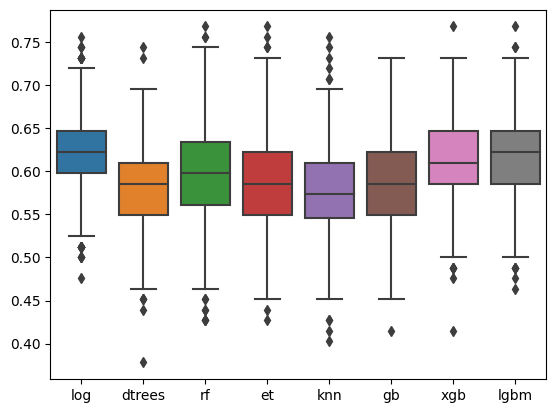

In [199]:
sns.boxplot(acc)

<Axes: >

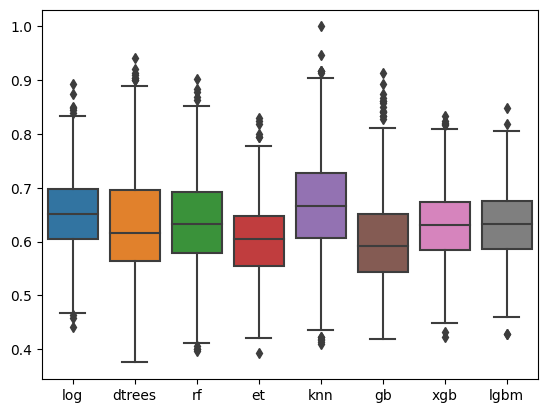

In [200]:
sns.boxplot(pre)

<Axes: >

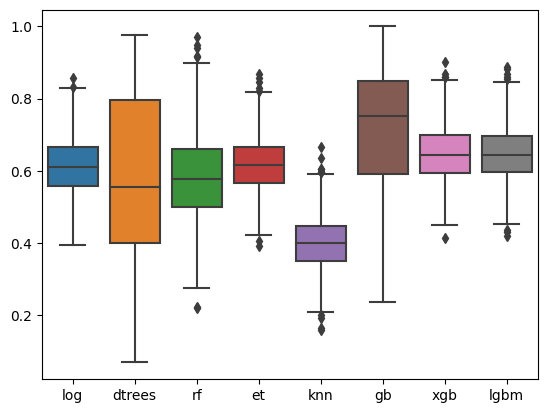

In [201]:
sns.boxplot(rec)

<Axes: >

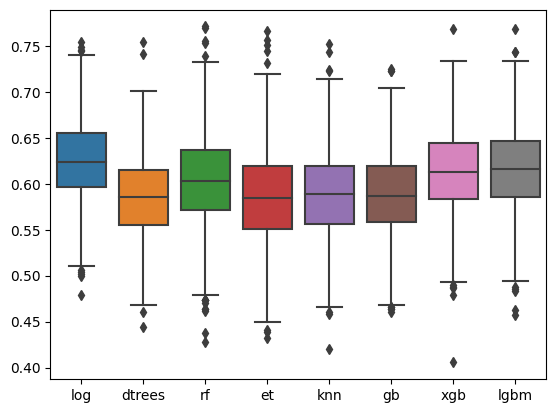

In [202]:
sns.boxplot(roc)

In [203]:
# Calculate The probability that at least one model is
# correct in predicting a company
probability = 1-(acc.describe().loc['mean'])
prob = 1
for i in probability:
  prob = prob * i
print('Probability of Accurate Recomandation Label 1:', 1-prob)

Probability of Accurate Recomandation Label 1: 0.9993012864354391


#### Predicting Companies

In [204]:
log = LogisticRegression()
xgb = XGBClassifier(objective="binary:logistic")
lgbm = LGBMClassifier()
rf = RandomForestClassifier(max_depth = 3, n_estimators=3)
dtrees = DecisionTreeClassifier(criterion='entropy', max_depth=3)
et = ExtraTreesClassifier(n_estimators=3)
gb = GradientBoostingClassifier(n_estimators=3)
knn = KNeighborsClassifier(n_neighbors=2)


modelList = [log,xgb,lgbm,rf,dtrees,et,gb,knn]
modelNames = ['log','xgb','lgbm','rf','dtrees','et','gb','knn']

In [205]:
# Fit with the whole current dataset and predict companies
recomend = pd.DataFrame()
for i in range(len(modelList)):
  modelList[i].fit(X,y)
  recomend[modelNames[i]]= list(modelList[i].predict(prospect))
recomend.index = prospect.index

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[LightGBM] [Info] Number of positive: 172, number of negative: 156
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000106 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 654
[LightGBM] [Info] Number of data points in the train set: 328, number of used features: 13
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

In [206]:
companies = recomend[(recomend.log==1)&(recomend.xgb==1) &(recomend.lgbm==1)&(recomend.rf==1)&(recomend.dtrees==1)&(recomend.et==1)& (recomend.gb==1) & (recomend.knn==1)].index
companies

Int64Index([  2441797, 155353090,  24904409,  10256729, 141738322,  19513364,
             18579882,  39600454, 345283492,  37934049,
            ...
             85902995,  33280815, 144441703,  89440993, 348226603,   9063981,
             13910366, 160923914, 150291170,  69747625],
           dtype='int64', name='CompanyID', length=504)

In [207]:
# CompanyIds of the recomended companies for label 1
allRecom = prospect.loc[recomend[(recomend.log==1)&(recomend.xgb==1) &(recomend.lgbm==1)&(recomend.rf==1)&(recomend.dtrees==1)&(recomend.et==1)& (recomend.gb==1) & (recomend.knn==1)]
.index]

<ipython-input-208-f43577c03701>:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(allRecom['revenue'])


<Axes: xlabel='revenue', ylabel='Density'>

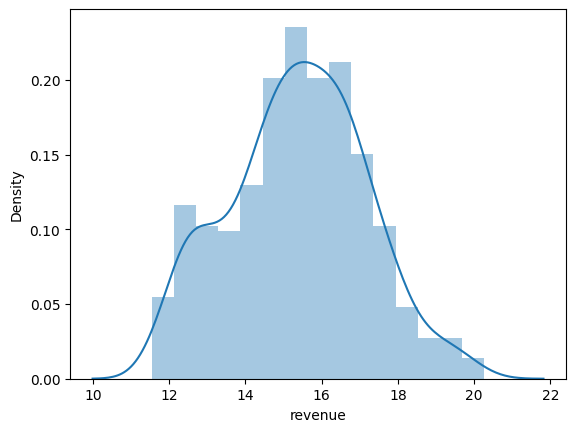

In [208]:
sns.distplot(allRecom['revenue'])

### Label *2*

In [209]:
# Divide total billling sum by the number of
# locations the company is being billed
current['label2']=current['lifetime_billing_sum']/current['count']
median = current['label2'].median()

current['label2'].describe()

for i in range(len(current)):
  if current['label2'].iloc[i]<median:
    current['label2'].iloc[i] = 0
  else:
    current['label2'].iloc[i]=1
current['label2'].value_counts()

<ipython-input-209-7253220d9598>:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  current['label2'].iloc[i]=1
<ipython-input-209-7253220d9598>:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  current['label2'].iloc[i] = 0


1.0    164
0.0    164
Name: label2, dtype: int64

In [210]:
# Splits the data by features and labels
X = current.loc[:,:'it_budget']
y = current['label2']

#### Tuning

100%|██████████| 19/19 [00:00<00:00, 50.89it/s]


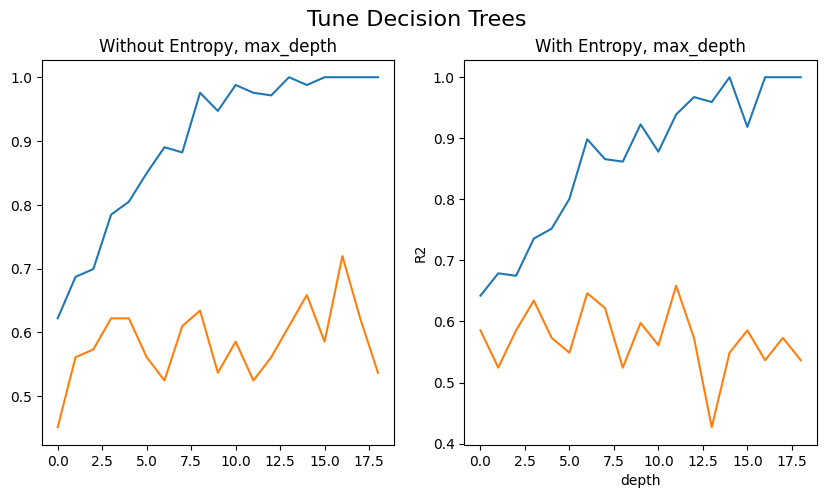

In [211]:
tune_dec_trees(X,y,cols)

100%|██████████| 19/19 [00:04<00:00,  4.59it/s]


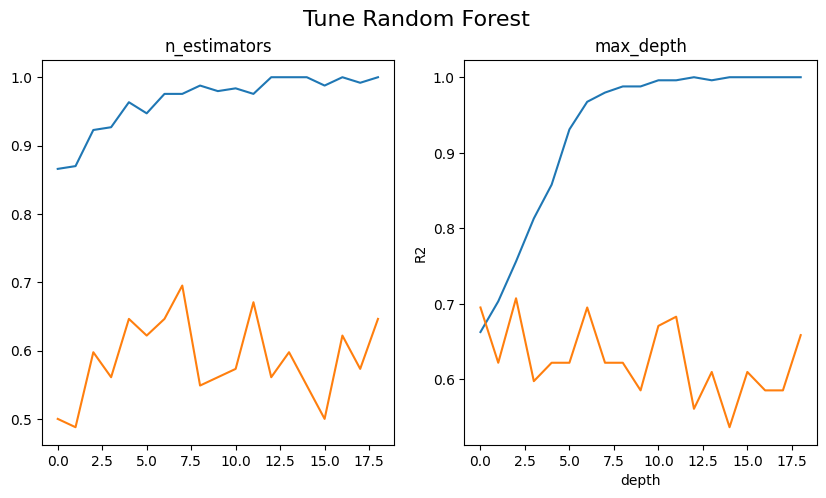

In [212]:
tune_rf(X,y,cols)

100%|██████████| 24/24 [00:00<00:00, 35.53it/s]


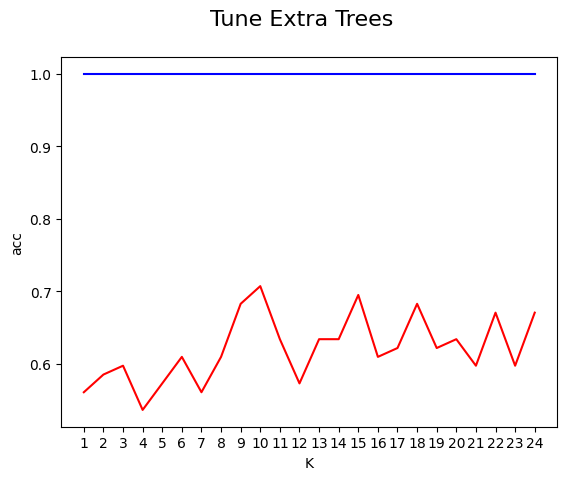

In [213]:
tune_et(X,y,cols)

100%|██████████| 19/19 [00:00<00:00, 30.94it/s]


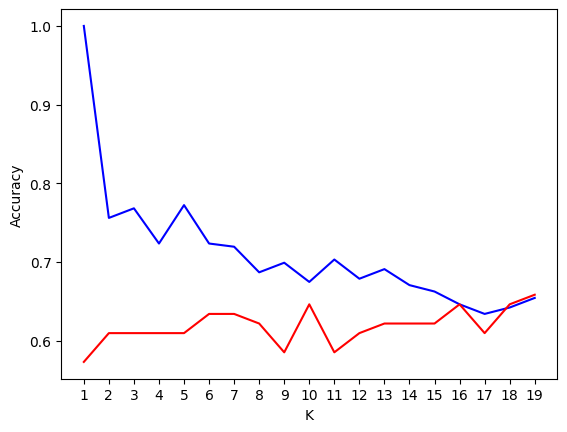

In [214]:
tune_knn(X,y,cols)

100%|██████████| 19/19 [00:00<00:00, 44.79it/s]


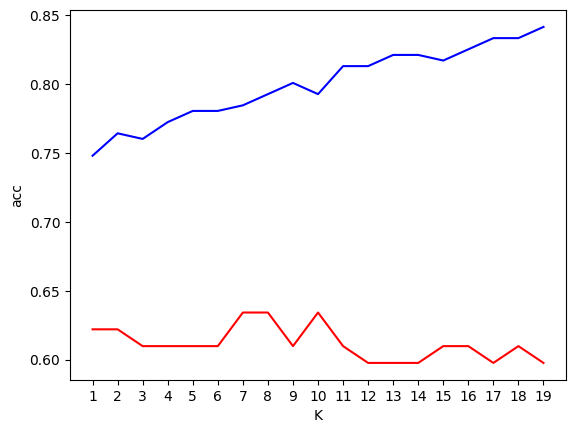

In [215]:
tune_gb(X,y,cols)

#### Fitting Model

In [216]:
# 1000 iterations to get models' metrics
log = LogisticRegression()
xgb = XGBClassifier(objective="binary:logistic")
lgbm = LGBMClassifier()
rf = RandomForestClassifier(max_depth = 2, n_estimators=2)
dtrees = DecisionTreeClassifier(criterion='entropy', max_depth=2)
et = ExtraTreesClassifier(n_estimators=2)
gb = GradientBoostingClassifier(n_estimators=3)
knn = KNeighborsClassifier(n_neighbors=2)


modelList = [log,xgb,lgbm,rf,dtrees,et,gb,knn]
modelNames = ['log','xgb','lgbm','rf','dtrees','et','gb','knn']

##### Label 2 Metrics

In [217]:

accNewLabel, newPre, newRec, newRoc = MultipleRuns(modelList,X,y, cols)
accNewLabel.columns = modelNames
newPre.columns = modelNames
newRec.columns = modelNames
newRoc.columns = modelNames

  0%|          | 1/1000 [00:00<04:50,  3.44it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000080 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

  0%|          | 3/1000 [00:01<06:09,  2.70it/s]

[LightGBM] [Info] Number of positive: 118, number of negative: 128
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000101 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 496
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.479675 -> initscore=-0.081346
[LightGBM] [Info] Start training from score -0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

  0%|          | 4/1000 [00:01<08:44,  1.90it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000082 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

  0%|          | 5/1000 [00:02<08:46,  1.89it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

  1%|          | 7/1000 [00:03<09:43,  1.70it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  1%|          | 8/1000 [00:03<07:58,  2.07it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  1%|          | 9/1000 [00:04<06:49,  2.42it/s]

[LightGBM] [Info] Number of positive: 117, number of negative: 129
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.475610 -> initscore=-0.097638
[LightGBM] [Info] Start training from score -0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

  1%|          | 10/1000 [00:04<06:10,  2.67it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  1%|          | 11/1000 [00:04<05:37,  2.93it/s]

[LightGBM] [Info] Number of positive: 116, number of negative: 130
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000060 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.471545 -> initscore=-0.113944
[LightGBM] [Info] Start training from score -0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

  1%|          | 12/1000 [00:05<05:10,  3.18it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

  1%|▏         | 13/1000 [00:05<04:56,  3.33it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

  1%|▏         | 14/1000 [00:05<04:50,  3.39it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000038 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  2%|▏         | 15/1000 [00:05<04:48,  3.41it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

  2%|▏         | 16/1000 [00:06<04:41,  3.49it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000060 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  2%|▏         | 17/1000 [00:06<04:43,  3.46it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000080 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

  2%|▏         | 18/1000 [00:06<04:36,  3.56it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  2%|▏         | 19/1000 [00:06<04:30,  3.63it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000083 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

  2%|▏         | 20/1000 [00:07<04:25,  3.69it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  2%|▏         | 21/1000 [00:07<04:33,  3.59it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  2%|▏         | 22/1000 [00:07<04:34,  3.56it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000082 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 499
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

  2%|▏         | 23/1000 [00:08<04:36,  3.53it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  2%|▏         | 24/1000 [00:08<04:36,  3.53it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

  2%|▎         | 25/1000 [00:08<04:37,  3.51it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000060 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

  3%|▎         | 26/1000 [00:08<04:36,  3.52it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000080 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with

  3%|▎         | 27/1000 [00:09<04:33,  3.55it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 514
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

  3%|▎         | 28/1000 [00:09<04:37,  3.50it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000147 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

  3%|▎         | 29/1000 [00:09<04:36,  3.51it/s]

[LightGBM] [Info] Number of positive: 118, number of negative: 128
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.479675 -> initscore=-0.081346
[LightGBM] [Info] Start training from score -0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

  3%|▎         | 30/1000 [00:10<04:33,  3.55it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 496
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

  3%|▎         | 31/1000 [00:10<04:28,  3.61it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  3%|▎         | 32/1000 [00:10<04:37,  3.49it/s]

[LightGBM] [Info] Number of positive: 118, number of negative: 128
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000058 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 500
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.479675 -> initscore=-0.081346
[LightGBM] [Info] Start training from score -0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

  3%|▎         | 33/1000 [00:10<04:37,  3.49it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000078 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

  3%|▎         | 34/1000 [00:11<04:28,  3.60it/s]

[LightGBM] [Info] Number of positive: 118, number of negative: 128
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000107 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.479675 -> initscore=-0.081346
[LightGBM] [Info] Start training from score -0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

  4%|▎         | 35/1000 [00:11<04:28,  3.60it/s]

[LightGBM] [Info] Number of positive: 117, number of negative: 129
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000079 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.475610 -> initscore=-0.097638
[LightGBM] [Info] Start training from score -0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

  4%|▎         | 36/1000 [00:11<04:32,  3.54it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000102 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

  4%|▎         | 37/1000 [00:12<04:32,  3.53it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  4%|▍         | 38/1000 [00:12<04:33,  3.52it/s]

[LightGBM] [Info] Number of positive: 118, number of negative: 128
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000041 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.479675 -> initscore=-0.081346
[LightGBM] [Info] Start training from score -0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

  4%|▍         | 39/1000 [00:12<04:30,  3.56it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

  4%|▍         | 40/1000 [00:12<04:28,  3.57it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000079 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with

  4%|▍         | 41/1000 [00:13<04:25,  3.61it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

  4%|▍         | 42/1000 [00:13<04:26,  3.60it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 514
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  4%|▍         | 43/1000 [00:13<04:40,  3.41it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  4%|▍         | 44/1000 [00:14<05:21,  2.97it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  4%|▍         | 45/1000 [00:14<06:48,  2.34it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  5%|▍         | 46/1000 [00:16<11:01,  1.44it/s]

[LightGBM] [Info] Number of positive: 115, number of negative: 131
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.467480 -> initscore=-0.130265
[LightGBM] [Info] Start training from score -0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

  5%|▍         | 47/1000 [00:16<10:21,  1.53it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  5%|▍         | 48/1000 [00:16<08:28,  1.87it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000081 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

  5%|▍         | 49/1000 [00:17<07:11,  2.20it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

  5%|▌         | 50/1000 [00:17<06:23,  2.48it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000079 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

  5%|▌         | 51/1000 [00:17<05:50,  2.71it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

  5%|▌         | 52/1000 [00:18<05:24,  2.93it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

  5%|▌         | 53/1000 [00:18<05:03,  3.12it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000060 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  5%|▌         | 54/1000 [00:18<04:49,  3.27it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

  6%|▌         | 55/1000 [00:18<04:46,  3.30it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000060 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  6%|▌         | 56/1000 [00:19<04:37,  3.40it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  6%|▌         | 57/1000 [00:19<04:32,  3.47it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

  6%|▌         | 58/1000 [00:19<04:36,  3.41it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 500
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

  6%|▌         | 59/1000 [00:20<04:31,  3.46it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000100 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with

  6%|▌         | 60/1000 [00:20<04:29,  3.49it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000083 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

  6%|▌         | 61/1000 [00:20<04:26,  3.52it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  6%|▌         | 62/1000 [00:20<04:25,  3.54it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000029 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  6%|▋         | 63/1000 [00:21<04:25,  3.53it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000082 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 518
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

  6%|▋         | 64/1000 [00:21<04:26,  3.52it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000077 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

  6%|▋         | 65/1000 [00:21<04:25,  3.52it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  7%|▋         | 66/1000 [00:22<04:28,  3.47it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 514
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  7%|▋         | 67/1000 [00:22<04:25,  3.52it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000082 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  7%|▋         | 68/1000 [00:22<04:23,  3.54it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  7%|▋         | 69/1000 [00:22<04:23,  3.53it/s]

[LightGBM] [Info] Number of positive: 116, number of negative: 130
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000091 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.471545 -> initscore=-0.113944
[LightGBM] [Info] Start training from score -0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

  7%|▋         | 70/1000 [00:23<04:24,  3.52it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

  7%|▋         | 71/1000 [00:23<04:33,  3.39it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000092 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

  7%|▋         | 72/1000 [00:23<04:28,  3.46it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000060 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

  7%|▋         | 73/1000 [00:24<04:34,  3.37it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

  7%|▋         | 74/1000 [00:24<04:31,  3.41it/s]

[LightGBM] [Info] Number of positive: 118, number of negative: 128
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.479675 -> initscore=-0.081346
[LightGBM] [Info] Start training from score -0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

  8%|▊         | 75/1000 [00:24<04:33,  3.38it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  8%|▊         | 76/1000 [00:24<04:39,  3.30it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

  8%|▊         | 77/1000 [00:25<04:30,  3.41it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000079 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

  8%|▊         | 78/1000 [00:25<04:24,  3.49it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  8%|▊         | 79/1000 [00:25<04:21,  3.53it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 497
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

  8%|▊         | 80/1000 [00:26<04:24,  3.48it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  8%|▊         | 81/1000 [00:26<04:19,  3.54it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000059 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  8%|▊         | 82/1000 [00:26<04:21,  3.51it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000059 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  8%|▊         | 84/1000 [00:27<07:07,  2.14it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000093 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

  8%|▊         | 85/1000 [00:28<06:52,  2.22it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

  9%|▊         | 86/1000 [00:28<07:30,  2.03it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

  9%|▊         | 87/1000 [00:29<08:04,  1.88it/s]

[LightGBM] [Info] Number of positive: 136, number of negative: 110
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.552846 -> initscore=0.212175
[LightGBM] [Info] Start training from score 0.212175
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

  9%|▉         | 88/1000 [00:29<07:39,  1.99it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000078 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

  9%|▉         | 90/1000 [00:31<07:53,  1.92it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 500
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

  9%|▉         | 91/1000 [00:31<07:25,  2.04it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

  9%|▉         | 92/1000 [00:32<10:25,  1.45it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

  9%|▉         | 93/1000 [00:33<09:25,  1.60it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

  9%|▉         | 94/1000 [00:34<11:38,  1.30it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000084 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 10%|▉         | 95/1000 [00:34<10:21,  1.46it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 10%|▉         | 96/1000 [00:34<08:30,  1.77it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 10%|▉         | 97/1000 [00:35<07:17,  2.06it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000060 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 10%|▉         | 98/1000 [00:35<06:26,  2.33it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 10%|▉         | 99/1000 [00:35<05:48,  2.59it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000078 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 518
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 10%|█         | 100/1000 [00:36<05:25,  2.77it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 10%|█         | 101/1000 [00:36<05:10,  2.90it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 10%|█         | 102/1000 [00:36<04:51,  3.08it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 13
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 10%|█         | 103/1000 [00:37<04:42,  3.17it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 500
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 10%|█         | 104/1000 [00:37<04:32,  3.29it/s]

[LightGBM] [Info] Number of positive: 114, number of negative: 132
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.463415 -> initscore=-0.146603
[LightGBM] [Info] Start training from score -0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 10%|█         | 105/1000 [00:37<04:29,  3.33it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 11%|█         | 106/1000 [00:37<04:27,  3.35it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 11%|█         | 107/1000 [00:38<04:23,  3.39it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 11%|█         | 108/1000 [00:38<04:33,  3.26it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 11%|█         | 109/1000 [00:38<04:26,  3.35it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000083 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 11%|█         | 110/1000 [00:39<04:21,  3.41it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 11%|█         | 111/1000 [00:39<04:19,  3.42it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000083 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 11%|█         | 112/1000 [00:39<04:24,  3.36it/s]

[LightGBM] [Info] Number of positive: 118, number of negative: 128
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.479675 -> initscore=-0.081346
[LightGBM] [Info] Start training from score -0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 11%|█▏        | 113/1000 [00:39<04:24,  3.36it/s]

[LightGBM] [Info] Number of positive: 118, number of negative: 128
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 497
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.479675 -> initscore=-0.081346
[LightGBM] [Info] Start training from score -0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 11%|█▏        | 114/1000 [00:40<04:24,  3.35it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000100 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 12%|█▏        | 115/1000 [00:40<04:58,  2.96it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000099 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 12%|█▏        | 116/1000 [00:41<05:39,  2.60it/s]

[LightGBM] [Info] Number of positive: 118, number of negative: 128
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.479675 -> initscore=-0.081346
[LightGBM] [Info] Start training from score -0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 12%|█▏        | 118/1000 [00:42<07:20,  2.00it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 12%|█▏        | 119/1000 [00:42<07:32,  1.95it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 12%|█▏        | 120/1000 [00:43<07:11,  2.04it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000087 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 12%|█▏        | 121/1000 [00:43<07:24,  1.98it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000079 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 514
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 12%|█▏        | 122/1000 [00:44<06:57,  2.10it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 514
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 12%|█▏        | 123/1000 [00:44<06:06,  2.39it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 12%|█▏        | 124/1000 [00:44<05:38,  2.58it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000060 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 514
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 12%|█▎        | 125/1000 [00:45<05:12,  2.80it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000083 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with

 13%|█▎        | 126/1000 [00:45<04:54,  2.96it/s]

[LightGBM] [Info] Number of positive: 116, number of negative: 130
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.471545 -> initscore=-0.113944
[LightGBM] [Info] Start training from score -0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 13%|█▎        | 127/1000 [00:45<04:46,  3.05it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 13%|█▎        | 128/1000 [00:46<04:36,  3.15it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 13
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 13%|█▎        | 129/1000 [00:46<04:32,  3.20it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 13%|█▎        | 130/1000 [00:46<04:32,  3.19it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000080 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 13%|█▎        | 131/1000 [00:47<04:36,  3.15it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 13%|█▎        | 132/1000 [00:47<04:32,  3.18it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 13%|█▎        | 133/1000 [00:47<04:21,  3.31it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000089 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 13%|█▎        | 134/1000 [00:47<04:26,  3.25it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 14%|█▎        | 135/1000 [00:48<04:21,  3.31it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 14%|█▎        | 136/1000 [00:48<04:20,  3.32it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 14%|█▎        | 137/1000 [00:48<04:23,  3.27it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000083 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 14%|█▍        | 138/1000 [00:49<04:21,  3.30it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000080 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 14%|█▍        | 139/1000 [00:49<04:20,  3.30it/s]

[LightGBM] [Info] Number of positive: 117, number of negative: 129
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.475610 -> initscore=-0.097638
[LightGBM] [Info] Start training from score -0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 14%|█▍        | 140/1000 [00:49<04:18,  3.33it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000077 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 500
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 13
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 14%|█▍        | 141/1000 [00:50<04:19,  3.31it/s]

[LightGBM] [Info] Number of positive: 116, number of negative: 130
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000086 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 498
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.471545 -> initscore=-0.113944
[LightGBM] [Info] Start training from score -0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 14%|█▍        | 142/1000 [00:50<04:21,  3.28it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 14%|█▍        | 143/1000 [00:50<04:20,  3.29it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 14%|█▍        | 144/1000 [00:50<04:21,  3.27it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with

 14%|█▍        | 145/1000 [00:51<04:19,  3.30it/s]

[LightGBM] [Info] Number of positive: 118, number of negative: 128
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000079 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.479675 -> initscore=-0.081346
[LightGBM] [Info] Start training from score -0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 15%|█▍        | 146/1000 [00:51<04:13,  3.37it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 15%|█▍        | 147/1000 [00:51<04:15,  3.34it/s]

[LightGBM] [Info] Number of positive: 115, number of negative: 131
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000086 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.467480 -> initscore=-0.130265
[LightGBM] [Info] Start training from score -0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 15%|█▍        | 148/1000 [00:52<04:23,  3.24it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 15%|█▍        | 149/1000 [00:52<04:19,  3.28it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 15%|█▌        | 150/1000 [00:52<04:16,  3.31it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 15%|█▌        | 151/1000 [00:53<04:18,  3.29it/s]

[LightGBM] [Info] Number of positive: 116, number of negative: 130
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.471545 -> initscore=-0.113944
[LightGBM] [Info] Start training from score -0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 15%|█▌        | 152/1000 [00:53<04:26,  3.18it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000081 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 15%|█▌        | 153/1000 [00:53<04:18,  3.28it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000060 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 15%|█▌        | 154/1000 [00:54<04:17,  3.29it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 16%|█▌        | 155/1000 [00:54<04:44,  2.96it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000111 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 16%|█▌        | 157/1000 [00:55<07:54,  1.78it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000079 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 16%|█▌        | 158/1000 [00:56<07:27,  1.88it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000084 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 16%|█▌        | 159/1000 [00:56<07:12,  1.94it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 16%|█▌        | 160/1000 [00:57<06:50,  2.05it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 16%|█▌        | 161/1000 [00:57<06:48,  2.05it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 16%|█▌        | 162/1000 [00:58<05:56,  2.35it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 16%|█▋        | 163/1000 [00:58<05:23,  2.58it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 16%|█▋        | 164/1000 [00:58<04:59,  2.79it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 16%|█▋        | 165/1000 [00:58<04:45,  2.93it/s]

[LightGBM] [Info] Number of positive: 117, number of negative: 129
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 13
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.475610 -> initscore=-0.097638
[LightGBM] [Info] Start training from score -0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 17%|█▋        | 166/1000 [00:59<04:32,  3.06it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000060 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 17%|█▋        | 167/1000 [00:59<04:32,  3.06it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 519
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 17%|█▋        | 168/1000 [00:59<04:27,  3.12it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 500
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 17%|█▋        | 169/1000 [01:00<04:19,  3.20it/s]

[LightGBM] [Info] Number of positive: 118, number of negative: 128
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.479675 -> initscore=-0.081346
[LightGBM] [Info] Start training from score -0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 17%|█▋        | 170/1000 [01:00<04:16,  3.23it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000085 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with

 17%|█▋        | 171/1000 [01:00<04:13,  3.26it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 17%|█▋        | 172/1000 [01:01<04:11,  3.29it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 17%|█▋        | 173/1000 [01:01<04:14,  3.25it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000096 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 17%|█▋        | 174/1000 [01:01<04:11,  3.28it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 18%|█▊        | 175/1000 [01:01<04:12,  3.27it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 18%|█▊        | 176/1000 [01:02<04:11,  3.27it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 18%|█▊        | 177/1000 [01:02<04:15,  3.22it/s]

[LightGBM] [Info] Number of positive: 116, number of negative: 130
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.471545 -> initscore=-0.113944
[LightGBM] [Info] Start training from score -0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 18%|█▊        | 178/1000 [01:02<04:12,  3.26it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000090 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 18%|█▊        | 179/1000 [01:03<04:10,  3.28it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000093 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 18%|█▊        | 180/1000 [01:03<04:13,  3.23it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 18%|█▊        | 181/1000 [01:03<04:14,  3.22it/s]

[LightGBM] [Info] Number of positive: 118, number of negative: 128
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.479675 -> initscore=-0.081346
[LightGBM] [Info] Start training from score -0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 18%|█▊        | 182/1000 [01:04<04:12,  3.24it/s]

[LightGBM] [Info] Number of positive: 118, number of negative: 128
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.479675 -> initscore=-0.081346
[LightGBM] [Info] Start training from score -0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 18%|█▊        | 183/1000 [01:04<04:08,  3.28it/s]

[LightGBM] [Info] Number of positive: 118, number of negative: 128
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000081 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.479675 -> initscore=-0.081346
[LightGBM] [Info] Start training from score -0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 18%|█▊        | 184/1000 [01:04<04:12,  3.23it/s]

[LightGBM] [Info] Number of positive: 113, number of negative: 133
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000084 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.459350 -> initscore=-0.162961
[LightGBM] [Info] Start training from score -0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 18%|█▊        | 185/1000 [01:05<04:12,  3.23it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 19%|█▊        | 186/1000 [01:05<04:09,  3.26it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 19%|█▊        | 187/1000 [01:05<04:13,  3.21it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000039 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 19%|█▉        | 188/1000 [01:05<04:16,  3.17it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000078 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 519
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 19%|█▉        | 189/1000 [01:06<04:16,  3.16it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000098 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 19%|█▉        | 190/1000 [01:06<04:11,  3.22it/s]

[LightGBM] [Info] Number of positive: 118, number of negative: 128
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.479675 -> initscore=-0.081346
[LightGBM] [Info] Start training from score -0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 19%|█▉        | 191/1000 [01:06<04:09,  3.24it/s]

[LightGBM] [Info] Number of positive: 117, number of negative: 129
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000084 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.475610 -> initscore=-0.097638
[LightGBM] [Info] Start training from score -0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 19%|█▉        | 192/1000 [01:07<04:04,  3.30it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000078 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 19%|█▉        | 193/1000 [01:07<04:04,  3.30it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 19%|█▉        | 194/1000 [01:07<04:17,  3.13it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 514
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 20%|█▉        | 196/1000 [01:09<06:33,  2.05it/s]

[LightGBM] [Info] Number of positive: 116, number of negative: 130
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.471545 -> initscore=-0.113944
[LightGBM] [Info] Start training from score -0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 20%|█▉        | 198/1000 [01:10<06:38,  2.01it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000099 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 20%|█▉        | 199/1000 [01:10<06:36,  2.02it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 497
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 20%|██        | 201/1000 [01:11<06:15,  2.13it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 20%|██        | 202/1000 [01:11<05:32,  2.40it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000082 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 500
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 20%|██        | 203/1000 [01:12<05:04,  2.61it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000079 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 20%|██        | 204/1000 [01:12<04:43,  2.81it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 20%|██        | 205/1000 [01:12<04:35,  2.88it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000059 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 21%|██        | 206/1000 [01:13<04:28,  2.96it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 21%|██        | 207/1000 [01:13<04:18,  3.07it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 21%|██        | 208/1000 [01:13<04:12,  3.14it/s]

[LightGBM] [Info] Number of positive: 117, number of negative: 129
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.475610 -> initscore=-0.097638
[LightGBM] [Info] Start training from score -0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 21%|██        | 209/1000 [01:14<04:13,  3.12it/s]

[LightGBM] [Info] Number of positive: 114, number of negative: 132
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000101 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.463415 -> initscore=-0.146603
[LightGBM] [Info] Start training from score -0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 21%|██        | 210/1000 [01:14<04:07,  3.20it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 21%|██        | 211/1000 [01:14<04:06,  3.20it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 21%|██        | 212/1000 [01:14<04:09,  3.16it/s]

[LightGBM] [Info] Number of positive: 118, number of negative: 128
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 496
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.479675 -> initscore=-0.081346
[LightGBM] [Info] Start training from score -0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 21%|██▏       | 213/1000 [01:15<04:05,  3.21it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 21%|██▏       | 214/1000 [01:15<04:07,  3.18it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 22%|██▏       | 215/1000 [01:15<04:00,  3.26it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 22%|██▏       | 216/1000 [01:16<04:03,  3.22it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 22%|██▏       | 217/1000 [01:16<04:04,  3.20it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 22%|██▏       | 218/1000 [01:16<04:07,  3.16it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 22%|██▏       | 219/1000 [01:17<04:08,  3.15it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000084 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 22%|██▏       | 220/1000 [01:17<04:09,  3.13it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 22%|██▏       | 221/1000 [01:17<04:05,  3.18it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000052 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 22%|██▏       | 222/1000 [01:18<04:04,  3.18it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000078 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with

 22%|██▏       | 223/1000 [01:18<04:03,  3.19it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 514
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 22%|██▏       | 224/1000 [01:18<04:01,  3.21it/s]

[LightGBM] [Info] Number of positive: 115, number of negative: 131
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000093 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 498
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.467480 -> initscore=-0.130265
[LightGBM] [Info] Start training from score -0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 22%|██▎       | 225/1000 [01:18<03:58,  3.25it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 23%|██▎       | 226/1000 [01:19<04:00,  3.22it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000095 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 23%|██▎       | 227/1000 [01:19<04:03,  3.18it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 13
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 23%|██▎       | 228/1000 [01:19<04:03,  3.17it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000096 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 23%|██▎       | 229/1000 [01:20<04:06,  3.13it/s]

[LightGBM] [Info] Number of positive: 117, number of negative: 129
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.475610 -> initscore=-0.097638
[LightGBM] [Info] Start training from score -0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 23%|██▎       | 230/1000 [01:20<04:01,  3.18it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 23%|██▎       | 231/1000 [01:20<04:01,  3.19it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 23%|██▎       | 232/1000 [01:21<04:00,  3.19it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000084 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with

 23%|██▎       | 234/1000 [01:22<05:13,  2.44it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000078 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 519
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 24%|██▎       | 235/1000 [01:22<06:25,  1.99it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 24%|██▎       | 237/1000 [01:24<08:12,  1.55it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 24%|██▍       | 239/1000 [01:25<06:59,  1.82it/s]

[LightGBM] [Info] Number of positive: 117, number of negative: 129
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.475610 -> initscore=-0.097638
[LightGBM] [Info] Start training from score -0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 24%|██▍       | 240/1000 [01:25<06:02,  2.10it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000060 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 24%|██▍       | 241/1000 [01:25<05:23,  2.35it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 24%|██▍       | 242/1000 [01:26<04:58,  2.54it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 24%|██▍       | 243/1000 [01:26<04:49,  2.62it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 24%|██▍       | 244/1000 [01:26<04:30,  2.79it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 24%|██▍       | 245/1000 [01:27<04:22,  2.88it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000099 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 25%|██▍       | 246/1000 [01:27<04:16,  2.94it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 25%|██▍       | 247/1000 [01:27<04:10,  3.00it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 25%|██▍       | 248/1000 [01:28<04:07,  3.04it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 25%|██▍       | 249/1000 [01:28<04:04,  3.07it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000060 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 25%|██▌       | 250/1000 [01:28<04:05,  3.06it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 25%|██▌       | 251/1000 [01:29<04:01,  3.10it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 500
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 25%|██▌       | 252/1000 [01:29<04:01,  3.10it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 500
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 25%|██▌       | 253/1000 [01:29<04:03,  3.06it/s]

[LightGBM] [Info] Number of positive: 118, number of negative: 128
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.479675 -> initscore=-0.081346
[LightGBM] [Info] Start training from score -0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 25%|██▌       | 254/1000 [01:30<03:58,  3.12it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 26%|██▌       | 255/1000 [01:30<03:57,  3.14it/s]

[LightGBM] [Info] Number of positive: 113, number of negative: 133
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.459350 -> initscore=-0.162961
[LightGBM] [Info] Start training from score -0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 26%|██▌       | 256/1000 [01:30<04:05,  3.03it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000085 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 26%|██▌       | 257/1000 [01:31<04:07,  3.01it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000094 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 26%|██▌       | 258/1000 [01:31<04:07,  3.00it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000083 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 26%|██▌       | 259/1000 [01:31<04:14,  2.91it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000084 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 26%|██▌       | 260/1000 [01:32<04:09,  2.96it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 26%|██▌       | 261/1000 [01:32<04:05,  3.01it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 26%|██▌       | 262/1000 [01:32<04:05,  3.01it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 26%|██▋       | 263/1000 [01:33<03:59,  3.07it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000080 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 26%|██▋       | 264/1000 [01:33<03:59,  3.07it/s]

[LightGBM] [Info] Number of positive: 113, number of negative: 133
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.459350 -> initscore=-0.162961
[LightGBM] [Info] Start training from score -0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 26%|██▋       | 265/1000 [01:33<04:09,  2.94it/s]

[LightGBM] [Info] Number of positive: 118, number of negative: 128
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 491
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.479675 -> initscore=-0.081346
[LightGBM] [Info] Start training from score -0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 27%|██▋       | 266/1000 [01:34<04:01,  3.05it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000115 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 27%|██▋       | 267/1000 [01:34<03:52,  3.15it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000078 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 27%|██▋       | 268/1000 [01:34<03:55,  3.10it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 27%|██▋       | 269/1000 [01:35<03:54,  3.12it/s]

[LightGBM] [Info] Number of positive: 118, number of negative: 128
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000082 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.479675 -> initscore=-0.081346
[LightGBM] [Info] Start training from score -0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 27%|██▋       | 270/1000 [01:35<04:19,  2.81it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000077 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 27%|██▋       | 272/1000 [01:36<05:31,  2.20it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000097 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 13
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 27%|██▋       | 273/1000 [01:37<06:27,  1.88it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 522
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 27%|██▋       | 274/1000 [01:37<06:29,  1.86it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000085 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 28%|██▊       | 275/1000 [01:38<06:53,  1.75it/s]

[LightGBM] [Info] Number of positive: 113, number of negative: 133
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000090 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.459350 -> initscore=-0.162961
[LightGBM] [Info] Start training from score -0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 28%|██▊       | 277/1000 [01:39<06:05,  1.98it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000083 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 28%|██▊       | 278/1000 [01:39<05:26,  2.21it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 28%|██▊       | 279/1000 [01:40<05:00,  2.40it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 28%|██▊       | 280/1000 [01:40<04:43,  2.54it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000102 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 28%|██▊       | 281/1000 [01:40<04:29,  2.67it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000081 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 28%|██▊       | 282/1000 [01:41<04:19,  2.77it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 28%|██▊       | 283/1000 [01:41<04:14,  2.82it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000081 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 28%|██▊       | 284/1000 [01:41<04:09,  2.87it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000082 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 28%|██▊       | 285/1000 [01:42<04:07,  2.89it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000097 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 29%|██▊       | 286/1000 [01:42<03:59,  2.98it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 29%|██▊       | 287/1000 [01:42<03:53,  3.05it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000083 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 514
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 29%|██▉       | 288/1000 [01:43<05:18,  2.24it/s]

[LightGBM] [Info] Number of positive: 116, number of negative: 130
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000084 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.471545 -> initscore=-0.113944
[LightGBM] [Info] Start training from score -0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 29%|██▉       | 289/1000 [01:44<06:03,  1.96it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 518
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 29%|██▉       | 290/1000 [01:44<07:13,  1.64it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000080 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 29%|██▉       | 291/1000 [01:45<08:29,  1.39it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000096 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 29%|██▉       | 292/1000 [01:46<09:49,  1.20it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000080 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 29%|██▉       | 293/1000 [01:48<12:17,  1.04s/it]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 29%|██▉       | 294/1000 [01:49<10:55,  1.08it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000085 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 30%|██▉       | 295/1000 [01:52<18:29,  1.57s/it]

[LightGBM] [Info] Number of positive: 118, number of negative: 128
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000085 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 498
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.479675 -> initscore=-0.081346
[LightGBM] [Info] Start training from score -0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 30%|██▉       | 296/1000 [01:53<16:35,  1.41s/it]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 516
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 30%|██▉       | 297/1000 [01:54<15:31,  1.33s/it]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 30%|██▉       | 298/1000 [01:55<13:48,  1.18s/it]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000077 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 30%|██▉       | 299/1000 [01:55<11:50,  1.01s/it]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000105 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 30%|███       | 301/1000 [01:57<09:20,  1.25it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 30%|███       | 302/1000 [01:57<07:38,  1.52it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000097 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 30%|███       | 303/1000 [01:57<06:32,  1.78it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 30%|███       | 304/1000 [01:58<05:43,  2.03it/s]

[LightGBM] [Info] Number of positive: 116, number of negative: 130
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000086 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.471545 -> initscore=-0.113944
[LightGBM] [Info] Start training from score -0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 30%|███       | 305/1000 [01:58<05:06,  2.27it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 31%|███       | 306/1000 [01:58<04:44,  2.44it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000060 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 31%|███       | 307/1000 [01:59<04:27,  2.59it/s]

[LightGBM] [Info] Number of positive: 110, number of negative: 136
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000093 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 497
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.447154 -> initscore=-0.212175
[LightGBM] [Info] Start training from score -0.212175
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 31%|███       | 308/1000 [01:59<04:12,  2.74it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 31%|███       | 309/1000 [01:59<04:01,  2.86it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 31%|███       | 310/1000 [01:59<04:04,  2.82it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000060 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 31%|███       | 311/1000 [02:00<03:57,  2.90it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000085 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 31%|███       | 312/1000 [02:00<03:53,  2.94it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 31%|███▏      | 313/1000 [02:00<03:54,  2.94it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 31%|███▏      | 314/1000 [02:01<03:51,  2.96it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000077 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 498
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 32%|███▏      | 315/1000 [02:01<03:49,  2.99it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 32%|███▏      | 316/1000 [02:01<03:50,  2.97it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 32%|███▏      | 317/1000 [02:02<03:47,  3.01it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000059 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 32%|███▏      | 318/1000 [02:02<03:46,  3.01it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000060 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 514
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 32%|███▏      | 319/1000 [02:03<04:22,  2.60it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000084 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 32%|███▏      | 321/1000 [02:04<05:39,  2.00it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 32%|███▏      | 322/1000 [02:05<06:20,  1.78it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 518
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 32%|███▏      | 323/1000 [02:05<06:49,  1.65it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 32%|███▎      | 325/1000 [02:06<05:41,  1.98it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 33%|███▎      | 326/1000 [02:07<05:03,  2.22it/s]

[LightGBM] [Info] Number of positive: 117, number of negative: 129
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.475610 -> initscore=-0.097638
[LightGBM] [Info] Start training from score -0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 33%|███▎      | 327/1000 [02:07<04:43,  2.38it/s]

[LightGBM] [Info] Number of positive: 116, number of negative: 130
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.471545 -> initscore=-0.113944
[LightGBM] [Info] Start training from score -0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 33%|███▎      | 328/1000 [02:07<04:24,  2.54it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000082 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 33%|███▎      | 329/1000 [02:08<04:15,  2.63it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 33%|███▎      | 330/1000 [02:08<04:12,  2.66it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 497
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 33%|███▎      | 331/1000 [02:08<04:02,  2.75it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 33%|███▎      | 332/1000 [02:09<03:53,  2.86it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000116 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 500
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 33%|███▎      | 333/1000 [02:09<03:57,  2.80it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000078 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 33%|███▎      | 334/1000 [02:09<03:54,  2.84it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 516
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 34%|███▎      | 335/1000 [02:10<03:48,  2.91it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 34%|███▎      | 336/1000 [02:10<03:48,  2.90it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 497
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 34%|███▎      | 337/1000 [02:10<03:45,  2.93it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 34%|███▍      | 338/1000 [02:11<03:44,  2.95it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000081 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 500
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 34%|███▍      | 339/1000 [02:11<03:46,  2.92it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 34%|███▍      | 340/1000 [02:11<03:43,  2.96it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000059 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 514
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 34%|███▍      | 341/1000 [02:12<03:38,  3.01it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 34%|███▍      | 342/1000 [02:12<03:44,  2.93it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000042 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 493
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 34%|███▍      | 343/1000 [02:12<03:42,  2.95it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 498
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 34%|███▍      | 344/1000 [02:13<03:38,  3.01it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 34%|███▍      | 345/1000 [02:13<03:43,  2.94it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 35%|███▍      | 346/1000 [02:13<03:41,  2.95it/s]

[LightGBM] [Info] Number of positive: 117, number of negative: 129
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.475610 -> initscore=-0.097638
[LightGBM] [Info] Start training from score -0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 35%|███▍      | 347/1000 [02:14<03:39,  2.98it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 35%|███▍      | 348/1000 [02:14<03:42,  2.94it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 35%|███▍      | 349/1000 [02:14<03:40,  2.95it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 35%|███▌      | 350/1000 [02:15<03:40,  2.95it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000060 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 35%|███▌      | 351/1000 [02:15<03:42,  2.92it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 35%|███▌      | 352/1000 [02:15<03:38,  2.96it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 35%|███▌      | 353/1000 [02:16<03:38,  2.96it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 36%|███▌      | 355/1000 [02:17<04:41,  2.29it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000085 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with

 36%|███▌      | 356/1000 [02:17<04:49,  2.23it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000095 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 516
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 36%|███▌      | 358/1000 [02:19<07:14,  1.48it/s]

[LightGBM] [Info] Number of positive: 118, number of negative: 128
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.479675 -> initscore=-0.081346
[LightGBM] [Info] Start training from score -0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 36%|███▌      | 359/1000 [02:20<06:49,  1.57it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 516
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 36%|███▌      | 360/1000 [02:20<05:46,  1.85it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 36%|███▌      | 361/1000 [02:20<05:08,  2.07it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 36%|███▌      | 362/1000 [02:21<04:42,  2.26it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000058 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 36%|███▋      | 363/1000 [02:21<04:20,  2.45it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 36%|███▋      | 364/1000 [02:21<04:07,  2.57it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000060 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 36%|███▋      | 365/1000 [02:22<03:58,  2.66it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000121 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 37%|███▋      | 366/1000 [02:22<03:48,  2.78it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 37%|███▋      | 367/1000 [02:22<03:46,  2.80it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000080 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 37%|███▋      | 368/1000 [02:23<03:39,  2.87it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 37%|███▋      | 369/1000 [02:23<03:39,  2.88it/s]

[LightGBM] [Info] Number of positive: 117, number of negative: 129
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.475610 -> initscore=-0.097638
[LightGBM] [Info] Start training from score -0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 37%|███▋      | 370/1000 [02:23<03:36,  2.91it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 37%|███▋      | 371/1000 [02:24<03:35,  2.92it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 37%|███▋      | 372/1000 [02:24<03:31,  2.96it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 37%|███▋      | 373/1000 [02:24<03:31,  2.96it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 37%|███▋      | 374/1000 [02:25<03:32,  2.94it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 38%|███▊      | 375/1000 [02:25<03:30,  2.97it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000031 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 38%|███▊      | 376/1000 [02:25<03:26,  3.02it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000079 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 38%|███▊      | 377/1000 [02:26<03:30,  2.96it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 38%|███▊      | 378/1000 [02:26<03:27,  3.00it/s]

[LightGBM] [Info] Number of positive: 117, number of negative: 129
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.475610 -> initscore=-0.097638
[LightGBM] [Info] Start training from score -0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 38%|███▊      | 379/1000 [02:26<03:29,  2.96it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000060 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 38%|███▊      | 380/1000 [02:27<03:31,  2.93it/s]

[LightGBM] [Info] Number of positive: 118, number of negative: 128
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 498
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.479675 -> initscore=-0.081346
[LightGBM] [Info] Start training from score -0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 38%|███▊      | 381/1000 [02:27<03:32,  2.91it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 38%|███▊      | 382/1000 [02:27<03:31,  2.92it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000082 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 38%|███▊      | 383/1000 [02:28<03:34,  2.88it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 38%|███▊      | 384/1000 [02:28<03:33,  2.88it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000077 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 38%|███▊      | 385/1000 [02:28<03:34,  2.87it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 39%|███▊      | 386/1000 [02:29<03:36,  2.83it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000078 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 39%|███▊      | 387/1000 [02:29<03:36,  2.83it/s]

[LightGBM] [Info] Number of positive: 133, number of negative: 113
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.540650 -> initscore=0.162961
[LightGBM] [Info] Start training from score 0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 39%|███▉      | 388/1000 [02:29<03:35,  2.84it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000081 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 39%|███▉      | 389/1000 [02:30<03:56,  2.58it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 39%|███▉      | 390/1000 [02:30<04:32,  2.24it/s]

[LightGBM] [Info] Number of positive: 118, number of negative: 128
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000079 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 13
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.479675 -> initscore=-0.081346
[LightGBM] [Info] Start training from score -0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 39%|███▉      | 391/1000 [02:31<04:36,  2.20it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 39%|███▉      | 392/1000 [02:32<06:21,  1.60it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000093 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 39%|███▉      | 393/1000 [02:33<06:43,  1.50it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 517
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 39%|███▉      | 394/1000 [02:33<06:21,  1.59it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000084 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 40%|███▉      | 395/1000 [02:34<05:30,  1.83it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 40%|███▉      | 396/1000 [02:34<04:57,  2.03it/s]

[LightGBM] [Info] Number of positive: 112, number of negative: 134
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000101 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.455285 -> initscore=-0.179341
[LightGBM] [Info] Start training from score -0.179341
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 40%|███▉      | 397/1000 [02:34<04:32,  2.21it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000104 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 40%|███▉      | 398/1000 [02:35<04:11,  2.40it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000060 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 40%|███▉      | 399/1000 [02:35<04:02,  2.48it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000087 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 40%|████      | 400/1000 [02:35<03:50,  2.60it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 40%|████      | 401/1000 [02:36<03:43,  2.68it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 517
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 40%|████      | 402/1000 [02:36<03:41,  2.70it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000092 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 40%|████      | 403/1000 [02:36<03:38,  2.74it/s]

[LightGBM] [Info] Number of positive: 117, number of negative: 129
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000105 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 514
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.475610 -> initscore=-0.097638
[LightGBM] [Info] Start training from score -0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 40%|████      | 404/1000 [02:37<03:32,  2.81it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 40%|████      | 405/1000 [02:37<03:32,  2.80it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 41%|████      | 406/1000 [02:37<03:30,  2.83it/s]

[LightGBM] [Info] Number of positive: 112, number of negative: 134
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 496
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.455285 -> initscore=-0.179341
[LightGBM] [Info] Start training from score -0.179341
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 41%|████      | 407/1000 [02:38<03:30,  2.82it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 500
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 41%|████      | 408/1000 [02:38<03:32,  2.79it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000087 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 41%|████      | 409/1000 [02:39<03:30,  2.81it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 41%|████      | 410/1000 [02:39<03:27,  2.85it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 41%|████      | 411/1000 [02:39<03:28,  2.83it/s]

[LightGBM] [Info] Number of positive: 113, number of negative: 133
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 494
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.459350 -> initscore=-0.162961
[LightGBM] [Info] Start training from score -0.162961
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 41%|████      | 412/1000 [02:40<03:28,  2.82it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 41%|████▏     | 413/1000 [02:40<03:25,  2.86it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 41%|████▏     | 414/1000 [02:40<03:28,  2.81it/s]

[LightGBM] [Info] Number of positive: 116, number of negative: 130
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.471545 -> initscore=-0.113944
[LightGBM] [Info] Start training from score -0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 42%|████▏     | 415/1000 [02:41<03:24,  2.86it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 42%|████▏     | 416/1000 [02:41<03:25,  2.84it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000081 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 42%|████▏     | 417/1000 [02:41<03:27,  2.81it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 42%|████▏     | 418/1000 [02:42<03:24,  2.85it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 42%|████▏     | 419/1000 [02:42<03:21,  2.89it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 514
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 42%|████▏     | 420/1000 [02:42<03:25,  2.83it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 42%|████▏     | 421/1000 [02:43<03:21,  2.87it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 42%|████▏     | 422/1000 [02:43<03:21,  2.87it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000098 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 42%|████▏     | 423/1000 [02:44<03:48,  2.53it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000109 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 516
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 42%|████▎     | 425/1000 [02:45<04:49,  1.99it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 43%|████▎     | 427/1000 [02:46<06:14,  1.53it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000077 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 517
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 43%|████▎     | 429/1000 [02:47<05:27,  1.75it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 491
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 43%|████▎     | 430/1000 [02:48<04:51,  1.96it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000113 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 499
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 43%|████▎     | 431/1000 [02:48<04:23,  2.16it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 43%|████▎     | 432/1000 [02:48<04:00,  2.36it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 43%|████▎     | 433/1000 [02:49<03:49,  2.47it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 43%|████▎     | 434/1000 [02:49<03:41,  2.56it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 497
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 44%|████▎     | 435/1000 [02:49<03:34,  2.63it/s]

[LightGBM] [Info] Number of positive: 134, number of negative: 112
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000084 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.544715 -> initscore=0.179341
[LightGBM] [Info] Start training from score 0.179341
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 44%|████▎     | 436/1000 [02:50<03:32,  2.65it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 44%|████▎     | 437/1000 [02:50<03:28,  2.70it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 44%|████▍     | 438/1000 [02:51<03:23,  2.77it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000091 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 44%|████▍     | 439/1000 [02:51<03:24,  2.74it/s]

[LightGBM] [Info] Number of positive: 118, number of negative: 128
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.479675 -> initscore=-0.081346
[LightGBM] [Info] Start training from score -0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 44%|████▍     | 440/1000 [02:51<03:19,  2.80it/s]

[LightGBM] [Info] Number of positive: 116, number of negative: 130
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 500
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.471545 -> initscore=-0.113944
[LightGBM] [Info] Start training from score -0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 44%|████▍     | 441/1000 [02:52<03:19,  2.80it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000081 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 44%|████▍     | 442/1000 [02:52<03:19,  2.79it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 499
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 44%|████▍     | 443/1000 [02:52<03:17,  2.82it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 44%|████▍     | 444/1000 [02:53<03:14,  2.85it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 44%|████▍     | 445/1000 [02:53<03:22,  2.74it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 45%|████▍     | 446/1000 [02:53<03:19,  2.78it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 499
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 45%|████▍     | 447/1000 [02:54<03:17,  2.79it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000079 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 45%|████▍     | 448/1000 [02:54<03:17,  2.79it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 45%|████▍     | 449/1000 [02:54<03:16,  2.80it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 45%|████▌     | 450/1000 [02:55<03:15,  2.81it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000085 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 45%|████▌     | 451/1000 [02:55<03:18,  2.76it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 45%|████▌     | 452/1000 [02:56<03:18,  2.76it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000080 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 45%|████▌     | 453/1000 [02:56<03:17,  2.77it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 45%|████▌     | 454/1000 [02:56<03:18,  2.75it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000094 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 46%|████▌     | 455/1000 [02:57<03:16,  2.77it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 514
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 46%|████▌     | 456/1000 [02:57<03:18,  2.74it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000085 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 46%|████▌     | 457/1000 [02:57<03:29,  2.59it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000376 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 46%|████▌     | 458/1000 [02:58<03:44,  2.42it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000093 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 46%|████▌     | 460/1000 [02:59<05:09,  1.75it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000079 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 496
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 46%|████▌     | 461/1000 [03:00<04:59,  1.80it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000082 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 46%|████▌     | 462/1000 [03:00<04:48,  1.86it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000091 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 46%|████▋     | 464/1000 [03:01<04:49,  1.85it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 46%|████▋     | 465/1000 [03:02<04:18,  2.07it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000060 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 47%|████▋     | 466/1000 [03:02<03:57,  2.24it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 47%|████▋     | 467/1000 [03:02<03:47,  2.35it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 497
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 47%|████▋     | 468/1000 [03:03<03:36,  2.46it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 518
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 47%|████▋     | 469/1000 [03:03<03:28,  2.54it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 47%|████▋     | 470/1000 [03:04<03:32,  2.50it/s]

[LightGBM] [Info] Number of positive: 118, number of negative: 128
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000081 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.479675 -> initscore=-0.081346
[LightGBM] [Info] Start training from score -0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 47%|████▋     | 471/1000 [03:04<03:27,  2.55it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 47%|████▋     | 472/1000 [03:04<03:24,  2.58it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 47%|████▋     | 473/1000 [03:05<03:20,  2.62it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 47%|████▋     | 474/1000 [03:05<03:16,  2.67it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 48%|████▊     | 475/1000 [03:05<03:17,  2.66it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000077 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 48%|████▊     | 476/1000 [03:06<03:17,  2.65it/s]

[LightGBM] [Info] Number of positive: 118, number of negative: 128
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.479675 -> initscore=-0.081346
[LightGBM] [Info] Start training from score -0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 48%|████▊     | 477/1000 [03:06<03:13,  2.70it/s]

[LightGBM] [Info] Number of positive: 118, number of negative: 128
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 497
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.479675 -> initscore=-0.081346
[LightGBM] [Info] Start training from score -0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 48%|████▊     | 478/1000 [03:07<03:15,  2.67it/s]

[LightGBM] [Info] Number of positive: 117, number of negative: 129
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.475610 -> initscore=-0.097638
[LightGBM] [Info] Start training from score -0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 48%|████▊     | 479/1000 [03:07<03:15,  2.67it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 48%|████▊     | 480/1000 [03:07<03:12,  2.71it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 48%|████▊     | 481/1000 [03:08<03:15,  2.65it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 48%|████▊     | 482/1000 [03:08<03:18,  2.61it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000080 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 48%|████▊     | 483/1000 [03:08<03:18,  2.61it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 48%|████▊     | 484/1000 [03:09<03:15,  2.63it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with

 48%|████▊     | 485/1000 [03:09<03:16,  2.63it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 49%|████▊     | 486/1000 [03:10<03:15,  2.63it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 494
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 49%|████▊     | 487/1000 [03:10<03:13,  2.65it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 49%|████▉     | 488/1000 [03:10<03:13,  2.64it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 49%|████▉     | 489/1000 [03:11<03:16,  2.61it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 49%|████▉     | 490/1000 [03:11<03:15,  2.61it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000085 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 49%|████▉     | 492/1000 [03:13<04:49,  1.76it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000095 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 49%|████▉     | 493/1000 [03:13<05:14,  1.61it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000081 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 49%|████▉     | 494/1000 [03:14<04:53,  1.72it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000087 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 514
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with

 50%|████▉     | 495/1000 [03:14<04:46,  1.76it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000111 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 520
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 50%|████▉     | 497/1000 [03:15<04:17,  1.95it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000092 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 50%|████▉     | 498/1000 [03:16<04:21,  1.92it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000083 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 50%|████▉     | 499/1000 [03:16<03:57,  2.11it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000082 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 50%|█████     | 500/1000 [03:17<03:39,  2.27it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 50%|█████     | 501/1000 [03:17<03:30,  2.37it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000101 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 50%|█████     | 502/1000 [03:17<03:21,  2.47it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 50%|█████     | 503/1000 [03:18<03:14,  2.56it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 50%|█████     | 504/1000 [03:18<03:13,  2.56it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 50%|█████     | 505/1000 [03:18<03:10,  2.60it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 51%|█████     | 506/1000 [03:19<03:06,  2.64it/s]

[LightGBM] [Info] Number of positive: 118, number of negative: 128
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.479675 -> initscore=-0.081346
[LightGBM] [Info] Start training from score -0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 51%|█████     | 507/1000 [03:19<03:07,  2.63it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 516
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 51%|█████     | 508/1000 [03:19<03:03,  2.68it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 51%|█████     | 509/1000 [03:20<03:01,  2.71it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 523
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 51%|█████     | 510/1000 [03:20<03:03,  2.67it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000091 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 51%|█████     | 511/1000 [03:21<03:02,  2.69it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with

 51%|█████     | 512/1000 [03:21<03:03,  2.66it/s]

[LightGBM] [Info] Number of positive: 115, number of negative: 131
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.467480 -> initscore=-0.130265
[LightGBM] [Info] Start training from score -0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 51%|█████▏    | 513/1000 [03:21<03:01,  2.68it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 51%|█████▏    | 514/1000 [03:22<03:03,  2.65it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 52%|█████▏    | 515/1000 [03:22<03:01,  2.67it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 52%|█████▏    | 516/1000 [03:22<02:55,  2.76it/s]

[LightGBM] [Info] Number of positive: 117, number of negative: 129
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 494
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.475610 -> initscore=-0.097638
[LightGBM] [Info] Start training from score -0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 52%|█████▏    | 517/1000 [03:23<02:56,  2.73it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 52%|█████▏    | 518/1000 [03:23<03:01,  2.66it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 518
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 52%|█████▏    | 519/1000 [03:24<02:58,  2.69it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 52%|█████▏    | 520/1000 [03:24<02:55,  2.74it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 499
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 52%|█████▏    | 521/1000 [03:24<02:57,  2.69it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 52%|█████▏    | 522/1000 [03:25<02:55,  2.72it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 52%|█████▏    | 523/1000 [03:25<02:56,  2.71it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 52%|█████▏    | 524/1000 [03:25<02:57,  2.69it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 13
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 52%|█████▎    | 525/1000 [03:26<03:14,  2.44it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000086 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 53%|█████▎    | 526/1000 [03:26<03:27,  2.29it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 53%|█████▎    | 527/1000 [03:27<03:38,  2.17it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 53%|█████▎    | 529/1000 [03:29<05:35,  1.41it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 518
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 53%|█████▎    | 530/1000 [03:29<05:38,  1.39it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000102 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 53%|█████▎    | 531/1000 [03:30<04:46,  1.64it/s]

[LightGBM] [Info] Number of positive: 118, number of negative: 128
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.479675 -> initscore=-0.081346
[LightGBM] [Info] Start training from score -0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 53%|█████▎    | 532/1000 [03:30<04:12,  1.85it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 53%|█████▎    | 533/1000 [03:31<03:51,  2.01it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 53%|█████▎    | 534/1000 [03:31<03:33,  2.18it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000081 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 54%|█████▎    | 535/1000 [03:31<03:21,  2.31it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000082 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 54%|█████▎    | 536/1000 [03:32<03:17,  2.34it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000083 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 54%|█████▎    | 537/1000 [03:32<03:09,  2.44it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 54%|█████▍    | 538/1000 [03:32<03:03,  2.52it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000077 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 490
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 54%|█████▍    | 539/1000 [03:33<02:56,  2.61it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000077 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 54%|█████▍    | 540/1000 [03:33<02:56,  2.61it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 54%|█████▍    | 541/1000 [03:34<02:56,  2.60it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 13
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 54%|█████▍    | 542/1000 [03:34<02:52,  2.65it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 54%|█████▍    | 543/1000 [03:34<02:52,  2.65it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 54%|█████▍    | 544/1000 [03:35<02:51,  2.65it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000082 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 497
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 55%|█████▍    | 545/1000 [03:35<02:50,  2.66it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000087 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 522
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 55%|█████▍    | 546/1000 [03:35<02:50,  2.66it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000057 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 55%|█████▍    | 547/1000 [03:36<02:53,  2.62it/s]

[LightGBM] [Info] Number of positive: 118, number of negative: 128
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.479675 -> initscore=-0.081346
[LightGBM] [Info] Start training from score -0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 55%|█████▍    | 548/1000 [03:36<02:51,  2.64it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 55%|█████▍    | 549/1000 [03:37<02:50,  2.65it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 55%|█████▌    | 550/1000 [03:37<02:53,  2.60it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 55%|█████▌    | 551/1000 [03:37<02:50,  2.64it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 492
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 55%|█████▌    | 552/1000 [03:38<02:50,  2.63it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 55%|█████▌    | 553/1000 [03:38<02:49,  2.63it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000094 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 55%|█████▌    | 554/1000 [03:39<02:50,  2.62it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 56%|█████▌    | 555/1000 [03:39<02:47,  2.65it/s]

[LightGBM] [Info] Number of positive: 135, number of negative: 111
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.548780 -> initscore=0.195745
[LightGBM] [Info] Start training from score 0.195745
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 56%|█████▌    | 556/1000 [03:39<02:48,  2.64it/s]

[LightGBM] [Info] Number of positive: 115, number of negative: 131
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.467480 -> initscore=-0.130265
[LightGBM] [Info] Start training from score -0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 56%|█████▌    | 557/1000 [03:40<03:19,  2.22it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000077 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 56%|█████▌    | 559/1000 [03:41<03:54,  1.88it/s]

[LightGBM] [Info] Number of positive: 118, number of negative: 128
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000083 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.479675 -> initscore=-0.081346
[LightGBM] [Info] Start training from score -0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 56%|█████▌    | 560/1000 [03:42<04:43,  1.55it/s]

[LightGBM] [Info] Number of positive: 118, number of negative: 128
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.479675 -> initscore=-0.081346
[LightGBM] [Info] Start training from score -0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 56%|█████▌    | 561/1000 [03:43<04:53,  1.49it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000086 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 56%|█████▋    | 563/1000 [03:44<04:12,  1.73it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 56%|█████▋    | 564/1000 [03:44<03:48,  1.91it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 56%|█████▋    | 565/1000 [03:44<03:31,  2.05it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 57%|█████▋    | 566/1000 [03:45<03:15,  2.22it/s]

[LightGBM] [Info] Number of positive: 118, number of negative: 128
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.479675 -> initscore=-0.081346
[LightGBM] [Info] Start training from score -0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 57%|█████▋    | 567/1000 [03:45<03:09,  2.28it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 517
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 57%|█████▋    | 568/1000 [03:46<03:03,  2.35it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000077 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 57%|█████▋    | 569/1000 [03:46<02:57,  2.43it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 57%|█████▋    | 570/1000 [03:46<02:54,  2.46it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 57%|█████▋    | 571/1000 [03:47<02:51,  2.51it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 57%|█████▋    | 572/1000 [03:47<02:50,  2.51it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 13
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 57%|█████▋    | 573/1000 [03:48<02:51,  2.49it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 57%|█████▋    | 574/1000 [03:48<02:50,  2.50it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000084 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 57%|█████▊    | 575/1000 [03:48<02:49,  2.50it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 58%|█████▊    | 576/1000 [03:49<02:49,  2.50it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 498
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with

 58%|█████▊    | 577/1000 [03:49<02:46,  2.54it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 58%|█████▊    | 578/1000 [03:50<02:45,  2.55it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000086 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 516
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 58%|█████▊    | 579/1000 [03:50<02:44,  2.56it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 58%|█████▊    | 580/1000 [03:50<02:43,  2.56it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 58%|█████▊    | 581/1000 [03:51<02:42,  2.58it/s]

[LightGBM] [Info] Number of positive: 118, number of negative: 128
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.479675 -> initscore=-0.081346
[LightGBM] [Info] Start training from score -0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 58%|█████▊    | 582/1000 [03:51<02:41,  2.58it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 514
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 58%|█████▊    | 583/1000 [03:52<02:42,  2.57it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 58%|█████▊    | 584/1000 [03:52<02:41,  2.58it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 496
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with

 58%|█████▊    | 585/1000 [03:52<02:42,  2.56it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 59%|█████▊    | 586/1000 [03:53<02:42,  2.55it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 59%|█████▊    | 587/1000 [03:53<02:40,  2.57it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000077 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 59%|█████▉    | 589/1000 [03:54<03:25,  2.00it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000092 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 59%|█████▉    | 590/1000 [03:55<04:35,  1.49it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 518
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 59%|█████▉    | 591/1000 [03:56<05:26,  1.25it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000080 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 59%|█████▉    | 593/1000 [03:57<04:18,  1.58it/s]

[LightGBM] [Info] Number of positive: 115, number of negative: 131
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.467480 -> initscore=-0.130265
[LightGBM] [Info] Start training from score -0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 59%|█████▉    | 594/1000 [03:58<03:53,  1.74it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000089 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 60%|█████▉    | 595/1000 [03:58<03:32,  1.91it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000080 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 60%|█████▉    | 596/1000 [03:59<03:14,  2.08it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 60%|█████▉    | 597/1000 [03:59<03:05,  2.17it/s]

[LightGBM] [Info] Number of positive: 115, number of negative: 131
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000081 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.467480 -> initscore=-0.130265
[LightGBM] [Info] Start training from score -0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 60%|█████▉    | 598/1000 [03:59<02:56,  2.28it/s]

[LightGBM] [Info] Number of positive: 115, number of negative: 131
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.467480 -> initscore=-0.130265
[LightGBM] [Info] Start training from score -0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 60%|█████▉    | 599/1000 [04:00<02:49,  2.37it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 517
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 60%|██████    | 600/1000 [04:00<02:44,  2.43it/s]

[LightGBM] [Info] Number of positive: 118, number of negative: 128
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.479675 -> initscore=-0.081346
[LightGBM] [Info] Start training from score -0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 60%|██████    | 601/1000 [04:01<02:44,  2.42it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000116 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 60%|██████    | 602/1000 [04:01<02:44,  2.41it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 60%|██████    | 603/1000 [04:01<02:38,  2.51it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 499
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 60%|██████    | 604/1000 [04:02<02:36,  2.53it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000081 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 60%|██████    | 605/1000 [04:02<02:35,  2.54it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 61%|██████    | 606/1000 [04:03<02:32,  2.58it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 61%|██████    | 607/1000 [04:03<02:32,  2.57it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 61%|██████    | 608/1000 [04:03<02:32,  2.57it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with

 61%|██████    | 609/1000 [04:04<02:38,  2.47it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 61%|██████    | 610/1000 [04:04<02:38,  2.45it/s]

[LightGBM] [Info] Number of positive: 134, number of negative: 112
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000079 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.544715 -> initscore=0.179341
[LightGBM] [Info] Start training from score 0.179341
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 61%|██████    | 611/1000 [04:05<02:36,  2.49it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 61%|██████    | 612/1000 [04:05<02:39,  2.44it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 61%|██████▏   | 613/1000 [04:05<02:38,  2.44it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.001360 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 61%|██████▏   | 614/1000 [04:06<02:34,  2.49it/s]

[LightGBM] [Info] Number of positive: 118, number of negative: 128
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 514
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.479675 -> initscore=-0.081346
[LightGBM] [Info] Start training from score -0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 62%|██████▏   | 615/1000 [04:06<02:36,  2.46it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000083 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with

 62%|██████▏   | 616/1000 [04:07<02:33,  2.49it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000060 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 62%|██████▏   | 617/1000 [04:07<02:32,  2.52it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 62%|██████▏   | 619/1000 [04:08<03:40,  1.72it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000089 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 62%|██████▏   | 620/1000 [04:09<04:04,  1.55it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 500
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 62%|██████▏   | 621/1000 [04:10<04:35,  1.38it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 62%|██████▏   | 623/1000 [04:11<03:47,  1.66it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000096 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 62%|██████▏   | 624/1000 [04:11<03:21,  1.87it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000083 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 62%|██████▎   | 625/1000 [04:12<03:03,  2.04it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000083 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 518
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 63%|██████▎   | 626/1000 [04:12<02:51,  2.19it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000083 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with

 63%|██████▎   | 627/1000 [04:13<02:46,  2.24it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 63%|██████▎   | 628/1000 [04:13<02:38,  2.34it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000080 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with

 63%|██████▎   | 629/1000 [04:13<02:35,  2.38it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 63%|██████▎   | 630/1000 [04:14<02:32,  2.42it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 63%|██████▎   | 631/1000 [04:14<02:31,  2.43it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 63%|██████▎   | 632/1000 [04:15<02:28,  2.47it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000093 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 63%|██████▎   | 633/1000 [04:15<02:27,  2.48it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 63%|██████▎   | 634/1000 [04:15<02:28,  2.47it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 514
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 64%|██████▎   | 635/1000 [04:16<02:23,  2.54it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 64%|██████▎   | 636/1000 [04:16<02:22,  2.55it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000085 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 64%|██████▎   | 637/1000 [04:17<02:22,  2.55it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 13
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 64%|██████▍   | 638/1000 [04:17<02:21,  2.55it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 64%|██████▍   | 639/1000 [04:17<02:21,  2.55it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 64%|██████▍   | 640/1000 [04:18<02:21,  2.55it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 64%|██████▍   | 641/1000 [04:18<02:20,  2.56it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 500
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 64%|██████▍   | 642/1000 [04:19<02:20,  2.55it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 64%|██████▍   | 643/1000 [04:19<02:22,  2.50it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 64%|██████▍   | 644/1000 [04:19<02:24,  2.47it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000087 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 514
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with

 64%|██████▍   | 645/1000 [04:20<02:23,  2.48it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 65%|██████▍   | 646/1000 [04:20<02:22,  2.49it/s]

[LightGBM] [Info] Number of positive: 118, number of negative: 128
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 499
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.479675 -> initscore=-0.081346
[LightGBM] [Info] Start training from score -0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 65%|██████▍   | 647/1000 [04:21<02:19,  2.52it/s]

[LightGBM] [Info] Number of positive: 117, number of negative: 129
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000090 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.475610 -> initscore=-0.097638
[LightGBM] [Info] Start training from score -0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 65%|██████▍   | 648/1000 [04:21<02:21,  2.48it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000088 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 65%|██████▍   | 649/1000 [04:22<02:31,  2.31it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 65%|██████▌   | 650/1000 [04:22<02:42,  2.16it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000087 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 65%|██████▌   | 652/1000 [04:23<03:24,  1.71it/s]

[LightGBM] [Info] Number of positive: 114, number of negative: 132
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 497
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.463415 -> initscore=-0.146603
[LightGBM] [Info] Start training from score -0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 65%|██████▌   | 653/1000 [04:24<04:07,  1.40it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000079 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 517
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 66%|██████▌   | 655/1000 [04:26<03:30,  1.64it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000078 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 498
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 66%|██████▌   | 656/1000 [04:26<03:03,  1.88it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 514
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 66%|██████▌   | 657/1000 [04:26<02:50,  2.01it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000082 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 13
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 66%|██████▌   | 658/1000 [04:27<02:40,  2.13it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000093 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 519
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 66%|██████▌   | 659/1000 [04:27<02:30,  2.26it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000087 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 66%|██████▌   | 660/1000 [04:27<02:27,  2.31it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000086 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 497
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with

 66%|██████▌   | 661/1000 [04:28<02:22,  2.38it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 66%|██████▌   | 662/1000 [04:28<02:23,  2.35it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 66%|██████▋   | 663/1000 [04:29<02:19,  2.41it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000060 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 500
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 66%|██████▋   | 664/1000 [04:29<02:20,  2.39it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000087 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 66%|██████▋   | 665/1000 [04:30<02:19,  2.40it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000078 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 67%|██████▋   | 666/1000 [04:30<02:20,  2.39it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 67%|██████▋   | 667/1000 [04:30<02:22,  2.33it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 67%|██████▋   | 668/1000 [04:31<02:20,  2.37it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 67%|██████▋   | 669/1000 [04:31<02:18,  2.39it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 516
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 67%|██████▋   | 670/1000 [04:32<02:16,  2.42it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 67%|██████▋   | 671/1000 [04:32<02:15,  2.42it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 67%|██████▋   | 672/1000 [04:32<02:14,  2.44it/s]

[LightGBM] [Info] Number of positive: 117, number of negative: 129
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.475610 -> initscore=-0.097638
[LightGBM] [Info] Start training from score -0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 67%|██████▋   | 673/1000 [04:33<02:12,  2.47it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 67%|██████▋   | 674/1000 [04:33<02:13,  2.44it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 68%|██████▊   | 675/1000 [04:34<02:13,  2.44it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 68%|██████▊   | 676/1000 [04:34<02:11,  2.46it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 518
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 68%|██████▊   | 677/1000 [04:34<02:09,  2.50it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000088 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 498
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 68%|██████▊   | 678/1000 [04:35<02:09,  2.48it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 68%|██████▊   | 679/1000 [04:35<02:10,  2.47it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000081 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 499
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with

 68%|██████▊   | 681/1000 [04:37<02:44,  1.94it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 68%|██████▊   | 682/1000 [04:37<02:44,  1.94it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000077 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 68%|██████▊   | 684/1000 [04:38<03:04,  1.71it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000086 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 68%|██████▊   | 685/1000 [04:39<03:01,  1.74it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000093 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 69%|██████▊   | 687/1000 [04:40<03:03,  1.70it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 69%|██████▉   | 688/1000 [04:40<02:44,  1.90it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000085 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 69%|██████▉   | 689/1000 [04:41<02:34,  2.01it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000060 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 69%|██████▉   | 690/1000 [04:41<02:28,  2.09it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 69%|██████▉   | 691/1000 [04:42<02:20,  2.21it/s]

[LightGBM] [Info] Number of positive: 117, number of negative: 129
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.475610 -> initscore=-0.097638
[LightGBM] [Info] Start training from score -0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 69%|██████▉   | 692/1000 [04:42<02:15,  2.27it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 69%|██████▉   | 693/1000 [04:43<02:10,  2.35it/s]

[LightGBM] [Info] Number of positive: 118, number of negative: 128
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000107 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.479675 -> initscore=-0.081346
[LightGBM] [Info] Start training from score -0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 69%|██████▉   | 694/1000 [04:43<02:09,  2.37it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 70%|██████▉   | 695/1000 [04:43<02:07,  2.39it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000082 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 499
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 70%|██████▉   | 696/1000 [04:44<02:07,  2.39it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000082 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 514
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 70%|██████▉   | 697/1000 [04:44<02:05,  2.42it/s]

[LightGBM] [Info] Number of positive: 118, number of negative: 128
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 496
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.479675 -> initscore=-0.081346
[LightGBM] [Info] Start training from score -0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 70%|██████▉   | 698/1000 [04:45<02:05,  2.40it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000081 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 70%|██████▉   | 699/1000 [04:45<02:06,  2.37it/s]

[LightGBM] [Info] Number of positive: 117, number of negative: 129
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000089 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.475610 -> initscore=-0.097638
[LightGBM] [Info] Start training from score -0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 70%|███████   | 700/1000 [04:45<02:06,  2.38it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 514
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 70%|███████   | 701/1000 [04:46<02:05,  2.37it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 70%|███████   | 702/1000 [04:46<02:04,  2.40it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 70%|███████   | 703/1000 [04:47<02:04,  2.39it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 70%|███████   | 704/1000 [04:47<02:04,  2.38it/s]

[LightGBM] [Info] Number of positive: 115, number of negative: 131
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000088 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 518
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.467480 -> initscore=-0.130265
[LightGBM] [Info] Start training from score -0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 70%|███████   | 705/1000 [04:48<02:03,  2.40it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 495
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 71%|███████   | 706/1000 [04:48<02:04,  2.37it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 71%|███████   | 707/1000 [04:48<02:04,  2.36it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 71%|███████   | 708/1000 [04:49<02:02,  2.38it/s]

[LightGBM] [Info] Number of positive: 114, number of negative: 132
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.463415 -> initscore=-0.146603
[LightGBM] [Info] Start training from score -0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 71%|███████   | 709/1000 [04:49<01:59,  2.43it/s]

[LightGBM] [Info] Number of positive: 118, number of negative: 128
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000083 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.479675 -> initscore=-0.081346
[LightGBM] [Info] Start training from score -0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 71%|███████   | 710/1000 [04:50<01:59,  2.43it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000060 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 71%|███████   | 712/1000 [04:51<02:16,  2.11it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000099 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 514
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 71%|███████▏  | 713/1000 [04:51<02:41,  1.78it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000079 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 520
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 72%|███████▏  | 715/1000 [04:53<03:29,  1.36it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 516
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 72%|███████▏  | 717/1000 [04:54<03:00,  1.57it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 498
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 72%|███████▏  | 718/1000 [04:55<02:39,  1.77it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000079 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 72%|███████▏  | 719/1000 [04:55<02:25,  1.93it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 72%|███████▏  | 720/1000 [04:56<02:14,  2.08it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 72%|███████▏  | 721/1000 [04:56<02:08,  2.18it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 72%|███████▏  | 722/1000 [04:56<02:06,  2.20it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 72%|███████▏  | 723/1000 [04:57<02:01,  2.28it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000060 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 72%|███████▏  | 724/1000 [04:57<02:00,  2.29it/s]

[LightGBM] [Info] Number of positive: 118, number of negative: 128
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 516
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.479675 -> initscore=-0.081346
[LightGBM] [Info] Start training from score -0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 72%|███████▎  | 725/1000 [04:58<01:56,  2.37it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 73%|███████▎  | 726/1000 [04:58<01:54,  2.39it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000059 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 73%|███████▎  | 727/1000 [04:58<01:54,  2.38it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 73%|███████▎  | 728/1000 [04:59<01:51,  2.44it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000087 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 73%|███████▎  | 729/1000 [04:59<01:49,  2.47it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 499
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 73%|███████▎  | 730/1000 [05:00<01:51,  2.42it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 73%|███████▎  | 731/1000 [05:00<01:50,  2.43it/s]

[LightGBM] [Info] Number of positive: 118, number of negative: 128
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.479675 -> initscore=-0.081346
[LightGBM] [Info] Start training from score -0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 73%|███████▎  | 732/1000 [05:00<01:49,  2.46it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000087 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 73%|███████▎  | 733/1000 [05:01<01:53,  2.36it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 73%|███████▎  | 734/1000 [05:01<01:52,  2.36it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 74%|███████▎  | 735/1000 [05:02<01:53,  2.34it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 499
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 74%|███████▎  | 736/1000 [05:02<01:52,  2.35it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000044 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 499
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 74%|███████▎  | 737/1000 [05:03<01:51,  2.37it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 74%|███████▍  | 738/1000 [05:03<01:51,  2.35it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 74%|███████▍  | 739/1000 [05:03<01:48,  2.41it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000089 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 517
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 74%|███████▍  | 740/1000 [05:04<01:45,  2.46it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 74%|███████▍  | 741/1000 [05:04<02:02,  2.12it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000093 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 500
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 74%|███████▍  | 742/1000 [05:06<03:04,  1.40it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000081 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 74%|███████▍  | 743/1000 [05:07<03:30,  1.22it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 74%|███████▍  | 744/1000 [05:07<03:22,  1.26it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 518
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 74%|███████▍  | 745/1000 [05:08<02:54,  1.46it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000088 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 497
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 75%|███████▍  | 746/1000 [05:08<02:32,  1.66it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 75%|███████▍  | 747/1000 [05:09<02:20,  1.80it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 498
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 75%|███████▍  | 748/1000 [05:09<02:10,  1.93it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 75%|███████▍  | 749/1000 [05:10<02:02,  2.05it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 518
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 75%|███████▌  | 750/1000 [05:10<01:58,  2.12it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 75%|███████▌  | 751/1000 [05:10<01:54,  2.17it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 75%|███████▌  | 752/1000 [05:11<01:51,  2.22it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000079 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 75%|███████▌  | 753/1000 [05:11<01:51,  2.21it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 75%|███████▌  | 754/1000 [05:12<01:48,  2.27it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 76%|███████▌  | 755/1000 [05:12<01:47,  2.28it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 518
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 76%|███████▌  | 756/1000 [05:13<01:45,  2.32it/s]

[LightGBM] [Info] Number of positive: 118, number of negative: 128
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.479675 -> initscore=-0.081346
[LightGBM] [Info] Start training from score -0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 76%|███████▌  | 757/1000 [05:13<01:44,  2.34it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000090 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 495
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 76%|███████▌  | 758/1000 [05:13<01:42,  2.36it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000079 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 76%|███████▌  | 759/1000 [05:14<01:39,  2.42it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000095 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 76%|███████▌  | 760/1000 [05:14<01:41,  2.37it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 76%|███████▌  | 761/1000 [05:15<01:40,  2.38it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 492
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 76%|███████▌  | 762/1000 [05:15<01:41,  2.35it/s]

[LightGBM] [Info] Number of positive: 111, number of negative: 135
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000078 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.451220 -> initscore=-0.195745
[LightGBM] [Info] Start training from score -0.195745
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 76%|███████▋  | 763/1000 [05:16<01:37,  2.44it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 76%|███████▋  | 764/1000 [05:16<01:37,  2.43it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 76%|███████▋  | 765/1000 [05:16<01:38,  2.38it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 77%|███████▋  | 766/1000 [05:17<01:37,  2.39it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 77%|███████▋  | 767/1000 [05:17<01:38,  2.36it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000081 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with

 77%|███████▋  | 769/1000 [05:19<02:24,  1.59it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000105 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 77%|███████▋  | 770/1000 [05:19<02:18,  1.66it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 520
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 77%|███████▋  | 771/1000 [05:20<02:13,  1.72it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000092 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with

 77%|███████▋  | 772/1000 [05:20<02:07,  1.78it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000090 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 77%|███████▋  | 773/1000 [05:21<02:24,  1.57it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 78%|███████▊  | 775/1000 [05:22<02:05,  1.80it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 78%|███████▊  | 776/1000 [05:23<01:57,  1.91it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 78%|███████▊  | 777/1000 [05:23<01:52,  1.99it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 78%|███████▊  | 778/1000 [05:23<01:46,  2.08it/s]

[LightGBM] [Info] Number of positive: 118, number of negative: 128
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.479675 -> initscore=-0.081346
[LightGBM] [Info] Start training from score -0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 78%|███████▊  | 779/1000 [05:24<01:41,  2.18it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000080 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 78%|███████▊  | 780/1000 [05:24<01:39,  2.22it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000093 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 78%|███████▊  | 781/1000 [05:25<01:38,  2.21it/s]

[LightGBM] [Info] Number of positive: 134, number of negative: 112
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000082 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.544715 -> initscore=0.179341
[LightGBM] [Info] Start training from score 0.179341
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 78%|███████▊  | 782/1000 [05:25<01:36,  2.26it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 78%|███████▊  | 783/1000 [05:26<01:35,  2.27it/s]

[LightGBM] [Info] Number of positive: 116, number of negative: 130
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.471545 -> initscore=-0.113944
[LightGBM] [Info] Start training from score -0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 78%|███████▊  | 784/1000 [05:26<01:32,  2.33it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 78%|███████▊  | 785/1000 [05:26<01:32,  2.31it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 516
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 79%|███████▊  | 786/1000 [05:27<01:33,  2.29it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 79%|███████▊  | 787/1000 [05:27<01:33,  2.29it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 79%|███████▉  | 788/1000 [05:28<01:29,  2.37it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 517
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 79%|███████▉  | 789/1000 [05:28<01:30,  2.32it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000089 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 79%|███████▉  | 790/1000 [05:29<01:30,  2.33it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 79%|███████▉  | 791/1000 [05:29<01:28,  2.37it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000077 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 79%|███████▉  | 792/1000 [05:29<01:27,  2.37it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 79%|███████▉  | 793/1000 [05:30<01:28,  2.34it/s]

[LightGBM] [Info] Number of positive: 118, number of negative: 128
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000077 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.479675 -> initscore=-0.081346
[LightGBM] [Info] Start training from score -0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 79%|███████▉  | 794/1000 [05:30<01:28,  2.32it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 80%|███████▉  | 795/1000 [05:31<01:28,  2.33it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000091 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with

 80%|███████▉  | 796/1000 [05:31<01:30,  2.25it/s]

[LightGBM] [Info] Number of positive: 116, number of negative: 130
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.471545 -> initscore=-0.113944
[LightGBM] [Info] Start training from score -0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 80%|███████▉  | 797/1000 [05:32<01:26,  2.36it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000099 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 80%|███████▉  | 799/1000 [05:33<02:06,  1.59it/s]

[LightGBM] [Info] Number of positive: 116, number of negative: 130
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000106 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.471545 -> initscore=-0.113944
[LightGBM] [Info] Start training from score -0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 80%|████████  | 800/1000 [05:34<02:08,  1.55it/s]

[LightGBM] [Info] Number of positive: 118, number of negative: 128
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.479675 -> initscore=-0.081346
[LightGBM] [Info] Start training from score -0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 80%|████████  | 801/1000 [05:35<02:16,  1.46it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000077 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 80%|████████  | 803/1000 [05:36<02:10,  1.51it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000084 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 80%|████████  | 804/1000 [05:36<01:59,  1.64it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 80%|████████  | 805/1000 [05:37<01:48,  1.79it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000129 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 519
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 81%|████████  | 806/1000 [05:37<01:39,  1.95it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 81%|████████  | 807/1000 [05:38<01:33,  2.06it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 81%|████████  | 808/1000 [05:38<01:31,  2.11it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000080 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 81%|████████  | 809/1000 [05:39<01:26,  2.21it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 81%|████████  | 810/1000 [05:39<01:26,  2.20it/s]

[LightGBM] [Info] Number of positive: 134, number of negative: 112
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.544715 -> initscore=0.179341
[LightGBM] [Info] Start training from score 0.179341
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 81%|████████  | 811/1000 [05:39<01:25,  2.22it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 81%|████████  | 812/1000 [05:40<01:23,  2.24it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 81%|████████▏ | 813/1000 [05:40<01:23,  2.25it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 81%|████████▏ | 814/1000 [05:41<01:21,  2.27it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 82%|████████▏ | 815/1000 [05:41<01:20,  2.31it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 82%|████████▏ | 816/1000 [05:42<01:17,  2.38it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 82%|████████▏ | 817/1000 [05:42<01:17,  2.35it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 82%|████████▏ | 818/1000 [05:42<01:17,  2.35it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 496
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 82%|████████▏ | 819/1000 [05:43<01:17,  2.35it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 82%|████████▏ | 820/1000 [05:43<01:15,  2.39it/s]

[LightGBM] [Info] Number of positive: 117, number of negative: 129
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.475610 -> initscore=-0.097638
[LightGBM] [Info] Start training from score -0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 82%|████████▏ | 821/1000 [05:44<01:12,  2.46it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 82%|████████▏ | 822/1000 [05:44<01:13,  2.42it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with

 82%|████████▏ | 823/1000 [05:44<01:15,  2.36it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000077 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 517
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 82%|████████▏ | 824/1000 [05:45<01:15,  2.34it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000092 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 82%|████████▎ | 825/1000 [05:45<01:15,  2.33it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000084 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with

 83%|████████▎ | 826/1000 [05:46<01:15,  2.30it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000059 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 83%|████████▎ | 827/1000 [05:46<01:22,  2.11it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000113 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with

 83%|████████▎ | 828/1000 [05:47<01:50,  1.55it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 83%|████████▎ | 830/1000 [05:49<01:51,  1.52it/s]

[LightGBM] [Info] Number of positive: 118, number of negative: 128
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.479675 -> initscore=-0.081346
[LightGBM] [Info] Start training from score -0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 83%|████████▎ | 831/1000 [05:49<01:47,  1.57it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 83%|████████▎ | 832/1000 [05:50<01:41,  1.66it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000084 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 83%|████████▎ | 834/1000 [05:51<01:30,  1.83it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 498
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 84%|████████▎ | 835/1000 [05:51<01:24,  1.95it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 84%|████████▎ | 836/1000 [05:52<01:20,  2.05it/s]

[LightGBM] [Info] Number of positive: 116, number of negative: 130
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.471545 -> initscore=-0.113944
[LightGBM] [Info] Start training from score -0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 84%|████████▎ | 837/1000 [05:52<01:18,  2.08it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 84%|████████▍ | 838/1000 [05:53<01:15,  2.14it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000047 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 84%|████████▍ | 839/1000 [05:53<01:15,  2.13it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 84%|████████▍ | 840/1000 [05:53<01:13,  2.17it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000077 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 84%|████████▍ | 841/1000 [05:54<01:12,  2.21it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 84%|████████▍ | 842/1000 [05:54<01:11,  2.22it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 84%|████████▍ | 843/1000 [05:55<01:09,  2.25it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 84%|████████▍ | 844/1000 [05:55<01:06,  2.34it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 518
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with

 84%|████████▍ | 845/1000 [05:56<01:06,  2.34it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000081 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 85%|████████▍ | 846/1000 [05:56<01:04,  2.40it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 85%|████████▍ | 847/1000 [05:56<01:03,  2.42it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000089 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 85%|████████▍ | 848/1000 [05:57<01:01,  2.48it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 85%|████████▍ | 849/1000 [05:57<01:03,  2.37it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 85%|████████▌ | 850/1000 [05:58<01:02,  2.40it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 85%|████████▌ | 851/1000 [05:58<01:03,  2.35it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000084 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 85%|████████▌ | 852/1000 [05:59<01:04,  2.31it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 85%|████████▌ | 853/1000 [05:59<01:03,  2.32it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000090 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with

 85%|████████▌ | 854/1000 [05:59<01:01,  2.36it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000078 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 517
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 86%|████████▌ | 855/1000 [06:00<01:01,  2.37it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 86%|████████▌ | 856/1000 [06:00<01:01,  2.32it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000085 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 86%|████████▌ | 858/1000 [06:01<01:17,  1.84it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000070 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 86%|████████▌ | 859/1000 [06:02<01:19,  1.78it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000089 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 86%|████████▌ | 860/1000 [06:03<01:20,  1.75it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 86%|████████▌ | 862/1000 [06:05<01:43,  1.33it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000093 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 86%|████████▋ | 863/1000 [06:05<01:29,  1.53it/s]

[LightGBM] [Info] Number of positive: 118, number of negative: 128
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 499
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.479675 -> initscore=-0.081346
[LightGBM] [Info] Start training from score -0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 86%|████████▋ | 864/1000 [06:05<01:18,  1.73it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000082 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 86%|████████▋ | 865/1000 [06:06<01:11,  1.88it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000090 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 87%|████████▋ | 866/1000 [06:06<01:07,  2.00it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000081 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 87%|████████▋ | 867/1000 [06:07<01:04,  2.06it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000084 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 87%|████████▋ | 868/1000 [06:07<01:02,  2.10it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 87%|████████▋ | 869/1000 [06:08<01:01,  2.13it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 87%|████████▋ | 870/1000 [06:08<01:00,  2.13it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 87%|████████▋ | 871/1000 [06:09<00:59,  2.16it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 87%|████████▋ | 872/1000 [06:09<00:57,  2.23it/s]

[LightGBM] [Info] Number of positive: 131, number of negative: 115
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.532520 -> initscore=0.130265
[LightGBM] [Info] Start training from score 0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 87%|████████▋ | 873/1000 [06:09<00:56,  2.24it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 87%|████████▋ | 874/1000 [06:10<00:57,  2.19it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000090 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 88%|████████▊ | 875/1000 [06:10<00:56,  2.23it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 88%|████████▊ | 876/1000 [06:11<00:53,  2.32it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000084 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 88%|████████▊ | 877/1000 [06:11<00:53,  2.29it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000098 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with

 88%|████████▊ | 878/1000 [06:12<00:53,  2.26it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 88%|████████▊ | 879/1000 [06:12<00:54,  2.24it/s]

[LightGBM] [Info] Number of positive: 118, number of negative: 128
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000078 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.479675 -> initscore=-0.081346
[LightGBM] [Info] Start training from score -0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 88%|████████▊ | 880/1000 [06:13<00:53,  2.26it/s]

[LightGBM] [Info] Number of positive: 116, number of negative: 130
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 496
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.471545 -> initscore=-0.113944
[LightGBM] [Info] Start training from score -0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 88%|████████▊ | 881/1000 [06:13<00:53,  2.22it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 516
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 88%|████████▊ | 882/1000 [06:13<00:53,  2.22it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 88%|████████▊ | 883/1000 [06:14<00:52,  2.21it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000079 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 88%|████████▊ | 884/1000 [06:14<00:52,  2.22it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 89%|████████▊ | 886/1000 [06:16<01:13,  1.56it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 89%|████████▊ | 887/1000 [06:17<01:17,  1.46it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000085 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 89%|████████▉ | 888/1000 [06:18<01:28,  1.27it/s]

[LightGBM] [Info] Number of positive: 117, number of negative: 129
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.475610 -> initscore=-0.097638
[LightGBM] [Info] Start training from score -0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 89%|████████▉ | 890/1000 [06:19<01:13,  1.50it/s]

[LightGBM] [Info] Number of positive: 116, number of negative: 130
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000100 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 500
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.471545 -> initscore=-0.113944
[LightGBM] [Info] Start training from score -0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 89%|████████▉ | 891/1000 [06:19<01:06,  1.64it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 89%|████████▉ | 892/1000 [06:20<00:58,  1.83it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000077 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 514
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 89%|████████▉ | 893/1000 [06:20<00:55,  1.94it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000078 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 498
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 89%|████████▉ | 894/1000 [06:21<00:52,  2.02it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with

 90%|████████▉ | 895/1000 [06:21<00:50,  2.07it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000059 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 516
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 90%|████████▉ | 896/1000 [06:21<00:47,  2.19it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000103 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 90%|████████▉ | 897/1000 [06:22<00:46,  2.23it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 90%|████████▉ | 898/1000 [06:22<00:46,  2.22it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 500
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 90%|████████▉ | 899/1000 [06:23<00:44,  2.27it/s]

[LightGBM] [Info] Number of positive: 118, number of negative: 128
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000087 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.479675 -> initscore=-0.081346
[LightGBM] [Info] Start training from score -0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 90%|█████████ | 900/1000 [06:23<00:44,  2.24it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000091 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 90%|█████████ | 901/1000 [06:24<00:44,  2.22it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000035 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 90%|█████████ | 902/1000 [06:24<00:44,  2.20it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000083 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 90%|█████████ | 903/1000 [06:25<00:44,  2.20it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000102 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 90%|█████████ | 904/1000 [06:25<00:44,  2.16it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 90%|█████████ | 905/1000 [06:25<00:41,  2.26it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000078 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 91%|█████████ | 906/1000 [06:26<00:41,  2.26it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 91%|█████████ | 907/1000 [06:26<00:41,  2.23it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 91%|█████████ | 908/1000 [06:27<00:41,  2.22it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 91%|█████████ | 909/1000 [06:27<00:40,  2.23it/s]

[LightGBM] [Info] Number of positive: 116, number of negative: 130
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.471545 -> initscore=-0.113944
[LightGBM] [Info] Start training from score -0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 91%|█████████ | 910/1000 [06:28<00:41,  2.19it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 91%|█████████ | 911/1000 [06:28<00:40,  2.20it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000065 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 91%|█████████ | 912/1000 [06:29<00:39,  2.21it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 514
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 91%|█████████▏| 914/1000 [06:31<01:04,  1.33it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000085 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 92%|█████████▏| 915/1000 [06:31<00:58,  1.45it/s]

[LightGBM] [Info] Number of positive: 134, number of negative: 112
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.544715 -> initscore=0.179341
[LightGBM] [Info] Start training from score 0.179341
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 92%|█████████▏| 916/1000 [06:32<00:59,  1.41it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 92%|█████████▏| 918/1000 [06:33<00:50,  1.62it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 92%|█████████▏| 919/1000 [06:33<00:45,  1.78it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000094 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 92%|█████████▏| 920/1000 [06:34<00:42,  1.87it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000082 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 92%|█████████▏| 921/1000 [06:34<00:40,  1.95it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 92%|█████████▏| 922/1000 [06:35<00:39,  1.99it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 92%|█████████▏| 923/1000 [06:35<00:37,  2.05it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 92%|█████████▏| 924/1000 [06:36<00:36,  2.08it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 92%|█████████▎| 925/1000 [06:36<00:35,  2.11it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000074 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 93%|█████████▎| 926/1000 [06:37<00:34,  2.13it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 93%|█████████▎| 927/1000 [06:37<00:34,  2.14it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000086 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 93%|█████████▎| 928/1000 [06:38<00:32,  2.22it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000089 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 93%|█████████▎| 929/1000 [06:38<00:31,  2.28it/s]

[LightGBM] [Info] Number of positive: 119, number of negative: 127
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000090 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.483740 -> initscore=-0.065064
[LightGBM] [Info] Start training from score -0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 93%|█████████▎| 930/1000 [06:38<00:31,  2.25it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 93%|█████████▎| 931/1000 [06:39<00:30,  2.26it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 93%|█████████▎| 932/1000 [06:39<00:29,  2.27it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 93%|█████████▎| 933/1000 [06:40<00:29,  2.24it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 93%|█████████▎| 934/1000 [06:40<00:29,  2.26it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000078 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 94%|█████████▎| 935/1000 [06:41<00:28,  2.26it/s]

[LightGBM] [Info] Number of positive: 129, number of negative: 117
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000094 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.524390 -> initscore=0.097638
[LightGBM] [Info] Start training from score 0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 94%|█████████▎| 936/1000 [06:41<00:29,  2.18it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 94%|█████████▎| 937/1000 [06:42<00:28,  2.19it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000083 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 94%|█████████▍| 938/1000 [06:42<00:27,  2.28it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000079 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 94%|█████████▍| 939/1000 [06:42<00:26,  2.26it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 94%|█████████▍| 940/1000 [06:43<00:31,  1.90it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000088 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 13
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 94%|█████████▍| 941/1000 [06:44<00:39,  1.48it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 94%|█████████▍| 943/1000 [06:46<00:39,  1.43it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000075 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 94%|█████████▍| 944/1000 [06:46<00:36,  1.55it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000090 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with

 94%|█████████▍| 945/1000 [06:47<00:33,  1.65it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 95%|█████████▍| 947/1000 [06:48<00:28,  1.83it/s]

[LightGBM] [Info] Number of positive: 130, number of negative: 116
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000080 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.528455 -> initscore=0.113944
[LightGBM] [Info] Start training from score 0.113944
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 95%|█████████▍| 948/1000 [06:48<00:26,  1.98it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000090 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 95%|█████████▍| 949/1000 [06:48<00:24,  2.12it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 500
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 95%|█████████▌| 950/1000 [06:49<00:23,  2.13it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000081 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 517
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with

 95%|█████████▌| 951/1000 [06:49<00:21,  2.24it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

 95%|█████████▌| 952/1000 [06:50<00:20,  2.32it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000078 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 514
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 95%|█████████▌| 953/1000 [06:50<00:20,  2.27it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000097 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 498
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 95%|█████████▌| 954/1000 [06:51<00:21,  2.18it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000071 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 96%|█████████▌| 955/1000 [06:51<00:19,  2.27it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000090 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 96%|█████████▌| 956/1000 [06:51<00:18,  2.33it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000085 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 96%|█████████▌| 957/1000 [06:52<00:18,  2.33it/s]

[LightGBM] [Info] Number of positive: 118, number of negative: 128
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 499
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.479675 -> initscore=-0.081346
[LightGBM] [Info] Start training from score -0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 96%|█████████▌| 958/1000 [06:52<00:18,  2.30it/s]

[LightGBM] [Info] Number of positive: 123, number of negative: 123
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000089 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with

 96%|█████████▌| 959/1000 [06:53<00:18,  2.20it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 96%|█████████▌| 960/1000 [06:53<00:18,  2.16it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000081 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 500
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 96%|█████████▌| 961/1000 [06:54<00:18,  2.15it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000067 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 96%|█████████▌| 962/1000 [06:54<00:17,  2.15it/s]

[LightGBM] [Info] Number of positive: 117, number of negative: 129
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000068 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.475610 -> initscore=-0.097638
[LightGBM] [Info] Start training from score -0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 96%|█████████▋| 963/1000 [06:55<00:17,  2.16it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 96%|█████████▋| 964/1000 [06:55<00:16,  2.15it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 96%|█████████▋| 965/1000 [06:56<00:15,  2.20it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 97%|█████████▋| 966/1000 [06:56<00:15,  2.17it/s]

[LightGBM] [Info] Number of positive: 128, number of negative: 118
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000083 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.520325 -> initscore=0.081346
[LightGBM] [Info] Start training from score 0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 97%|█████████▋| 967/1000 [06:56<00:15,  2.16it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000076 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 97%|█████████▋| 968/1000 [06:57<00:15,  2.13it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 97%|█████████▋| 969/1000 [06:57<00:14,  2.08it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 97%|█████████▋| 971/1000 [06:59<00:18,  1.54it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000078 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 514
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 97%|█████████▋| 972/1000 [07:00<00:18,  1.52it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000084 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 97%|█████████▋| 973/1000 [07:01<00:21,  1.24it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000073 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 509
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 98%|█████████▊| 975/1000 [07:02<00:16,  1.48it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000096 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 494
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 98%|█████████▊| 976/1000 [07:02<00:14,  1.62it/s]

[LightGBM] [Info] Number of positive: 118, number of negative: 128
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 500
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.479675 -> initscore=-0.081346
[LightGBM] [Info] Start training from score -0.081346
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 98%|█████████▊| 977/1000 [07:03<00:13,  1.75it/s]

[LightGBM] [Info] Number of positive: 117, number of negative: 129
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000034 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.475610 -> initscore=-0.097638
[LightGBM] [Info] Start training from score -0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 98%|█████████▊| 978/1000 [07:03<00:11,  1.86it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000082 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 98%|█████████▊| 979/1000 [07:04<00:10,  1.95it/s]

[LightGBM] [Info] Number of positive: 126, number of negative: 120
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000081 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 515
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.512195 -> initscore=0.048790
[LightGBM] [Info] Start training from score 0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 98%|█████████▊| 980/1000 [07:04<00:09,  2.05it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 513
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 98%|█████████▊| 981/1000 [07:05<00:09,  2.07it/s]

[LightGBM] [Info] Number of positive: 117, number of negative: 129
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000088 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 501
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 11
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.475610 -> initscore=-0.097638
[LightGBM] [Info] Start training from score -0.097638
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 98%|█████████▊| 982/1000 [07:05<00:08,  2.08it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000062 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 98%|█████████▊| 983/1000 [07:06<00:08,  2.09it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000080 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 507
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 98%|█████████▊| 984/1000 [07:06<00:07,  2.12it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 98%|█████████▊| 985/1000 [07:07<00:07,  2.12it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000061 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 508
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 99%|█████████▊| 987/1000 [07:08<00:05,  2.17it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000063 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 512
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

 99%|█████████▉| 988/1000 [07:08<00:05,  2.14it/s]

[LightGBM] [Info] Number of positive: 115, number of negative: 131
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000079 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.467480 -> initscore=-0.130265
[LightGBM] [Info] Start training from score -0.130265
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 99%|█████████▉| 989/1000 [07:08<00:04,  2.21it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000069 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 503
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 99%|█████████▉| 990/1000 [07:09<00:04,  2.20it/s]

[LightGBM] [Info] Number of positive: 127, number of negative: 119
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000105 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 517
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.516260 -> initscore=0.065064
[LightGBM] [Info] Start training from score 0.065064
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 99%|█████████▉| 991/1000 [07:09<00:04,  2.16it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000088 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 506
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

 99%|█████████▉| 992/1000 [07:10<00:03,  2.19it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000078 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 500
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

 99%|█████████▉| 993/1000 [07:10<00:03,  2.14it/s]

[LightGBM] [Info] Number of positive: 121, number of negative: 125
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000084 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 519
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.491870 -> initscore=-0.032523
[LightGBM] [Info] Start training from score -0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

 99%|█████████▉| 994/1000 [07:11<00:02,  2.14it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000064 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 510
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

100%|█████████▉| 995/1000 [07:11<00:02,  2.11it/s]

[LightGBM] [Info] Number of positive: 120, number of negative: 126
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000080 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 505
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.487805 -> initscore=-0.048790
[LightGBM] [Info] Start training from score -0.048790
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best

100%|█████████▉| 996/1000 [07:12<00:01,  2.03it/s]

[LightGBM] [Info] Number of positive: 132, number of negative: 114
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000091 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 511
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.536585 -> initscore=0.146603
[LightGBM] [Info] Start training from score 0.146603
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best g

100%|█████████▉| 997/1000 [07:12<00:01,  1.87it/s]

[LightGBM] [Info] Number of positive: 124, number of negative: 122
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000060 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 502
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.504065 -> initscore=0.016261
[LightGBM] [Info] Start training from score 0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

100%|█████████▉| 998/1000 [07:13<00:01,  1.86it/s]

[LightGBM] [Info] Number of positive: 125, number of negative: 121
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000066 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 518
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.508130 -> initscore=0.032523
[LightGBM] [Info] Start training from score 0.032523
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[

100%|██████████| 1000/1000 [07:15<00:00,  2.30it/s]

[LightGBM] [Info] Number of positive: 122, number of negative: 124
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000072 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 504
[LightGBM] [Info] Number of data points in the train set: 246, number of used features: 12
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.495935 -> initscore=-0.016261
[LightGBM] [Info] Start training from score -0.016261
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf

<Axes: >

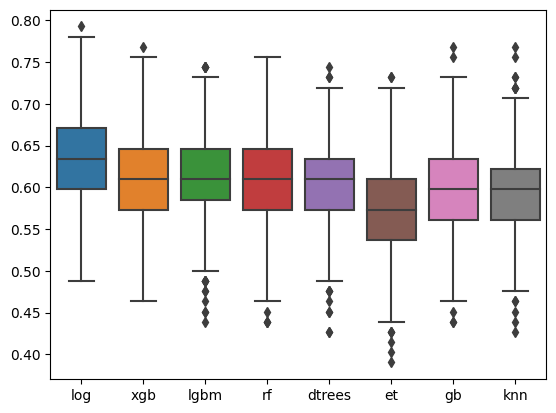

In [218]:
sns.boxplot(accNewLabel)

<Axes: >

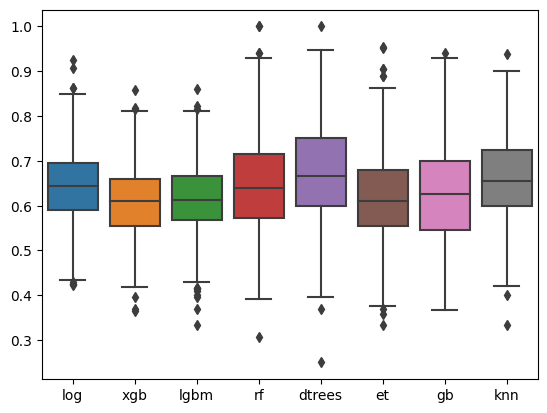

In [219]:
sns.boxplot(newPre)

<Axes: >

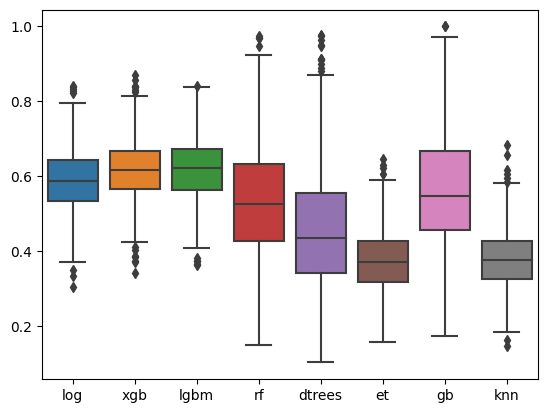

In [220]:
sns.boxplot(newRec)

<Axes: >

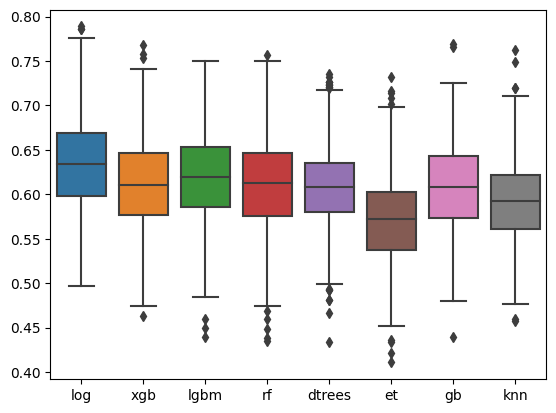

In [221]:
sns.boxplot(newRoc)

In [222]:
# Metrics tabel for all the models to export
datasetList = []
for i in range(8):
  datasetList.append('Binary Label 2: Above average billing per location')
metricsModels = pd.DataFrame()
metricsModels.index = accNewLabel.describe().transpose()['mean'].index
metricsModels['Dataset'] = datasetList
metricsModels['Iterations'] = np.full_like(np.arange(8), 1000)

metricsModels['Accuracy'] = list(accNewLabel.describe().transpose()['mean'])
metricsModels['Precision'] = list(newPre.describe().transpose()['mean'])
metricsModels['Recall'] = list(newRec.describe().transpose()['mean'])
metricsModels['ROC'] = list(newRoc.describe().transpose()['mean'])

In [223]:
# Probability that at least one model predicted correctly
probability2 = 1-(accNewLabel.describe().loc['mean'])
prob2 = 1
for i in probability2:
  prob2 = prob2 * i
print('Probability of Accurate Recomandation Label 2', 1-prob)

Probability of Accurate Recomandation Label 2 0.9993012864354391


##### Predictions

In [226]:
# Fit and Predict
recomendNewLabel = pd.DataFrame()
for i in range(len(modelList)):
  modelList[i].fit(X,y)
  recomendNewLabel[modelNames[i]]= list(modelList[i].predict(prospect))
recomendNewLabel.index = prospect.index

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


[LightGBM] [Info] Number of positive: 164, number of negative: 164
[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000091 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 654
[LightGBM] [Info] Number of data points in the train set: 328, number of used features: 13
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.500000 -> initscore=0.000000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive g

In [227]:
# Company IDs of recomended companies with label2
newLabelCompanies = recomendNewLabel[(recomendNewLabel.log==1)&(recomendNewLabel.xgb==1)&(recomendNewLabel.lgbm==1)&(recomendNewLabel.rf==1)&(recomendNewLabel.dtrees==1)&(recomendNewLabel.et==1)&(recomendNewLabel.gb==1)&(recomendNewLabel.knn==1)].index

### Final Prediction:

Set difference of predicted companies by both labels

In [228]:
finalRecomended = prospect.loc[companies[companies.isin(newLabelCompanies)]]

In [229]:
finalRecomended.index

Int64Index([  2441797,  10256729,  19513364,  39600454, 345283492,  37934049,
              8110814,   1461214,   9867169,   3444162,
            ...
            346645007, 365525965,  89915648,  40599726, 355627427, 355033624,
             33280815, 144441703,  13910366, 160923914],
           dtype='int64', name='CompanyID', length=310)

In [231]:
finalRecomended

,year,revenue,employee_growth1,employee_growth2,alexa_rank,ownership,business_model,certified_active_company,total_funding,recent_funding,recent_funding_date,number_locations,company_acquired,it_budget
CompanyID,,,,,,,,,,,,,,
2441797,3.871201,19.775322,0.000000,0.000000,4.499810,0,0,1,14.586660,13.815512,7.921898,3.178054,0,0.243898
10256729,4.110874,19.642112,0.000000,0.000000,6.120297,0,1,1,0.000000,0.000000,9.994288,3.465736,0,0.122535
19513364,4.025352,17.960231,0.291176,0.525911,7.907652,0,0,1,8.824825,8.824825,9.869414,3.433987,0,0.120111
39600454,3.850148,19.590472,0.000000,0.000000,10.580861,0,0,1,0.000000,0.000000,9.728598,3.931826,0,0.174721
345283492,3.871201,19.258049,0.000000,0.000000,5.891644,0,0,1,10.468830,10.468830,9.537988,2.890372,0,0.121386
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
355033624,3.135494,11.578254,0.246860,0.481191,9.144735,1,0,1,0.000000,0.000000,8.991064,1.791759,1,0.311643
33280815,2.833213,12.790841,0.030529,0.030529,10.526561,1,0,1,9.903538,9.903538,7.618742,3.367296,0,0.253104
144441703,4.852030,12.488760,0.026642,0.026642,8.692658,1,0,1,8.517393,8.517393,7.192934,2.397895,0,0.151088
